## Final Project Submission

Please fill out:
* Student name: Kai Graham
* Student pace: self paced 
* Scheduled project review date/time: 
* Instructor name: Jeff Herman
* Blog post URL:


## Scope:
I will be building a multivariate regression on the KC Housing Dataset with the goal of predicting house sale price as accurately as possible.  This exercise will be completed in context of a private equity / real estate investment firm looking for diligence & valuation support.  Ideally, this regression will help identify statistically significant variables to target during due diligence processes to ensure time is spent on things that are shown to impact price.  Additionally, if the data supports it, firms will be able to leverage some of this data to determine which potential future projects might be correlated with higher sales prices. Ultimately using the tool for both ends, to minimize risk and enter at the bottom of the market for purchasing assets, and realize return.

As part of this scope, there are three primary questions I will aim to answer:
1. What does the current KC housing market look like? What do the majority of houses have in common? What does the typical KC house look like?
2. Are there specific times (years, months, days) that might be related with a higher sale price?
3. Are provided rankings (grade, condition, etc.) trustworthy / relevant to predicting sale price or will additional diligence be required to build our own rankings?

## Process:
General process steps are as followed:
1. Load dataset and handle data issues (missing values, weird values, column data types, etc.)
2. Identify continuous, ordinal categorical, and non-ordinal categorical variables
3. Drop continous variables that do not meet linearity requirments
4. Handle multi-collinearity
5. Handle categorical variables - treat ordinal categorical variables as single columns and one-hot encode non-ordinal categorical columns
6. Use stepwise selection to select features that meet p-val thresholds (0.05)
6. Run baseline model with these features to get preliminary results to compare subsequent models against
7. Evaluate regression diagnostics, check where assumptions on linearity, normality of residuals and heteroscedasticity of residuals
8. Continue preprocessing / transforming to improve results

## Baseline Model
#### Outline:
1. Import necessary libraries
2. Create function to perform stewpise feature selection
3. Create function to make it easier to plot regression plots between two variables
4. Create function to identify multicollinearity and return variables that are predicted with each other
5. Import raw dataset
6. Handle missing values
7. Handle duplicates
8. Translate date column into three columns (day, month, year) that will be easier to work with
9. Convert string data columns to appropriate numerical type
10. Evaluate distributions and plot predictors against price to start evaluating linearity assumptions and begin thinking about splitting out categorical variables
11. Drop variables that violate linearity assumption (will losely include variables that may not look very linear at the moment with the goal of improving results later and transforming distributions to better match linearity assumptions
12. Identify and remove multi-collinearity in the predictor variables
13. Plot boxplots vs. price for all categorical columns, enabling identification of ordinal columns
14. One-hot encode non-ordinal categorical columns
15. Drop unnecessary columns
16. Run stepwise feature selection to select predictor variables
17. Run regresssion with selected features
18. Look at q-q plots and residual plots to evaluate normality / heteroscedasticity assumptions
19. Store results for later comparison
20. Repeat with additional preprocessing

In [1]:
# import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import statsmodels.formula.api as smf
import statsmodels.api as sm
import statsmodels.stats.api as sms
import scipy.stats as stats
%matplotlib inline

/Users/kai_graham/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:

def stepwise_selection(X, y, 
                       initial_list=[], 
                       threshold_in=0.01, 
                       threshold_out = 0.05, 
                       verbose=True):
    """
    Function to perform a forward-backward feature selection
    based on p-value from statsmodels.api.OLS
    Parameters:
        X: pandas.Dataframe with candidate features
        y: list-like with the target
        initial_list: list of features to start with (column names of X)
        threshold_in: include a feature if its p-val < threshold_in
        threshold_out: exclude a feature if its p-val > threshold_out
        verbose: whether to print the sequence of inclusions and exclusions
    Returns: list of selected features
    Note: always set threshold_in < threshold_out to avoid infinite looping
    """
    included = list(initial_list)
    while True:
        changed=False
        
        # forward step
        excluded = list(set(X.columns)-set(included))
        new_pval = pd.Series(index=excluded, dtype='float64')
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included+[new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed=True
            if verbose:
                print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max() # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.idxmax()
            included.remove(worst_feature)
            if verbose:
                print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))
        if not changed:
            break
    return included

In [3]:
def plot_viz(data, target, predictors, nrows=1, ncols=1, figsize=(10, 4)):
    """
    Function to plot y vs. a chosen set of x variables: includes regression line
    Parameters:
        data: name of dataframe variables are coming from
        target: string of target variable
        predictors: dataframe of predictors
        nrows: number of rows of subplots
        ncols: number of cols of subplots
        figsize: size of the figure
    """
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    for ax, feature in zip(axes.flatten(), predictors):
        sns.regplot(x=feature, y=target, data=data, ax=ax, color='purple', scatter_kws={'alpha':0.2});
        ax.set_title(f'{feature} vs. {target}')
    plt.tight_layout()

In [4]:

def multi_collinearity(data_pred, percent_correlated=0.75):
    """
    Function to identify multi-collinearity based on a threshold value.
    Parameters:
        data_pred: predictor variables
        percent_correlated: threshold percentage to determine the level of correlation to identify
    Returns: Dataframe of correlated pairs, with duplicates removed
    """
    
    df = data_pred.corr().abs().stack().reset_index().sort_values(0, ascending=False)
    
    # zip the variable name columns (named level_0 and level_1 by default) in a new column named "pairs"
    df['pairs'] = list(zip(df.level_0, df.level_1))
    
    # set index to pairs
    df.set_index(['pairs'], inplace=True)
    
    # drop level columns
    df.drop(columns=['level_1', 'level_0'], inplace=True)
    
    # rename correlation column as cc rather than 0
    df.columns = ['cc']
    
    # drop duplicates
    df.drop_duplicates(inplace=True)
    
    return df[(df.cc > percent_correlated) & (df.cc < 1)]
    

In [5]:
# set style of graphs and visualizations
plt.style.use('ggplot')

In [6]:
# import raw dataset
raw_data = pd.read_csv('kc_house_data.csv')

# examine the raw dataset
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [7]:
# drop the id column as that won't be relevant
clean_data = raw_data.drop('id', axis=1)

In [8]:
# handle missing values
# waterfront
# yr_renovated
# view

# waterfront
clean_data['waterfront'].unique()

array([nan,  0.,  1.])

In [9]:
# how many are missing
clean_data['waterfront'].isna().sum()

2376

In [10]:
# set all nans to 0 as houses missing waterfront info likely are not waterfront
clean_data['waterfront'] = clean_data['waterfront'].fillna(value=0.)

In [11]:
# yr_renovated missing values
clean_data['yr_renovated'].unique()

array([   0., 1991.,   nan, 2002., 2010., 1992., 2013., 1994., 1978.,
       2005., 2003., 1984., 1954., 2014., 2011., 1983., 1945., 1990.,
       1988., 1977., 1981., 1995., 2000., 1999., 1998., 1970., 1989.,
       2004., 1986., 2007., 1987., 2006., 1985., 2001., 1980., 1971.,
       1979., 1997., 1950., 1969., 1948., 2009., 2015., 1974., 2008.,
       1968., 2012., 1963., 1951., 1962., 1953., 1993., 1996., 1955.,
       1982., 1956., 1940., 1976., 1946., 1975., 1964., 1973., 1957.,
       1959., 1960., 1967., 1965., 1934., 1972., 1944., 1958.])

In [12]:
# how many are missing
clean_data['yr_renovated'].isna().sum()

3842

In [13]:
# similar to waterfront, assume missing data are 0s - non-renos
clean_data['yr_renovated'] = clean_data['yr_renovated'].fillna(value=0.)

In [14]:
# view missing values
clean_data['view'].unique()

array([ 0., nan,  3.,  4.,  2.,  1.])

In [15]:
# how many are missing
clean_data['view'].isna().sum()

63

In [16]:
# view is the only column now missing values, drop all na given there are only 63
clean_data = clean_data.dropna()

In [17]:
# no more missing values, check for duplicates
clean_data.duplicated().sum()

0

In [18]:
# there are no duplicates - - handles columns of type object
# to appropriate type
clean_data['sqft_basement'].unique()

array(['0.0', '400.0', '910.0', '1530.0', '?', '730.0', '1700.0', '300.0',
       '970.0', '760.0', '720.0', '700.0', '820.0', '780.0', '790.0',
       '330.0', '1620.0', '360.0', '588.0', '1510.0', '410.0', '990.0',
       '600.0', '560.0', '550.0', '1000.0', '1600.0', '500.0', '1040.0',
       '880.0', '1010.0', '240.0', '265.0', '290.0', '800.0', '540.0',
       '840.0', '380.0', '770.0', '480.0', '570.0', '1490.0', '620.0',
       '1250.0', '1270.0', '120.0', '650.0', '180.0', '1130.0', '450.0',
       '1640.0', '1460.0', '1020.0', '1030.0', '750.0', '640.0', '1070.0',
       '490.0', '1310.0', '630.0', '2000.0', '390.0', '430.0', '210.0',
       '1430.0', '1950.0', '440.0', '220.0', '1160.0', '860.0', '580.0',
       '2060.0', '1820.0', '1180.0', '200.0', '1150.0', '1200.0', '680.0',
       '530.0', '1450.0', '1170.0', '1080.0', '960.0', '280.0', '870.0',
       '1100.0', '460.0', '1400.0', '660.0', '1220.0', '900.0', '420.0',
       '1580.0', '1380.0', '475.0', '690.0', '270.0', 

In [19]:
# how many are '?'
clean_data.loc[clean_data['sqft_basement'] == '?']['price'].count()

452

In [20]:
# only 452 - - going to drop these
clean_data = clean_data.loc[clean_data['sqft_basement'] != '?']

# convert column to a number format
clean_data['sqft_basement'] = clean_data['sqft_basement'].astype('float64')

In [21]:
# handle date column - convert to datetime and then split into year, month, day
clean_data['date'] = pd.to_datetime(clean_data['date'], 
                                    infer_datetime_format=True)

In [22]:
# create indidivual columns for year, month, day
clean_data['year_sold'] = clean_data['date'].map(lambda x: x.year)
clean_data['month_sold'] = clean_data['date'].map(lambda x: x.month)
clean_data['day_sold'] = clean_data['date'].map(lambda x: x.day)

# drop date column
clean_data = clean_data.drop('date', axis=1)

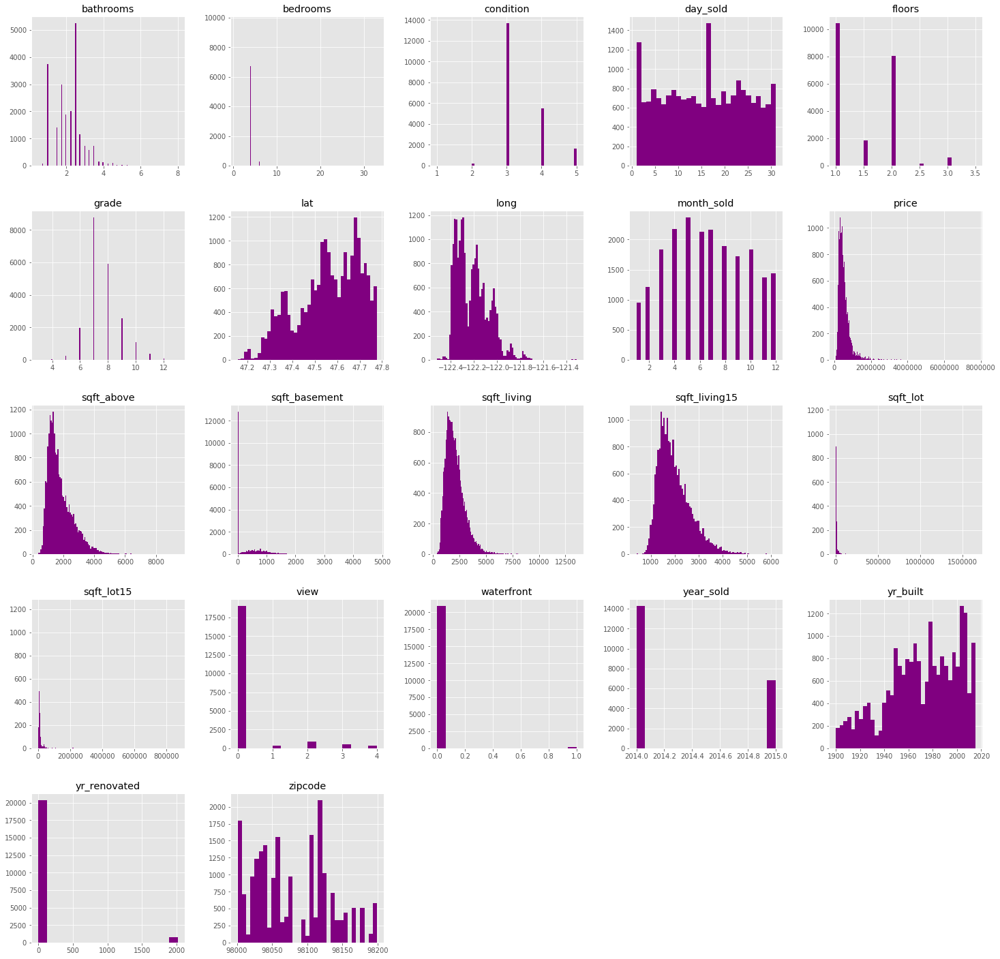

In [23]:
# start checking distributions / histograms
# plot histograms of all variables
clean_data.hist(figsize=(25, 25), bins='auto', color='purple');

In [24]:
clean_data.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year_sold,month_sold,day_sold
count,2.108200e+04,21082.000000,21082.000000,21082.000000,2.108200e+04,21082.00000,21082.000000,21082.000000,21082.000000,21082.000000,...,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000,21082.000000
mean,5.402469e+05,3.372403,2.115916,2080.359975,1.507759e+04,1.49362,0.006688,0.233327,3.409828,7.657717,...,1971.023337,68.359359,98077.858837,47.560371,-122.213843,1986.917418,12732.514135,2014.323024,6.576131,15.684233
std,3.667323e+05,0.924996,0.768142,917.856396,4.117338e+04,0.53937,0.081509,0.765066,0.650597,1.173690,...,29.323120,363.029573,53.528769,0.138568,0.140607,685.544250,27148.781580,0.467643,3.114213,8.631526
min,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.00000,0.000000,0.000000,1.000000,3.000000,...,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,2014.000000,1.000000,1.000000
25%,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.00000,0.000000,0.000000,3.000000,7.000000,...,1952.000000,0.000000,98033.000000,47.471325,-122.328000,1490.000000,5100.000000,2014.000000,4.000000,8.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.620000e+03,1.50000,0.000000,0.000000,3.000000,7.000000,...,1975.000000,0.000000,98065.000000,47.572200,-122.230000,1840.000000,7626.000000,2014.000000,6.000000,16.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.069775e+04,2.00000,0.000000,0.000000,4.000000,8.000000,...,1997.000000,0.000000,98117.000000,47.678200,-122.125000,2360.000000,10088.750000,2015.000000,9.000000,23.000000
max,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.50000,1.000000,4.000000,5.000000,13.000000,...,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,2015.000000,12.000000,31.000000


### Question 1 - - what does the typical KC house look like?
Looking at the above distributions, the summary stats and below description provides answer to the housing market in KC and the typical house

#### Discussion of distributions of all variables / columns:
 - bathrooms: appears to be categorical with the majority of entries falling between 0.5 and 3 bathrooms. there are a number of outliers to the right, with one entry having 8 bedrooms.  Room to clean these outliers up after the baseline model is generated.  Summary stats presented above, shows a median of 2.25 bathrooms, and a standard deviation of just over 0.75 bathrooms
 - bedrooms: appears to be categorical with the majority of entries having 1 to 4 bedrooms.  Significant oulier with one entry having 33 bedrooms.  Median number of bedrooms is 3, with a standard deviation of just under 1 bedroom
 - condition: appears categorical, max of 5, median of 3 - - looks like the majority are condition ratings of 3 and 4.  standard deviation of 0.65 (just over half one condition rating)
 - day_sold: appears to be categorical.  Looks like there is no deviation other than near the beginning of the month (day 1) and the middle of the month (day ~20) showing more houses sold near these days than on others
 - floors: categorical with a significant falloff after 2 floors
 - grade: appears somewhat normally distributed although it is categorical.  Some grades above 10, with the most between 6 and 9.  Median grade is 7 with a std of 1.17
 - month_sold: categorical, but interesting to see that there are more houses sold during the summer months than winter months, which makes sense
 - price, sqft_above, sqft_living, sqft_living15 appear log normally distributed, with right skew and likely some positive outliers
 - sqft_lot and sqft_lot15 have have significant right skew and outliers
 - view: very few houses have been viewed (> 0 value)
 - waterfront: very few houses have waterfront
 - year_sold: only two years of sale data is included here (2014 and 2015), with more entries coming from 2014 than 2015
 - yr_built: the majority of houses represented were built after 1950, with the earliest house included being built in 1900
 - yr_renovated: only a handful have received renovations

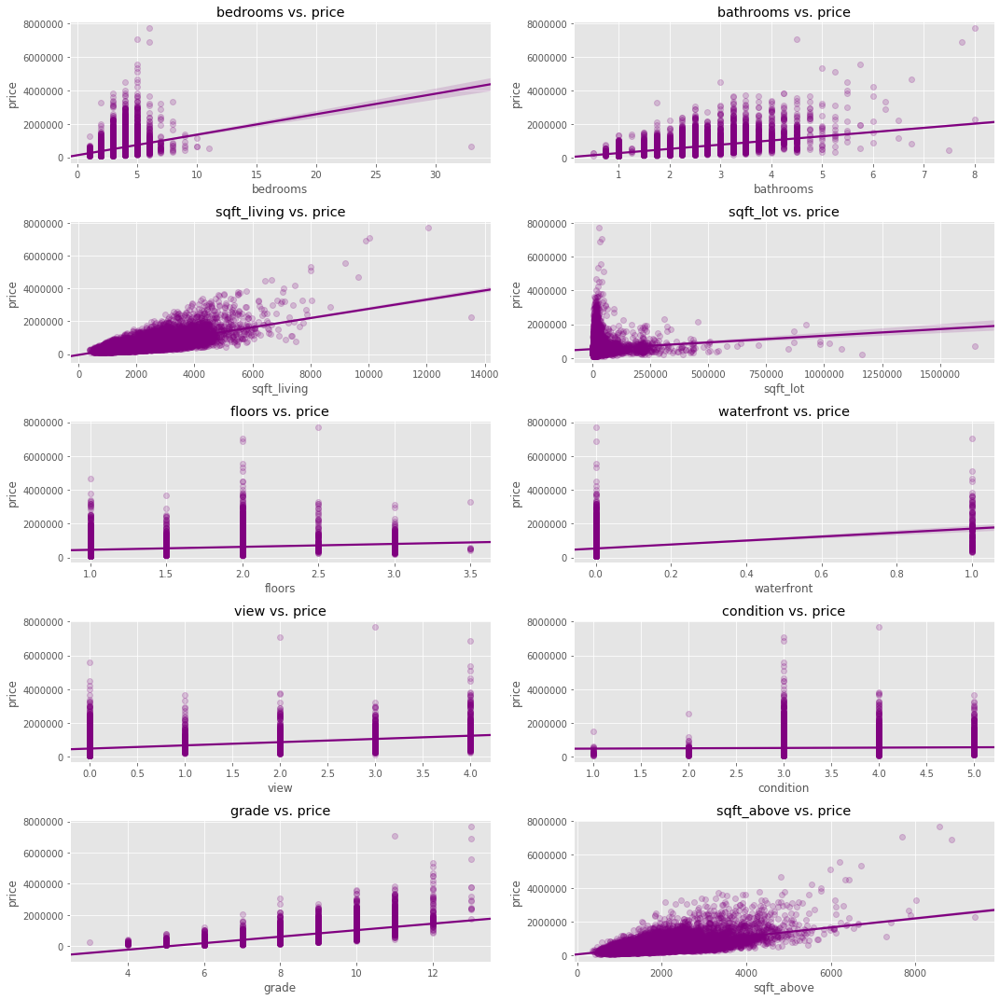

In [25]:
# evaluate relationships with price
predictors = clean_data.drop('price', axis=1)
plot_viz(data=clean_data,
         target='price',
         predictors=predictors,
         nrows=5,
         ncols=2,
         figsize=(15, 15))

As can be seen when plotting against price, there are a number of price outliers seen in the data - - looking at the distribution of price will allow us to see this better - - start with price as it is our target variable. Going to divide by 1000 when plotting to allow the axis to be seen easier.

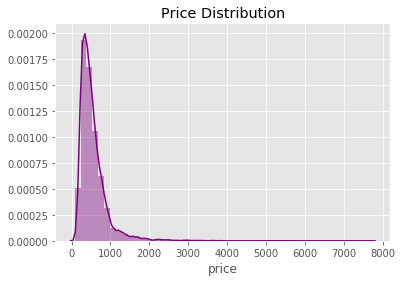

In [26]:
# look at just the distribution of price
scaled_price = clean_data['price'] / 1000
sns.distplot(scaled_price, color='purple');
plt.title('Price Distribution')
plt.show()

When looking at the distribution of price there is clear right skew - we will attempt to clean this up after our baseline model. Not transforming prior to baseline because I want something to compare all subsequent changes to.

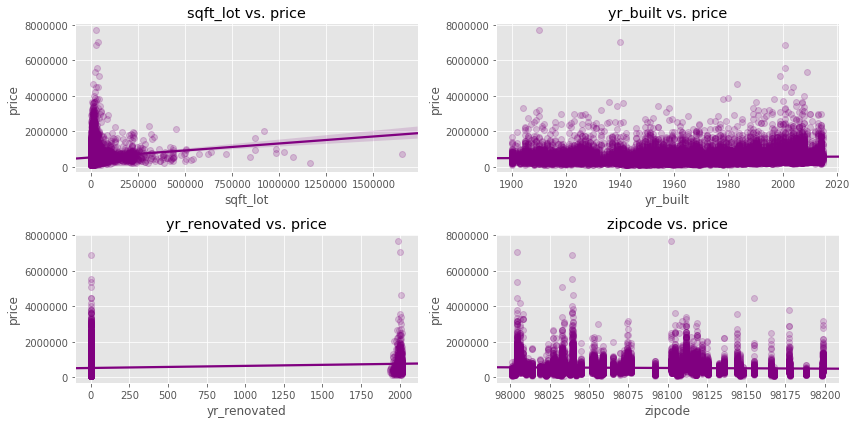

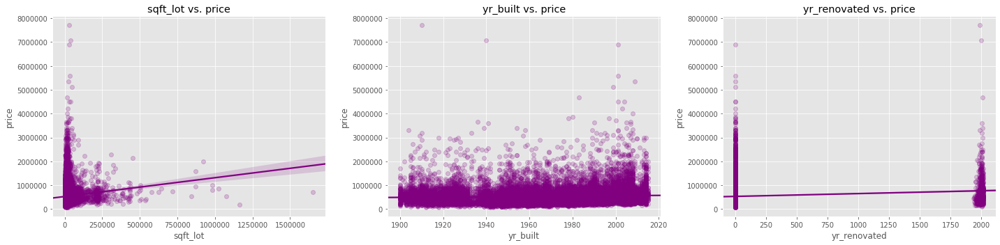

In [27]:
non_linear_1 = ['sqft_lot', 'yr_built', 'yr_renovated', 'zipcode']
non_linear_2 = ['lat', 'long', 'sqft_lot15']

predictors1 = clean_data[non_linear_1]
predictors2 = clean_data[non_linear_2]

# replot non-linear against price to show these violate the assumptions
plot_viz(data=clean_data,
         target='price',
         predictors=predictors1,
         nrows=2,
         ncols=2,
         figsize=(12, 6))

plot_viz(data=clean_data,
         target='price',
         predictors=predictors1,
         nrows=1,
         ncols=3,
         figsize=(20, 5))

From these plots against price, its clear there are number of variables that do not meet the linearity assumption.  Drop `sqft_lot`, `yr_built`, `yr_renovated`, `zipcode`, `lat`, `long`, `sqft_lot15` for violating linearity assumptions.  Will add some of these back in subsequent versions of the model to see if transforming or ohe would be beneficial

In [28]:
# drop non-linear
preprocessed = clean_data.drop(['sqft_lot', 'yr_built', 'yr_renovated',
                                'zipcode', 'lat', 'long', 'sqft_lot15'], axis=1)

Now that non-linear predictors have been removed, use `multi_collinearity(data_pred, 0.75)` to get all predictors that are 75% or more correlated.

In [29]:
# we've now dropped non-linear
# identify and remove any multi-collinearity
data_pred = preprocessed.drop(['price'], axis=1)
correlated_predictors = multi_collinearity(data_pred, 0.75)
correlated_predictors

,cc
pairs,
"(sqft_above, sqft_living)",0.876787
"(month_sold, year_sold)",0.781941
"(sqft_living, grade)",0.762719
"(sqft_above, grade)",0.756289
"(sqft_living, sqft_living15)",0.756199
"(sqft_living, bathrooms)",0.754793


From the returned pairs we see that `sqft_living` is correlated with the following (`sqft_above`, `grade`, `sqft_living15`, `bathrooms`) - - as a result drop `sqft_living`.

`sqft_above` is also correlated with `grade`, so drop `sqft_above` as well.
`year_sold` is correlated with `month_sold`, so drop this too.

In [30]:
# drop sqft_living, year_sold, sqft_above
preprocessed = preprocessed.drop(['sqft_living', 'year_sold', 'sqft_above'], axis=1)

In [31]:
preprocessed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21082 entries, 0 to 21596
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   price          21082 non-null  float64
 1   bedrooms       21082 non-null  int64  
 2   bathrooms      21082 non-null  float64
 3   floors         21082 non-null  float64
 4   waterfront     21082 non-null  float64
 5   view           21082 non-null  float64
 6   condition      21082 non-null  int64  
 7   grade          21082 non-null  int64  
 8   sqft_basement  21082 non-null  float64
 9   sqft_living15  21082 non-null  int64  
 10  month_sold     21082 non-null  int64  
 11  day_sold       21082 non-null  int64  
dtypes: float64(6), int64(6)
memory usage: 2.1 MB


Now that non-linear continuous columns and multicollinearity has been removed, start handling categorical variables.  For the baseline model, only going to separate out ordinal from non-ordinal and one-hot enncode non-ordinal.

Visualize relationships by plotting boxplots vs. price - - this will help show if there is any pattern / ordinal relationship.

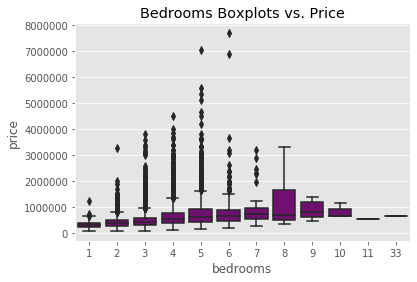

In [32]:
# bedrooms
sns.boxplot(x='bedrooms', y='price', data=preprocessed, color='purple');
plt.title('Bedrooms Boxplots vs. Price');
plt.show()

The price outliers are very apparent in this plot - will continue to leave these in for the baseline. Additionally, it appears that there is somewhat of an ordinal relationship here so bedrooms will be left in as a single column and not one-hot encoded

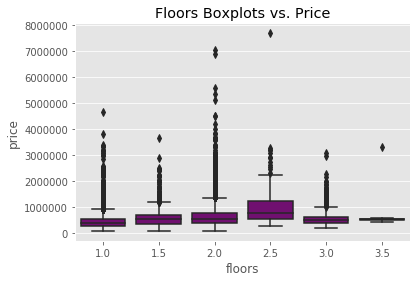

In [33]:
# floors
sns.boxplot(x='floors', y='price', data=preprocessed, color='purple');
plt.title('Floors Boxplots vs. Price')
plt.show()

There is no clear ordinal relatinship here so will keep treating this as a categorical column and eventually one-hot encode.  smf.ols runs into some syntax issues when trying to use column names ending in `.0`.  For this reason, scale floors by 10 and then convert to an int type. 

Create a running list of all variables that need to be one-hot encoded in `ohe_list`

In [34]:
# scale by 10 to prevent issues with sms.ols later
preprocessed['floors_10'] = preprocessed['floors'] * 10

# convert to int
preprocessed['floors_10'] = preprocessed['floors_10'].astype('int64')

# add to ohe_list
ohe_list = []
ohe_list.append('floors_10')

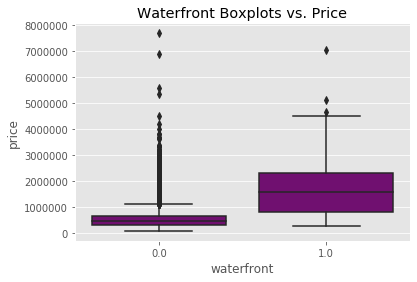

In [35]:
# waterfront
sns.boxplot(x='waterfront', y='price', data=preprocessed, color='purple');
plt.title('Waterfront Boxplots vs. Price')
plt.show()

Looking at this, again there are clearly price outliers, but ignoring those, it looks like having waterfront is related to higher priced homes.  This is still muddy given all the noise from outliers, etc. but from a first glance there appears to be a relationship between waterfront and price. 

Add to `ohe_list` and translate column to int type.

In [36]:
# convert to int column
preprocessed['waterfront'] = preprocessed['waterfront'].astype('int64')

# append to ohe_list
ohe_list.append('waterfront')

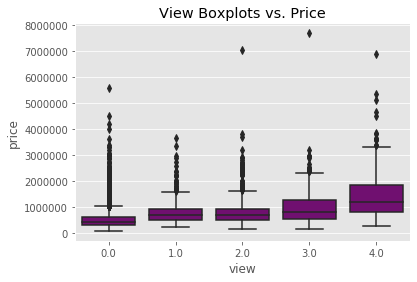

In [37]:
# view
sns.boxplot(x='view', y='price', data=preprocessed, color='purple');
plt.title('View Boxplots vs. Price')
plt.show()

Looking at the boxplots / median lines there appears to be a somewhat ordinal relationship between price and view. As a result, for the baseline model, this will be kept as a single column

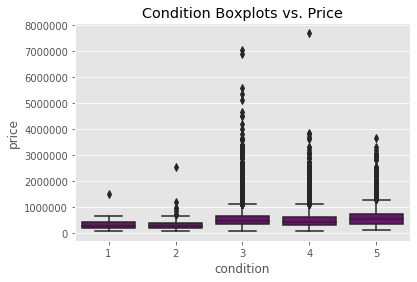

In [38]:
# condition
sns.boxplot(x='condition', y='price', data=preprocessed, color='purple');
plt.title('Condition Boxplots vs. Price')
plt.show()

While outliers makes it hard to see, there is no clear ordinal relationship here.  As a result, append `condition` to the `ohe_list`.  No need to transform column type as it is already type int

In [39]:
ohe_list.append('condition')

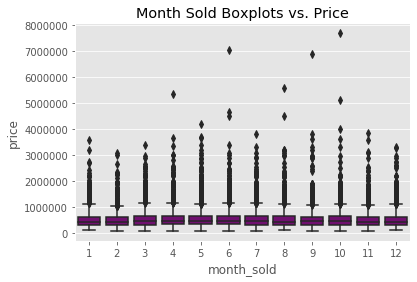

In [40]:
# month_sold
sns.boxplot(x='month_sold', y='price', data=preprocessed, color='purple');
plt.title('Month Sold Boxplots vs. Price')
plt.show()

No clear ordinal relationship, add to `ohe_list`

In [41]:
ohe_list.append('month_sold')

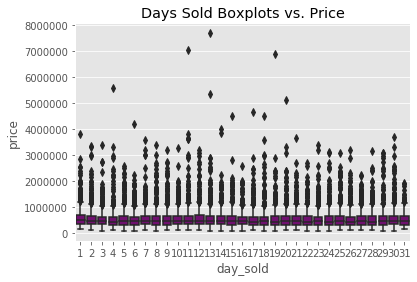

In [42]:
# days_sold
sns.boxplot(x='day_sold', y='price', data=preprocessed, color='purple');
plt.title('Days Sold Boxplots vs. Price')
plt.show()

No clear ordinal relationship, add to `ohe_list`

In [43]:
ohe_list.append('day_sold')
ohe_list

['floors_10', 'waterfront', 'condition', 'month_sold', 'day_sold']

Create dummy variables for each categorical column that was determined to not be ordinal. Then drop ohe_list from the dataset.

In [44]:
# create dummy variables
floors_dummies = pd.get_dummies(preprocessed['floors_10'], 
                                prefix='floors', 
                                drop_first=True)

waterfront_dummies = pd.get_dummies(preprocessed['waterfront'], 
                                    prefix='waterfront', 
                                    drop_first=True)

condition_dummies = pd.get_dummies(preprocessed['condition'],
                                   prefix='condition',
                                   drop_first=True)

month_sold_dummies = pd.get_dummies(preprocessed['month_sold'],
                                   prefix='month_sold',
                                   drop_first=True)

day_sold_dummies = pd.get_dummies(preprocessed['day_sold'],
                                  prefix='day_sold',
                                  drop_first=True)

In [45]:
# drop columns
data_fin = preprocessed.drop(['floors', 'floors_10', 
                              'waterfront', 'condition', 
                              'month_sold', 'day_sold'], axis=1)

Set up final dataset for feature selection and to run the baseline regression. Concat remaining columns with the dummy variables and then run feature selection.

In [46]:
# concat with dummies
data_fin = pd.concat([data_fin,
                      floors_dummies,
                      waterfront_dummies,
                      condition_dummies,
                      month_sold_dummies,
                      day_sold_dummies], axis=1)

In [47]:
# run stepwise selection to select features
y = data_fin['price']
X = data_fin.drop('price', axis=1)
result = stepwise_selection(X, y, verbose=True)

Add  view                           with p-value 0.0
Add  sqft_living15                  with p-value 0.0
Add  bathrooms                      with p-value 0.0
Add  grade                          with p-value 0.0
Add  sqft_basement                  with p-value 9.77727e-187
Add  waterfront_1                   with p-value 7.69475e-183
Add  floors_15                      with p-value 1.03356e-102
Add  condition_3                    with p-value 3.21469e-62
Add  floors_25                      with p-value 9.35534e-42
Add  condition_5                    with p-value 3.48337e-27
Add  month_sold_4                   with p-value 4.81002e-07
Add  month_sold_3                   with p-value 2.57958e-07
Add  bedrooms                       with p-value 1.00406e-05
Add  floors_30                      with p-value 9.55278e-05
Add  day_sold_30                    with p-value 0.0012361
Add  day_sold_13                    with p-value 0.00264322
Add  floors_35                      with p-value 0.00647



Take the predictors that were returned by the feature selection.  Make sure to add constant as sm.OLS does not include this. Fit the model against and the predictors + constant.  Print model summary to evaluate baseline

In [48]:
# run regression with these features
X = data_fin[result]
y = data_fin['price']
predictors = sm.add_constant(X)
model = sm.OLS(y, predictors).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.584
Model:                            OLS   Adj. R-squared:                  0.584
Method:                 Least Squares   F-statistic:                     1740.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:05:30   Log-Likelihood:            -2.9078e+05
No. Observations:               21082   AIC:                         5.816e+05
Df Residuals:                   21064   BIC:                         5.817e+05
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          -8.33e+05    1.3e+04    -64.000      0.000   -8.58e+05   -8.07e+05
view           5.887e+04   2478.352     23.755      0.000     5.4e+04    6.37e+04
sqft_living15    88.0802      3.619     24.336      0.000      80.986      95.174
bathrooms      4.255e+04   3232.638     13.163      0.000    3.62e+04    4.89e+04
grade          1.423e+05   2267.721     62.756      0.000    1.38e+05    1.47e+05
sqft_basement   114.0457      4.142     27.536      0.000     105.928     122.164
waterfront_1   6.425e+05   2.16e+04     29.688      0.000       6e+05    6.85e+05
floors_15      1.197e+05   5912.496     20.247      0.000    1.08e+05    1.31e+05
condition_3   -4.645e+04   3892.421    -11.934      0.000   -5.41e+04   -3.88e+04
floors_25      2.648e+05   1.93e+04     13.749      0.000    2.27e+05    3.03e+05
condition_5    7.337e+04   6643.561     11.043      0.000    6.03e+04    8.64e+04
month_sold_4    2.95e+04   5393.230      5.470      0.000    1.89e+04    4.01e+04
month_sold_3   2.974e+04   5825.674      5.104      0.000    1.83e+04    4.12e+04
bedrooms      -8800.3409   2157.500     -4.079      0.000    -1.3e+04   -4571.476
floors_30      4.041e+04   1.03e+04      3.930      0.000    2.03e+04    6.06e+04
day_sold_30    3.229e+04   9802.625      3.294      0.001    1.31e+04    5.15e+04
day_sold_13    2.712e+04   8997.648      3.014      0.003    9486.356    4.48e+04
floors_35      2.437e+05   8.95e+04      2.723      0.006    6.83e+04    4.19e+05
==============================================================================
Omnibus:                    18084.930   Durbin-Watson:                   1.976
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1875480.018
Skew:                           3.610   Prob(JB):                         0.00
Kurtosis:                      48.639   Cond. No.                     1.17e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.17e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

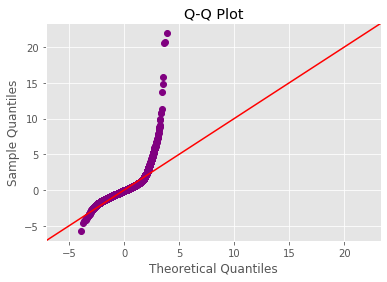

In [49]:
# plot q-q check normality of residuals for baseline
sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True, color='purple');
plt.title('Q-Q Plot');

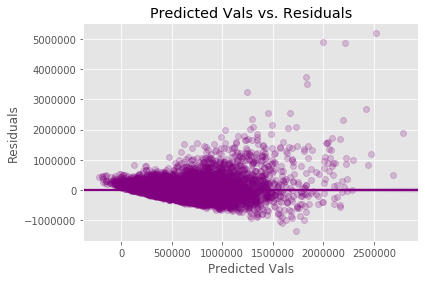

In [50]:
# check heteroscedascity for baseline
predicted_vals = model.predict(predictors)
sns.regplot(x=predicted_vals, y=model.resid, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Predicted Vals vs. Residuals')
plt.xlabel('Predicted Vals')
plt.ylabel('Residuals');

Based on the above Q-Q plots and residual plot, we can see that our assumptions for normally distributed residuals does not hold.  Additionally, there appears to be some pattern in the residual plot, highlighting the presence of heteroscedasticity, another violation of a regression assumption.  We will continue to preprocess to try and improve results. 

## Baseline Results
Now generate plots for model residuals against each predictor.  This will provide some insight into residuals of each predictor.  After this, run single variable regressions against price for each predictor and evaluate residual and q-q plots to further assess. 

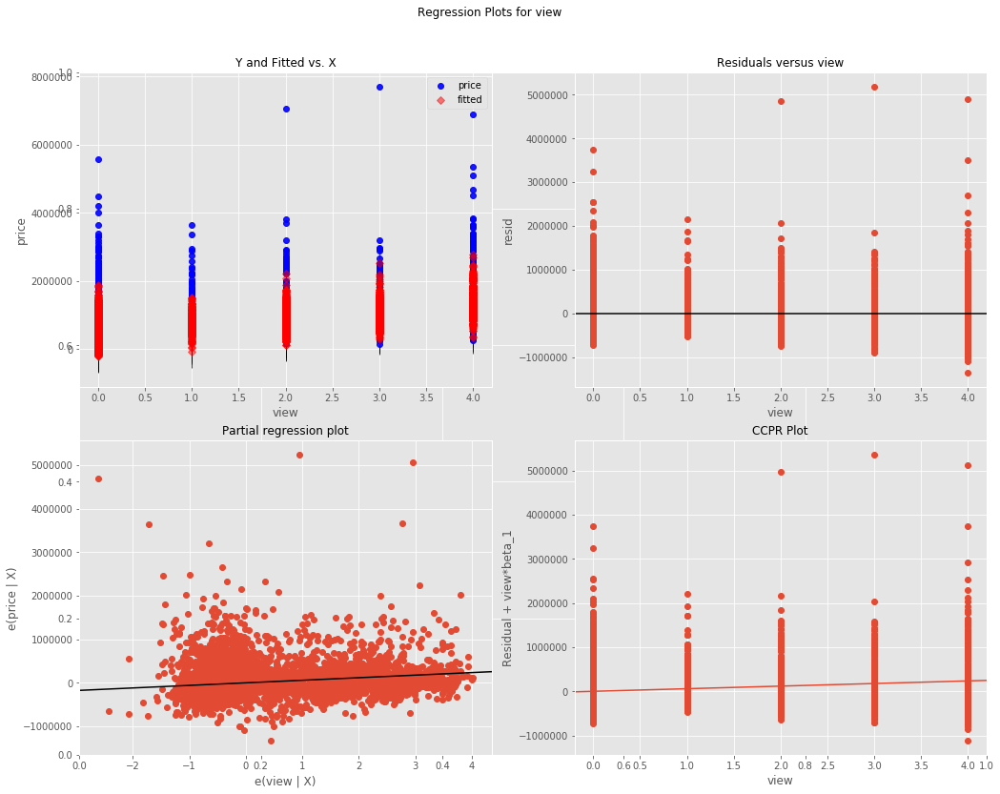

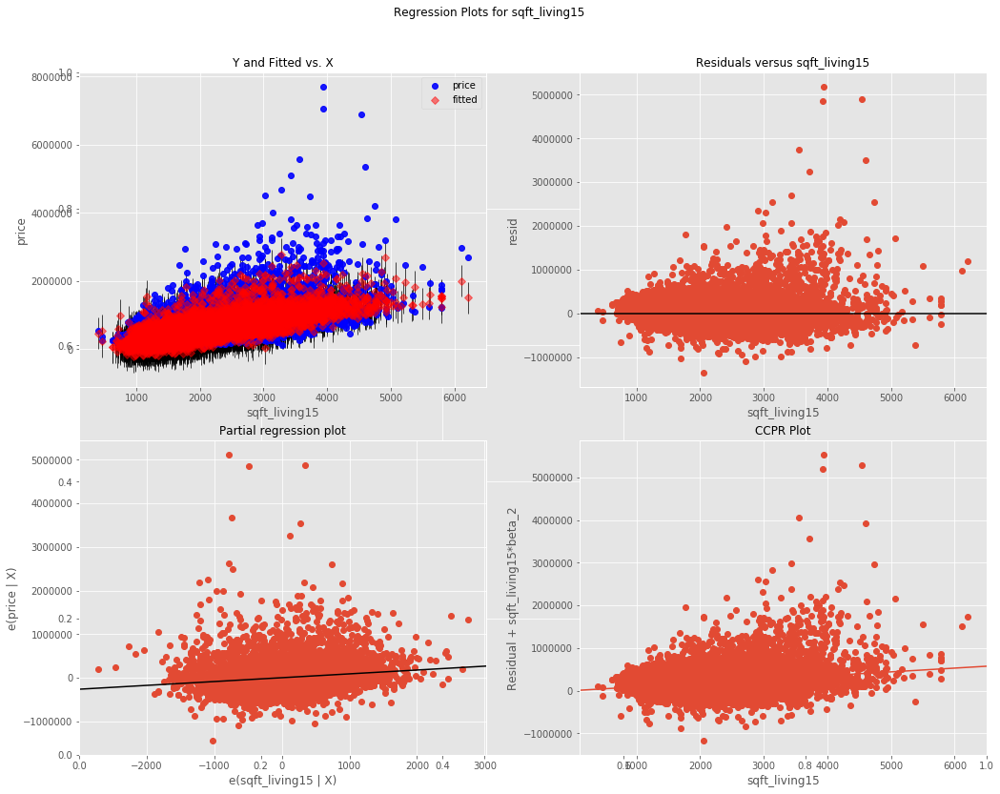

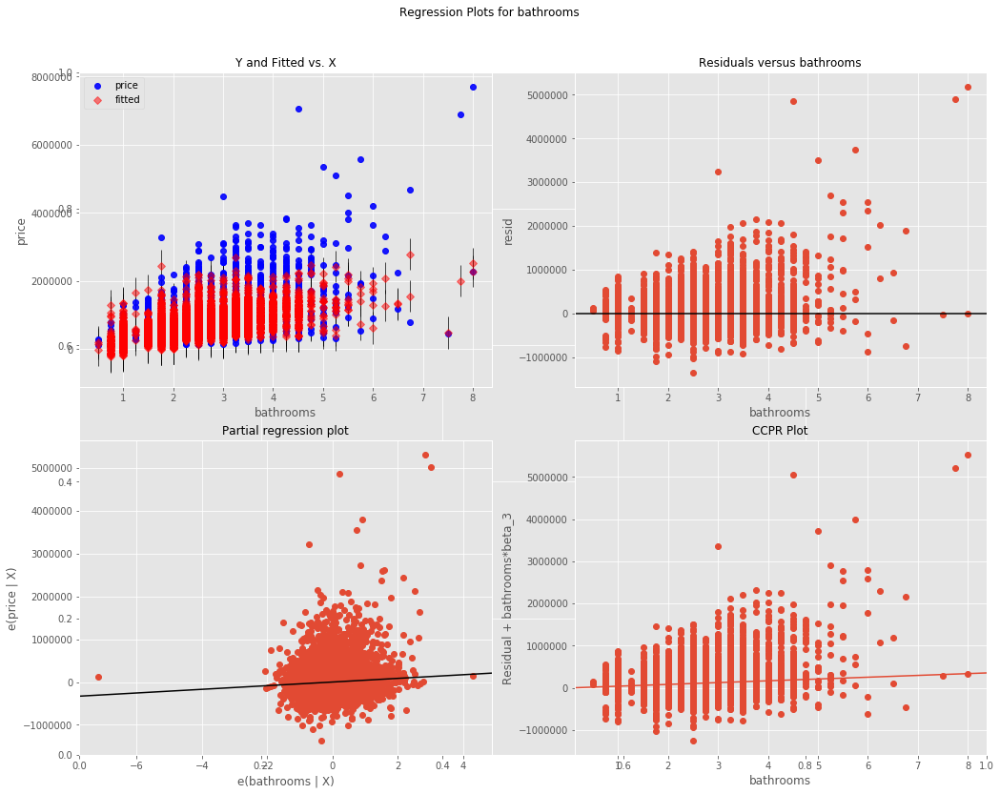

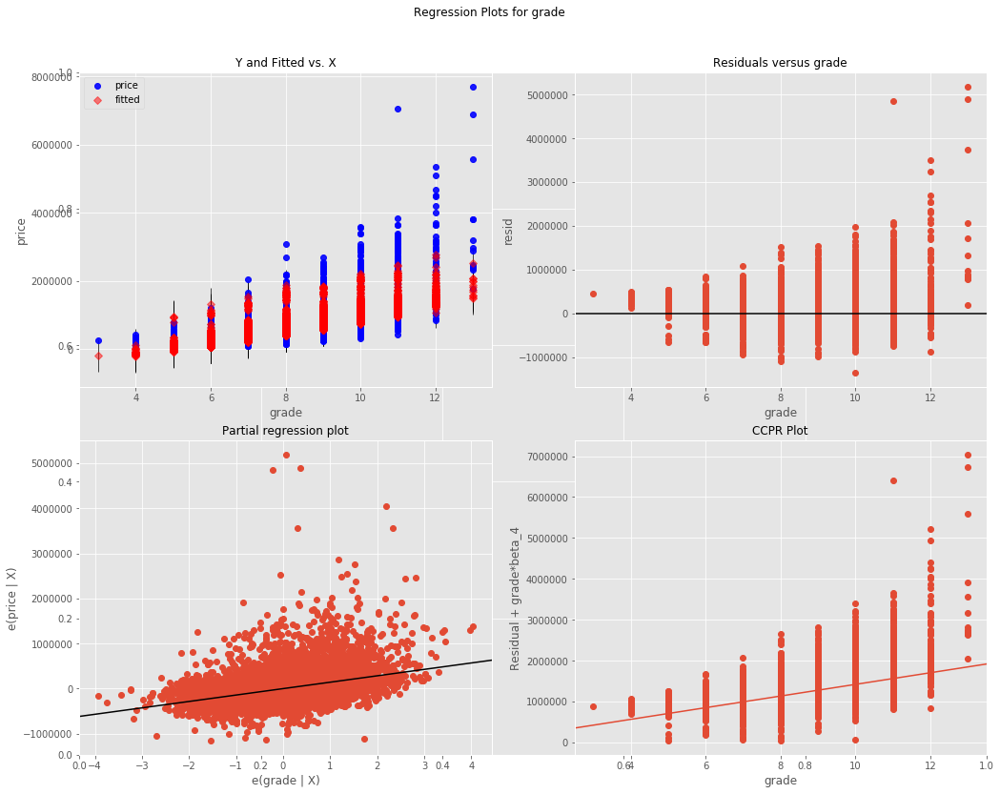

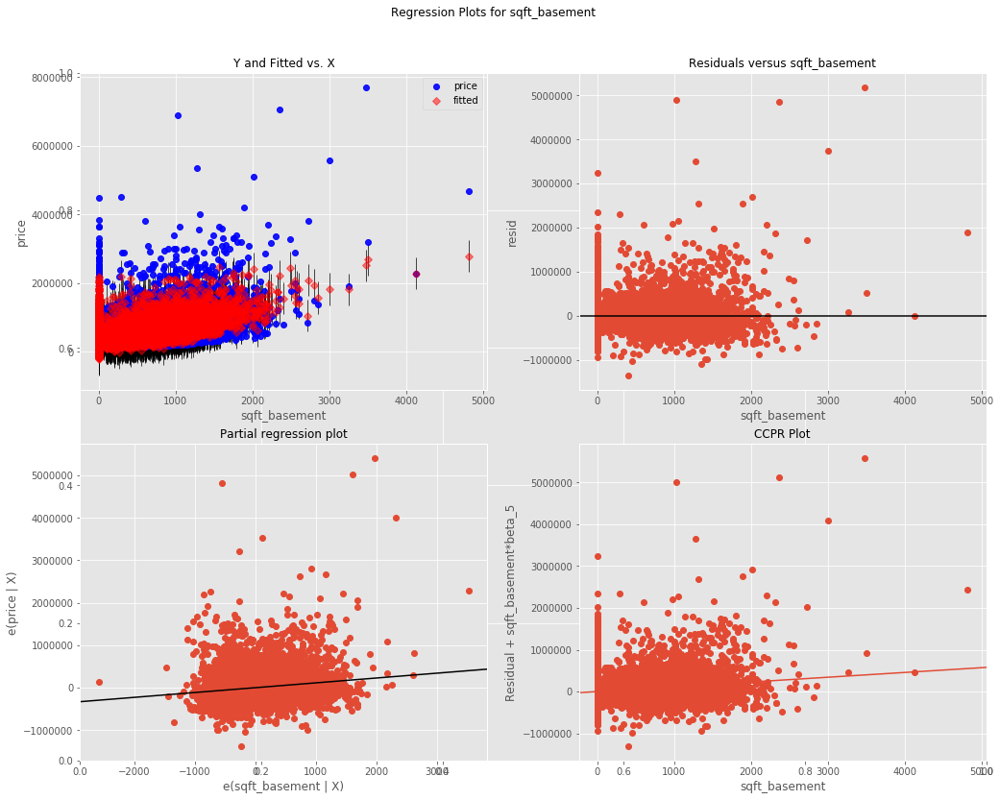

...

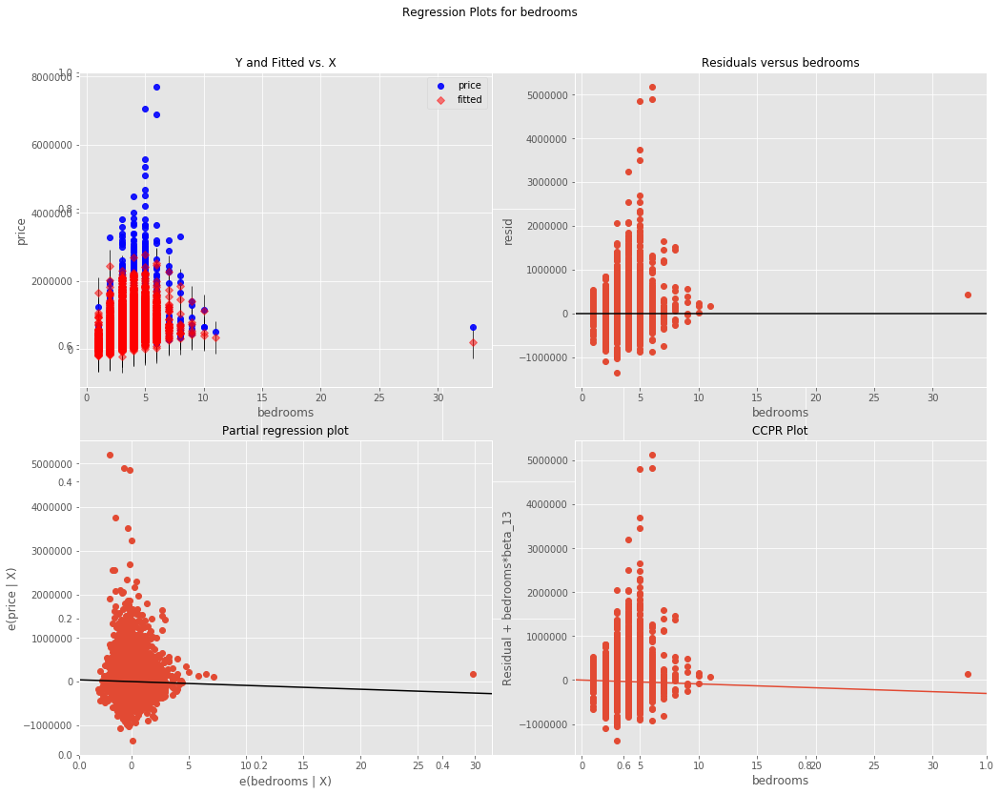

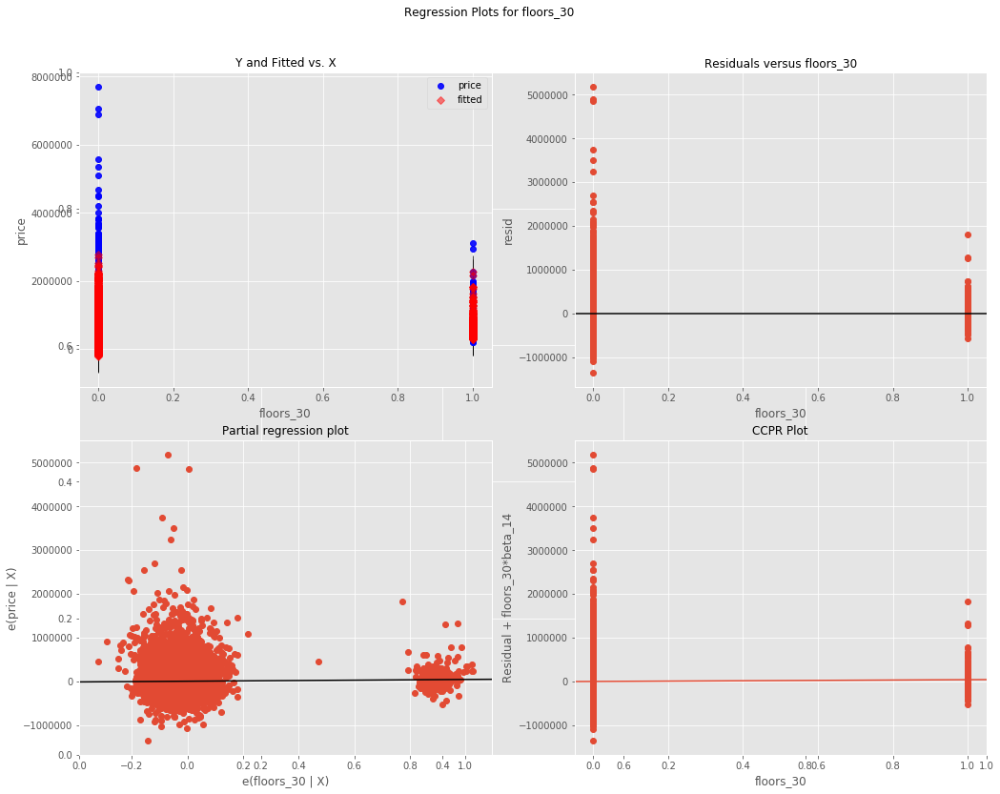

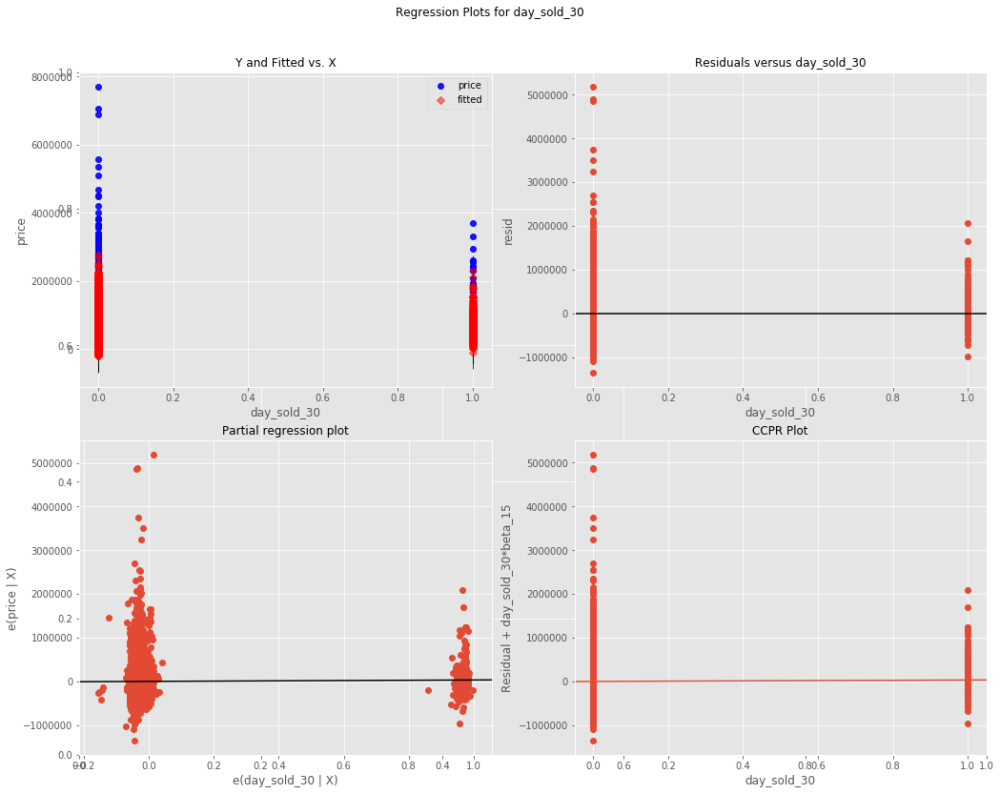

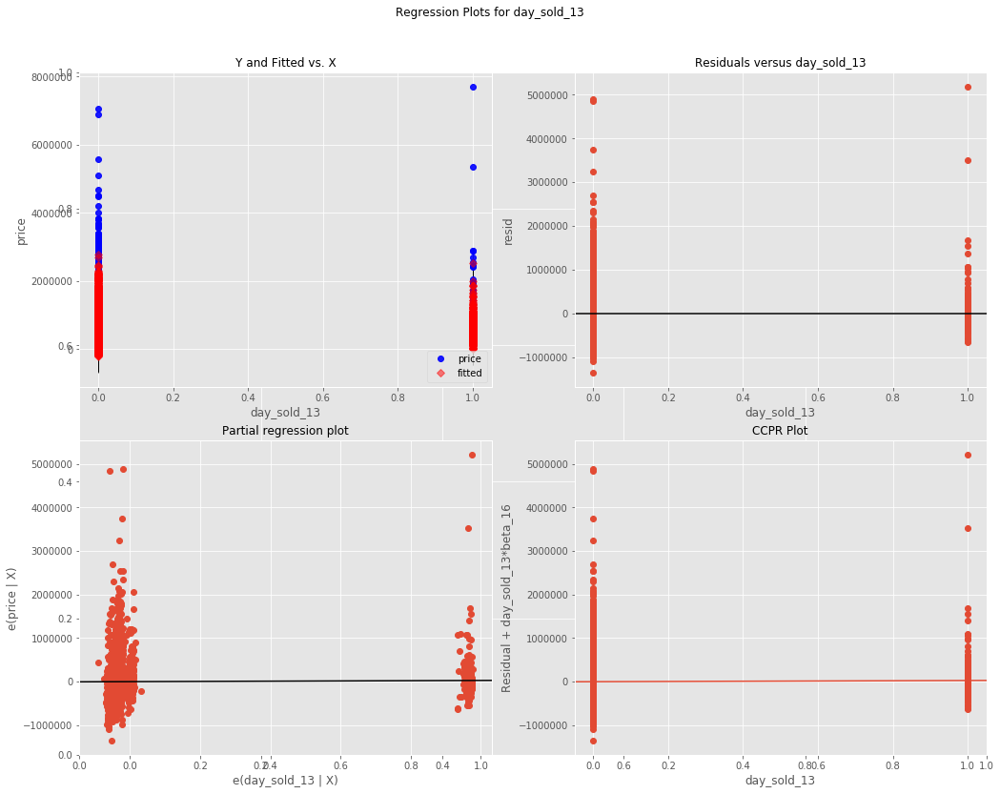

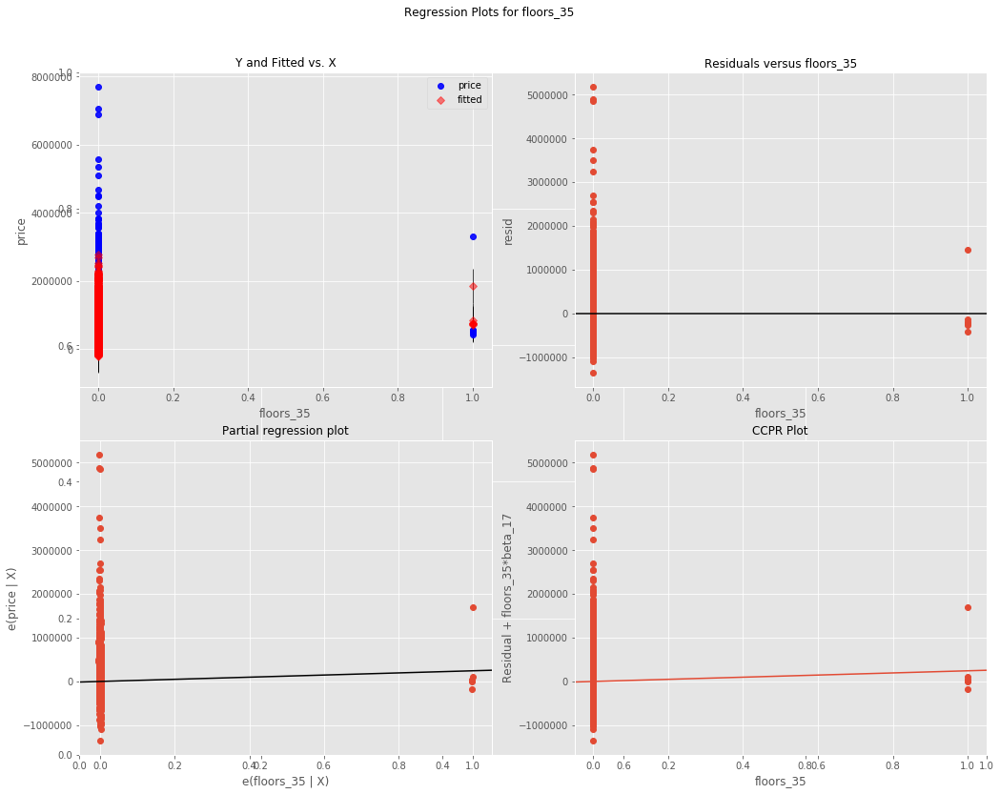

In [51]:
# evaluate residual plots
for col in X:
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, col, fig=fig)
    plt.show()

In [52]:
# Now run single variable regressions of each predictor

KC Housing DataSet - Regression Analysis and Diagnostics for price~price
-------------------------------------------------------------------------------------


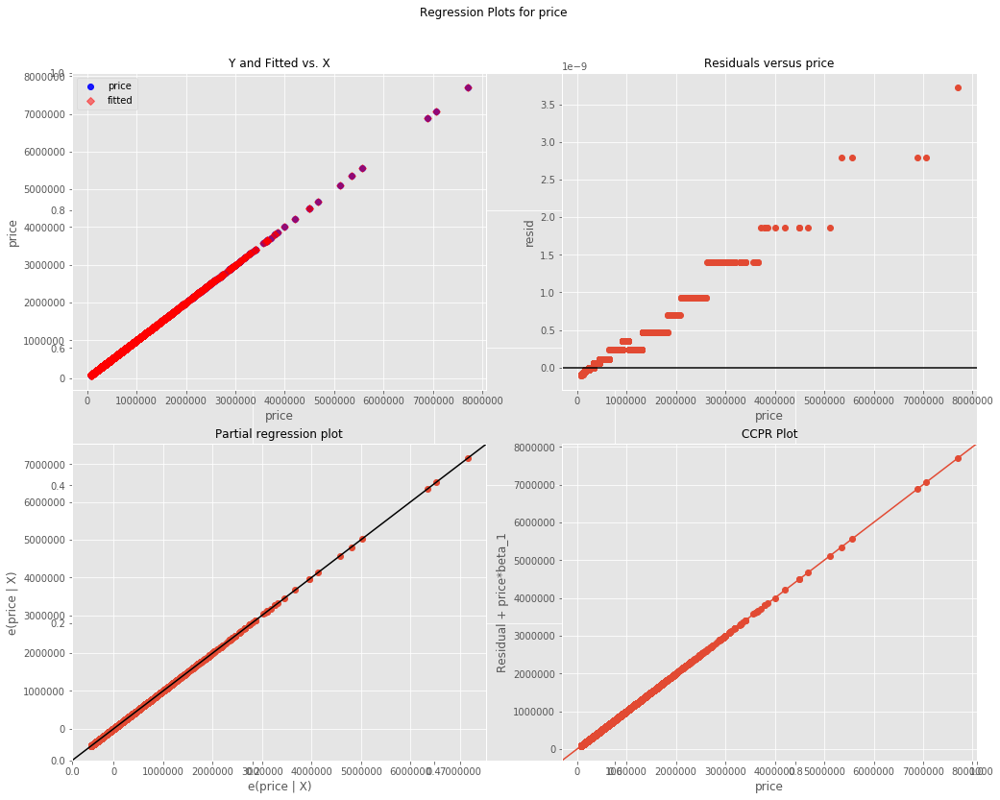

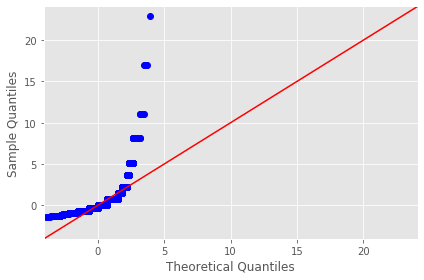

KC Housing DataSet - Regression Analysis and Diagnostics for price~view
-------------------------------------------------------------------------------------


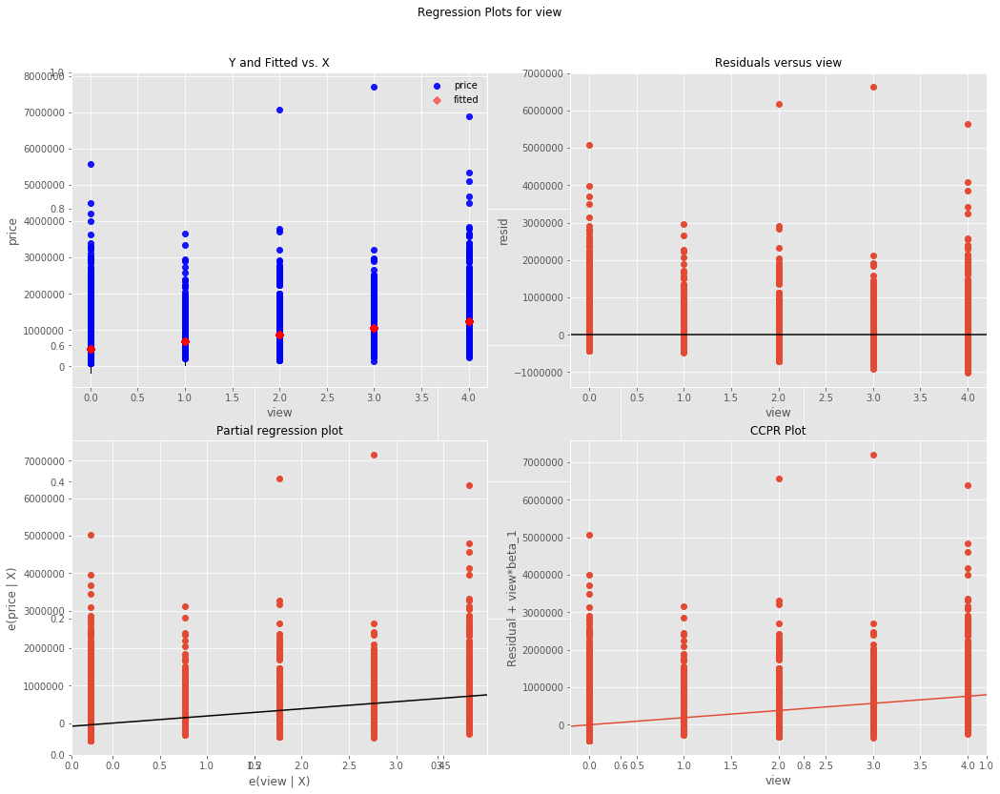

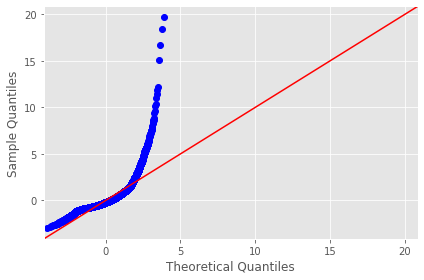

KC Housing DataSet - Regression Analysis and Diagnostics for price~sqft_living15
-------------------------------------------------------------------------------------


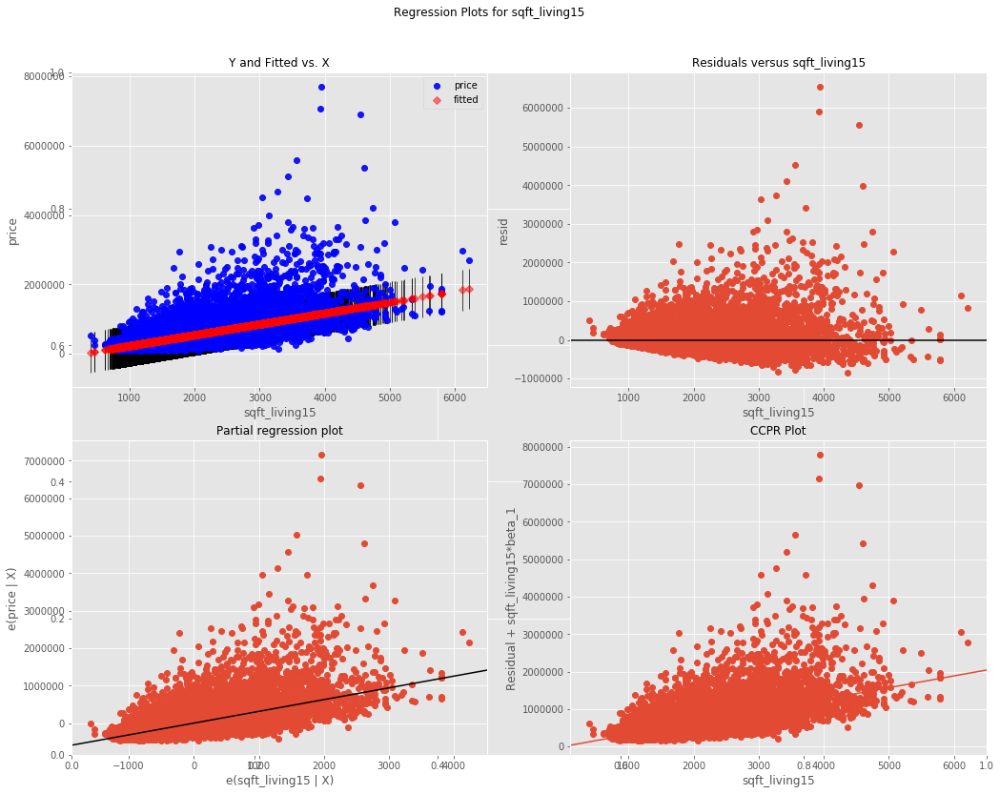

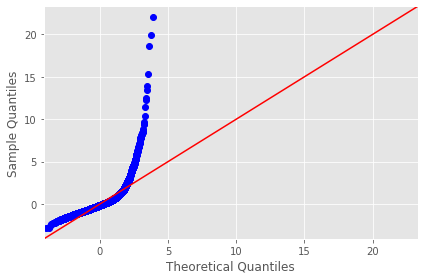

KC Housing DataSet - Regression Analysis and Diagnostics for price~bathrooms
-------------------------------------------------------------------------------------


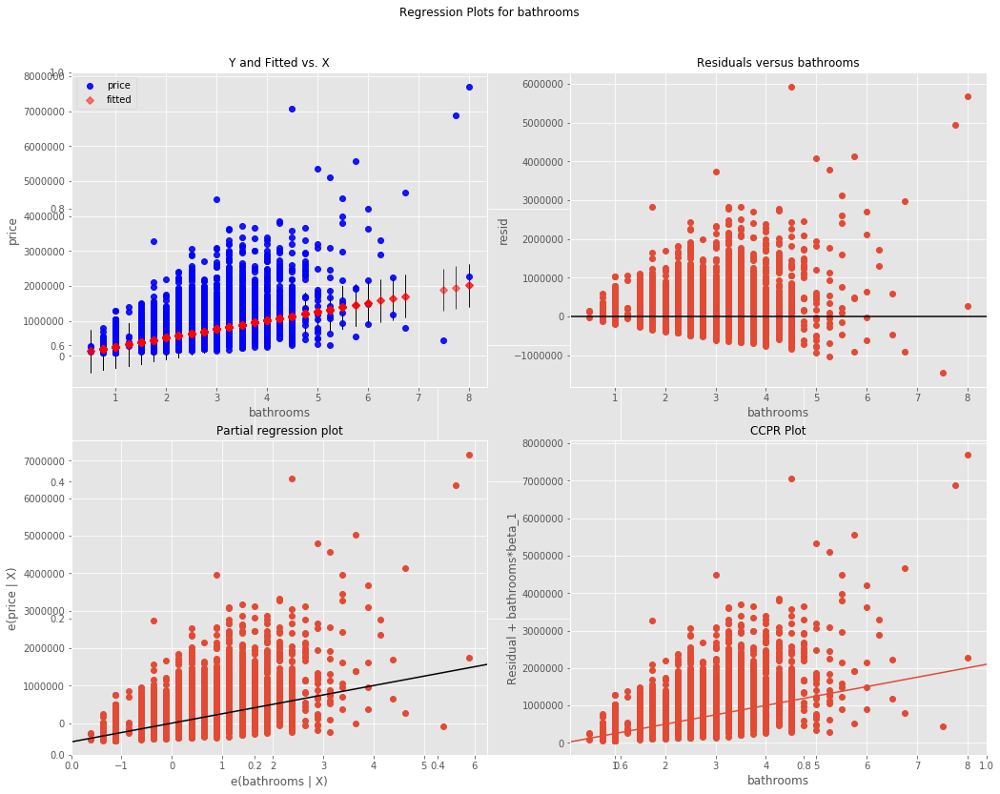

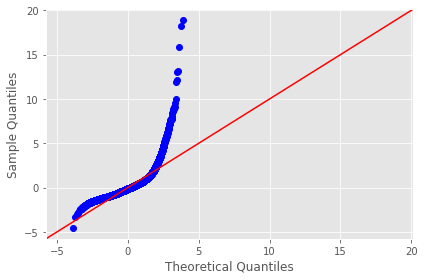

KC Housing DataSet - Regression Analysis and Diagnostics for price~grade
-------------------------------------------------------------------------------------


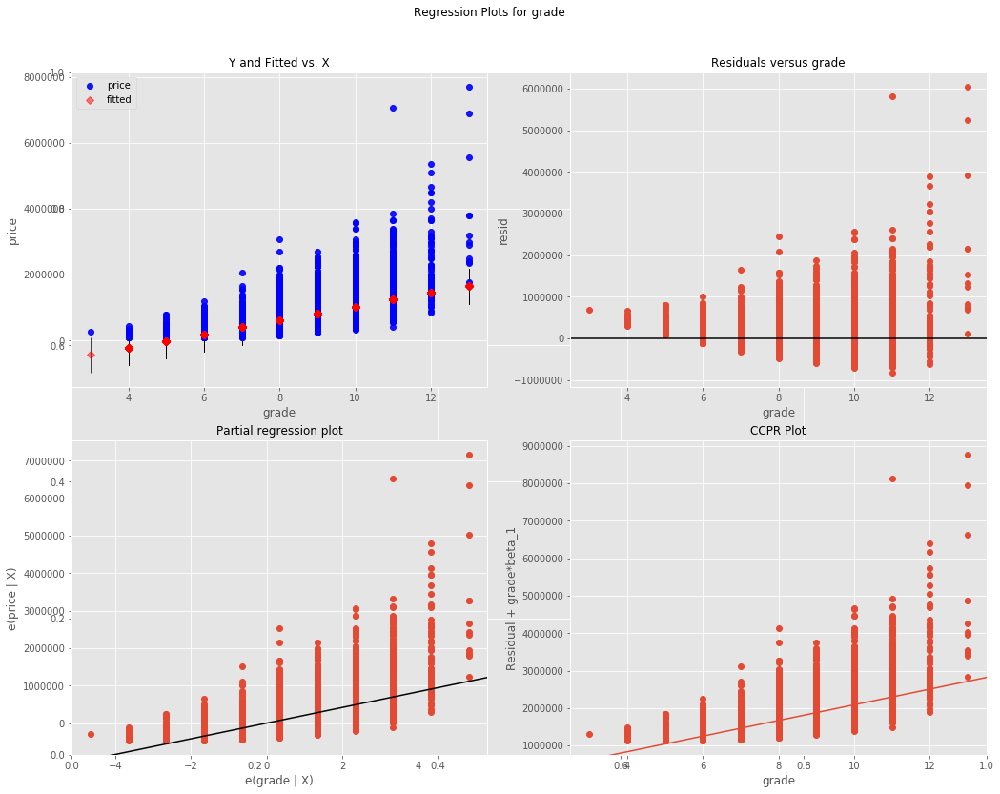

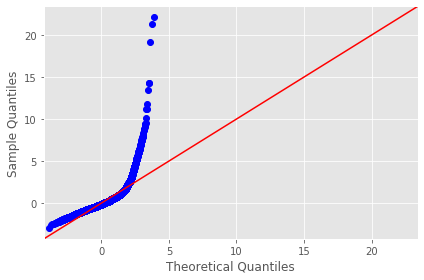

KC Housing DataSet - Regression Analysis and Diagnostics for price~sqft_basement
-------------------------------------------------------------------------------------


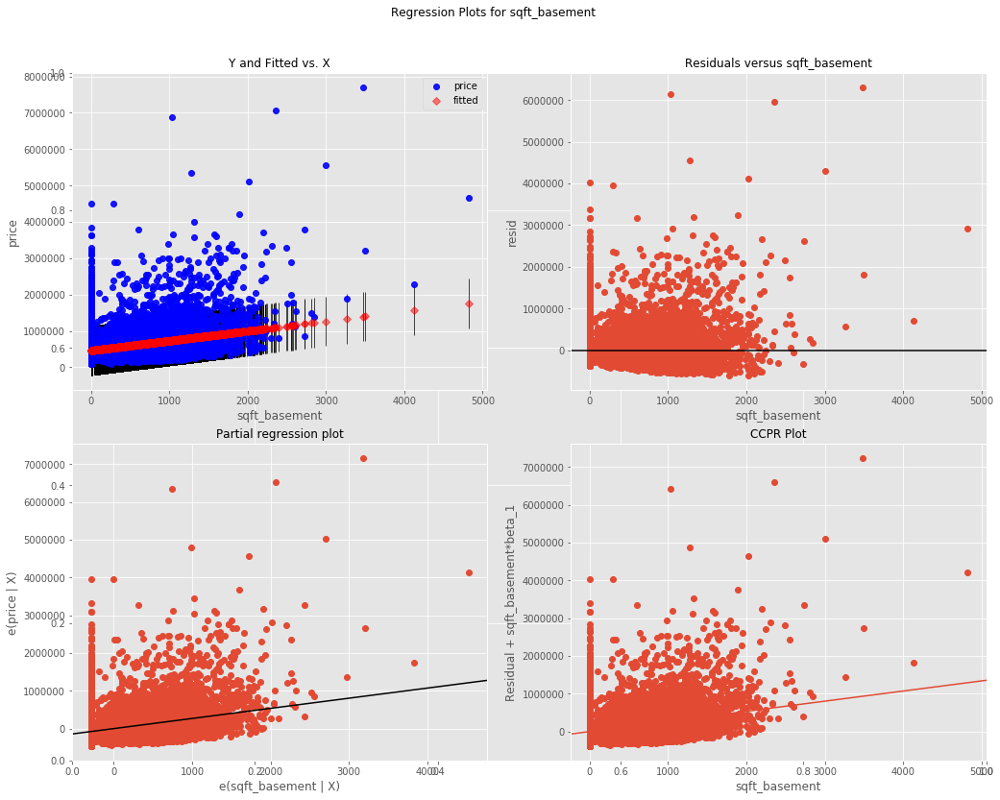

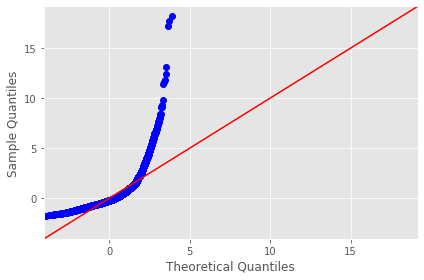

KC Housing DataSet - Regression Analysis and Diagnostics for price~waterfront_1
-------------------------------------------------------------------------------------


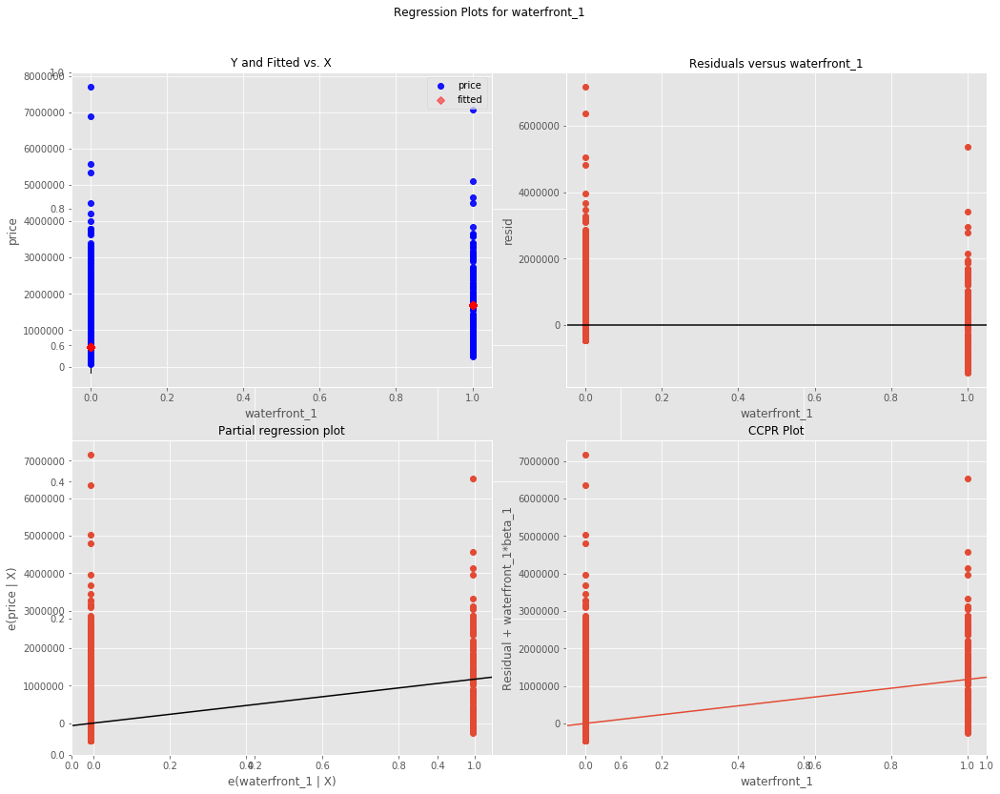

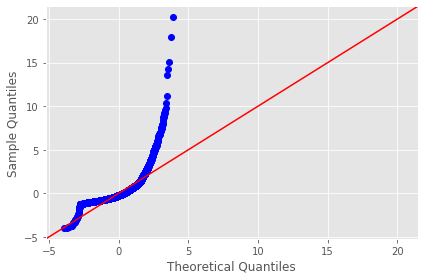

KC Housing DataSet - Regression Analysis and Diagnostics for price~floors_15
-------------------------------------------------------------------------------------


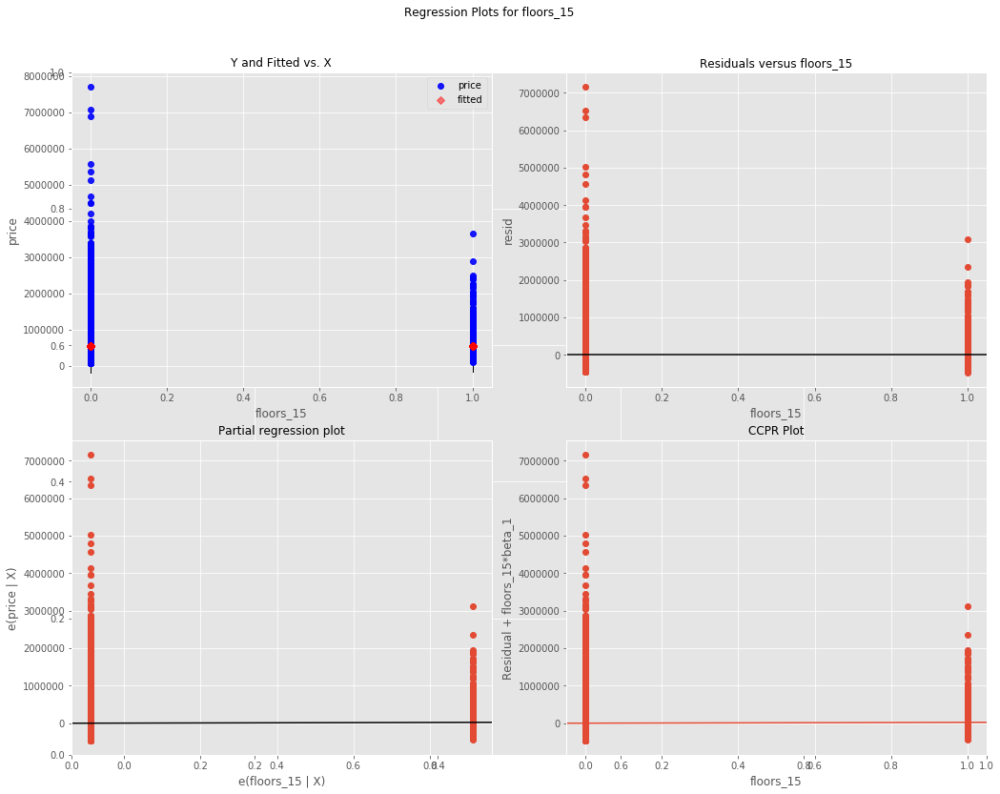

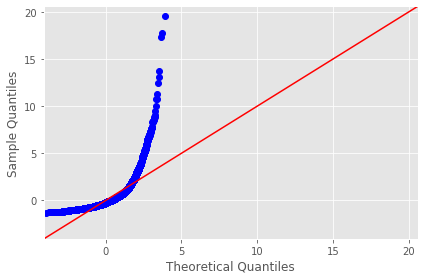

KC Housing DataSet - Regression Analysis and Diagnostics for price~condition_3
-------------------------------------------------------------------------------------


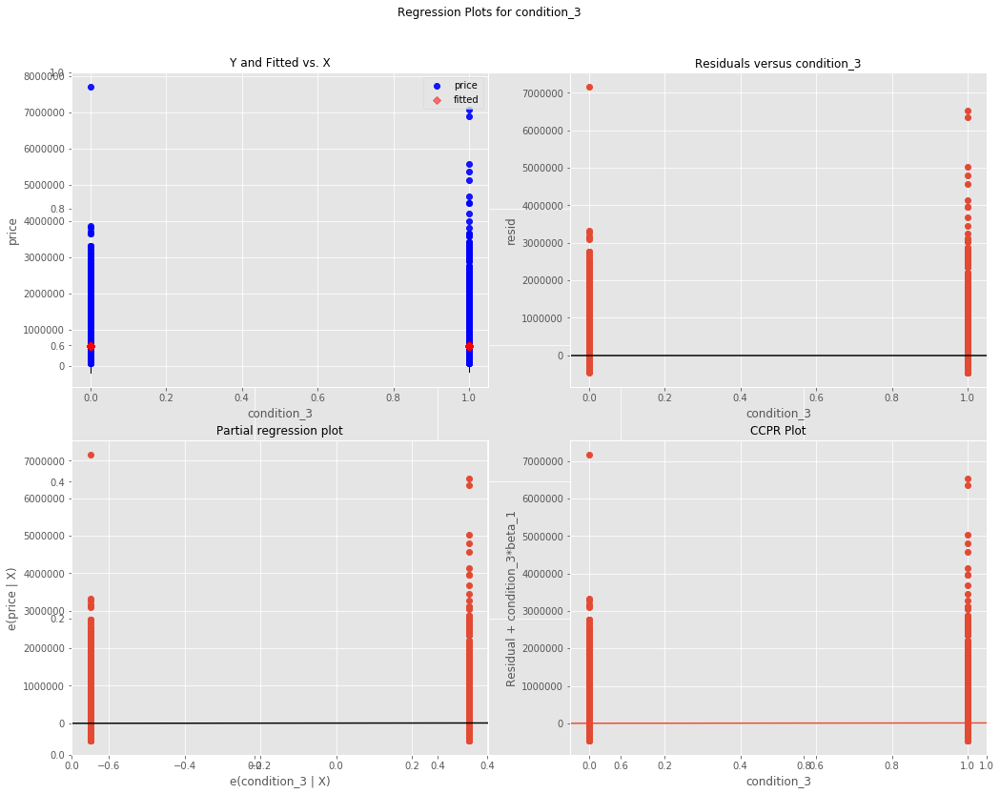

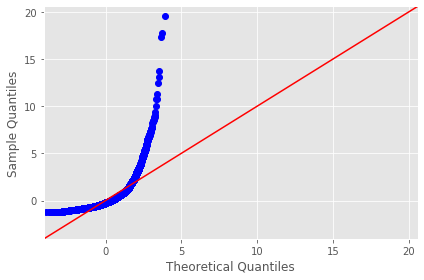

KC Housing DataSet - Regression Analysis and Diagnostics for price~floors_25
-------------------------------------------------------------------------------------


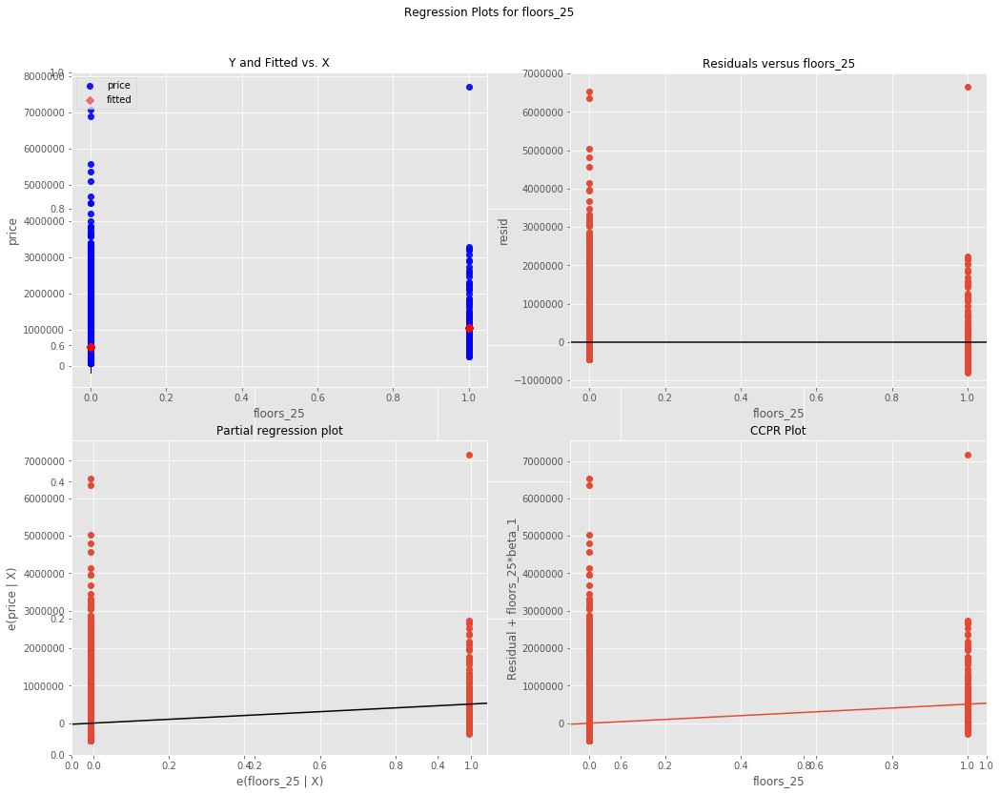

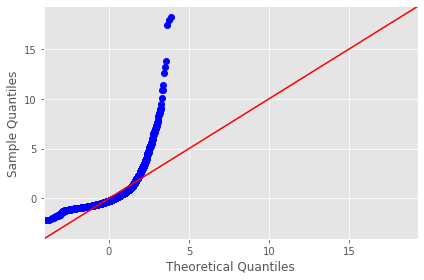

KC Housing DataSet - Regression Analysis and Diagnostics for price~condition_5
-------------------------------------------------------------------------------------


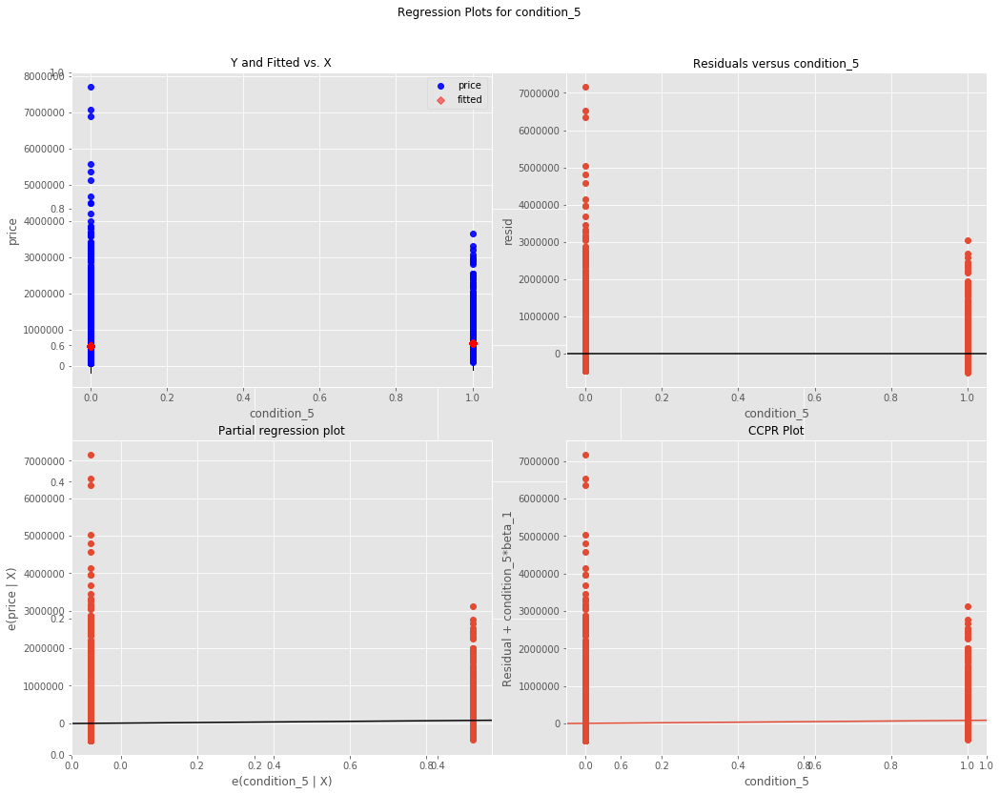

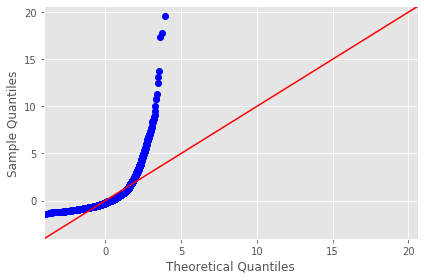

KC Housing DataSet - Regression Analysis and Diagnostics for price~month_sold_4
-------------------------------------------------------------------------------------


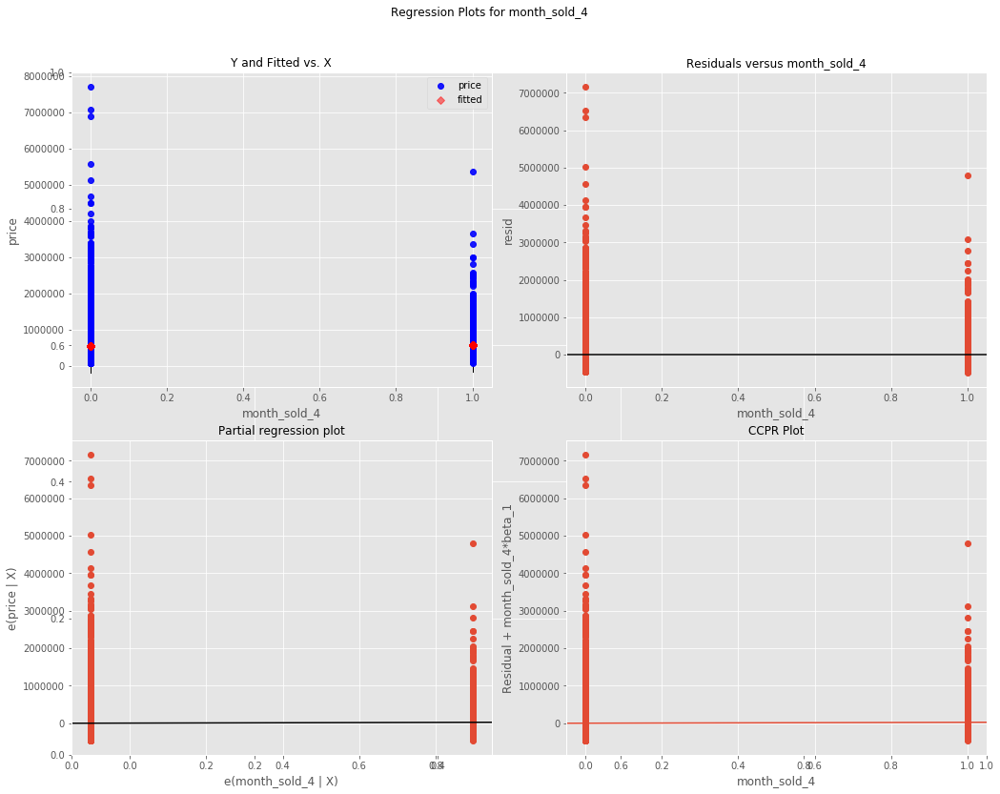

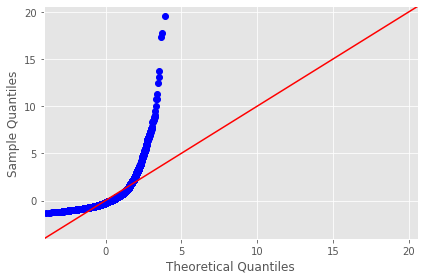

KC Housing DataSet - Regression Analysis and Diagnostics for price~month_sold_3
-------------------------------------------------------------------------------------


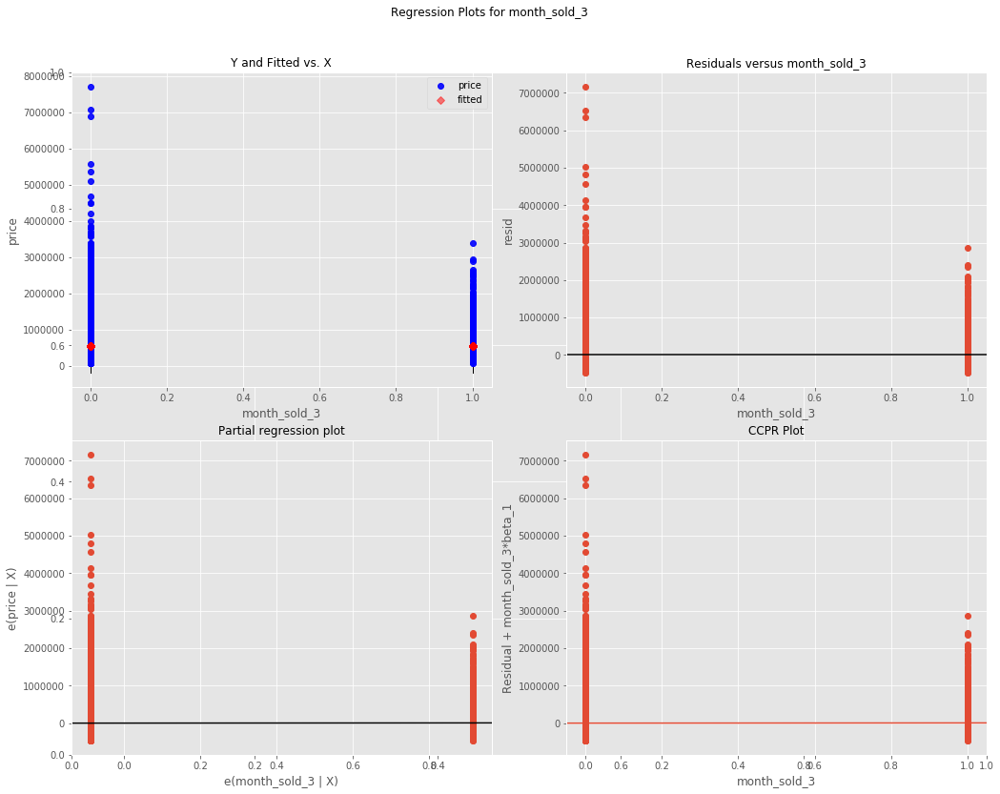

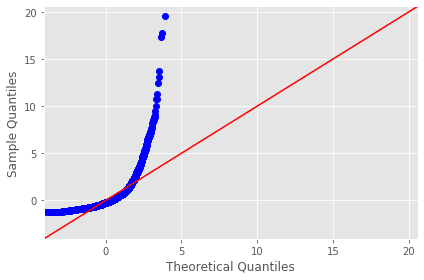

KC Housing DataSet - Regression Analysis and Diagnostics for price~bedrooms
-------------------------------------------------------------------------------------


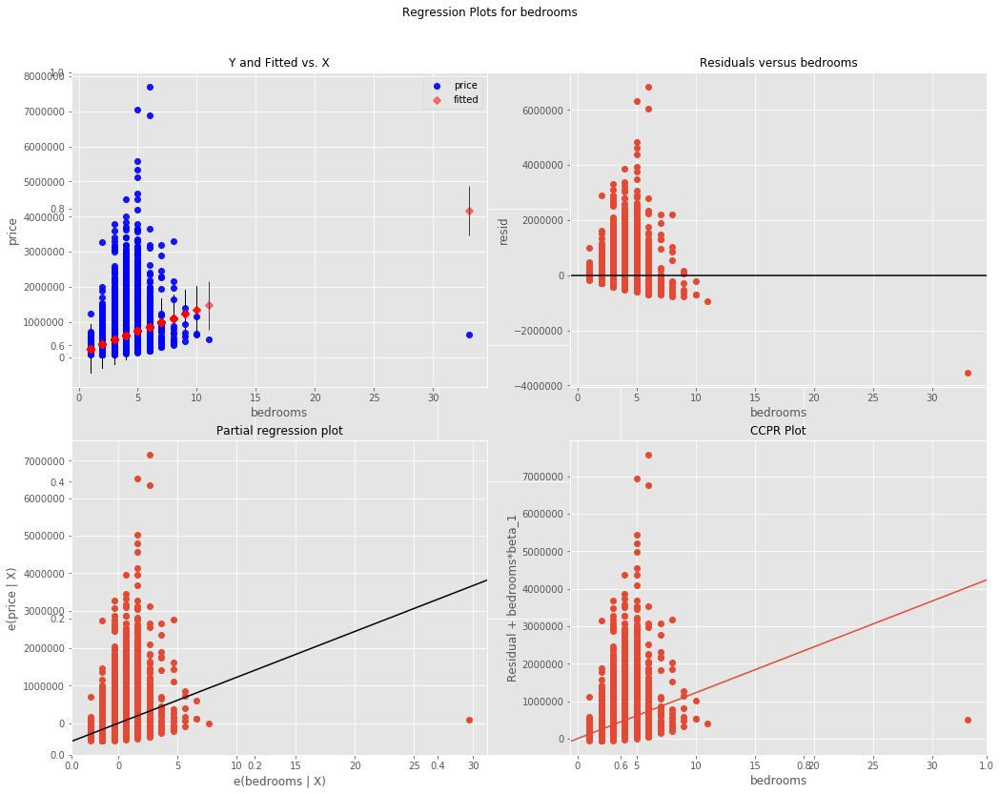

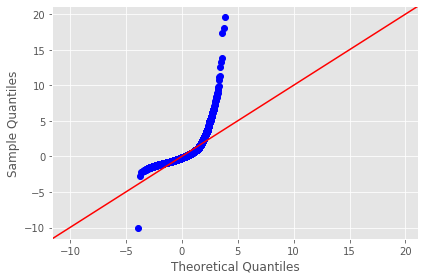

KC Housing DataSet - Regression Analysis and Diagnostics for price~floors_30
-------------------------------------------------------------------------------------


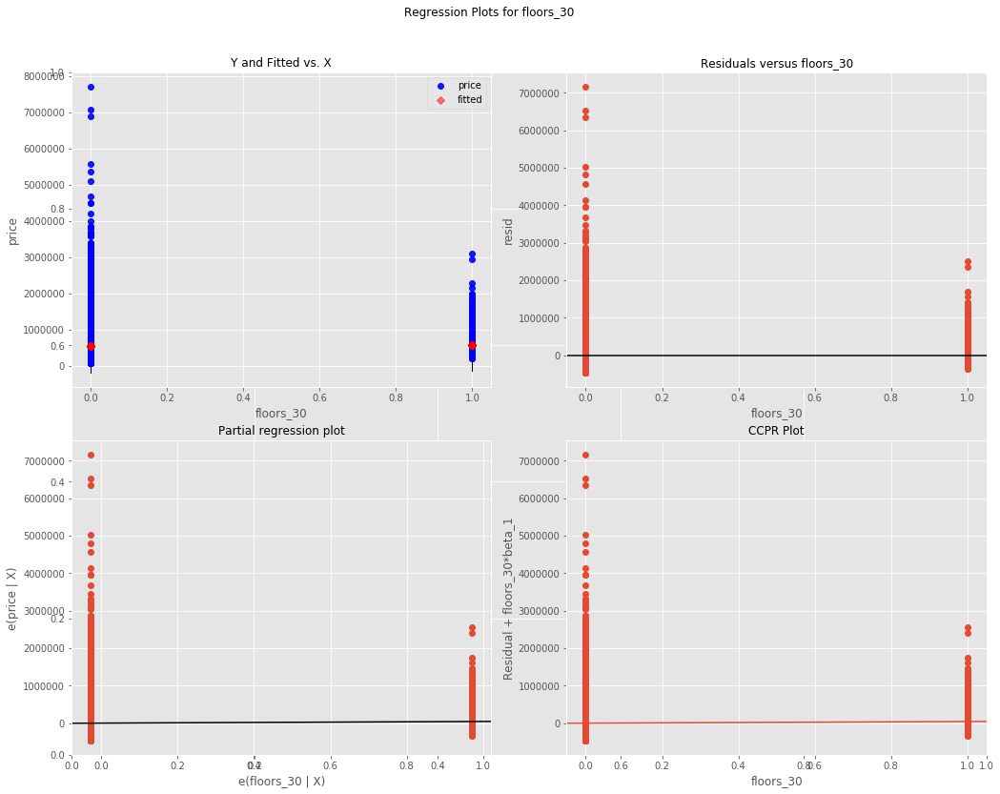

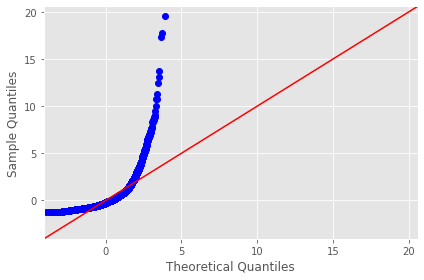

KC Housing DataSet - Regression Analysis and Diagnostics for price~day_sold_30
-------------------------------------------------------------------------------------


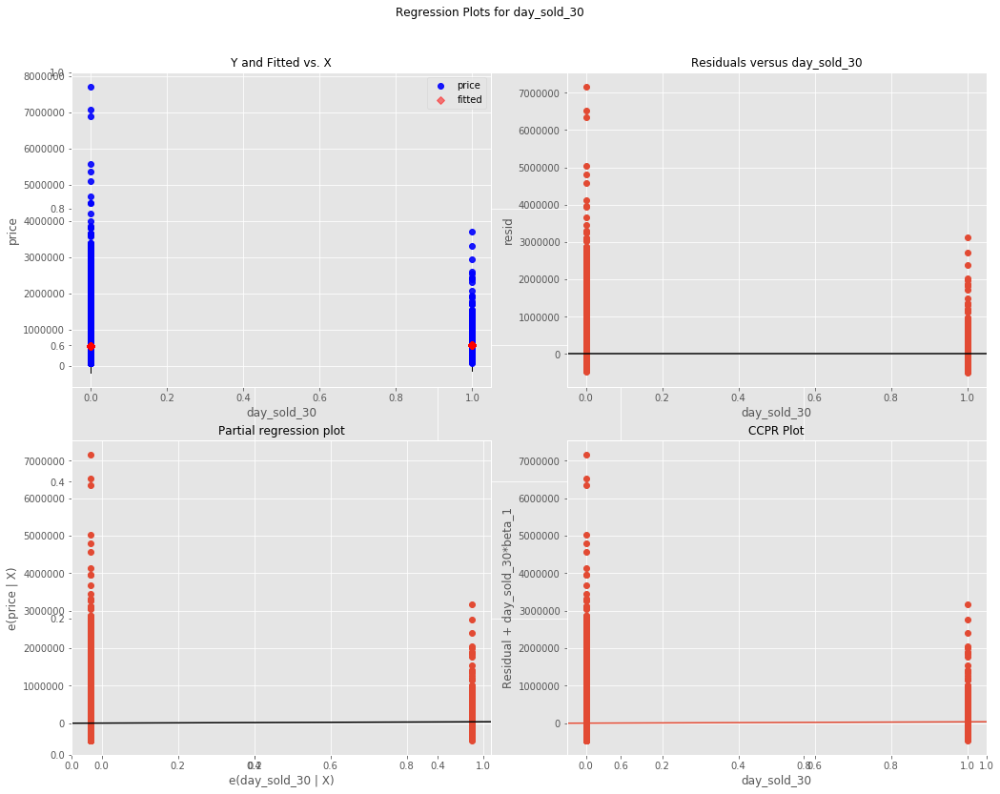

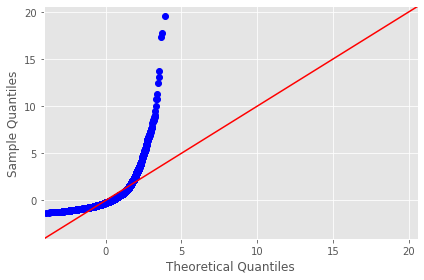

KC Housing DataSet - Regression Analysis and Diagnostics for price~day_sold_13
-------------------------------------------------------------------------------------


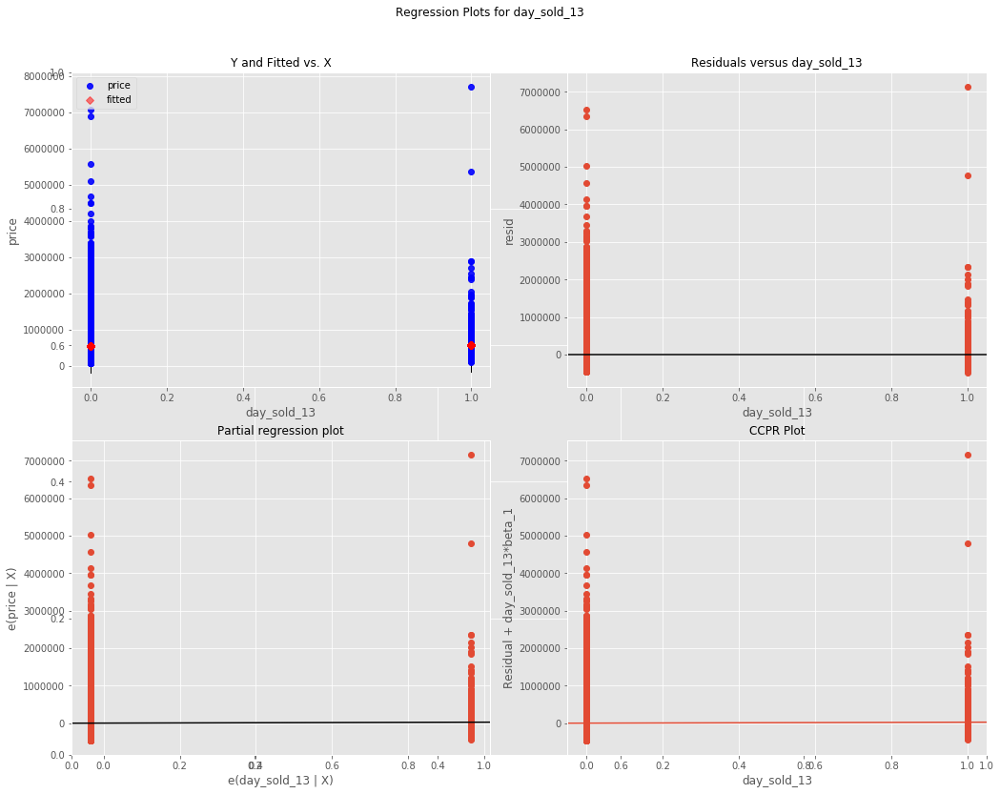

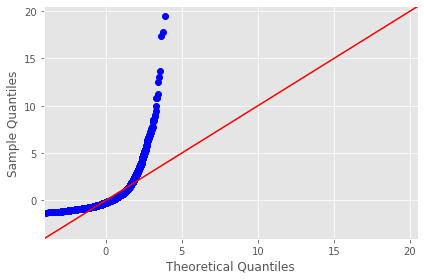

KC Housing DataSet - Regression Analysis and Diagnostics for price~floors_35
-------------------------------------------------------------------------------------


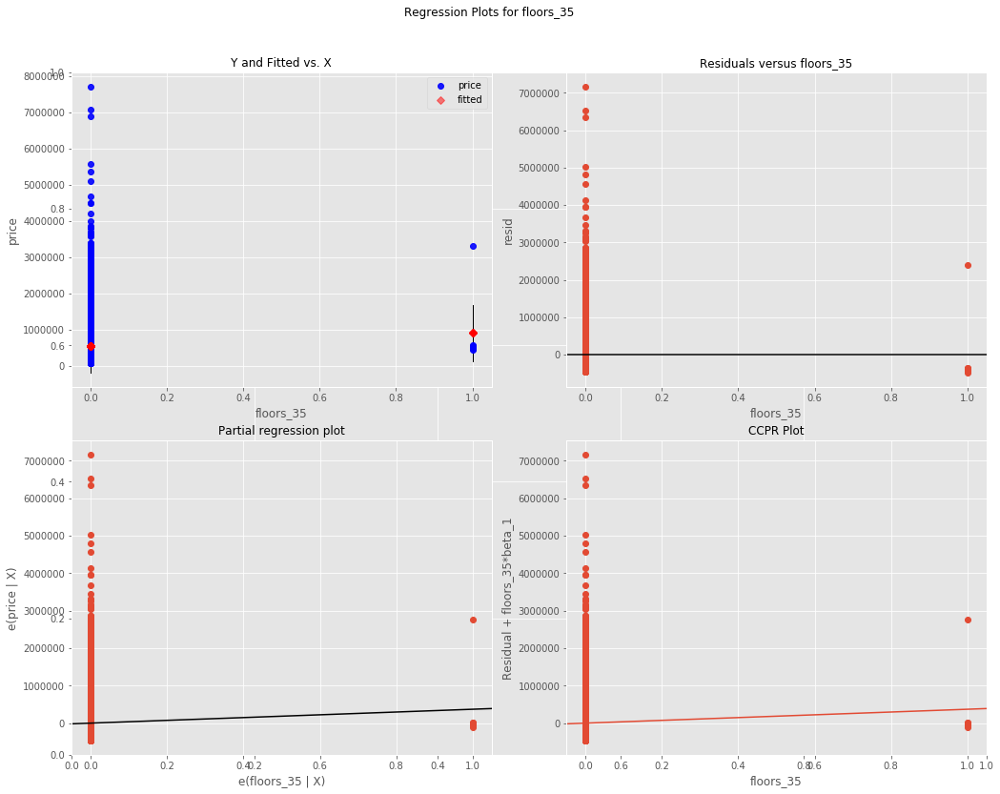

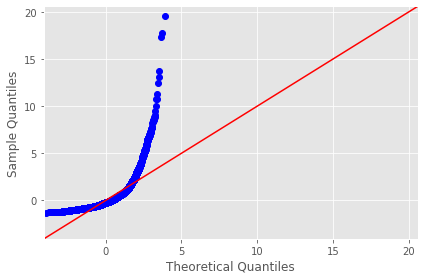

In [53]:
# evaluate residuals to further check assumptions
dataset = pd.concat([y, X], axis=1)
results = []
y = 'price'
for idx, column in enumerate(dataset.columns):
    print (f"KC Housing DataSet - Regression Analysis and Diagnostics for {y}~{column}")
    print ("-------------------------------------------------------------------------------------")

    f = f'{y}~{column}'
    model = smf.ols(formula=f, data=dataset).fit()
    
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, column, fig=fig)
    fig = sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True)
    fig.tight_layout()
    plt.show()
    
    results.append([column, model.rsquared, model.params[0], model.params[1], model.pvalues[1], sms.jarque_bera(model.resid)[0]])

While the plots above are super helpful to evaluate each predictor by itself, throwing results of our baseline model into a table will make go-forward comparison easier.  Store baseline results in `baseline_results`

In [54]:
# store results in dataframe to make future comparison easy
baseline_results = pd.DataFrame(results, columns=['ind_var', 
                                                  'r_squared', 
                                                  'intercept', 
                                                  'slope', 
                                                  'p-value', 
                                                  'normality (JB)'])

In [55]:
baseline_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price,1.000000,1.282388e-10,1.000000e+00,0.000000e+00,2.424683e+06
1,view,0.157749,4.958248e+05,1.903854e+05,0.000000e+00,9.889957e+05
2,sqft_living15,0.343976,-8.313991e+04,3.137457e+02,0.000000e+00,1.844816e+06
3,bathrooms,0.275655,9.863874e+03,2.506635e+05,0.000000e+00,8.493976e+05
4,grade,0.446356,-1.058339e+06,2.087549e+05,0.000000e+00,1.955187e+06
5,sqft_basement,0.104340,4.621605e+05,2.680065e+02,0.000000e+00,8.504000e+05
6,waterfront_1,0.068005,5.323996e+05,1.173309e+06,0.000000e+00,8.935611e+05
7,floors_15,0.000267,5.383832e+05,2.114672e+04,1.761860e-02,1.079274e+06
8,condition_3,0.000091,5.354827e+05,7.337756e+03,1.656503e-01,1.075019e+06
9,floors_25,0.013985,5.365267e+05,5.092809e+05,1.578176e-66,9.976328e+05


As expected, from looking at the q-q plots and JB column of the above table, we can see that our assumption of normally distributed residuals is not met.  From this it doesn't look like any of our predictors are viable for regression. Will need more preprocessing / data transformation to improve results, but this will be a good baseline to compare our next model to.

## Model 2

Now that we have a baseline in place, we can start trying to improve our results against the baseline.  This shouldn't be too difficult given how messy our plots against and residual plots were looking.  To begin, we will revert back to `clean_data` which includes our initial clean up changes to fix missing values and erroneous values, etc.

In the next two models, I will be focusing on transforming only the target variable to see if that improves linearity and residual normality / homoscedasticity.  The first is a simple log transformation, and the second is a boxcox, which seems more robust for data that may not be completely log distributed.  

In terms of process, first make price transformations, repeat steps from baseline model, and re-evaluate results and see if assumptions for regression are looking better.

In [56]:
# revert back to clean data 
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21082 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   price          21082 non-null  float64
 1   bedrooms       21082 non-null  int64  
 2   bathrooms      21082 non-null  float64
 3   sqft_living    21082 non-null  int64  
 4   sqft_lot       21082 non-null  int64  
 5   floors         21082 non-null  float64
 6   waterfront     21082 non-null  float64
 7   view           21082 non-null  float64
 8   condition      21082 non-null  int64  
 9   grade          21082 non-null  int64  
 10  sqft_above     21082 non-null  int64  
 11  sqft_basement  21082 non-null  float64
 12  yr_built       21082 non-null  int64  
 13  yr_renovated   21082 non-null  float64
 14  zipcode        21082 non-null  int64  
 15  lat            21082 non-null  float64
 16  long           21082 non-null  float64
 17  sqft_living15  21082 non-null  int64  
 18  sqft_l

Start by looking at the distribution of price and see how that will change with the different transformations.

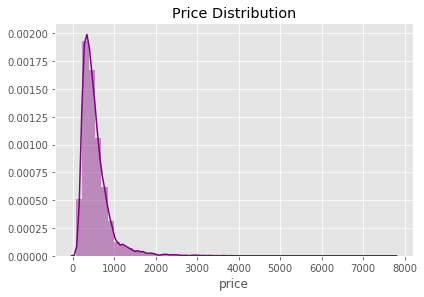

In [57]:
# price distribution
sns.distplot(clean_data['price']/1000, color='purple')
plt.tight_layout()
plt.title('Price Distribution')
plt.show()

We can see that there is significant right skew and there appear to be a number of outliers to the right.  This looks like it would benefit from log transformation, so we will begin with that.

In [58]:
# log transform
clean_data['log_price'] = np.log(clean_data['price'])

Second transformation on price will be using `stats.boxcox`.  This allows a power transformation to be applied, and a subsequent lambda value returned.  A lambda value of 0 represents a true log transformation.  A non-zero lambda value implies a lambda power transformation.  

In [59]:
# boxcox transformation
clean_data['price_boxcox'], fitted_lamba_0 = stats.boxcox(x=clean_data['price'])
print(f'Fitted lambda value: {fitted_lamba_0}')

Fitted lambda value: -0.23781570193294282


A fitted lambda value implies the transformation applied raises vall values to -0.238.  Now plot distributions of both transformed columns next to each other and see if one looks more normally distributed.

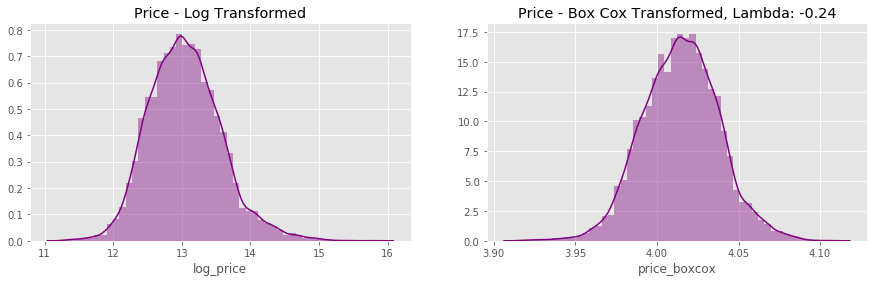

In [60]:
# plot log_price and price_boxcox 
fig, axes = plt.subplots(ncols=2, nrows=1, figsize=(15, 4))
prices = clean_data[['log_price', 'price_boxcox']]

for col, ax in zip(prices, axes):
    sns.distplot(prices[col], ax=ax, color='purple')
    
axes[0].set_title('Price - Log Transformed')
axes[1].set_title(f'Price - Box Cox Transformed, Lambda: {round(fitted_lamba_0, 2)}')
plt.show()

From a visual inspection, it looks like boxcox tranformed price is better, with less right skew

In [61]:
# drop price for now
preprocessed = clean_data.drop('price', axis=1)

In [62]:
preprocessed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21082 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       21082 non-null  int64  
 1   bathrooms      21082 non-null  float64
 2   sqft_living    21082 non-null  int64  
 3   sqft_lot       21082 non-null  int64  
 4   floors         21082 non-null  float64
 5   waterfront     21082 non-null  float64
 6   view           21082 non-null  float64
 7   condition      21082 non-null  int64  
 8   grade          21082 non-null  int64  
 9   sqft_above     21082 non-null  int64  
 10  sqft_basement  21082 non-null  float64
 11  yr_built       21082 non-null  int64  
 12  yr_renovated   21082 non-null  float64
 13  zipcode        21082 non-null  int64  
 14  lat            21082 non-null  float64
 15  long           21082 non-null  float64
 16  sqft_living15  21082 non-null  int64  
 17  sqft_lot15     21082 non-null  int64  
 18  year_s

Plot all continuous predictors against `log_price` and then `price_boxcox` to see if:
1. Linearity relationships have improved over the baseline model
2. There is a noticeable difference between `log_price` and `price_boxcox`

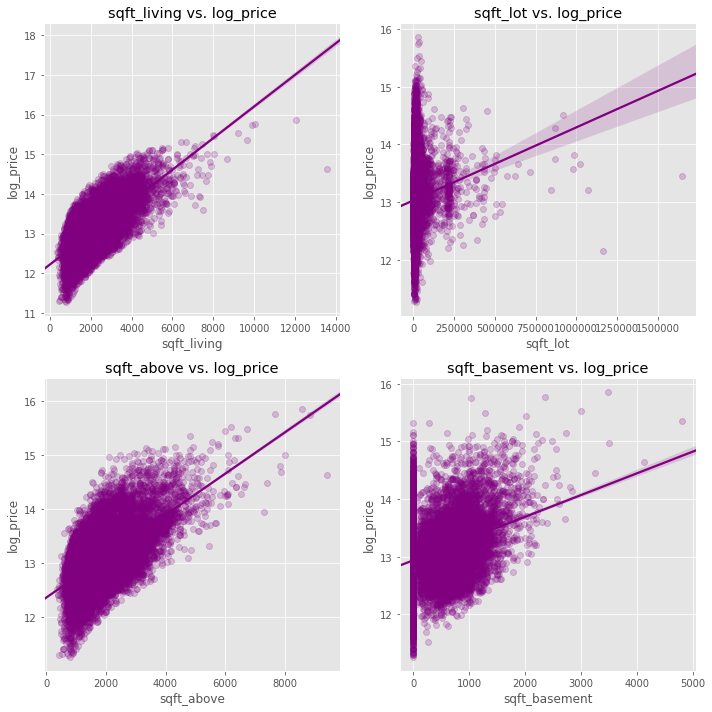

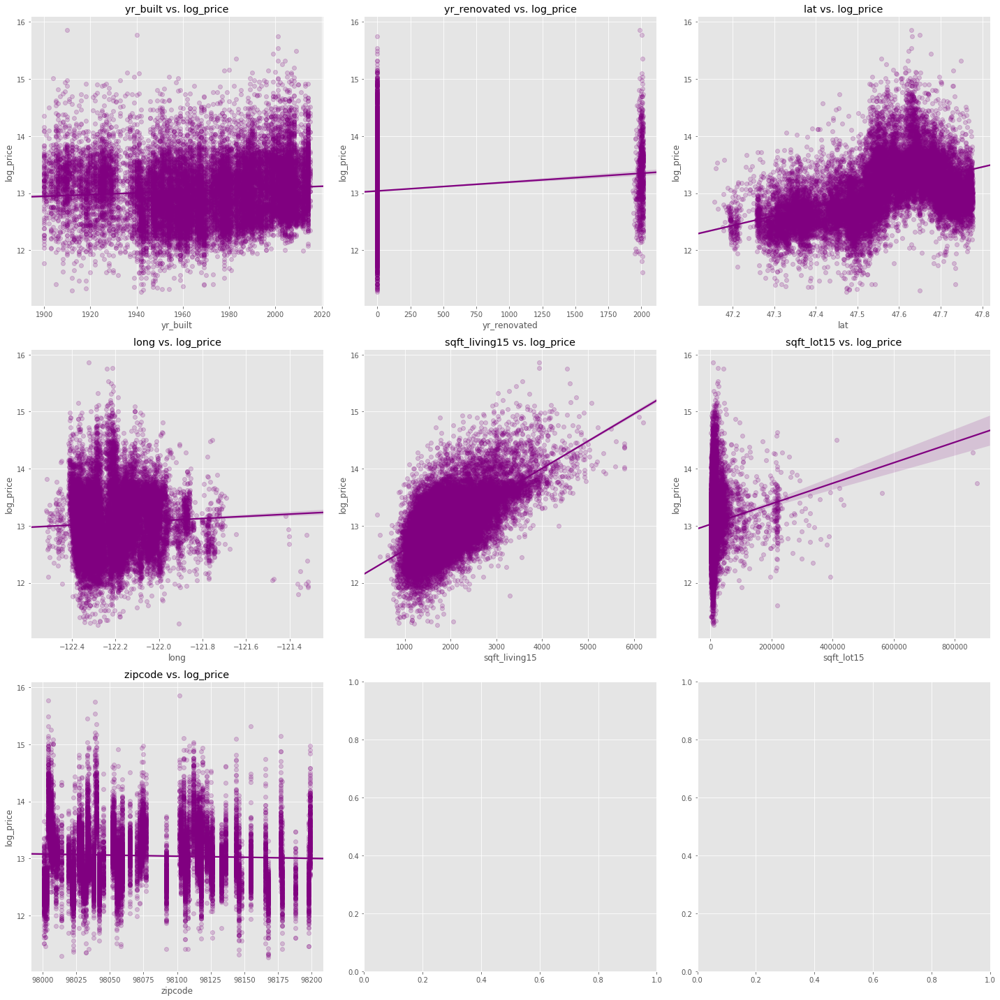

In [63]:
# plot all continuos against log_price
variables = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement']
variables_2 = ['yr_built', 'yr_renovated', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'zipcode']

plot_viz(data=preprocessed,
         target='log_price',
         predictors=variables,
         nrows=2,
         ncols=2,
         figsize=(10, 10))

plot_viz(data=preprocessed,
         target='log_price',
         predictors=variables_2,
         nrows=3,
         ncols=3,
         figsize=(20, 20))

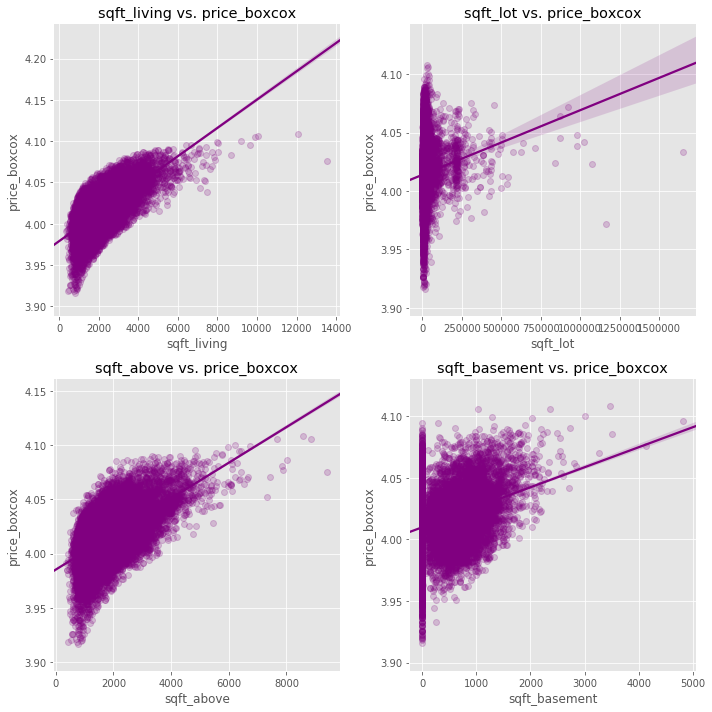

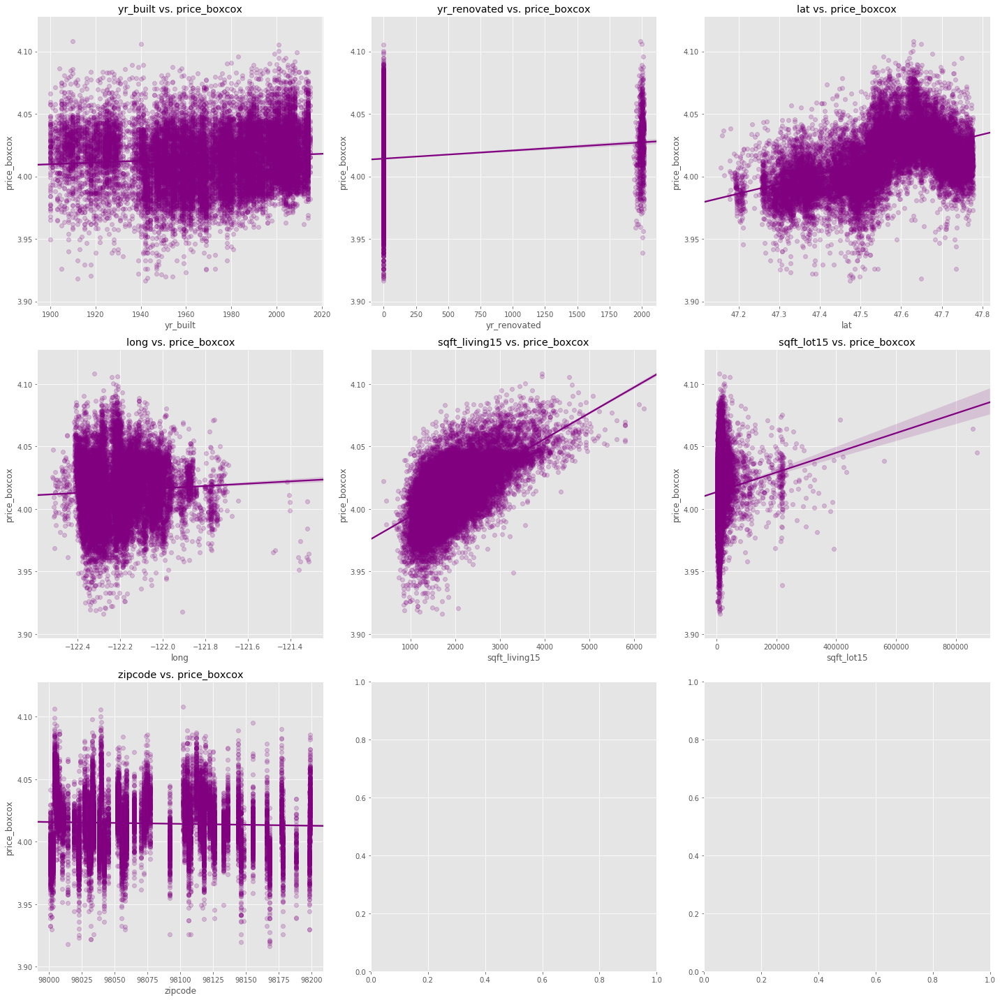

In [64]:
# repeat for price_boxcox
plot_viz(data=preprocessed,
         target='price_boxcox',
         predictors=variables,
         nrows=2,
         ncols=2,
         figsize=(10, 10))

plot_viz(data=preprocessed,
         target='price_boxcox',
         predictors=variables_2,
         nrows=3,
         ncols=3,
         figsize=(20, 20))

Variables are definitely looking more linear than when plotted against non-transformed price. No clear difference between the relationships on `log_price` and `price_boxcox`. Drop non-linear. 

In [65]:
# drop clear non-linear columns
preprocessed = preprocessed.drop(['sqft_lot', 
                                  'yr_built', 
                                  'zipcode', 
                                  'lat', 
                                  'long', 
                                  'sqft_lot15'], axis=1)

In [66]:
# identify and remove any multi-collinearity
data_pred = preprocessed.drop(['log_price', 'price_boxcox'], axis=1)
correlated_predictors = multi_collinearity(data_pred, 0.75)
correlated_predictors

,cc
pairs,
"(sqft_living, sqft_above)",0.876787
"(year_sold, month_sold)",0.781941
"(sqft_living, grade)",0.762719
"(sqft_above, grade)",0.756289
"(sqft_living, sqft_living15)",0.756199
"(sqft_living, bathrooms)",0.754793


In [67]:
# drop sqft_living, year_sold, sqft_above
preprocessed = preprocessed.drop(['sqft_living', 'year_sold', 'sqft_above'], axis=1)

In [68]:
preprocessed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21082 entries, 0 to 21596
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       21082 non-null  int64  
 1   bathrooms      21082 non-null  float64
 2   floors         21082 non-null  float64
 3   waterfront     21082 non-null  float64
 4   view           21082 non-null  float64
 5   condition      21082 non-null  int64  
 6   grade          21082 non-null  int64  
 7   sqft_basement  21082 non-null  float64
 8   yr_renovated   21082 non-null  float64
 9   sqft_living15  21082 non-null  int64  
 10  month_sold     21082 non-null  int64  
 11  day_sold       21082 non-null  int64  
 12  log_price      21082 non-null  float64
 13  price_boxcox   21082 non-null  float64
dtypes: float64(8), int64(6)
memory usage: 3.0 MB


Given the number of zeros on yr_renovated, going to translate this into a categorical column relating to whether a house has received a renovation or not.  Then, one-hot encode.

In [69]:
# create renovated column
preprocessed['renovated'] = preprocessed['yr_renovated'].apply(lambda x: 1 if x > 0 else 0)

# drop yr_renovated column
preprocessed.drop('yr_renovated', axis=1, inplace=True)

Start handling categorical columns similar to what we did in the baseline model

In [70]:
# evaluate and handle categorical columns
# create boxplots for all cat columns --  see if price transformations have helped
# start with log
cat_cols = ['bedrooms', 'bathrooms', 'floors', 'waterfront', 'view', 'condition', 
            'grade', 'month_sold', 'day_sold', 'renovated']
cat_predictors = preprocessed[cat_cols]

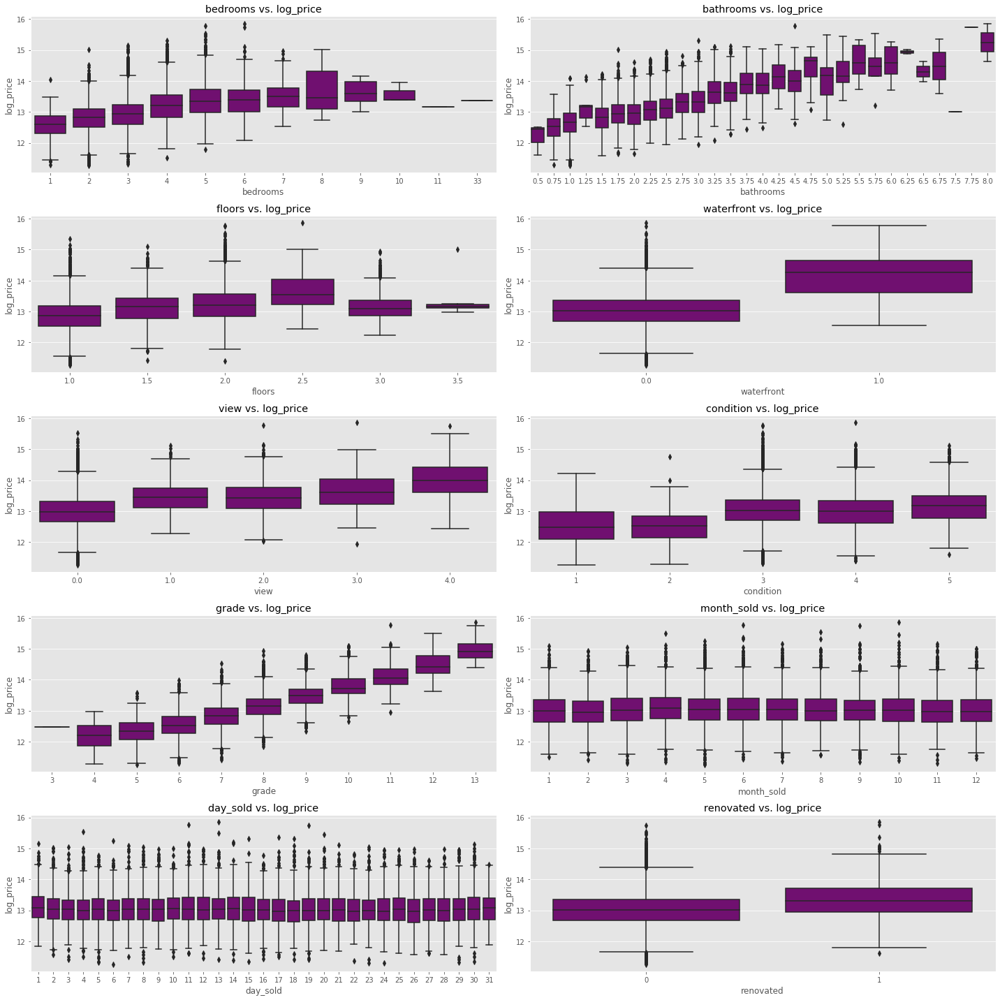

In [71]:
# plot boxplots of all cat columns vs. log_price
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
for ax, feature in zip(axes.flatten(), cat_predictors):
    sns.boxplot(x=feature, y='log_price', data=preprocessed, ax=ax, color='purple');
    ax.set_title(f'{feature} vs. log_price')
    
plt.tight_layout()

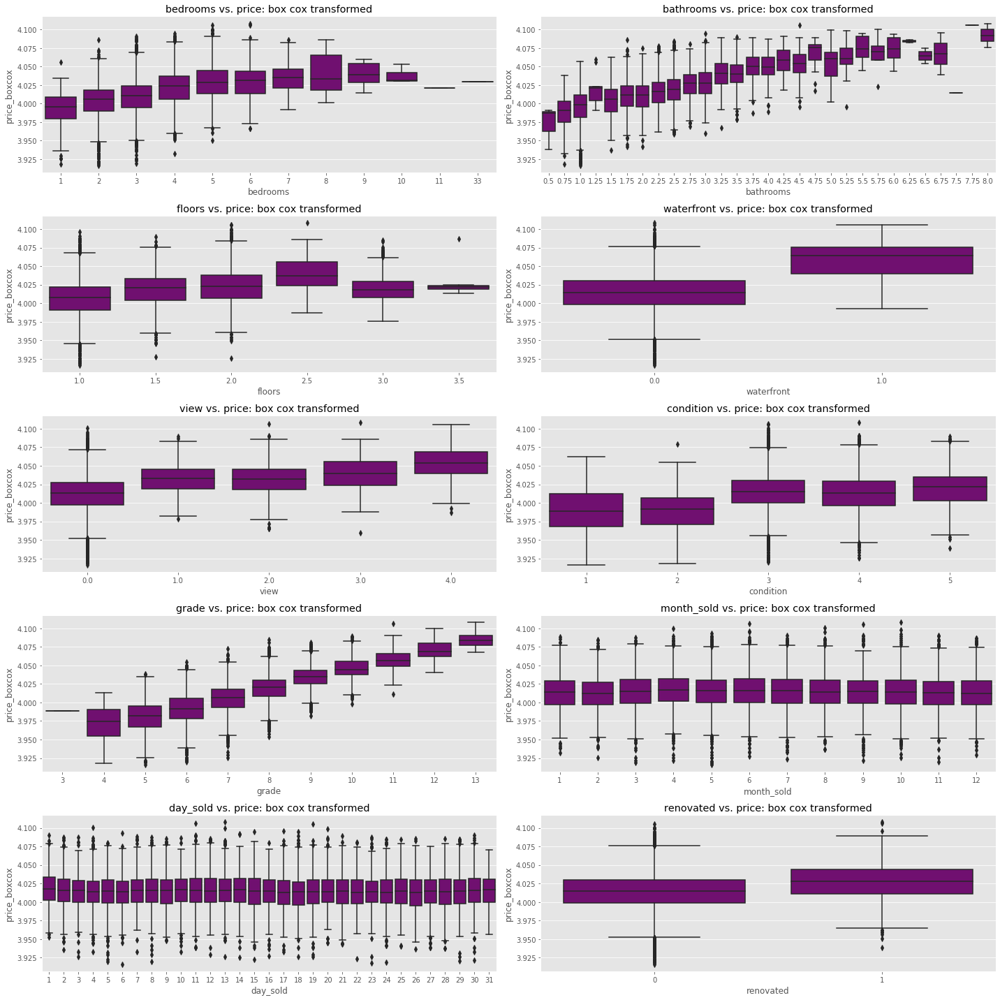

In [72]:
# plot boxplots of all cat columns vs. price_boxcox
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
for ax, feature in zip(axes.flatten(), cat_predictors):
    sns.boxplot(x=feature, y='price_boxcox', data=preprocessed, ax=ax, color='purple');
    ax.set_title(f'{feature} vs. price: box cox transformed')

plt.tight_layout()

### Question 2 - Is it beneficial to sell a house during specific times of the year?
Looking at the above boxplots plotted against price, it is hard to identify a clear relationship with time of year and sale price, but let's zoom in on month_sold to see if any relationship is clear

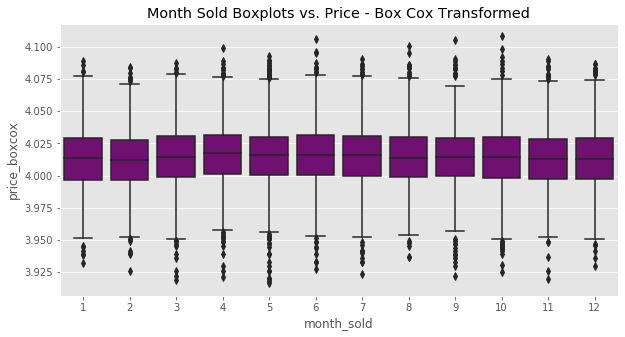

In [73]:
plt.figure(figsize=(10, 5))
sns.boxplot(x='month_sold', y='price_boxcox', data=preprocessed, color='purple');
plt.title('Month Sold Boxplots vs. Price - Box Cox Transformed')
plt.show()

There appears to be a slight benefit to selling in the spring months - - looking at the above plot, month 3, 4, and 5 seem to be correlated with higher median sale price

### Question 3 - Is KC generated `grade` and  `condition` accurate in predicting sale price?
Looking at boxplots of grade and condition vs. price, we can see that houses with both high grades and high condition scores appear correlated with higher house sale prices (boxcox).  

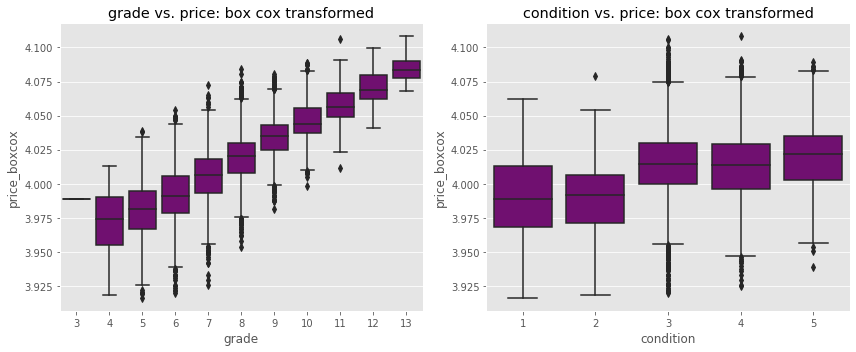

In [74]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
variables = preprocessed[['grade', 'condition']]

for ax, feature in zip(axes.flatten(), variables):
    sns.boxplot(x=feature, y='price_boxcox', data=preprocessed, ax=ax, color='purple');
    ax.set_title(f'{feature} vs. price: box cox transformed')
    
plt.tight_layout()

Looking at grade, we see an ordinal relationship, with a clear positive relationship between higher grades and higher sale price.  Similarly, while not as obvious, higher condition scores seem to be correlated with higher sale price.  Looking at the above, one can see that condition scores 3, 4, 5 have median sale prices higher than those with condition scores of 1 and 2. 

In [75]:
ohe_list

['floors_10', 'waterfront', 'condition', 'month_sold', 'day_sold']

In [76]:
ordinal_cat_cols = ['bedrooms', 'bathrooms', 'grade']
ordinal_predictors = preprocessed[ordinal_cat_cols]

In [77]:
# clean up ohe columns to avoid syntax errors going forward
# floors
preprocessed['floors_10'] = preprocessed['floors'] * 10
preprocessed['floors_10'] = preprocessed['floors_10'].astype('int')
preprocessed.drop('floors', axis=1, inplace=True)

# waterfront
preprocessed['waterfront'] = preprocessed['waterfront'].astype('int')
preprocessed['view'] = preprocessed['view'].astype('int')

ohe_list = ['floors_10', 'waterfront', 'view', 'condition',
            'month_sold', 'day_sold', 'renovated']

In [78]:
# create dummy variables
floors_dummies = pd.get_dummies(preprocessed['floors_10'], prefix='floors', drop_first=True)
water_dummies = pd.get_dummies(preprocessed['waterfront'], prefix='water', drop_first=True)
view_dummies = pd.get_dummies(preprocessed['view'], prefix='view', drop_first=True)
condition_dummies = pd.get_dummies(preprocessed['condition'], prefix='condition', drop_first=True)
month_dummies = pd.get_dummies(preprocessed['month_sold'], prefix='month', drop_first=True)
day_dummies = pd.get_dummies(preprocessed['day_sold'], prefix='day', drop_first=True)
reno_dummies = pd.get_dummies(preprocessed['renovated'], prefix='reno', drop_first=True)

In [79]:
data_fin = preprocessed.drop(ohe_list, axis=1)

In [80]:
data_fin = pd.concat([data_fin, floors_dummies, water_dummies,
                      view_dummies, condition_dummies,
                      month_dummies, day_dummies, reno_dummies], axis=1)

Run stepwise selection with `log_price` as our target, then repeat using the boxcox transformation

In [81]:
# run stepwise selection to select features
y = data_fin['log_price']
X = data_fin.drop(['log_price', 'price_boxcox'], axis=1)
result = stepwise_selection(X, y, verbose=True)

Add  sqft_basement                  with p-value 0.0
Add  floors_20                      with p-value 0.0
Add  sqft_living15                  with p-value 0.0
Add  grade                          with p-value 0.0
Add  floors_15                      with p-value 4.55391e-175
Add  water_1                        with p-value 1.16089e-92
Add  condition_5                    with p-value 3.46595e-78
Add  reno_1                         with p-value 2.05471e-69
Add  floors_30                      with p-value 2.14074e-33
Add  condition_4                    with p-value 3.86302e-42
Add  floors_25                      with p-value 1.82774e-27
Add  view_1                         with p-value 3.34851e-18
Add  view_2                         with p-value 1.79445e-19
Add  view_4                         with p-value 4.11752e-22
Add  month_4                        with p-value 1.06616e-17
Add  view_3                         with p-value 2.969e-17
Add  bathrooms                      with p-value 9.91306e

In [82]:
# run regression with these features
X = data_fin[result]
y = data_fin['log_price']
predictors = sm.add_constant(X)
model = sm.OLS(y, predictors).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              log_price   R-squared:                       0.613
Model:                            OLS   Adj. R-squared:                  0.612
Method:                 Least Squares   F-statistic:                     1665.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:06:43   Log-Likelihood:                -6389.6
No. Observations:               21082   AIC:                         1.282e+04
Df Residuals:                   21061   BIC:                         1.299e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            10.7730      0.028    380.271      0.000      10.717      10.829
sqft_basement     0.0002   6.35e-06     27.284      0.000       0.000       0.000
floors_20         0.0518      0.007      7.516      0.000       0.038       0.065
sqft_living15     0.0002   4.98e-06     30.740      0.000       0.000       0.000
grade             0.2126      0.003     66.554      0.000       0.206       0.219
floors_15         0.2281      0.008     27.305      0.000       0.212       0.244
water_1           0.3531      0.034     10.487      0.000       0.287       0.419
condition_5       0.2961      0.025     11.832      0.000       0.247       0.345
reno_1            0.2201      0.013     17.505      0.000       0.195       0.245
floors_30         0.1777      0.015     11.811      0.000       0.148       0.207
condition_4       0.1729      0.024      7.191      0.000       0.126       0.220
floors_25         0.2725      0.027     10.038      0.000       0.219       0.326
view_1            0.1883      0.018     10.194      0.000       0.152       0.225
view_2            0.1194      0.011     10.592      0.000       0.097       0.141
view_4            0.2488      0.023     10.695      0.000       0.203       0.294
month_4           0.0672      0.007      8.992      0.000       0.053       0.082
view_3            0.1336      0.015      8.675      0.000       0.103       0.164
bathrooms         0.0374      0.005      8.004      0.000       0.028       0.047
month_3           0.0473      0.008      5.865      0.000       0.032       0.063
condition_3       0.0975      0.024      4.079      0.000       0.051       0.144
day_26           -0.0396      0.013     -3.028      0.002      -0.065      -0.014
==============================================================================
Omnibus:                        7.950   Durbin-Watson:                   1.970
Prob(Omnibus):                  0.019   Jarque-Bera (JB):                7.987
Skew:                           0.040   Prob(JB):                       0.0184
Kurtosis:                       3.051   Cond. No.                     4.49e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.49e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

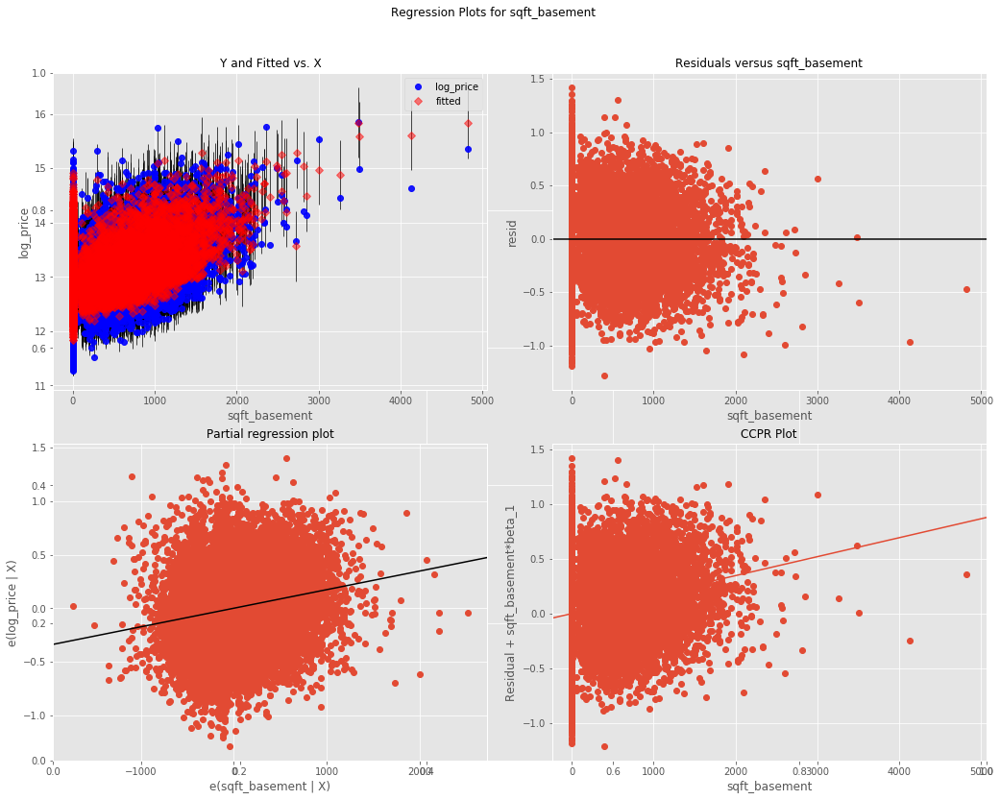

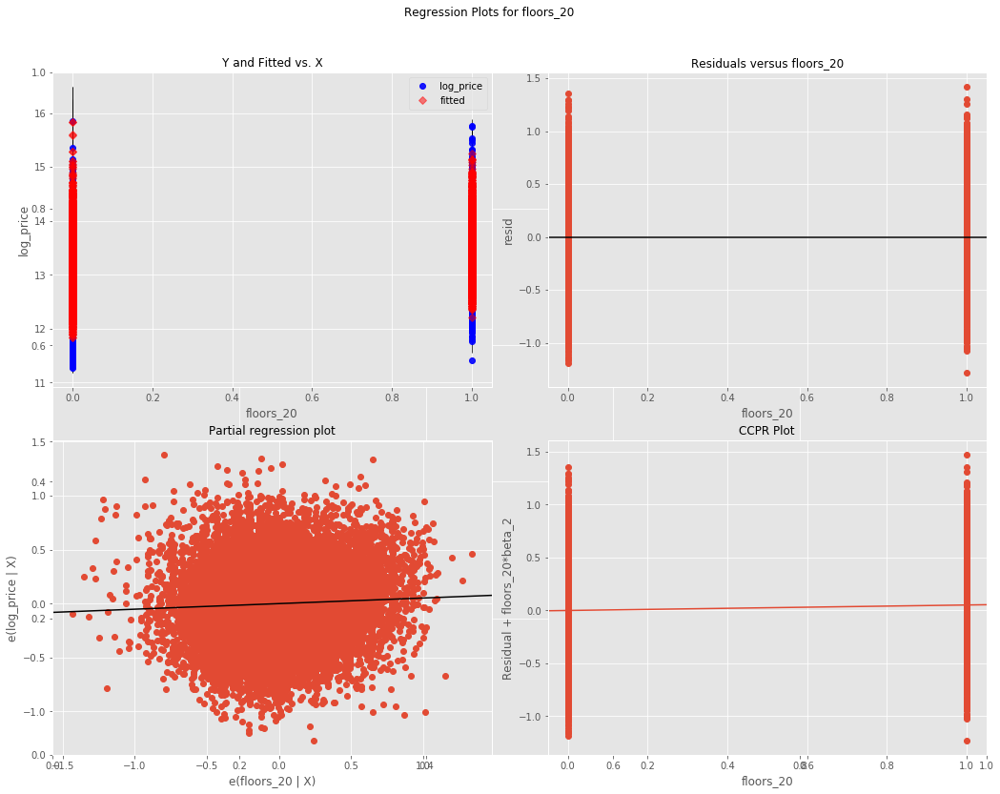

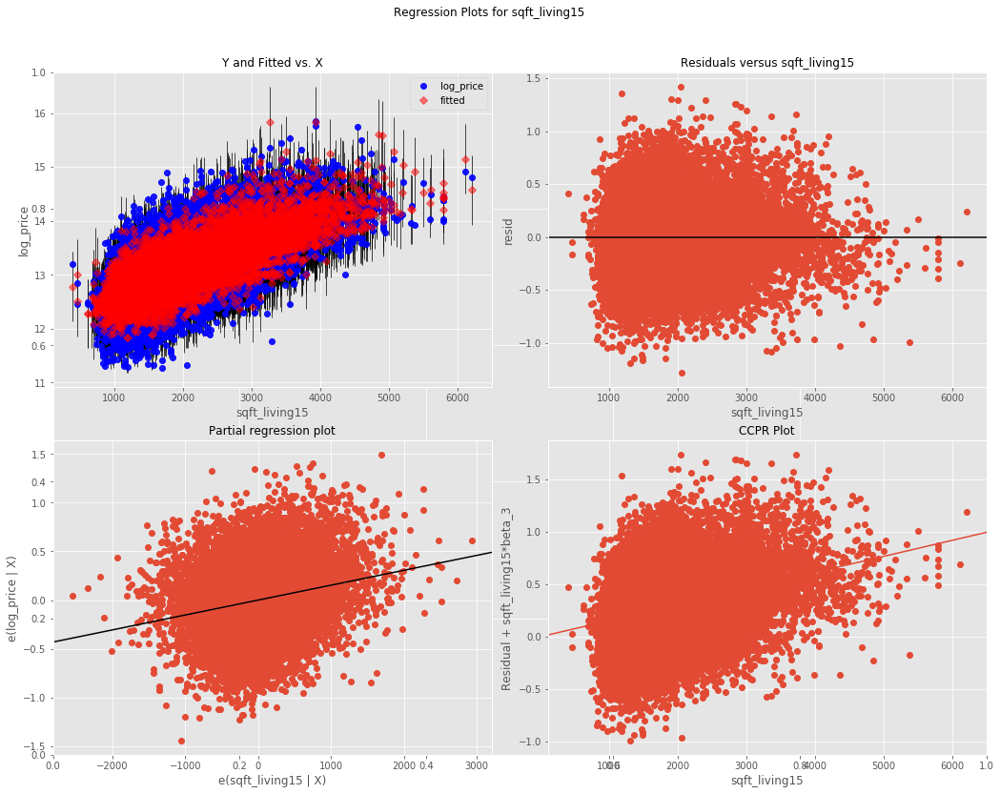

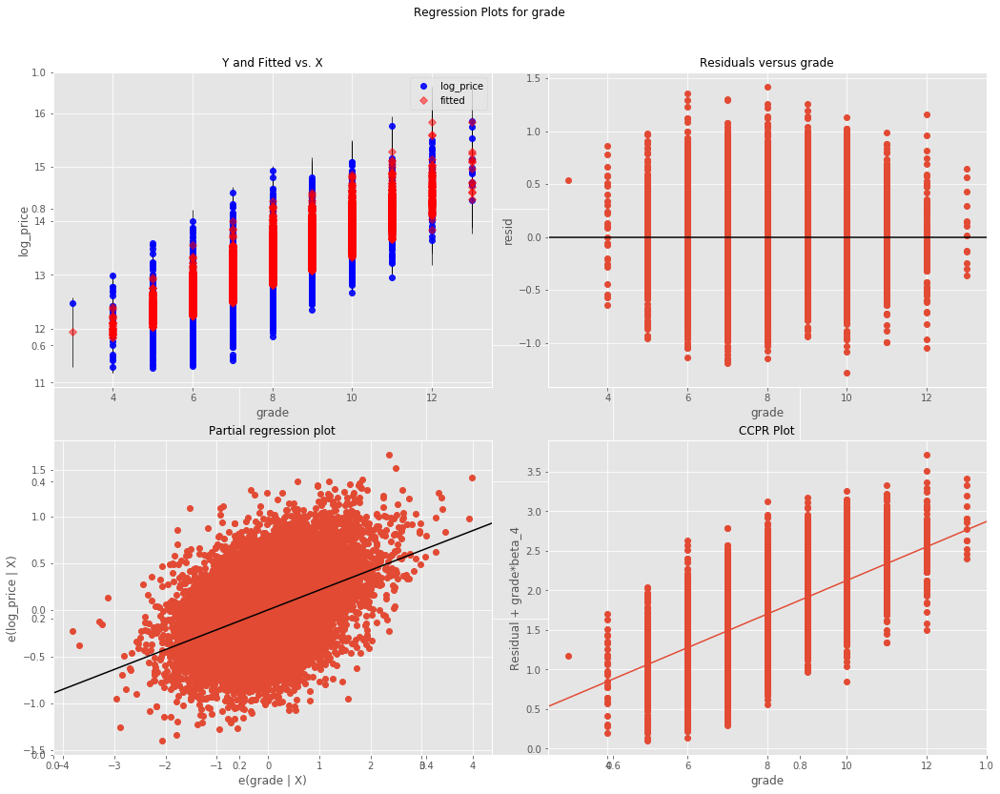

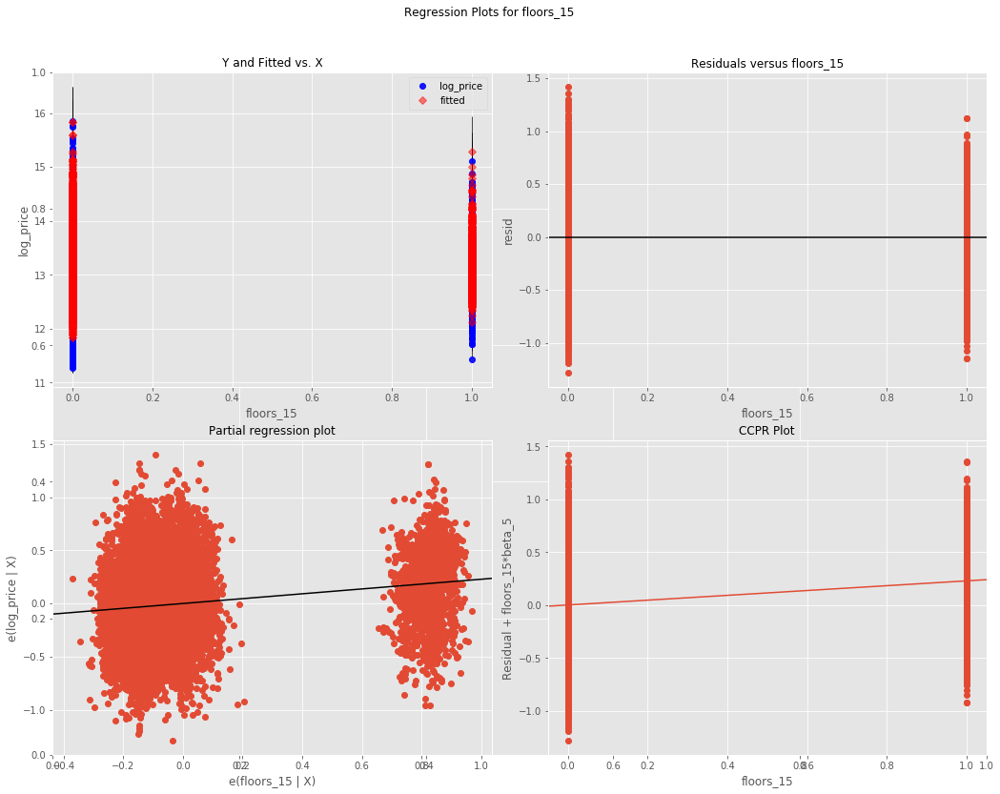

...

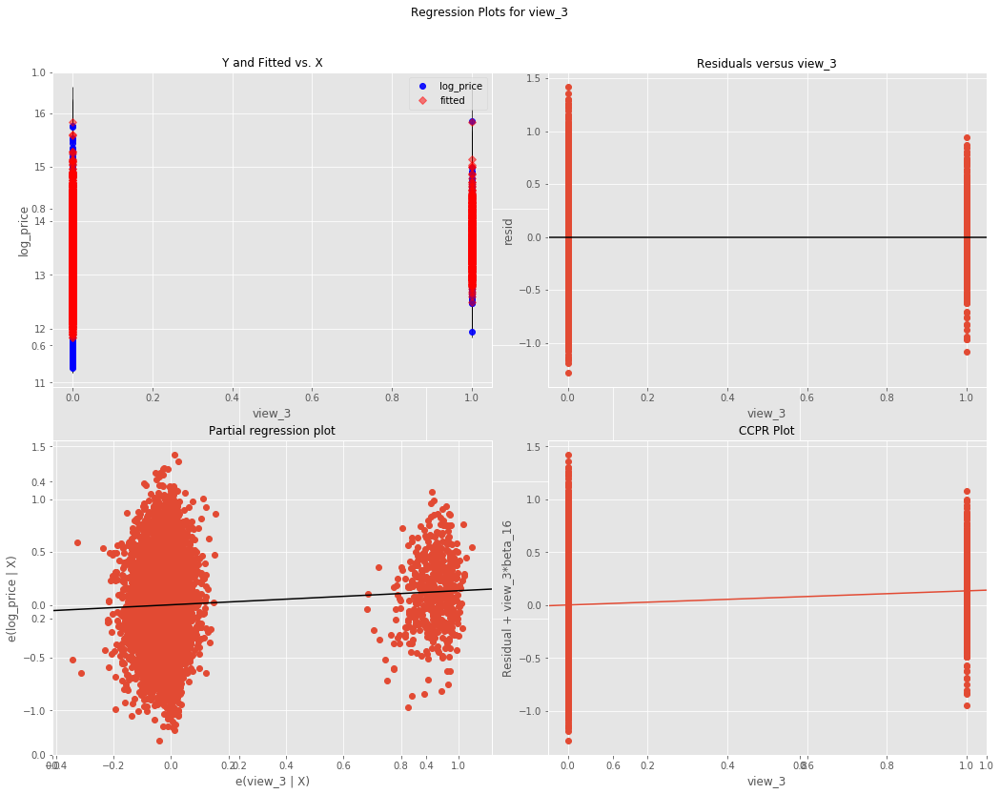

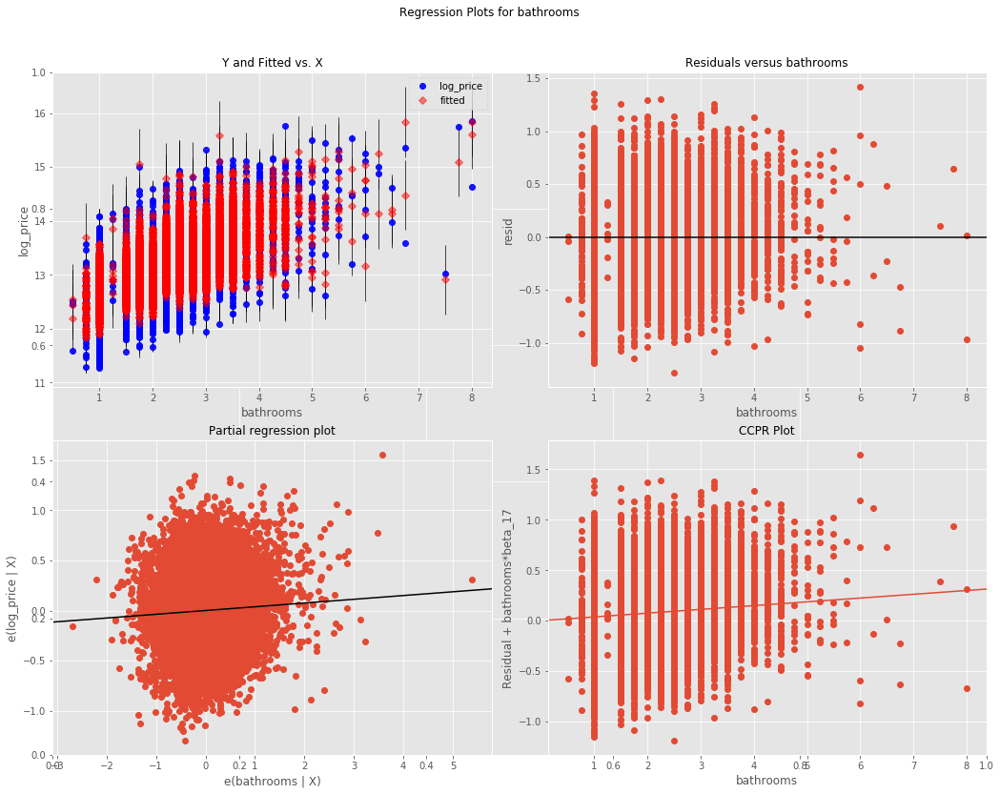

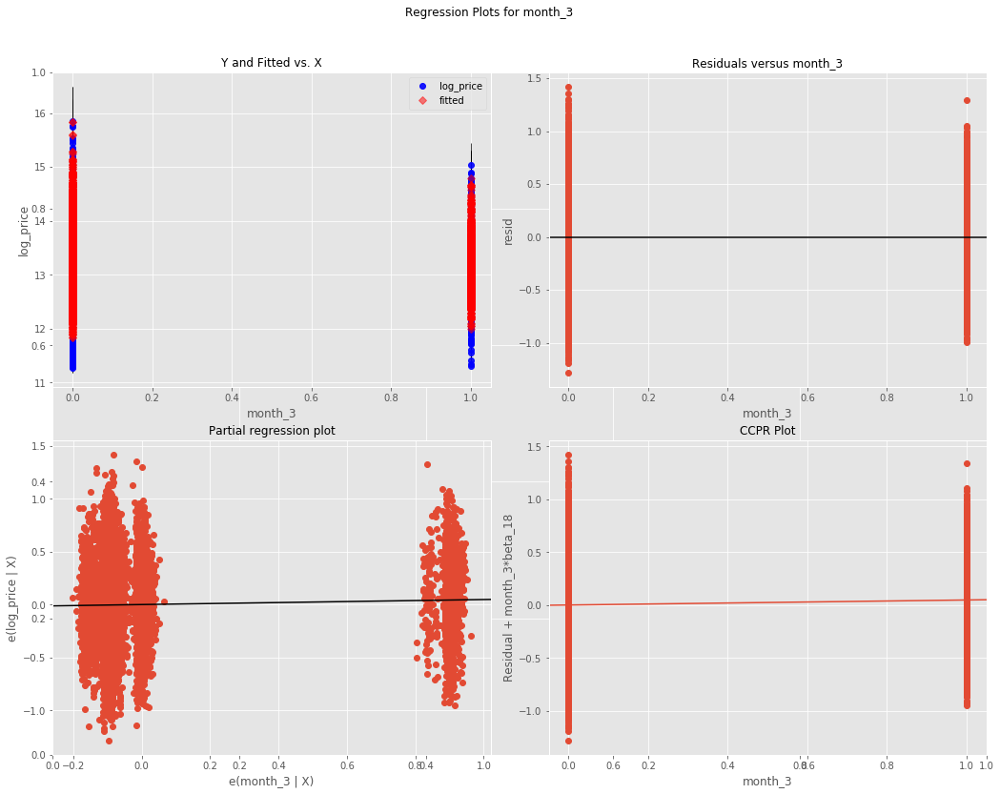

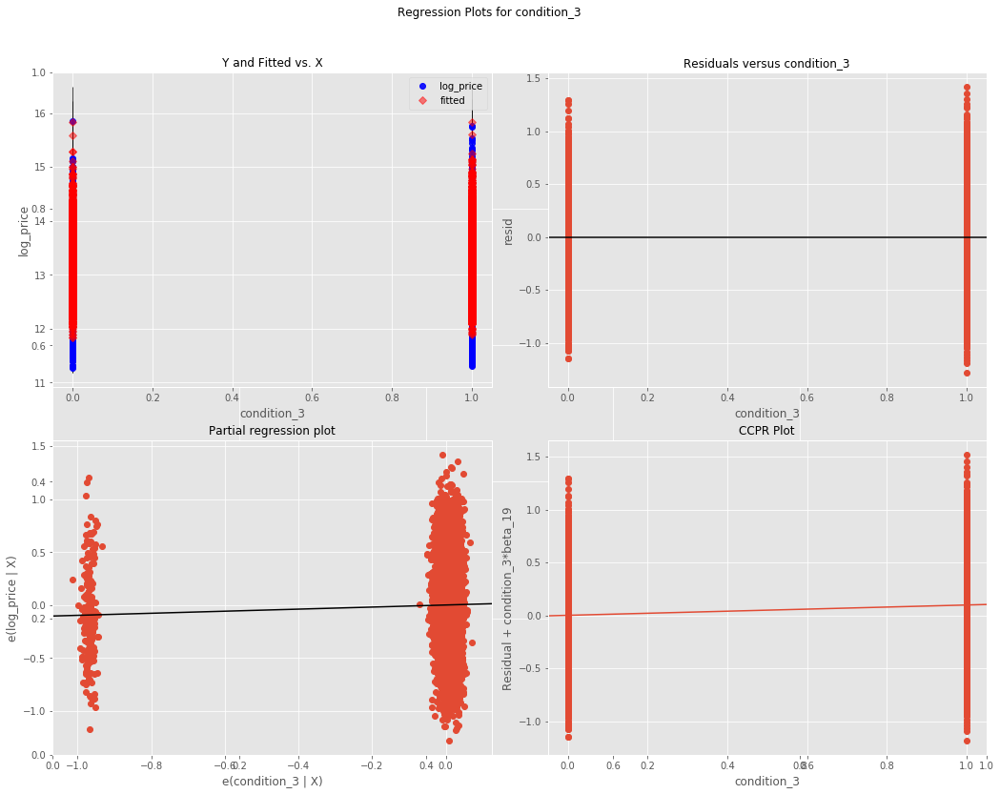

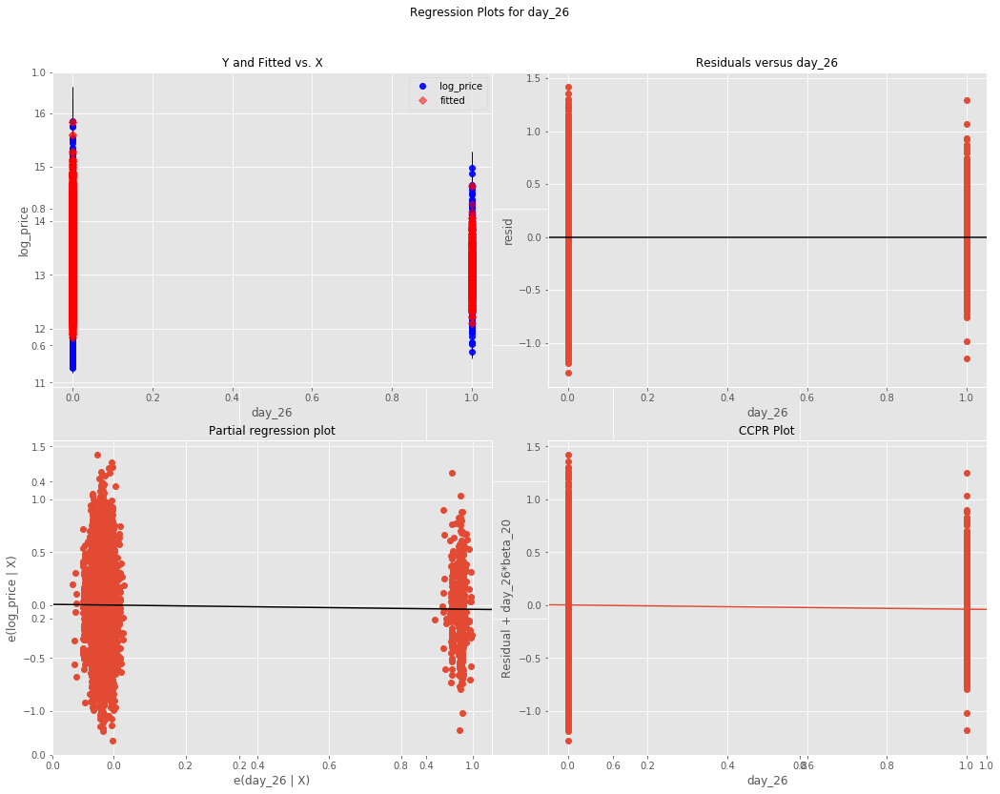

In [83]:
# evaluate residual plots
for col in X:
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, col, fig=fig)
    plt.show()

In [84]:
# Now run single variable regressions of each predictor

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~log_price
-------------------------------------------------------------------------------------


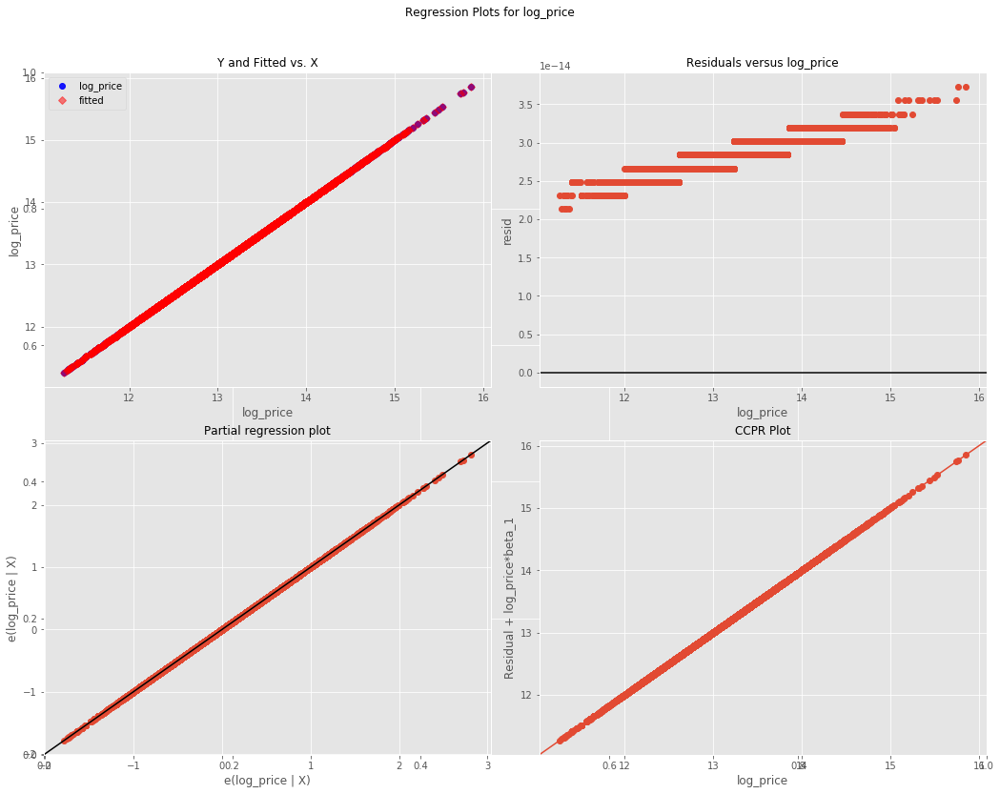

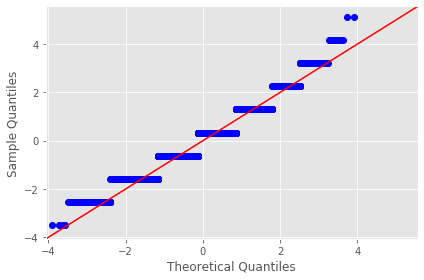

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~sqft_basement
-------------------------------------------------------------------------------------


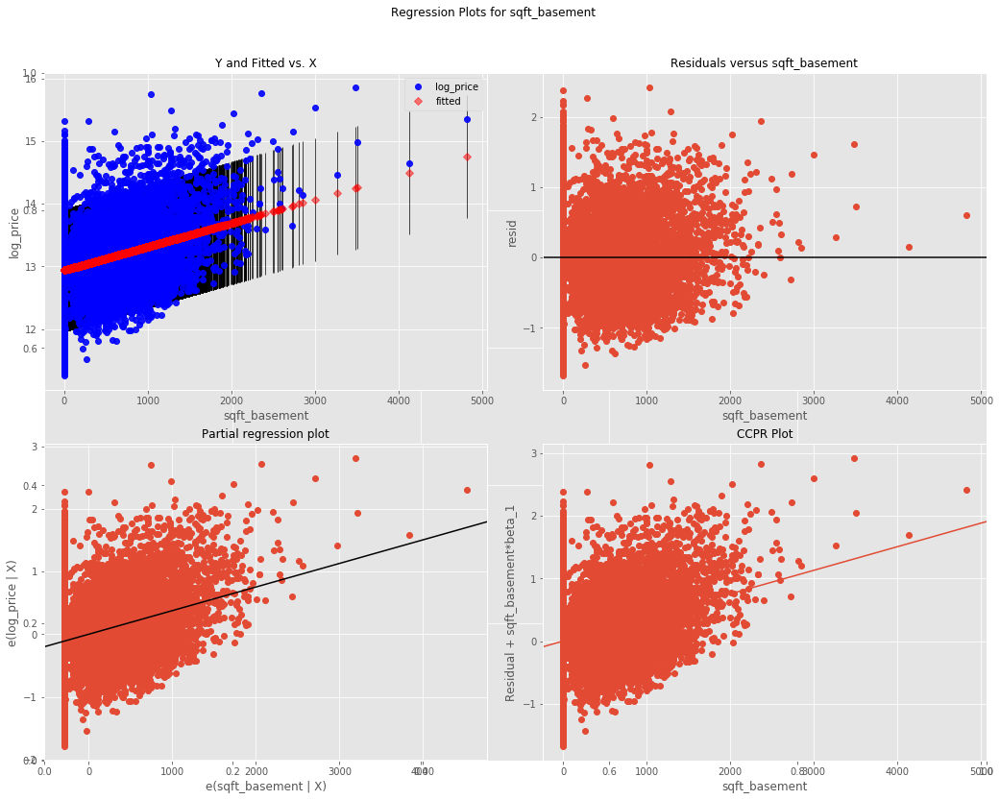

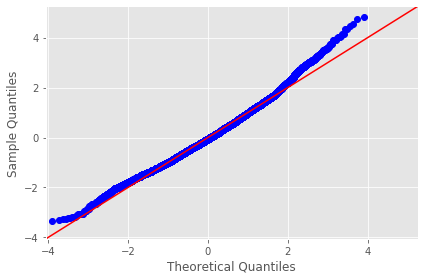

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~floors_20
-------------------------------------------------------------------------------------


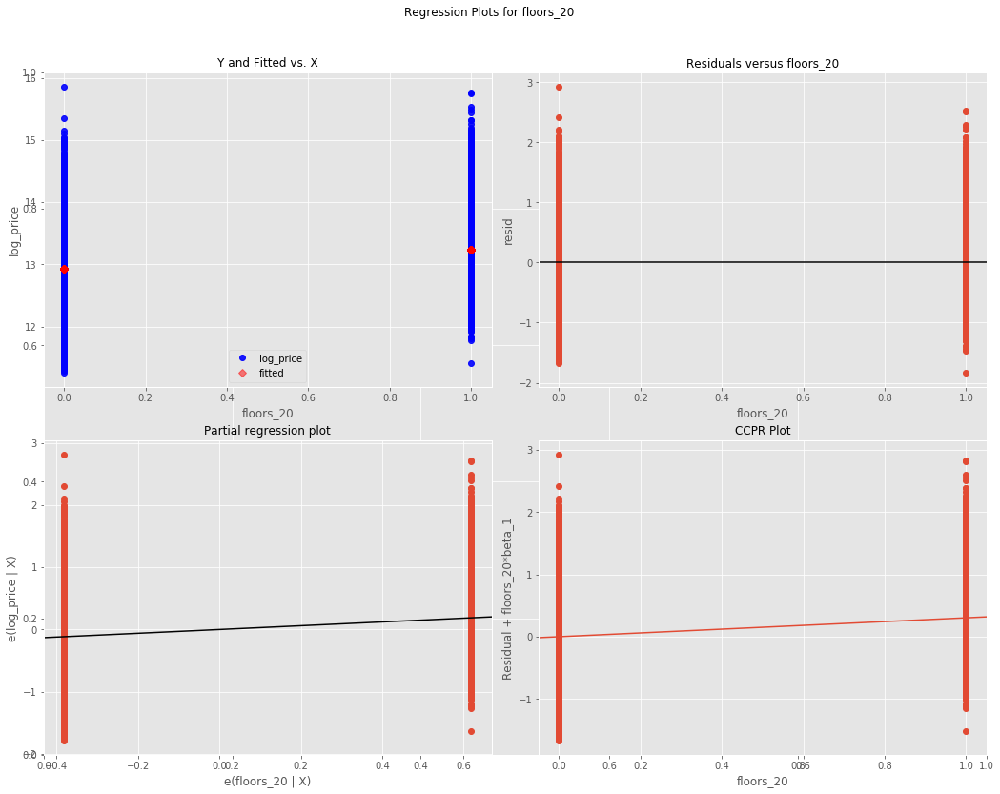

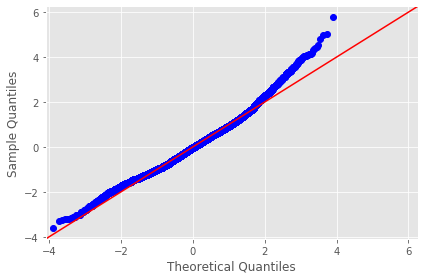

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~sqft_living15
-------------------------------------------------------------------------------------


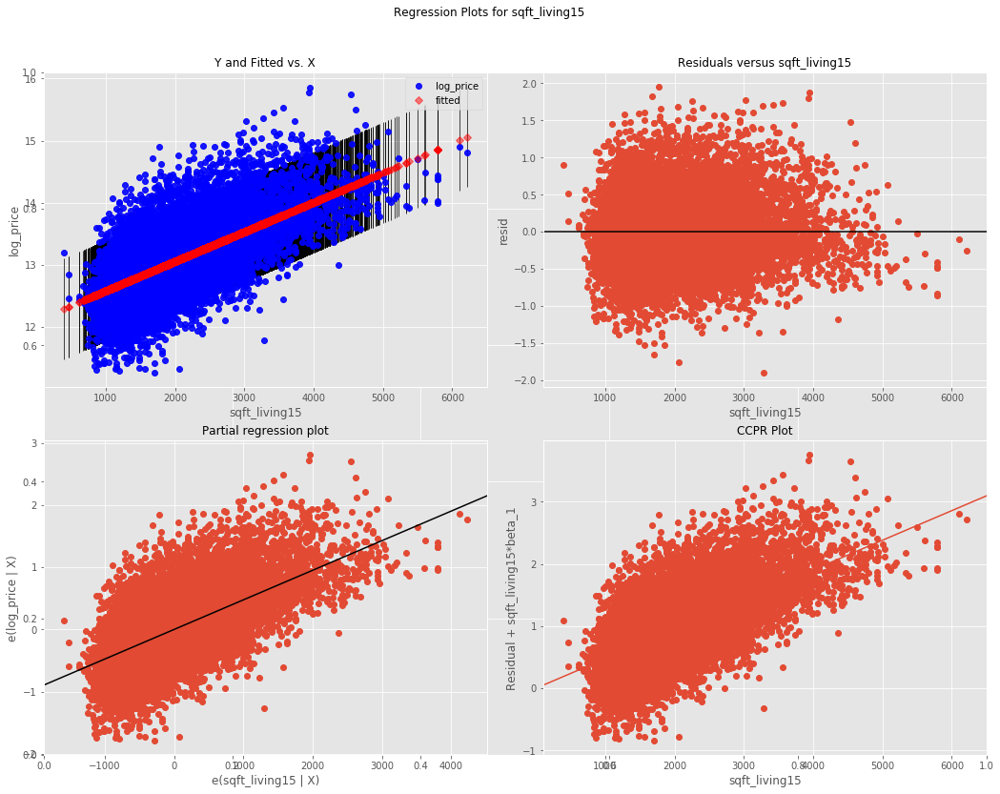

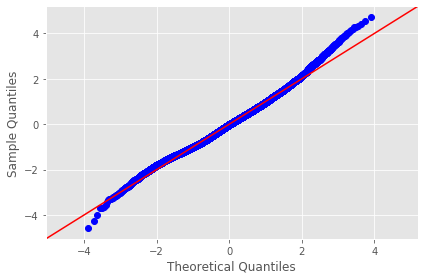

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~grade
-------------------------------------------------------------------------------------


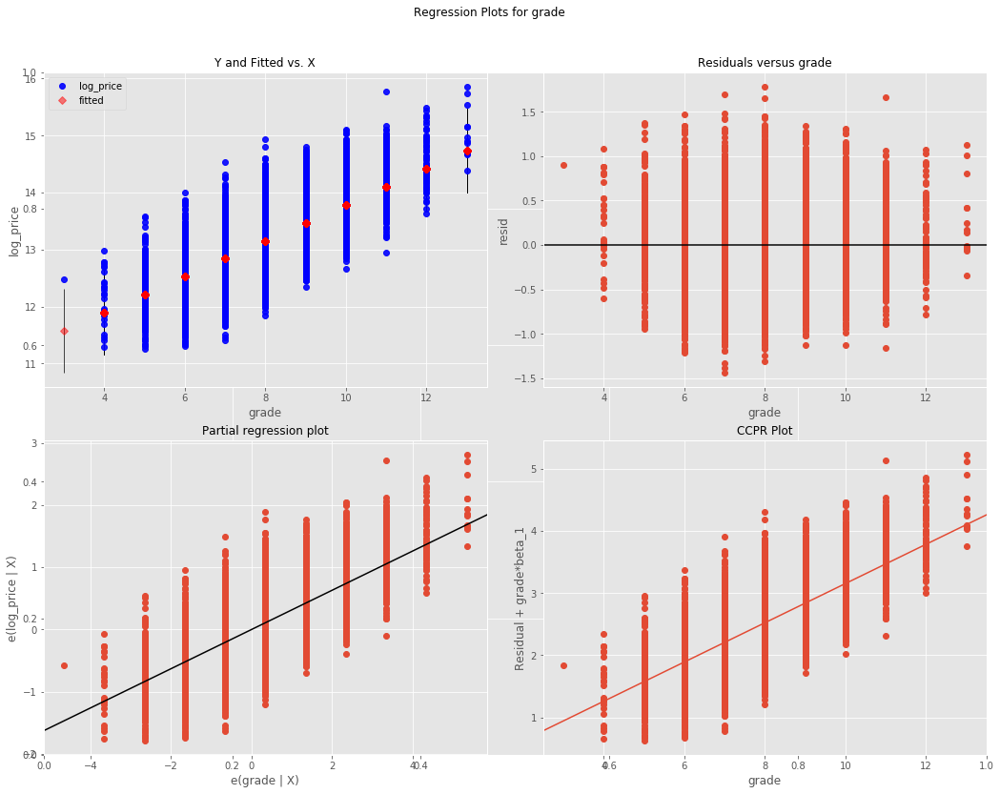

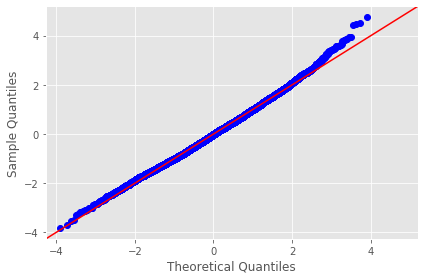

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~floors_15
-------------------------------------------------------------------------------------


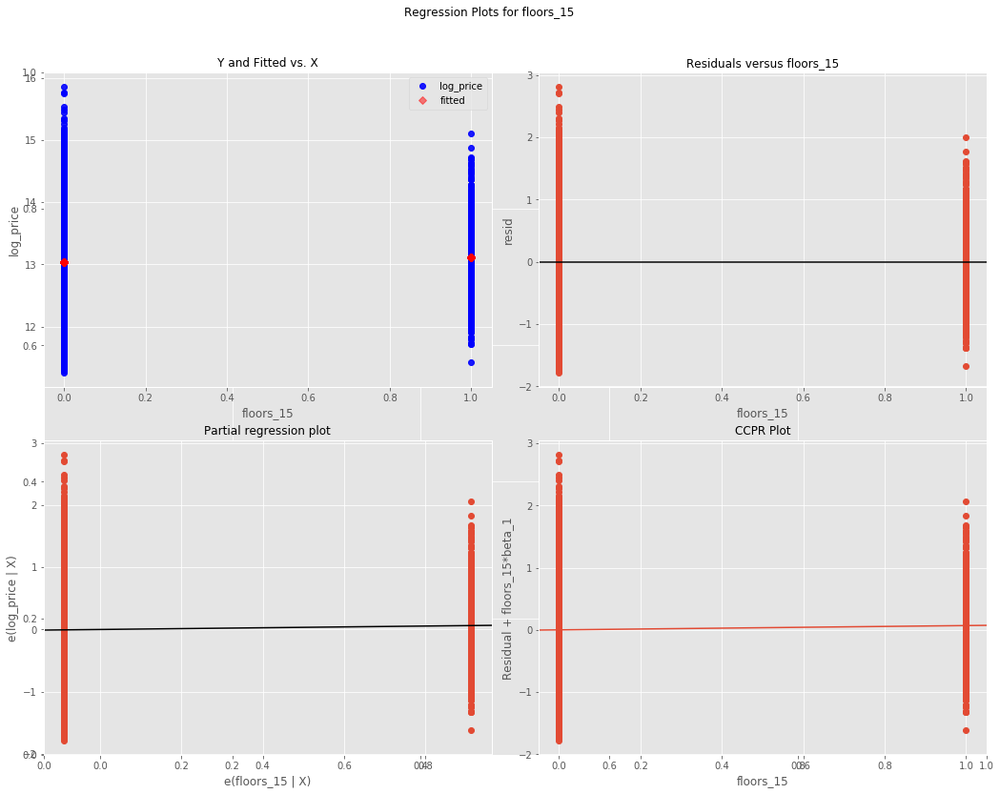

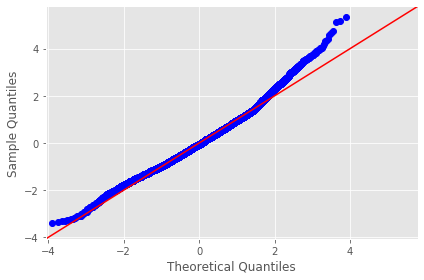

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~water_1
-------------------------------------------------------------------------------------


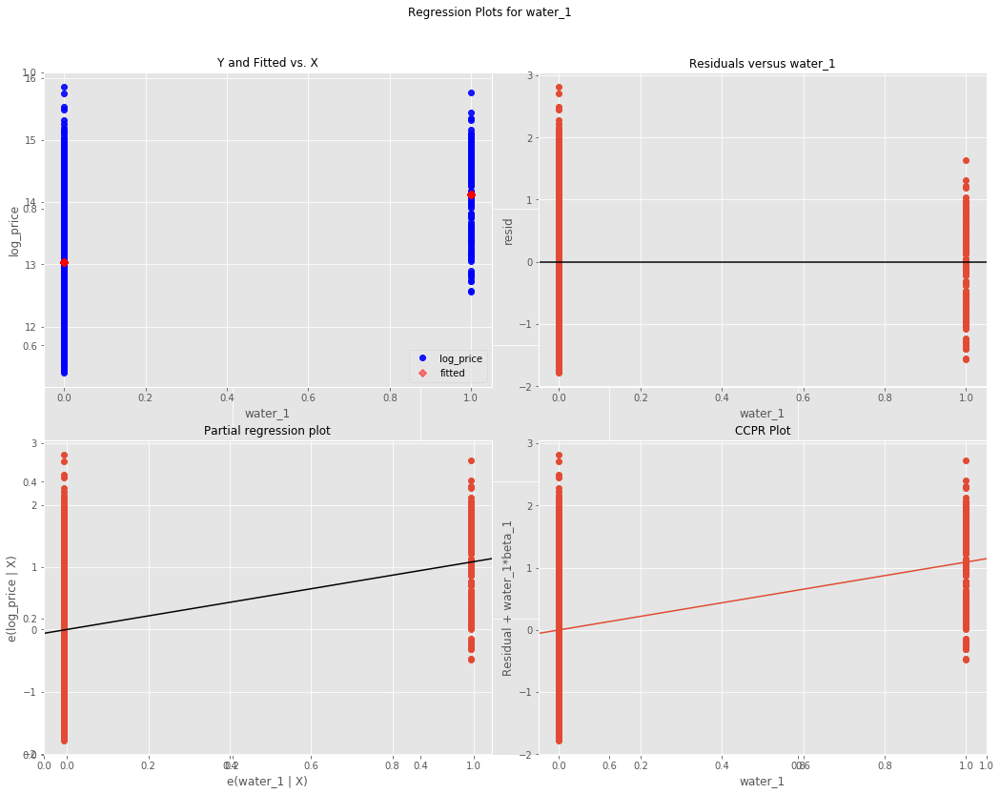

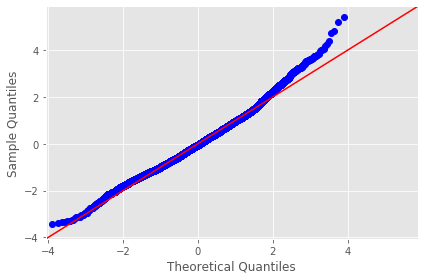

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~condition_5
-------------------------------------------------------------------------------------


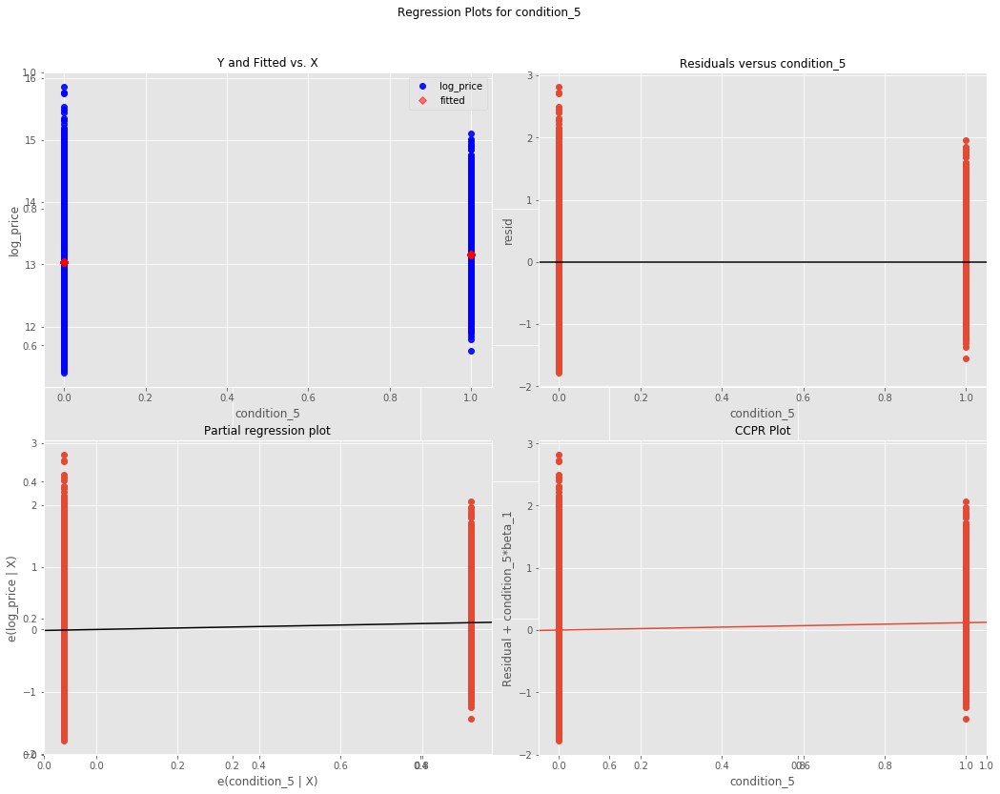

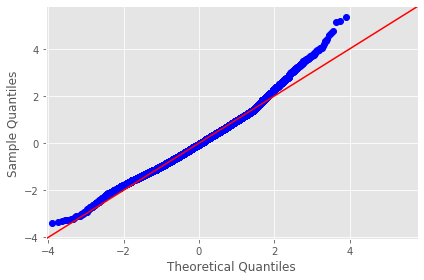

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~reno_1
-------------------------------------------------------------------------------------


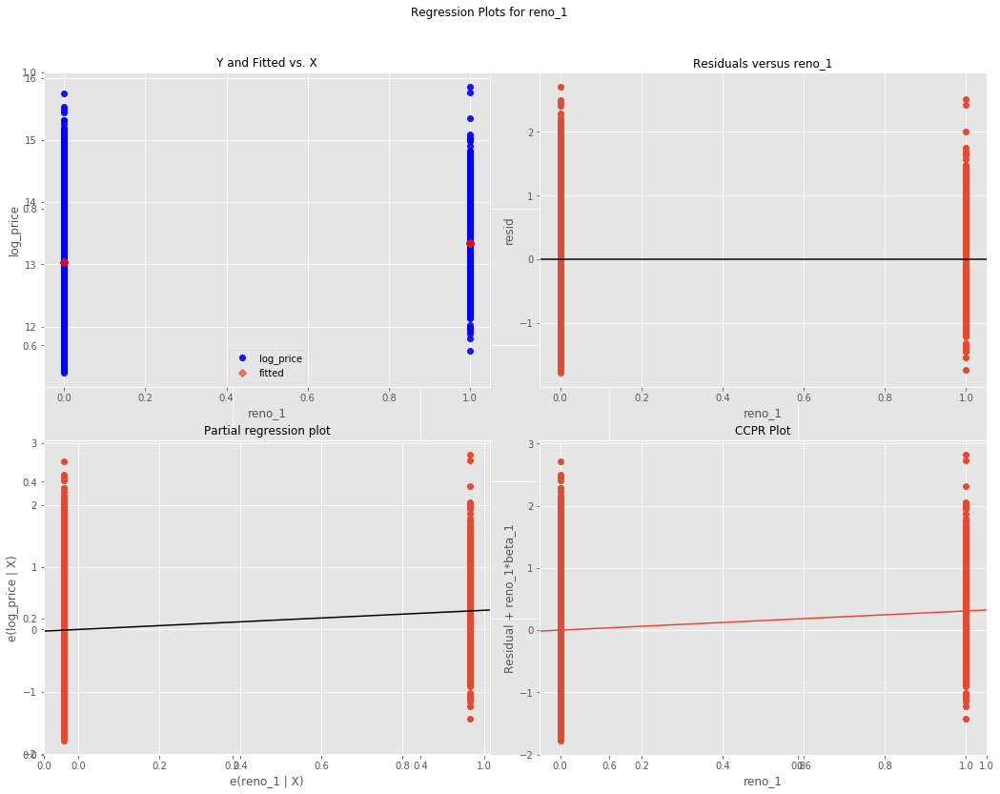

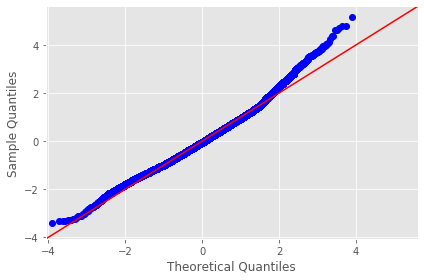

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~floors_30
-------------------------------------------------------------------------------------


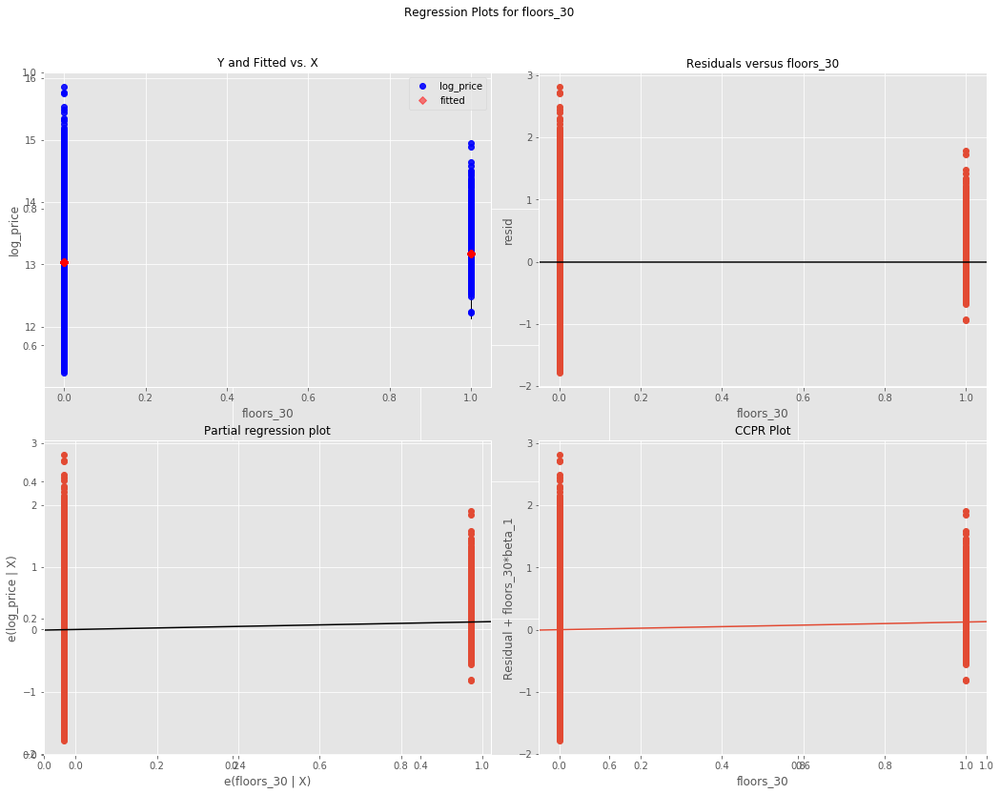

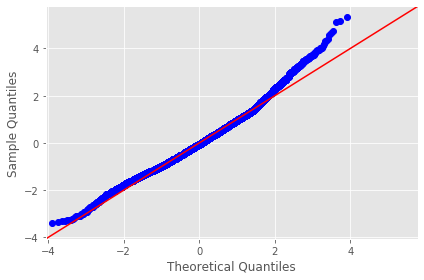

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~condition_4
-------------------------------------------------------------------------------------


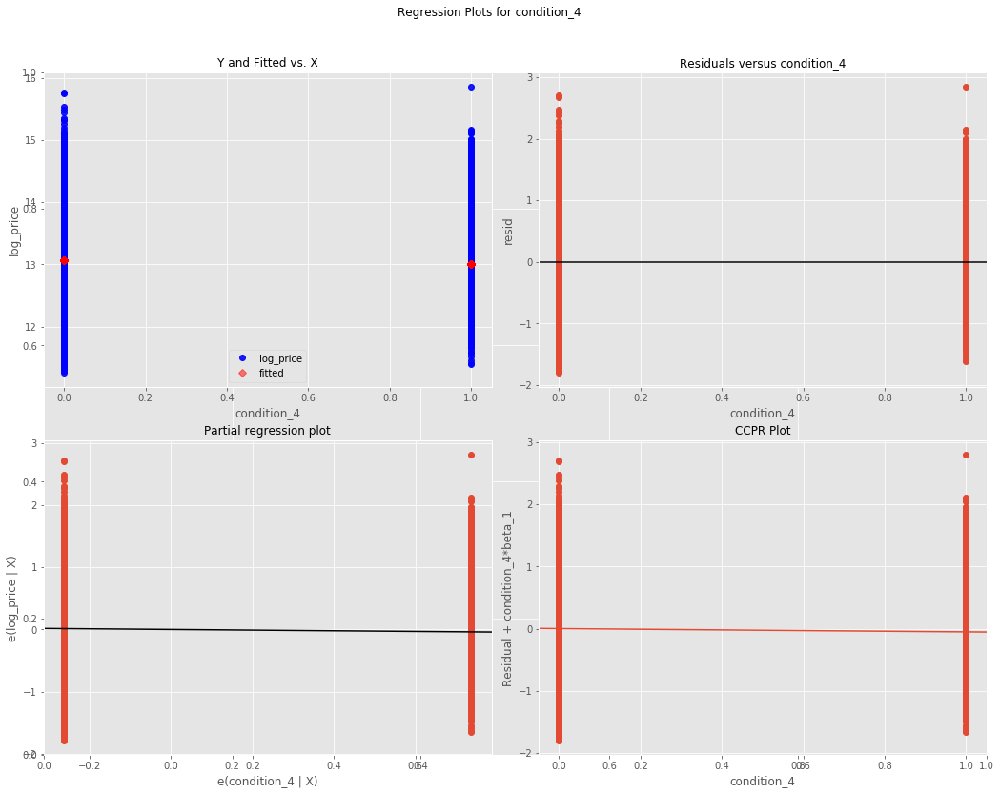

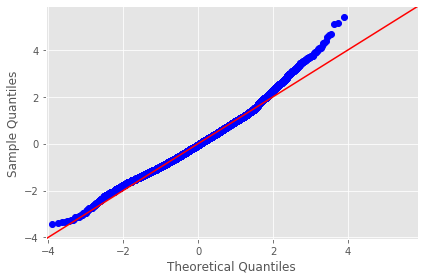

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~floors_25
-------------------------------------------------------------------------------------


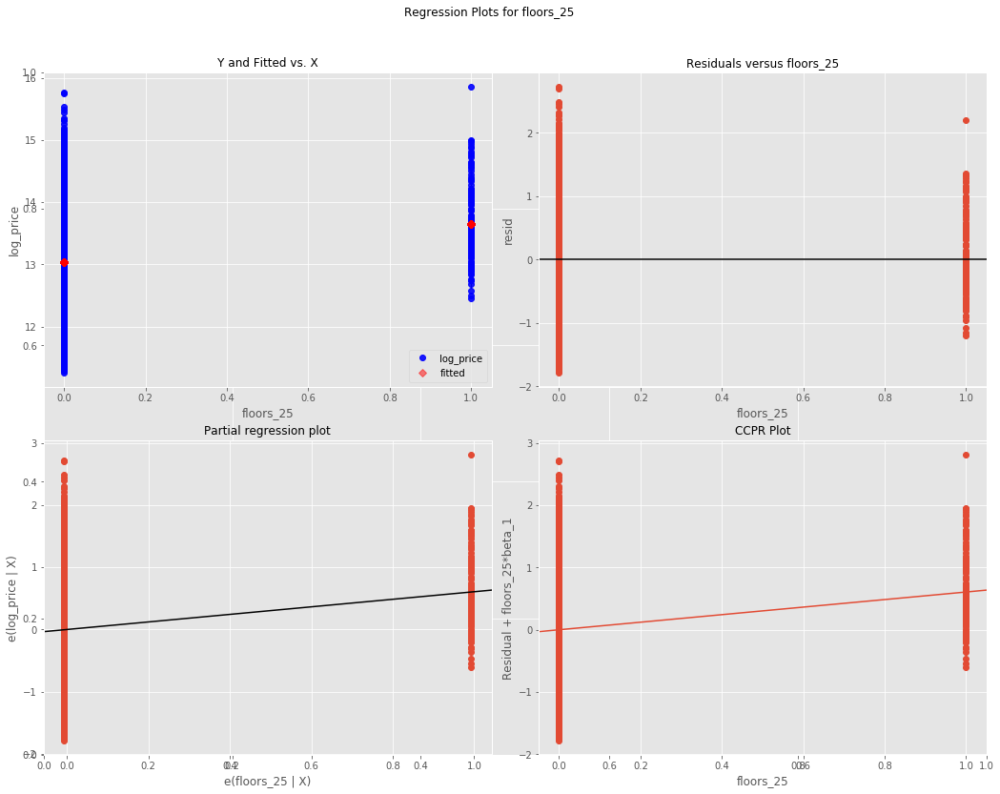

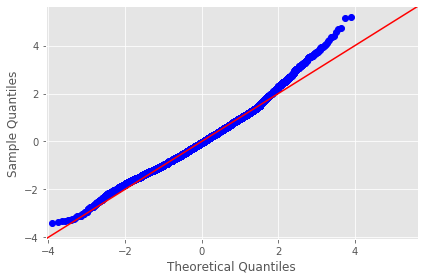

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~view_1
-------------------------------------------------------------------------------------


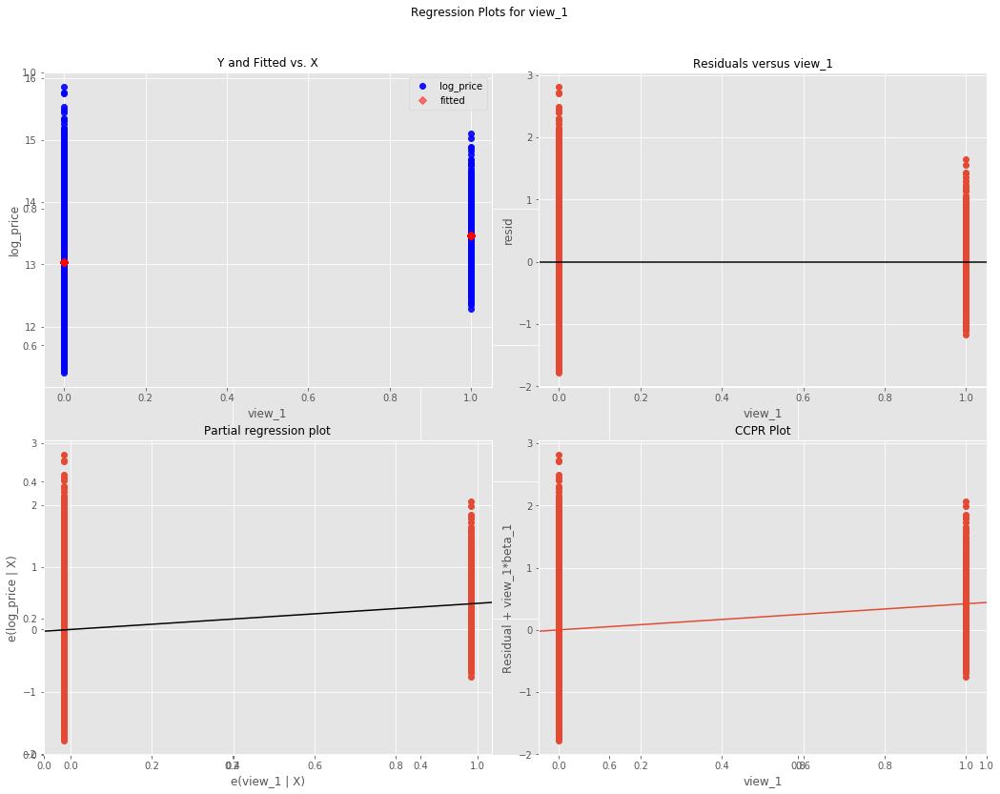

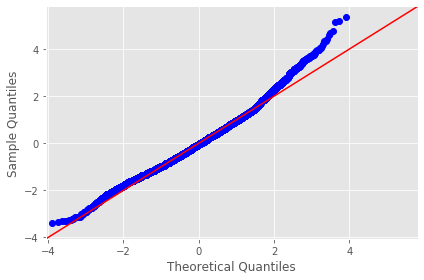

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~view_2
-------------------------------------------------------------------------------------


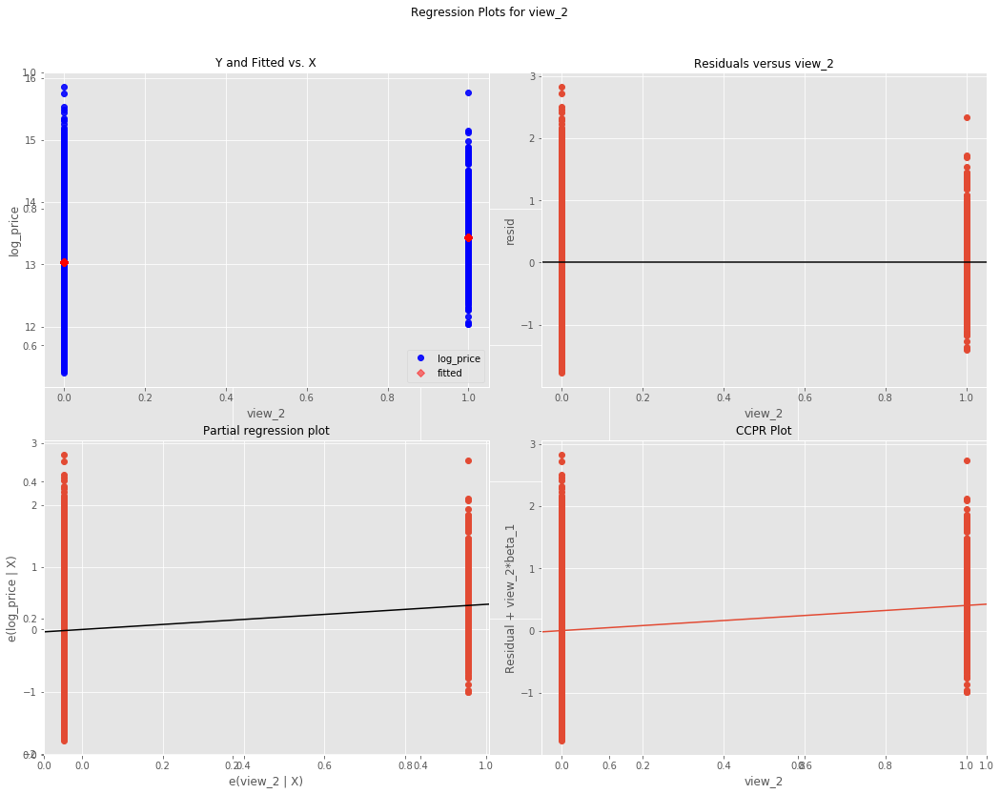

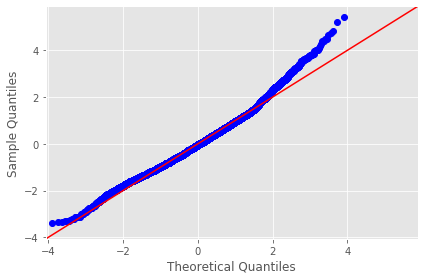

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~view_4
-------------------------------------------------------------------------------------


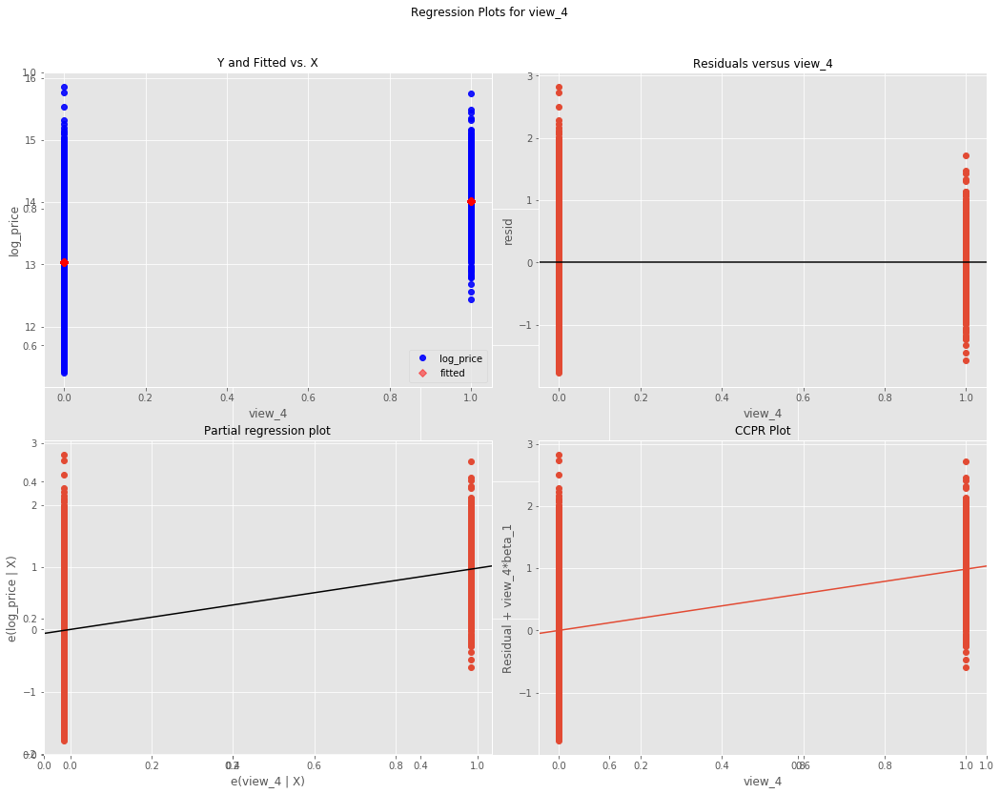

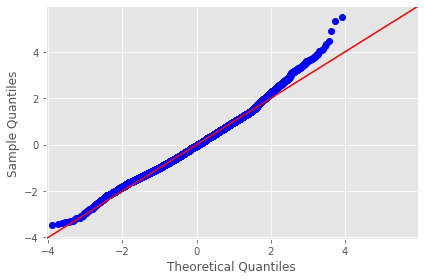

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~month_4
-------------------------------------------------------------------------------------


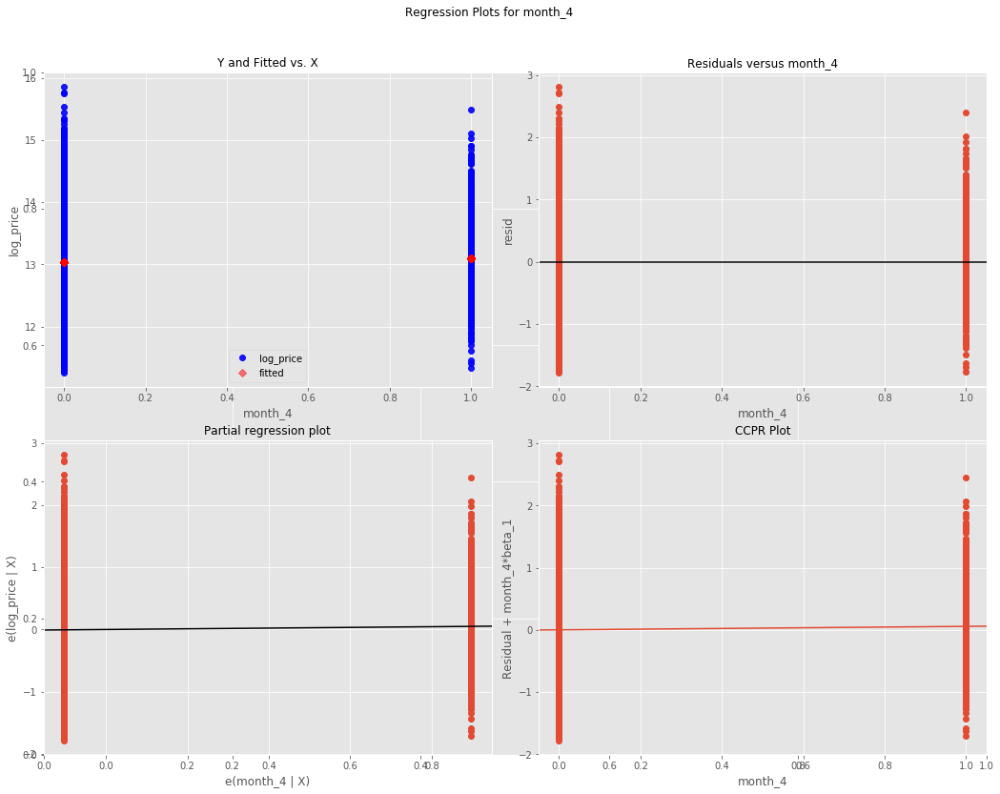

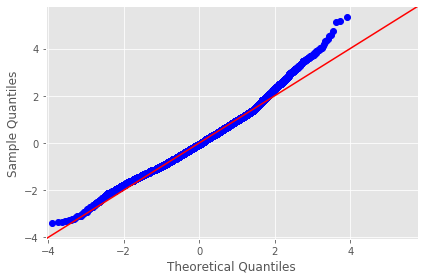

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~view_3
-------------------------------------------------------------------------------------


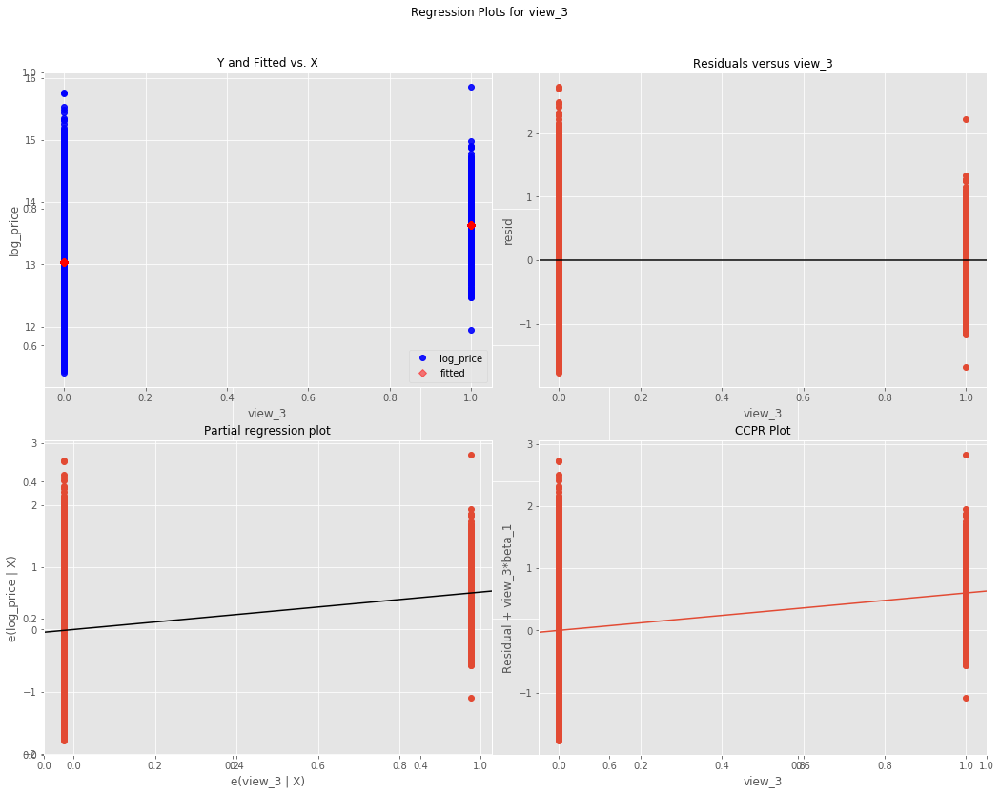

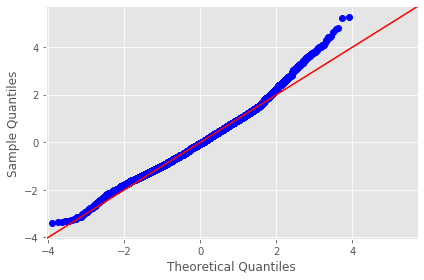

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~bathrooms
-------------------------------------------------------------------------------------


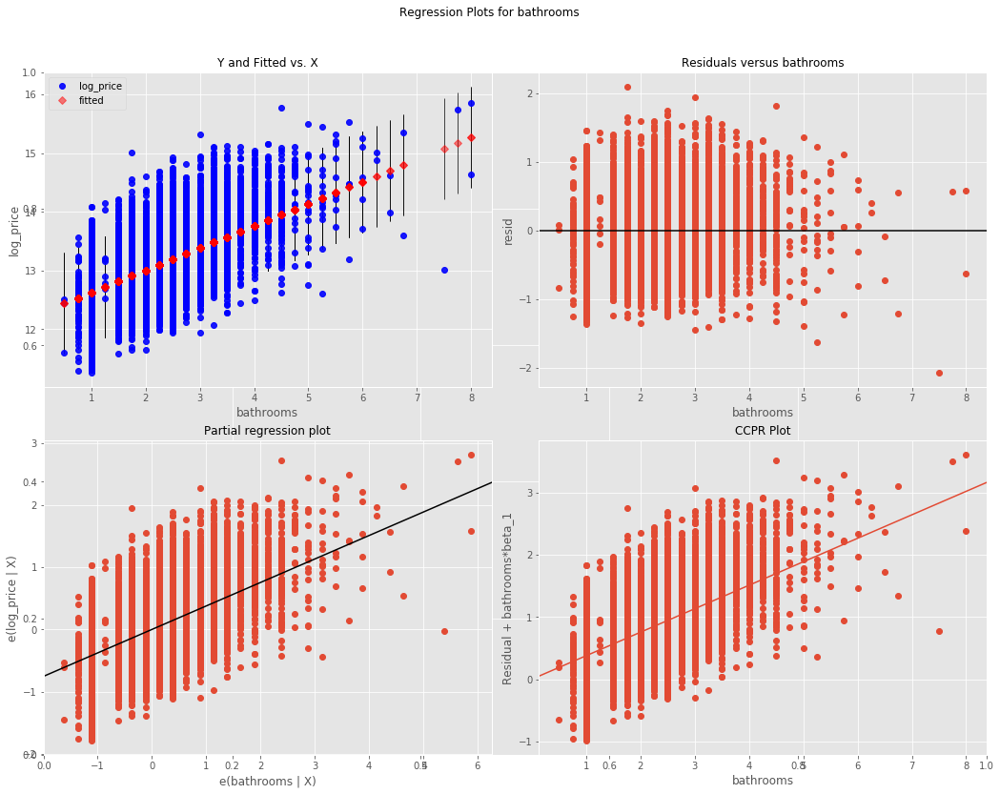

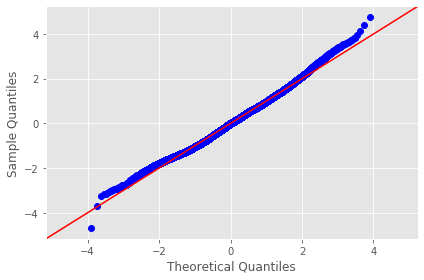

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~month_3
-------------------------------------------------------------------------------------


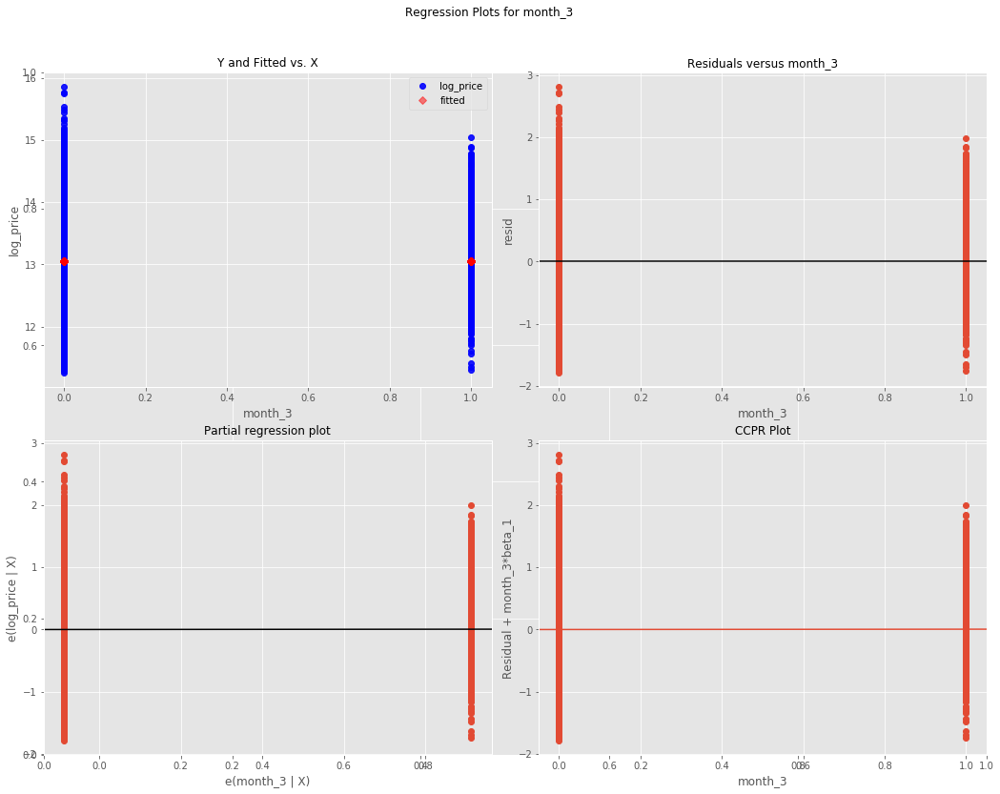

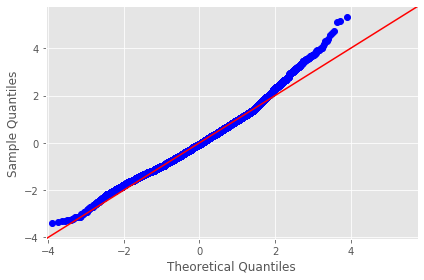

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~condition_3
-------------------------------------------------------------------------------------


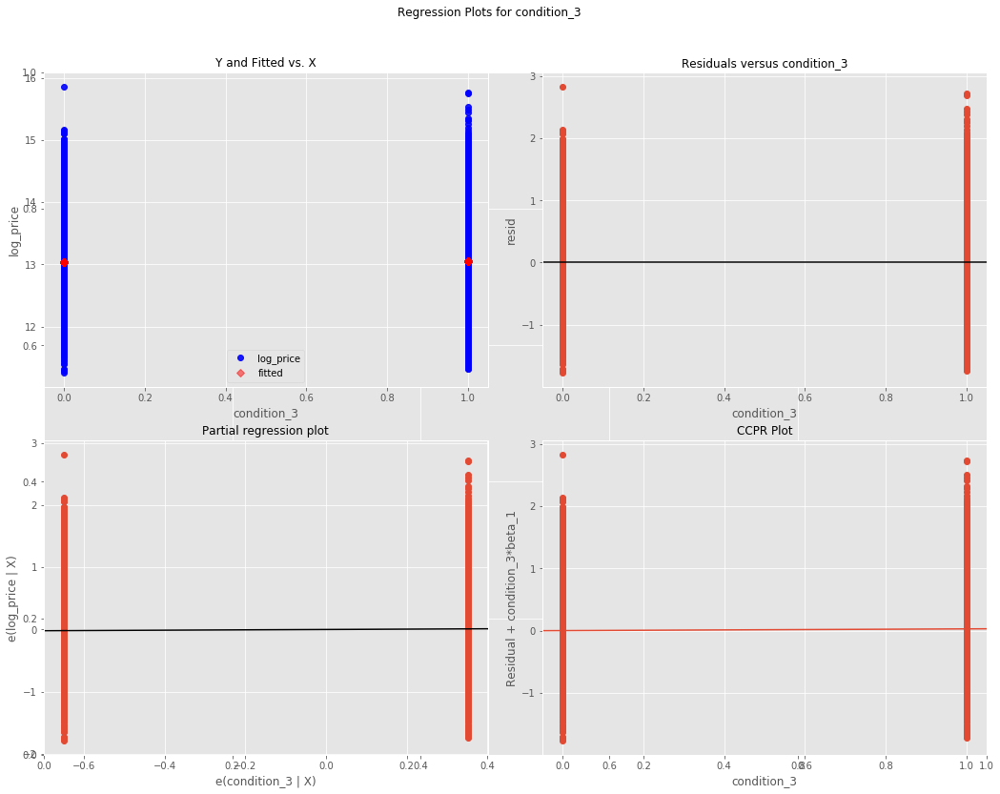

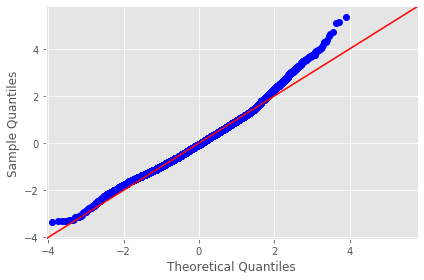

KC Housing DataSet - Regression Analysis and Diagnostics for log_price~day_26
-------------------------------------------------------------------------------------


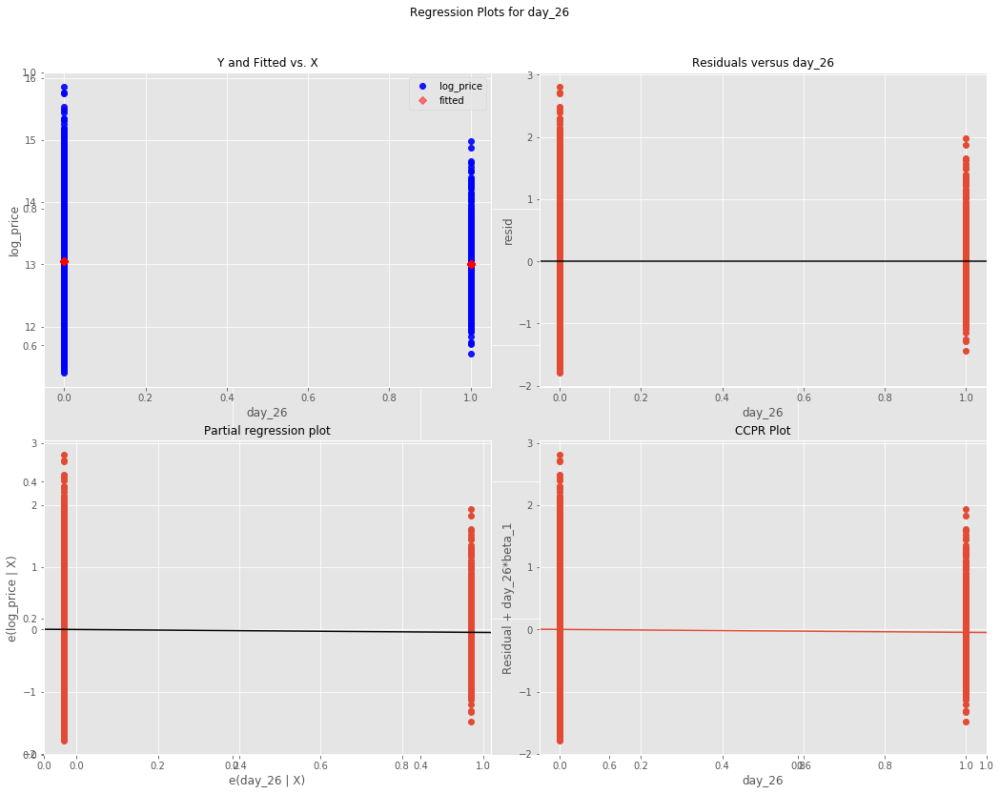

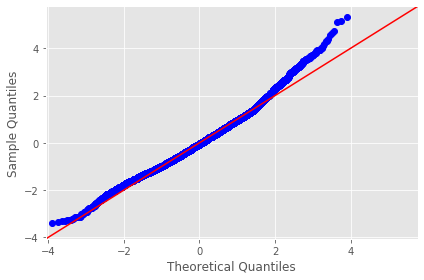

In [85]:
# evaluate residuals to further check assumptions
dataset = pd.concat([y, X], axis=1)
results = []
y = 'log_price'
for idx, column in enumerate(dataset.columns):
    print (f"KC Housing DataSet - Regression Analysis and Diagnostics for {y}~{column}")
    print ("-------------------------------------------------------------------------------------")

    f = f'{y}~{column}'
    model = smf.ols(formula=f, data=dataset).fit()
    
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, column, fig=fig)
    fig = sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True)
    fig.tight_layout()
    plt.show()
    
    results.append([column, model.rsquared, model.params[0], model.params[1], model.pvalues[1], sms.jarque_bera(model.resid)[0]])

In [86]:
# store results in dataframe to make future comparison easy
model_2 = pd.DataFrame(results, columns=['ind_var', 
                                         'r_squared', 
                                         'intercept', 
                                         'slope', 
                                         'p-value', 
                                         'normality (JB)'])

In [87]:
model_2

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,log_price,1.000000,9.769963e-15,1.000000,0.000000e+00,218.090154
1,sqft_basement,0.100005,1.293849e+01,0.000377,0.000000e+00,681.256135
2,floors_20,0.078386,1.293247e+01,0.303390,0.000000e+00,1097.139872
3,sqft_living15,0.384221,1.210253e+01,0.000476,0.000000e+00,444.639805
4,grade,0.494483,1.063313e+01,0.315379,0.000000e+00,135.733894
5,floors_15,0.001381,1.304213e+01,0.069010,6.741304e-08,1110.573149
6,water_1,0.028537,1.304092e+01,1.090961,9.632611e-135,693.027534
7,condition_5,0.003701,1.303885e+01,0.118831,9.505505e-19,1054.048894
8,reno_1,0.011355,1.303765e+01,0.308417,2.744305e-54,978.100640
9,floors_30,0.001502,1.304475e+01,0.123369,1.820288e-08,1091.017342


In [88]:
baseline_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price,1.000000,1.282388e-10,1.000000e+00,0.000000e+00,2.424683e+06
1,view,0.157749,4.958248e+05,1.903854e+05,0.000000e+00,9.889957e+05
2,sqft_living15,0.343976,-8.313991e+04,3.137457e+02,0.000000e+00,1.844816e+06
3,bathrooms,0.275655,9.863874e+03,2.506635e+05,0.000000e+00,8.493976e+05
4,grade,0.446356,-1.058339e+06,2.087549e+05,0.000000e+00,1.955187e+06
5,sqft_basement,0.104340,4.621605e+05,2.680065e+02,0.000000e+00,8.504000e+05
6,waterfront_1,0.068005,5.323996e+05,1.173309e+06,0.000000e+00,8.935611e+05
7,floors_15,0.000267,5.383832e+05,2.114672e+04,1.761860e-02,1.079274e+06
8,condition_3,0.000091,5.354827e+05,7.337756e+03,1.656503e-01,1.075019e+06
9,floors_25,0.013985,5.365267e+05,5.092809e+05,1.578176e-66,9.976328e+05


In [89]:
# repeat with price_boxcox
# run stepwise selection to select features
y = data_fin['price_boxcox']
X = data_fin.drop(['log_price', 'price_boxcox'], axis=1)
result = stepwise_selection(X, y, verbose=True)

Add  sqft_basement                  with p-value 0.0
Add  floors_20                      with p-value 0.0
Add  sqft_living15                  with p-value 0.0
Add  grade                          with p-value 0.0
Drop floors_20                      with p-value 0.477346
Add  floors_15                      with p-value 7.58374e-166
Add  condition_5                    with p-value 3.45023e-68
Add  reno_1                         with p-value 1.2052e-66
Add  water_1                        with p-value 1.1261e-49
Add  bathrooms                      with p-value 2.71428e-32
Add  condition_4                    with p-value 1.82014e-31
Add  floors_30                      with p-value 8.22077e-27
Add  month_4                        with p-value 3.84461e-18
Add  view_2                         with p-value 1.63498e-16
Add  view_1                         with p-value 2.59811e-17
Add  floors_20                      with p-value 1.41659e-13
Add  floors_25                      with p-value 7.13171e-19

In [90]:
# run regression with these features
X = data_fin[result]
y = data_fin['price_boxcox']
predictors = sm.add_constant(X)
model = sm.OLS(y, predictors).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           price_boxcox   R-squared:                       0.585
Model:                            OLS   Adj. R-squared:                  0.585
Method:                 Least Squares   F-statistic:                     1487.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:08:17   Log-Likelihood:                 58599.
No. Observations:               21082   AIC:                        -1.172e+05
Df Residuals:                   21061   BIC:                        -1.170e+05
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.9135      0.001   3013.651      0.000       3.911       3.916
sqft_basement  7.809e-06   2.91e-07     26.808      0.000    7.24e-06    8.38e-06
sqft_living15  6.686e-06   2.28e-07     29.305      0.000    6.24e-06    7.13e-06
grade             0.0092      0.000     62.555      0.000       0.009       0.009
floors_15         0.0104      0.000     27.233      0.000       0.010       0.011
condition_5       0.0155      0.001     13.478      0.000       0.013       0.018
reno_1            0.0093      0.001     16.172      0.000       0.008       0.010
water_1           0.0126      0.002      8.166      0.000       0.010       0.016
bathrooms         0.0016      0.000      7.497      0.000       0.001       0.002
condition_4       0.0101      0.001      9.192      0.000       0.008       0.012
floors_30         0.0088      0.001     12.733      0.000       0.007       0.010
month_4           0.0031      0.000      9.062      0.000       0.002       0.004
view_2            0.0050      0.001      9.684      0.000       0.004       0.006
view_1            0.0079      0.001      9.374      0.000       0.006       0.010
floors_20         0.0028      0.000      8.936      0.000       0.002       0.003
floors_25         0.0111      0.001      8.955      0.000       0.009       0.014
view_4            0.0084      0.001      7.895      0.000       0.006       0.011
view_3            0.0049      0.001      6.905      0.000       0.003       0.006
condition_3       0.0069      0.001      6.259      0.000       0.005       0.009
month_3           0.0020      0.000      5.490      0.000       0.001       0.003
day_26           -0.0019      0.001     -3.233      0.001      -0.003      -0.001
==============================================================================
Omnibus:                      200.942   Durbin-Watson:                   1.973
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              210.695
Skew:                          -0.224   Prob(JB):                     1.77e-46
Kurtosis:                       3.199   Cond. No.                     4.49e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.49e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

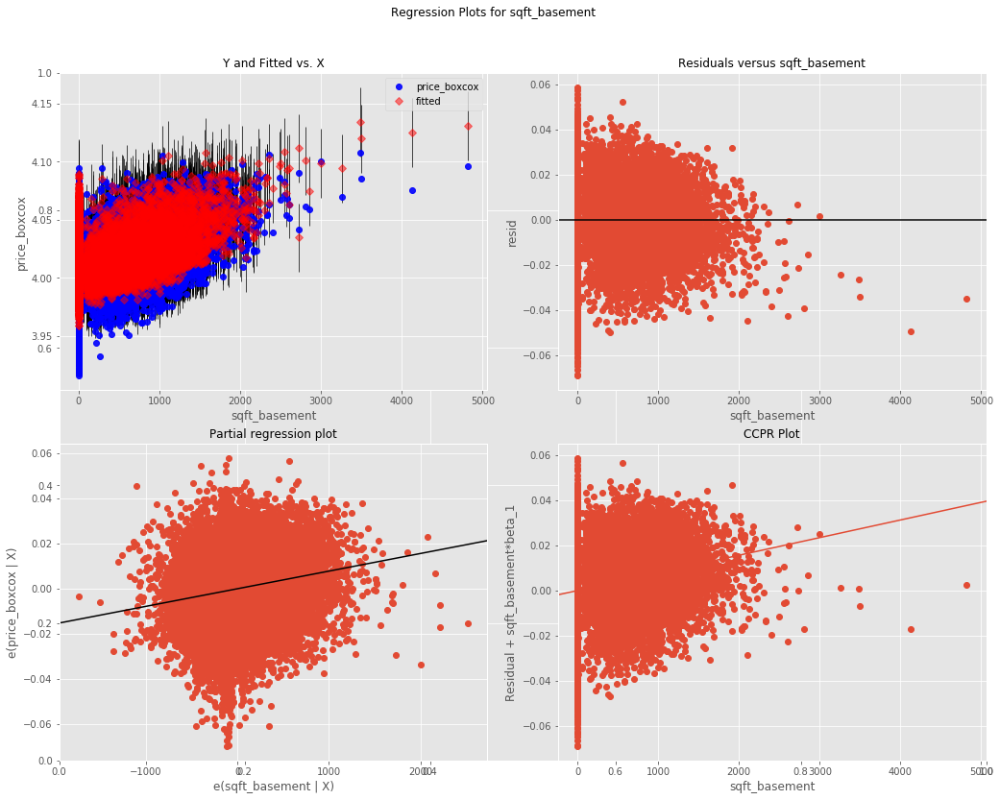

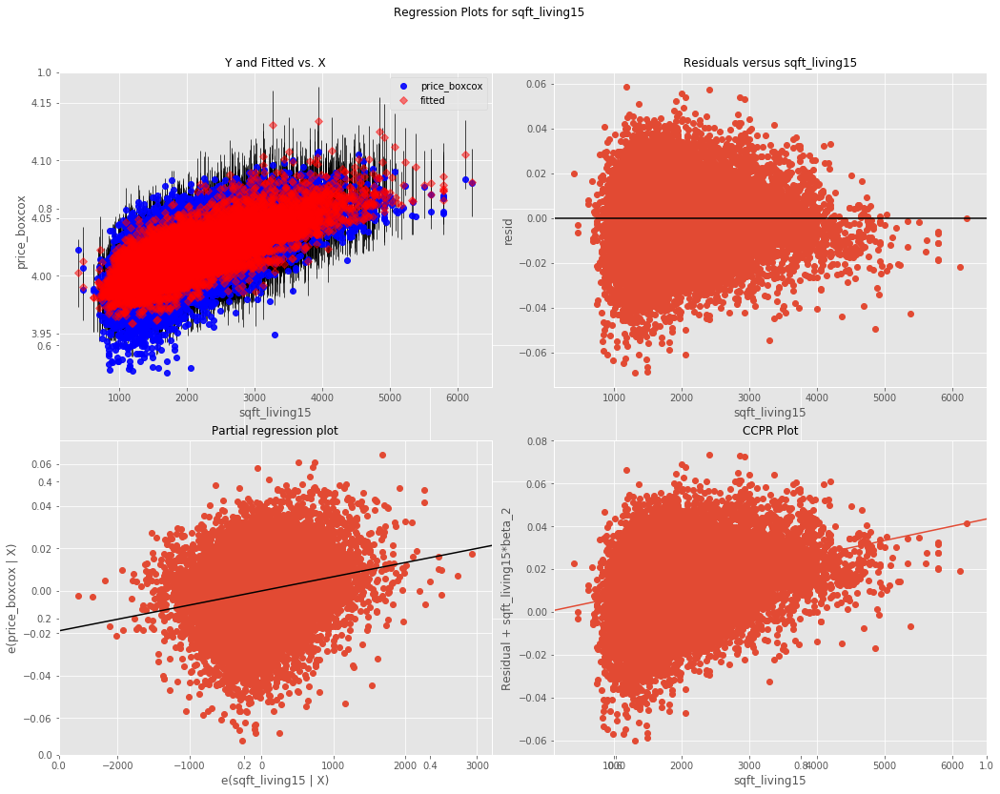

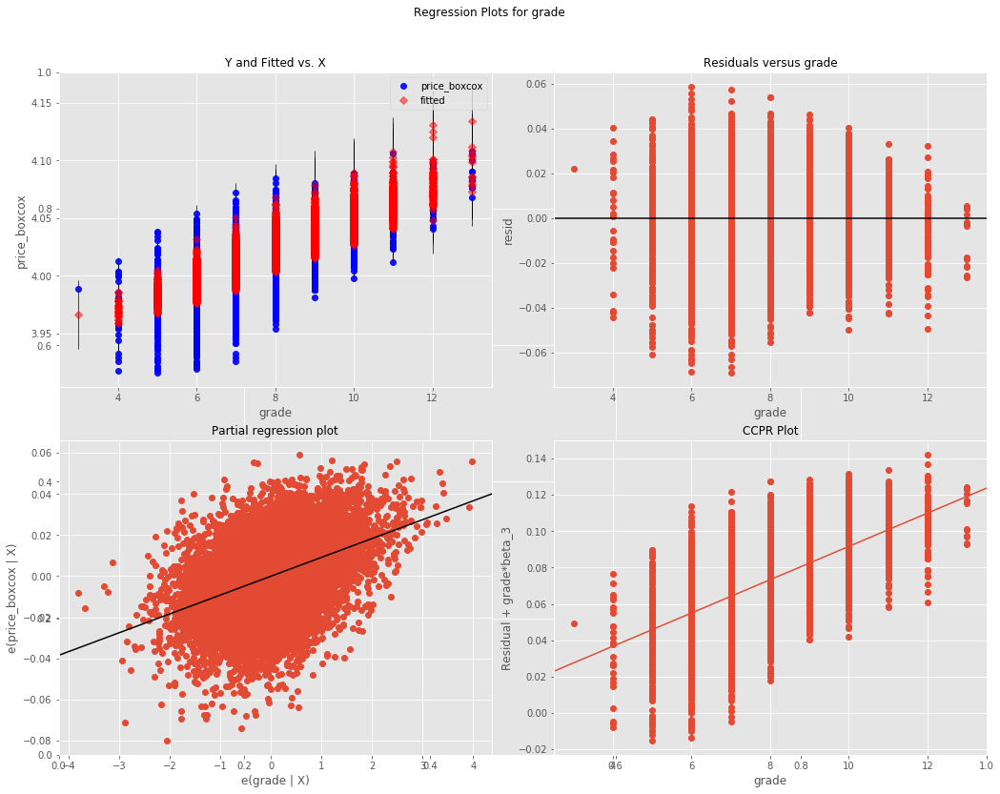

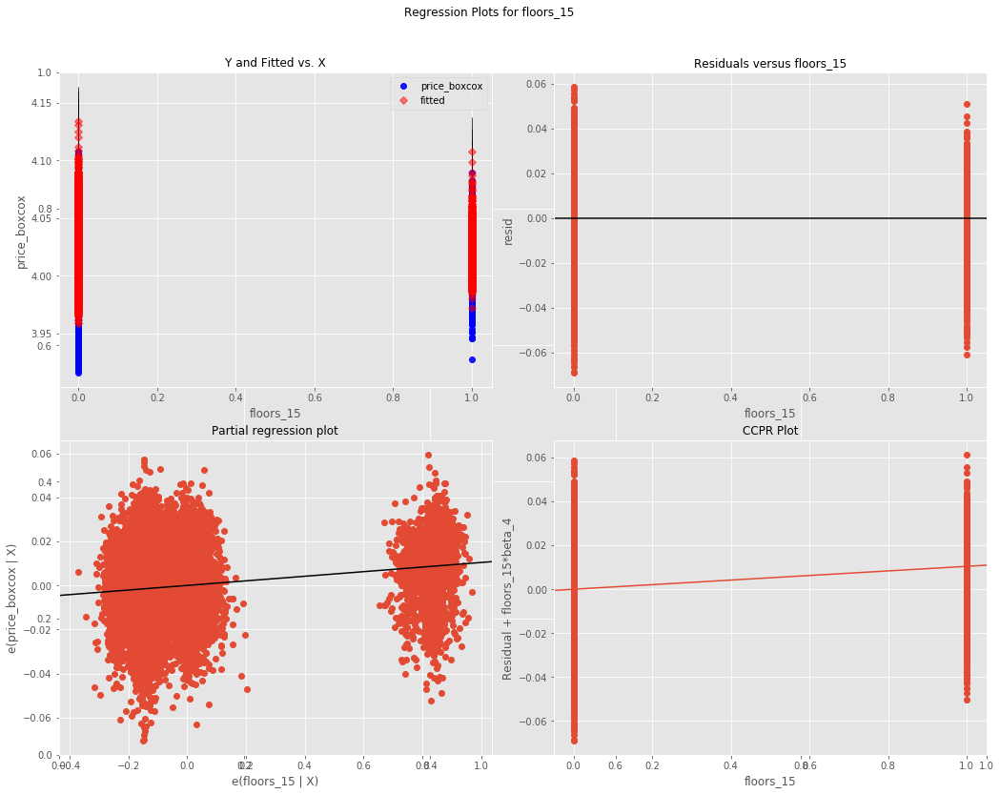

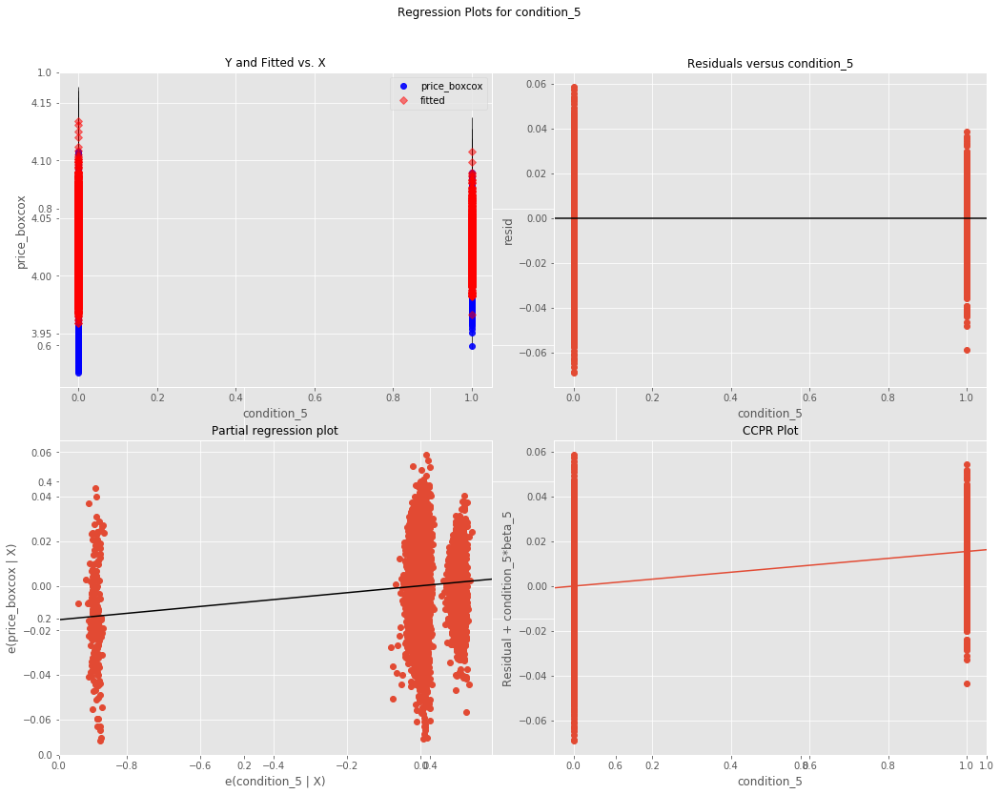

...

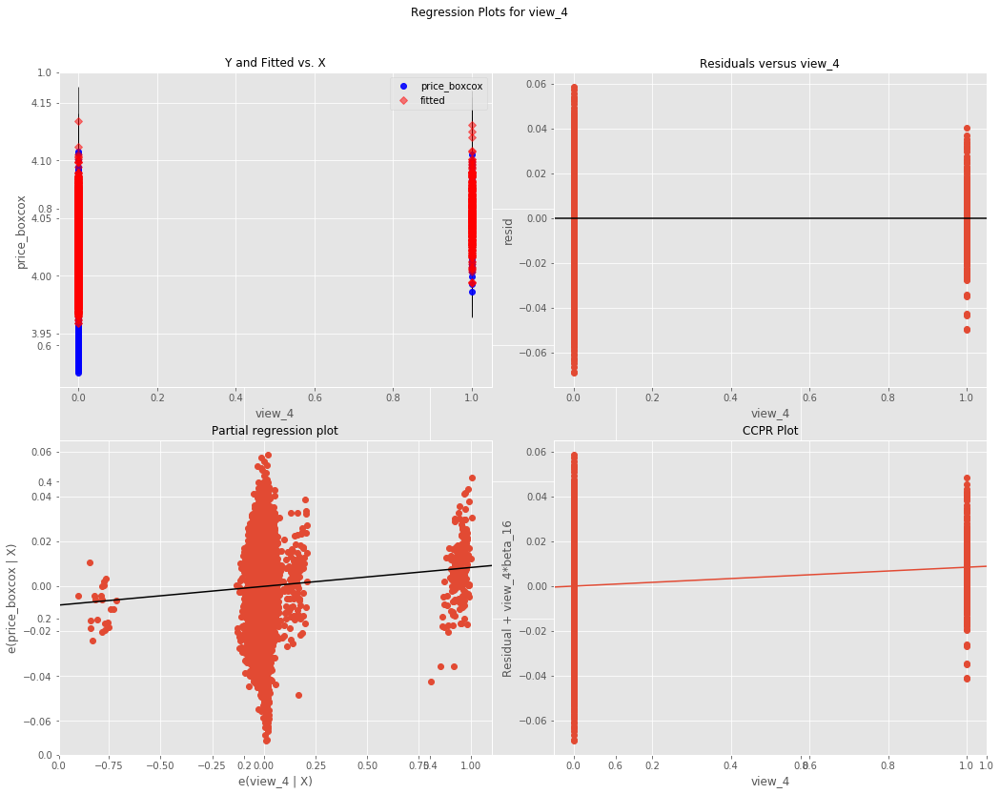

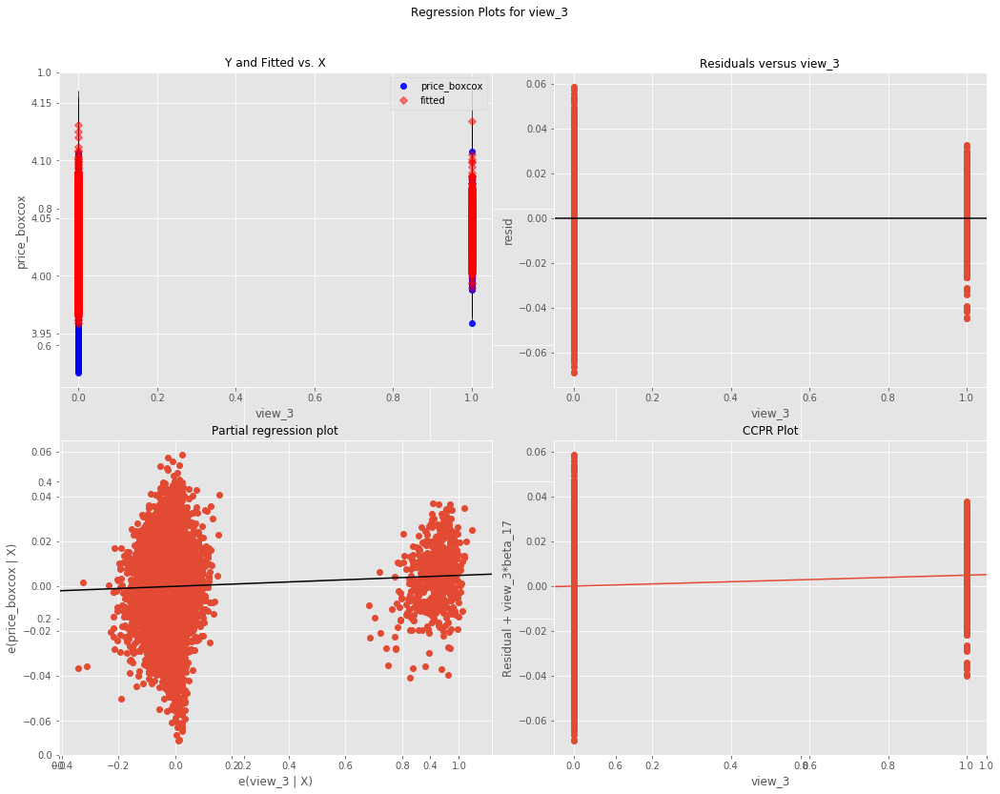

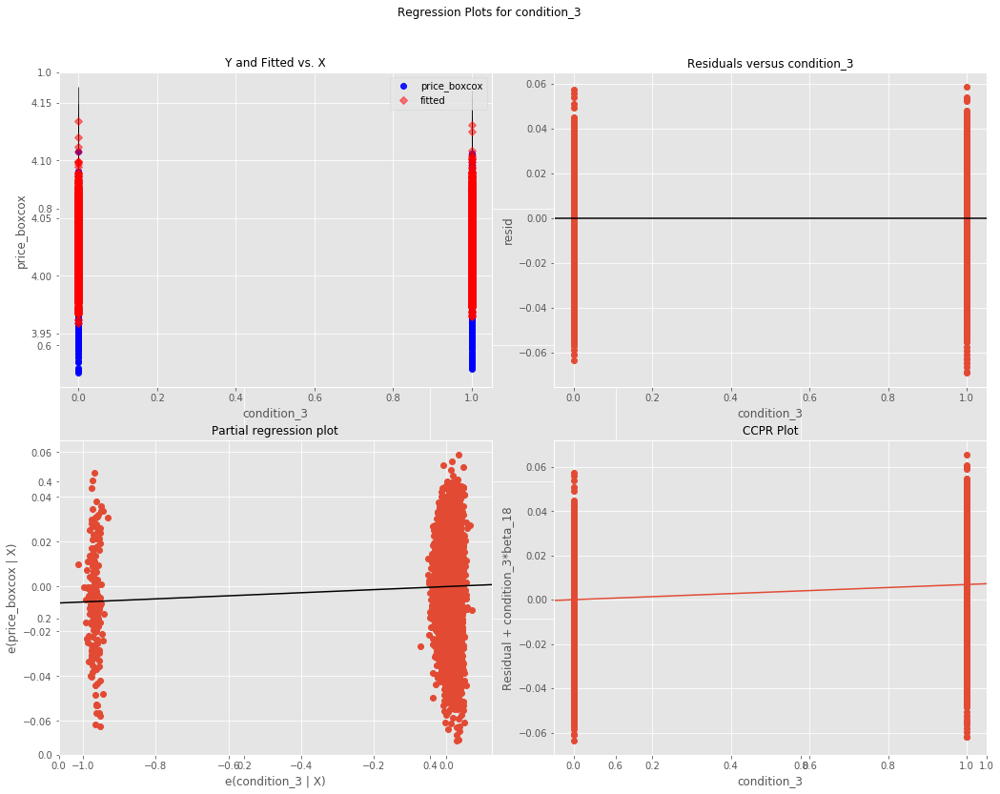

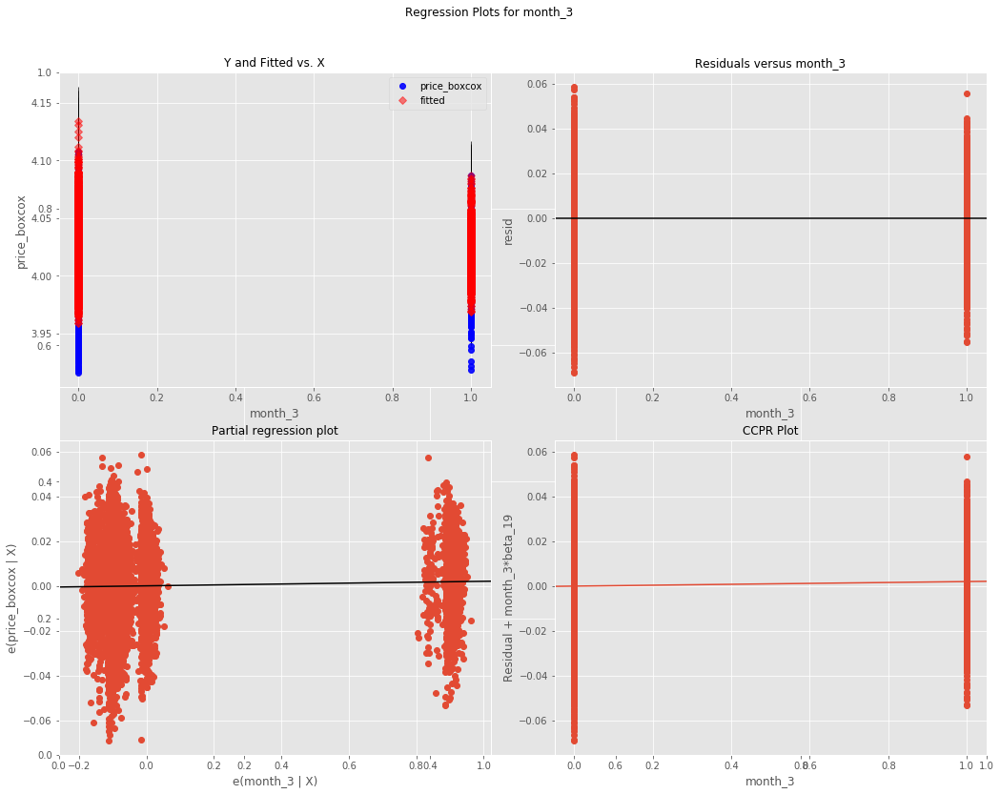

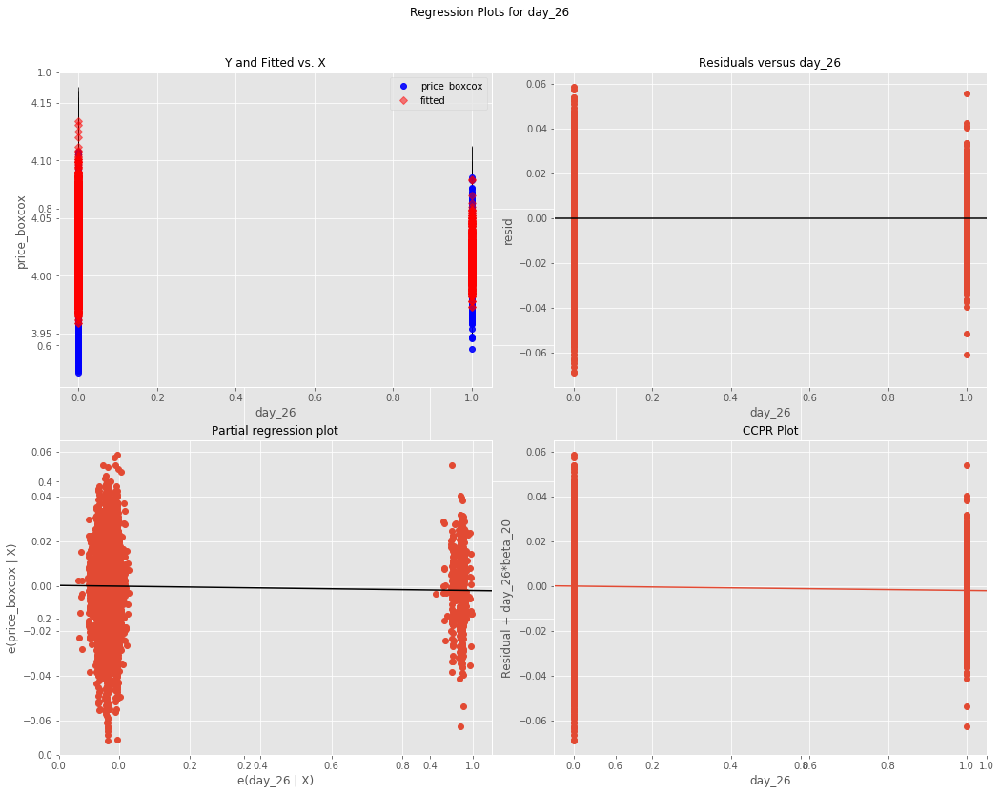

In [91]:
# plot residual plots
for col in X:
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, col, fig=fig)
    plt.show()

In [92]:
# Now run single variable regressions of each predictor

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~price_boxcox
-------------------------------------------------------------------------------------


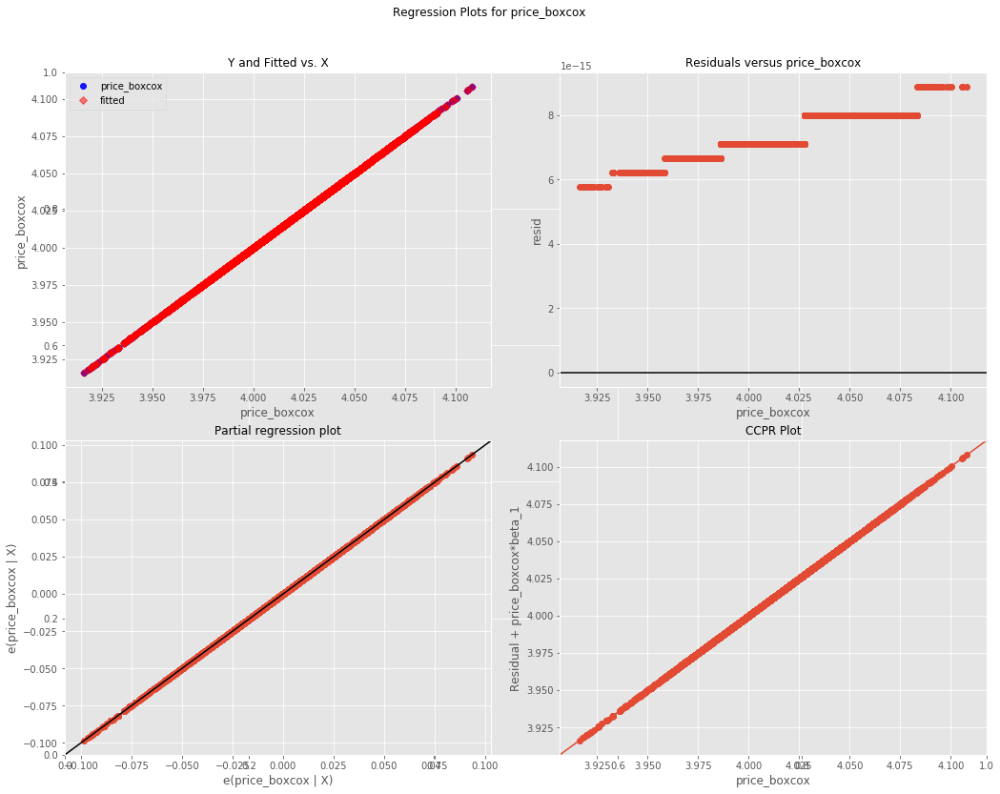

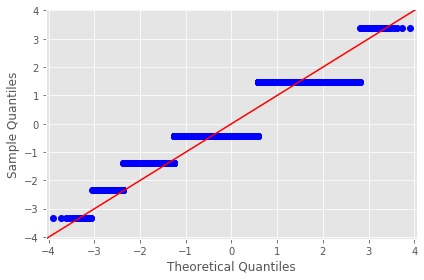

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~sqft_basement
-------------------------------------------------------------------------------------


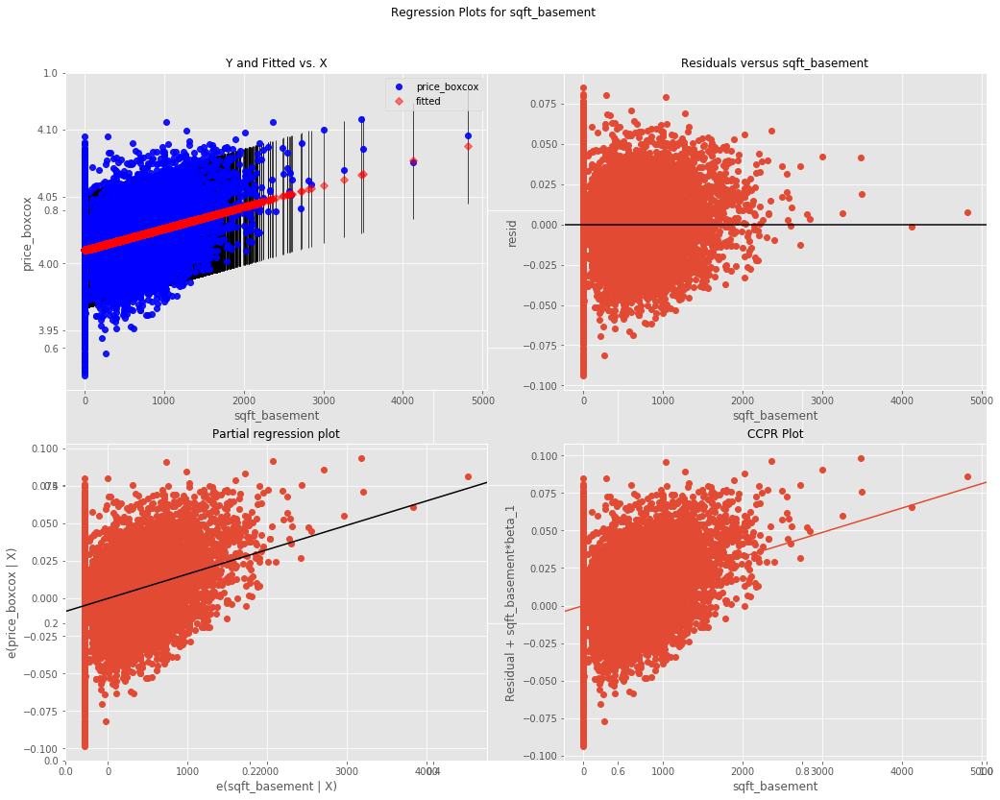

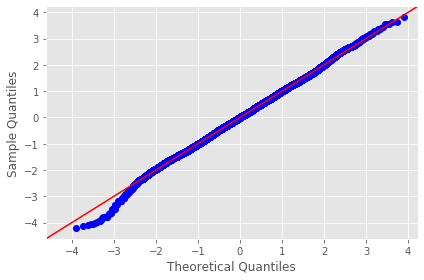

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~sqft_living15
-------------------------------------------------------------------------------------


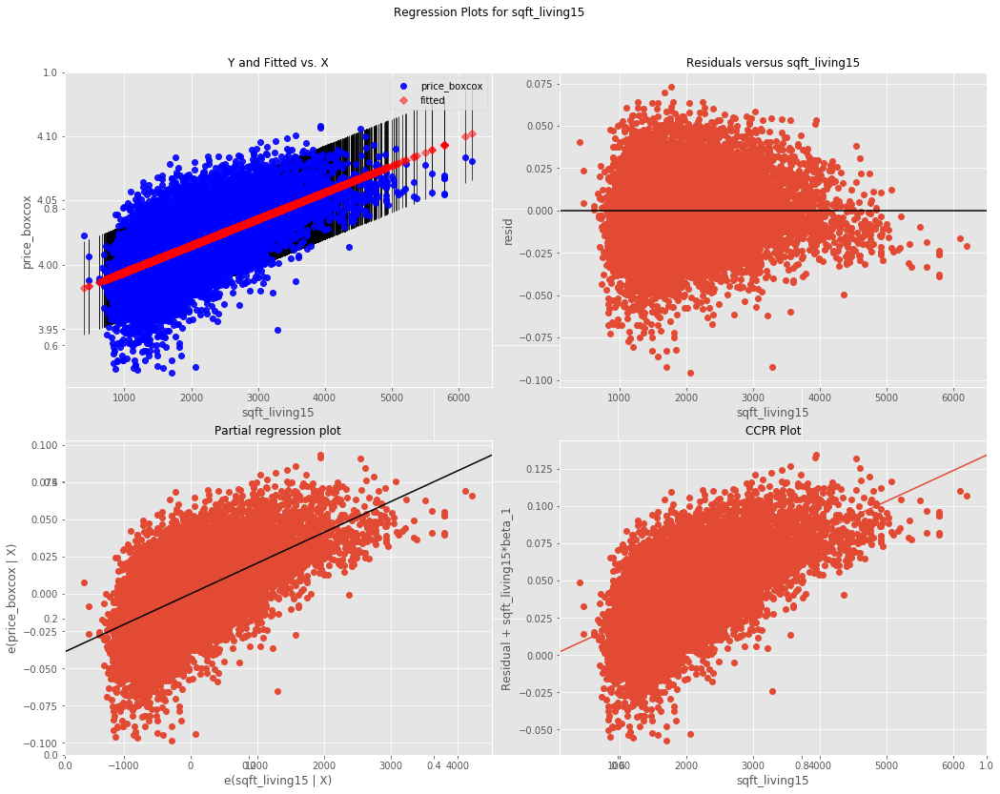

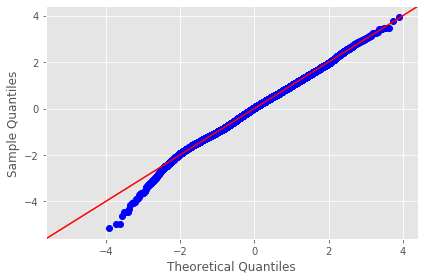

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~grade
-------------------------------------------------------------------------------------


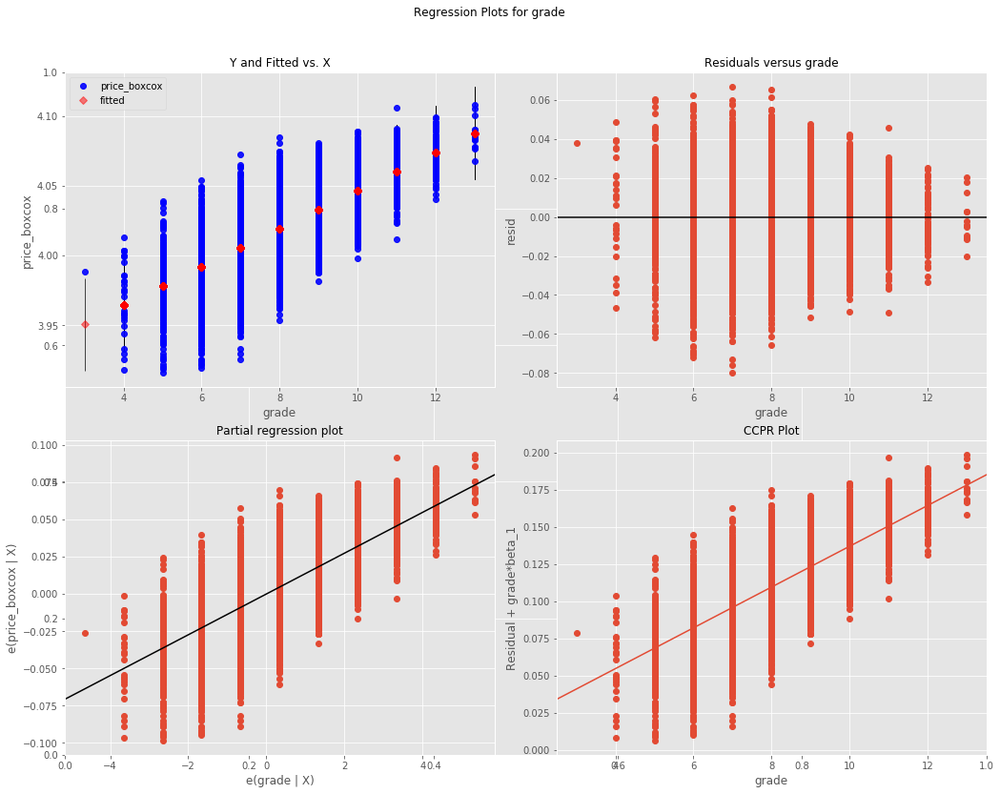

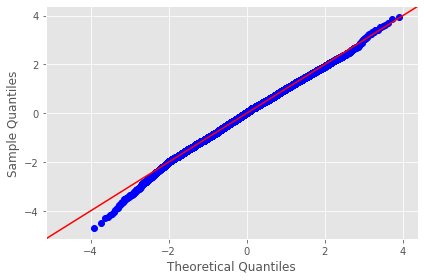

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_15
-------------------------------------------------------------------------------------


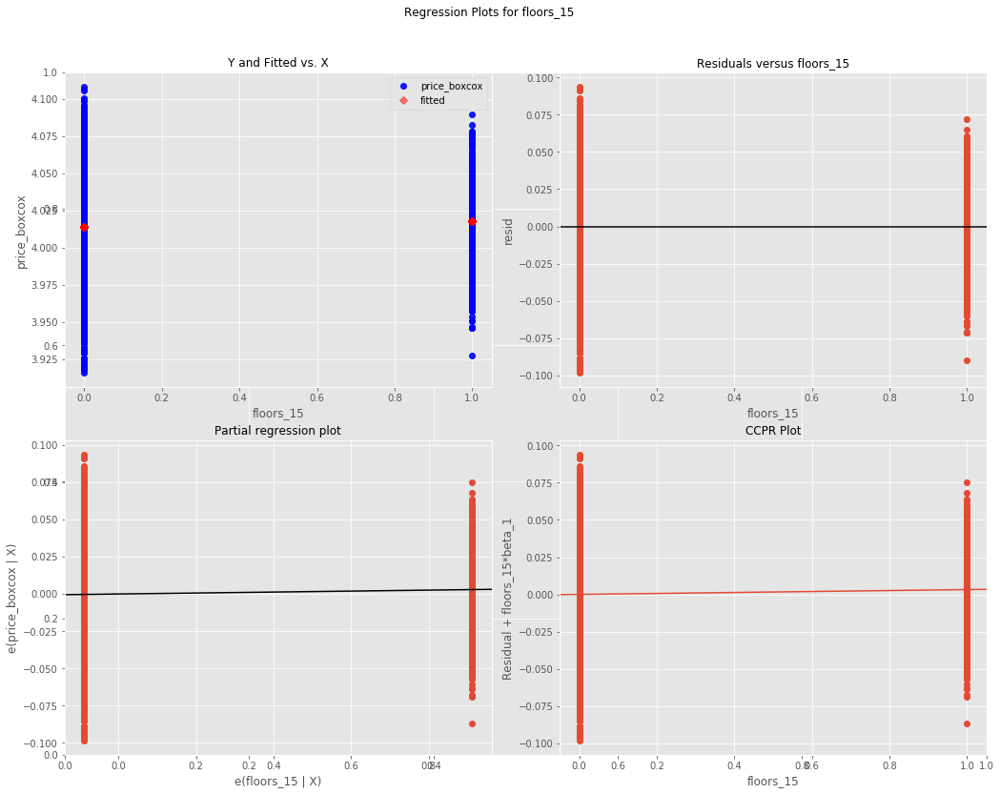

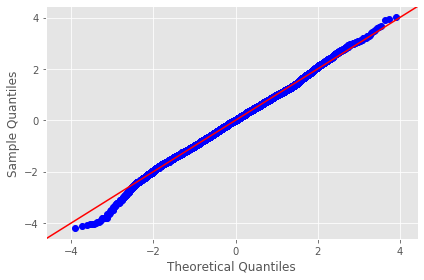

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_5
-------------------------------------------------------------------------------------


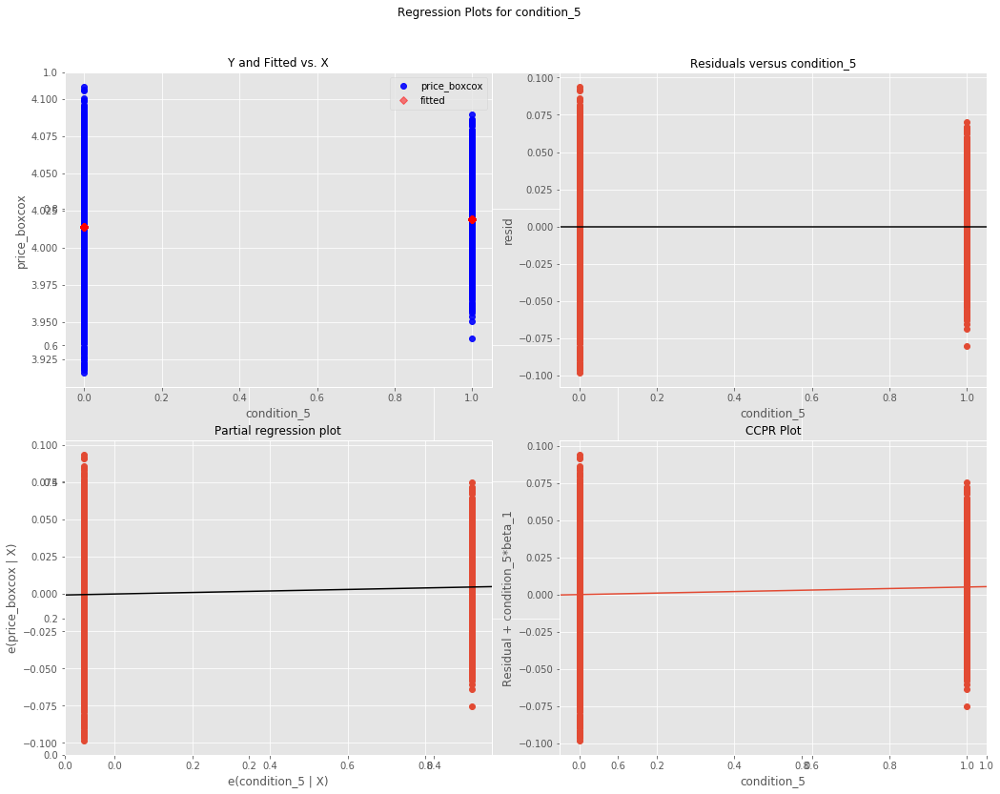

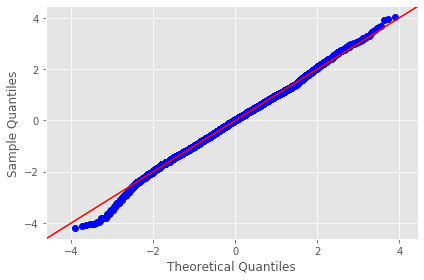

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~reno_1
-------------------------------------------------------------------------------------


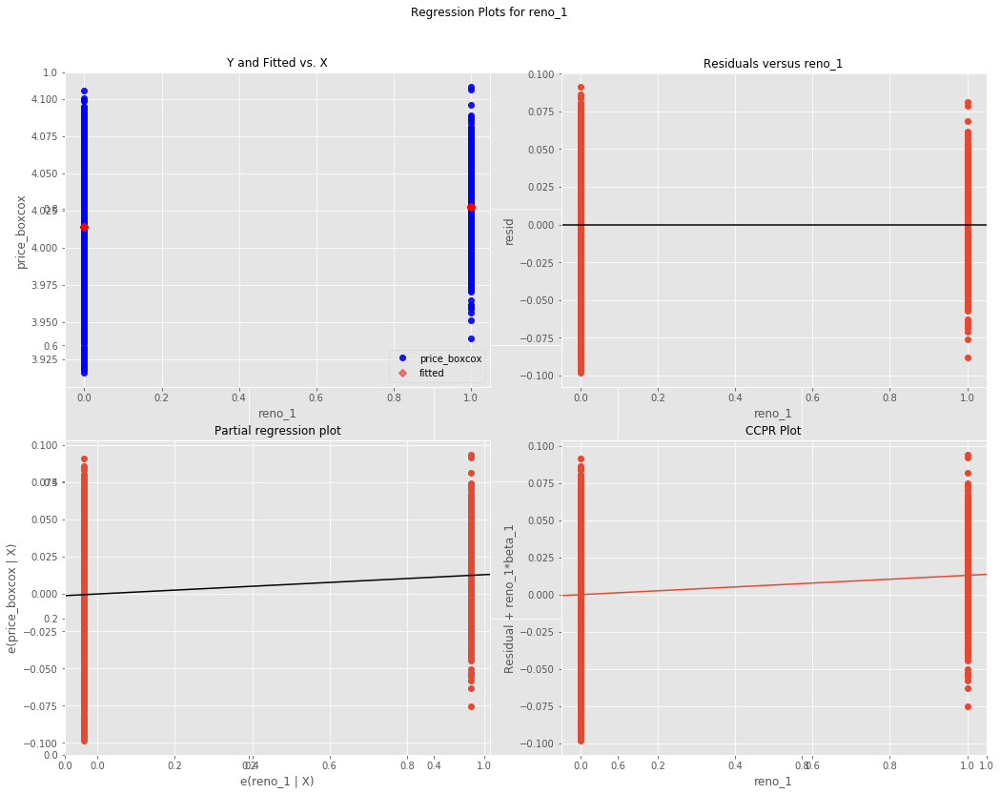

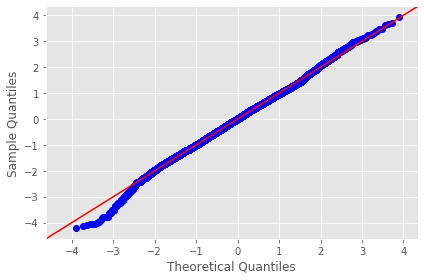

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~water_1
-------------------------------------------------------------------------------------


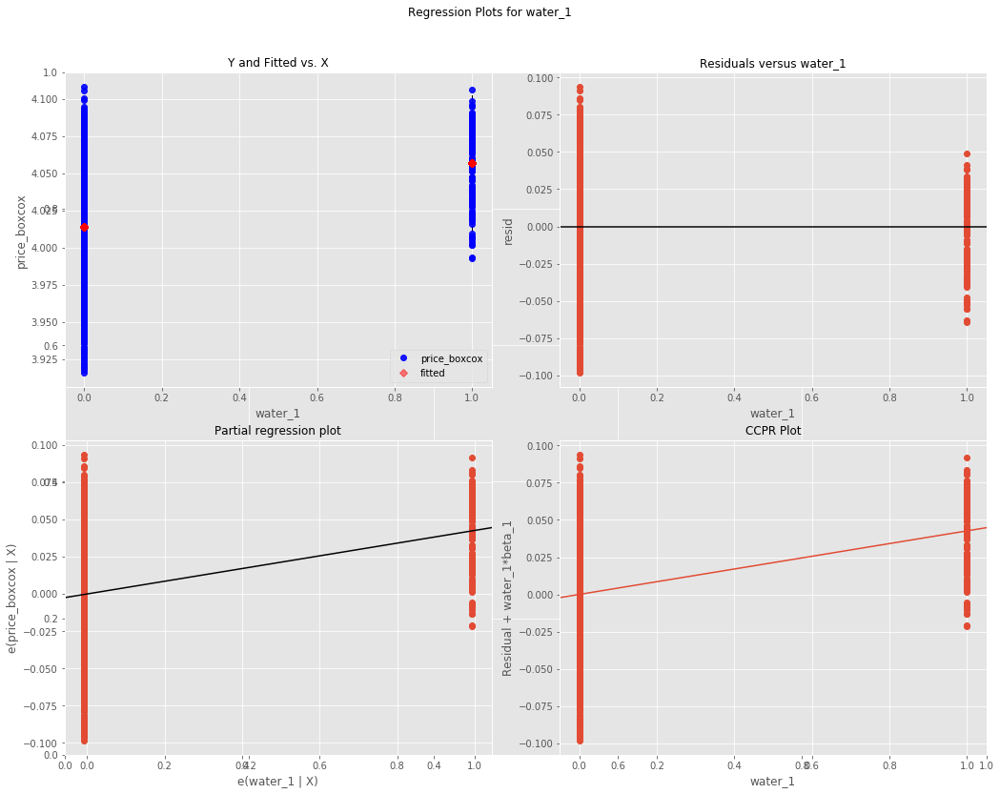

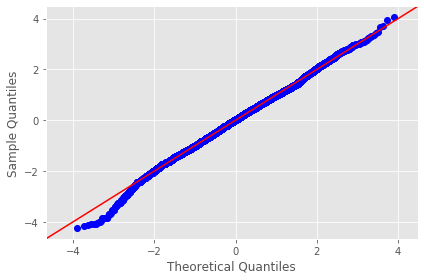

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~bathrooms
-------------------------------------------------------------------------------------


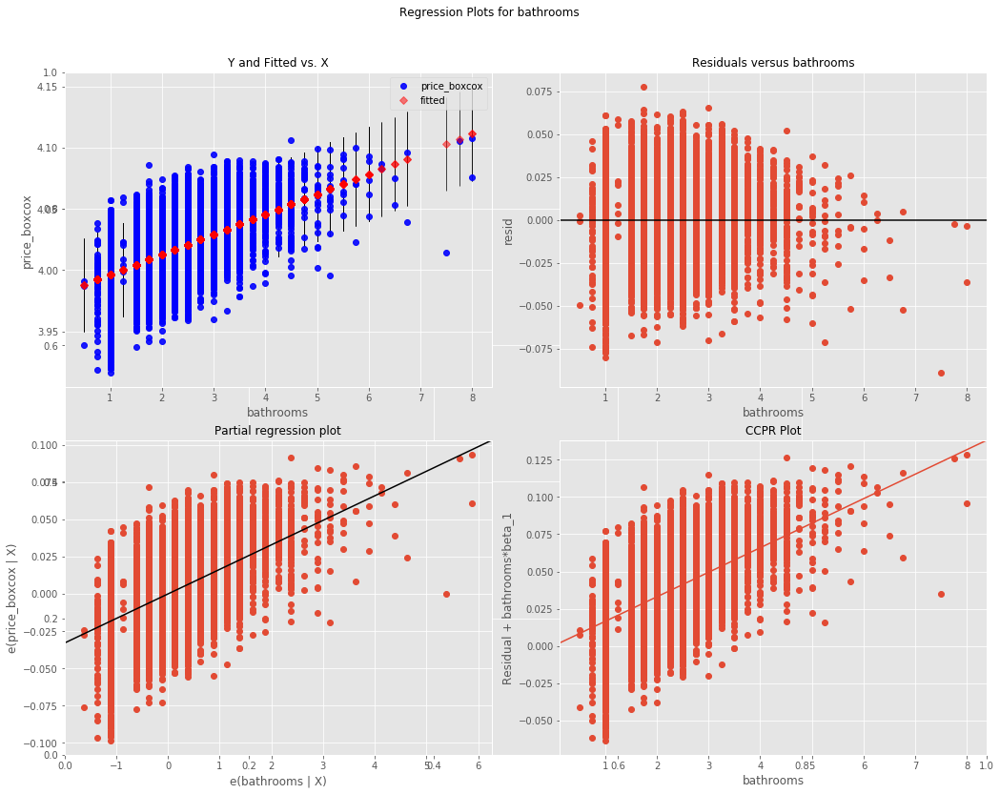

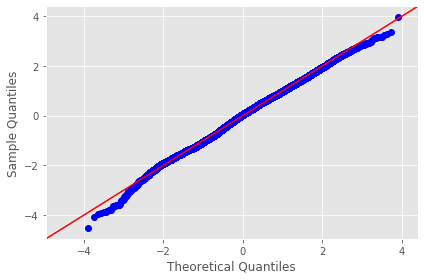

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_4
-------------------------------------------------------------------------------------


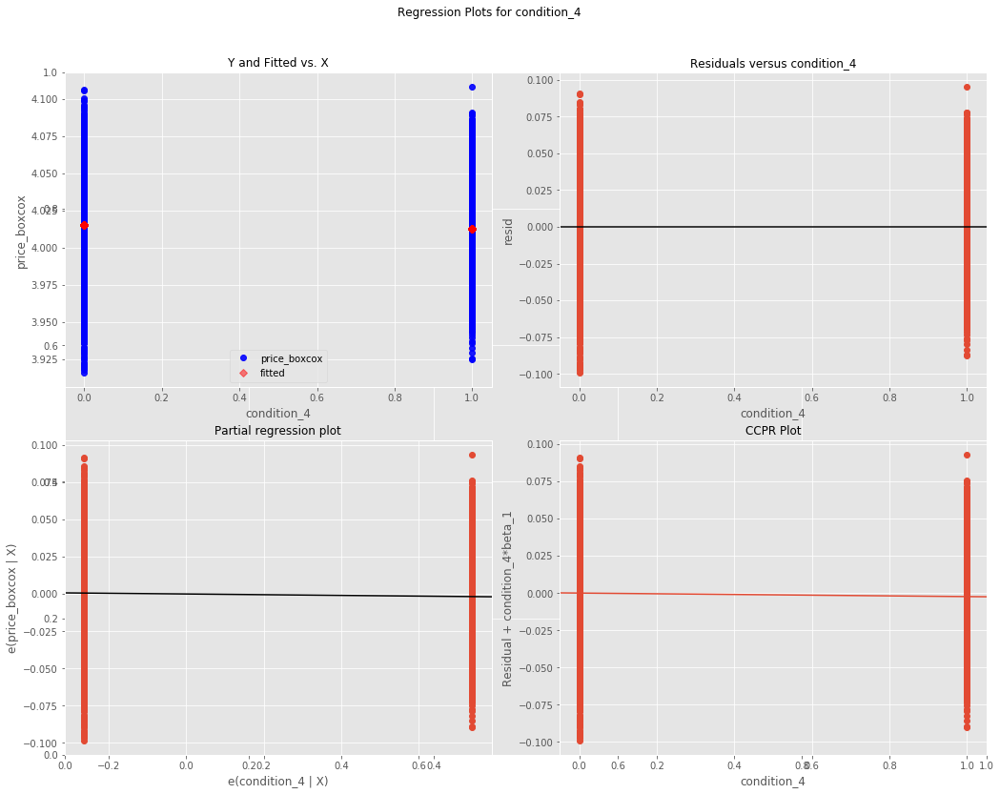

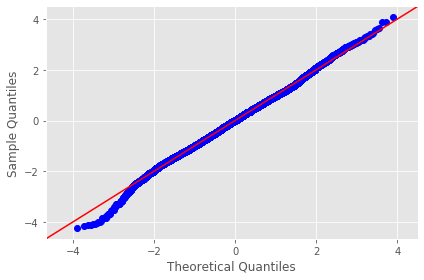

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_30
-------------------------------------------------------------------------------------


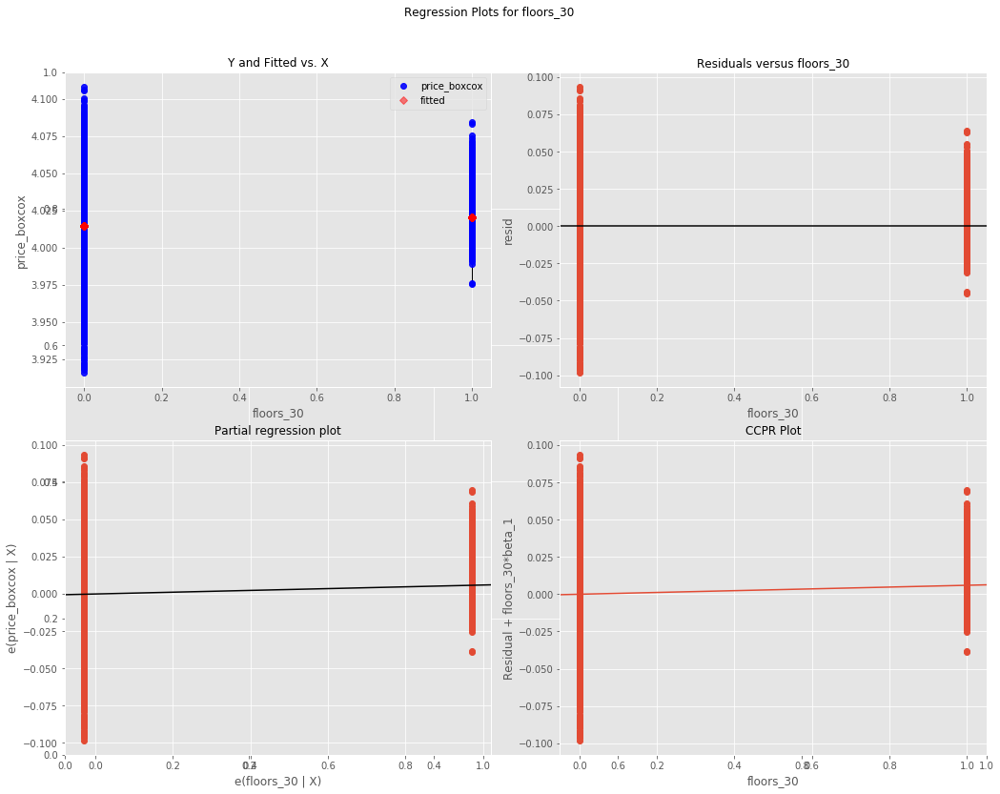

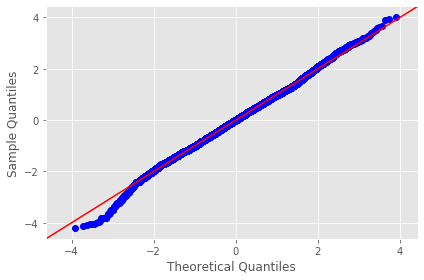

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_4
-------------------------------------------------------------------------------------


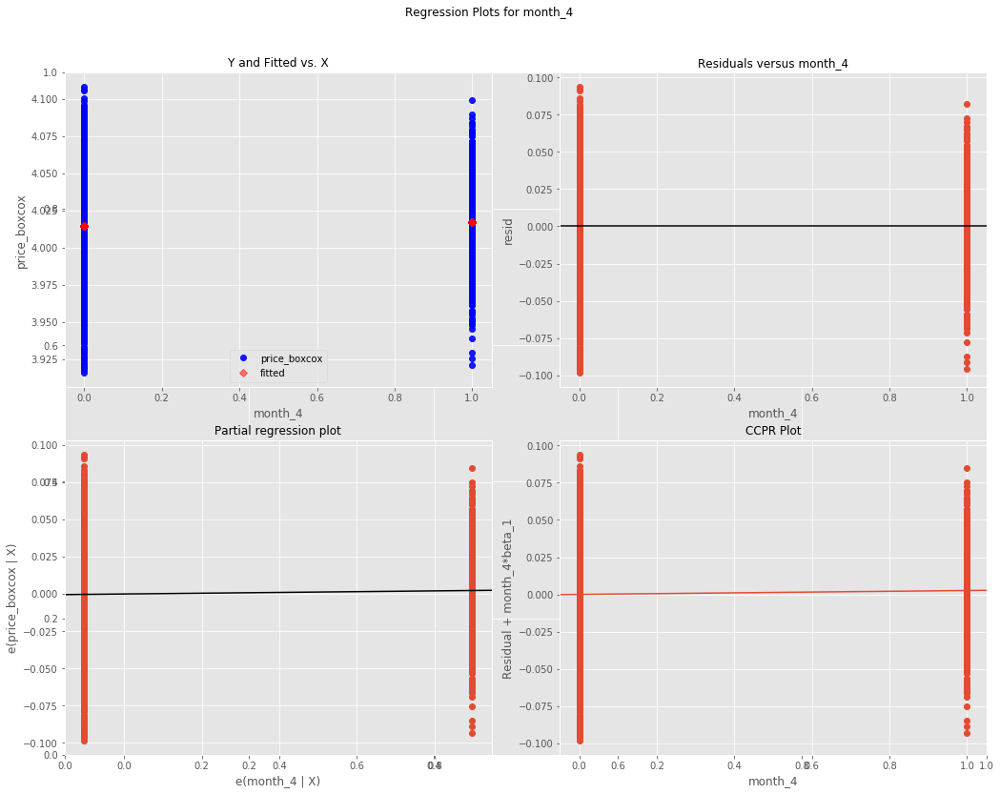

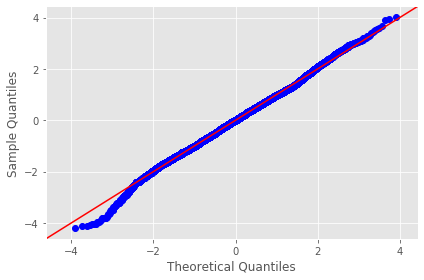

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_2
-------------------------------------------------------------------------------------


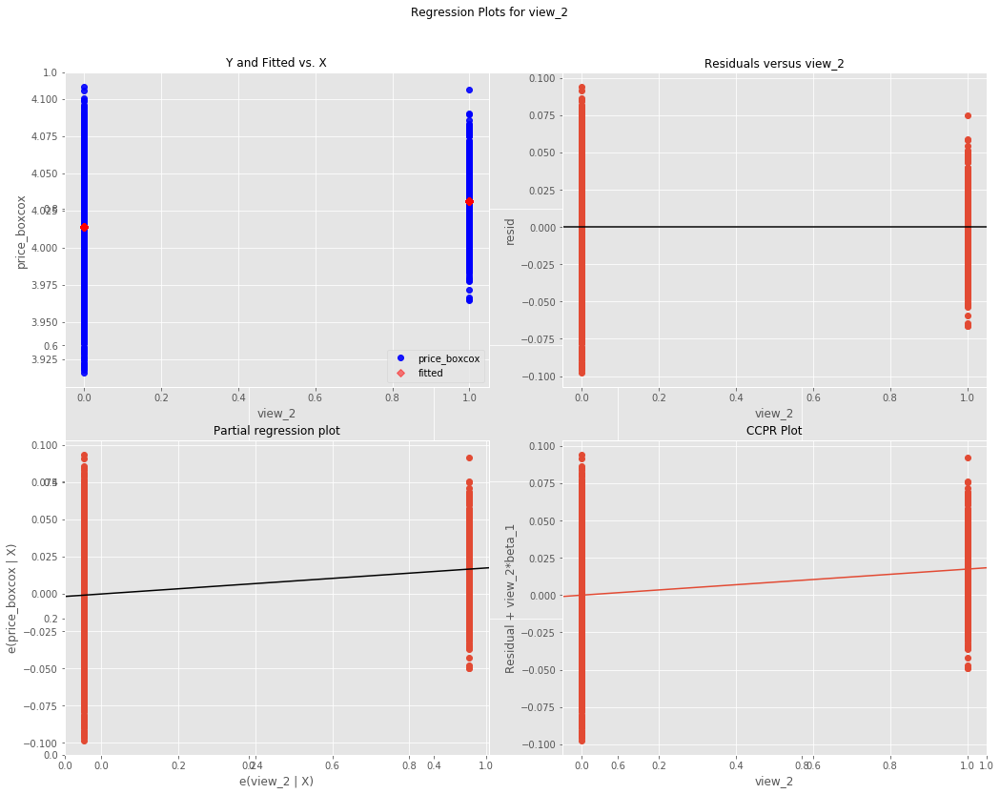

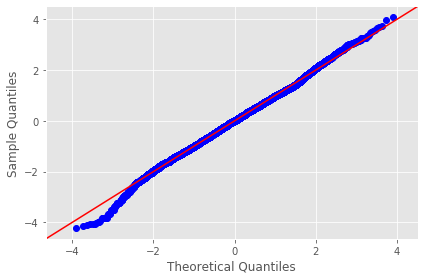

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_1
-------------------------------------------------------------------------------------


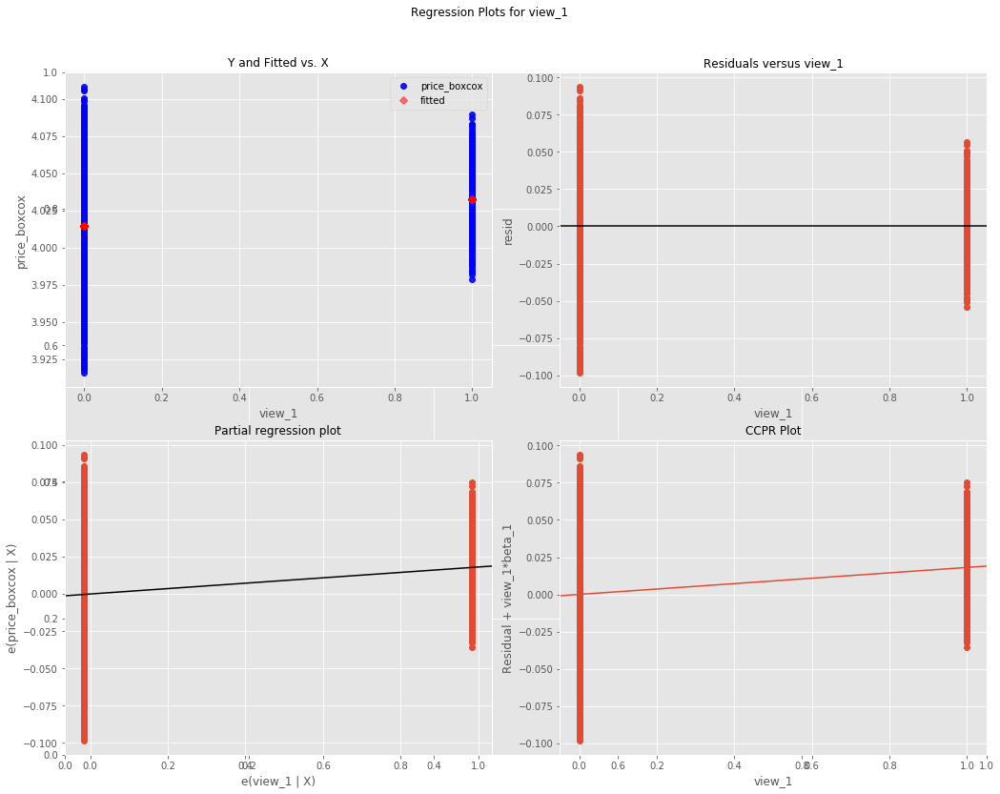

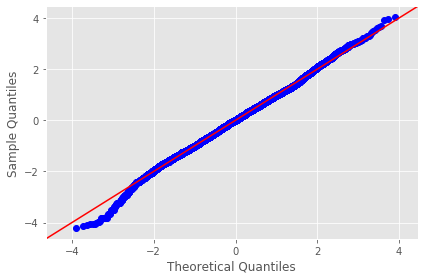

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_20
-------------------------------------------------------------------------------------


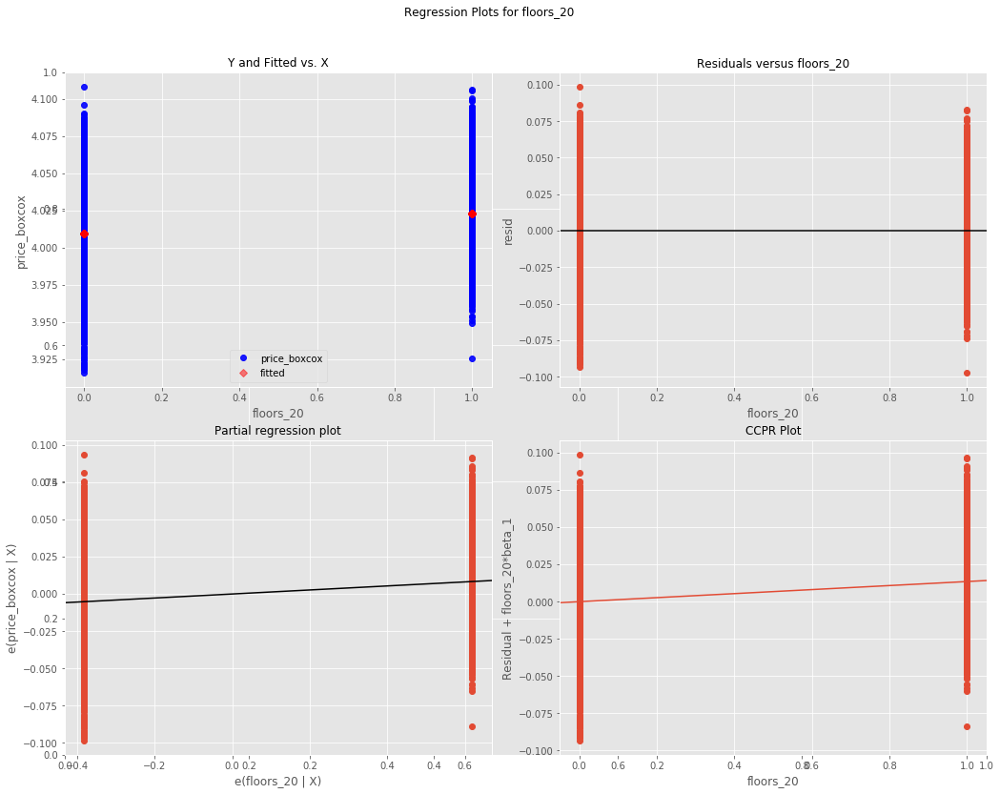

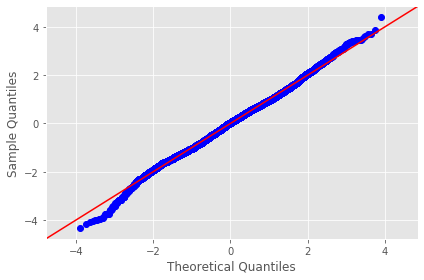

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_25
-------------------------------------------------------------------------------------


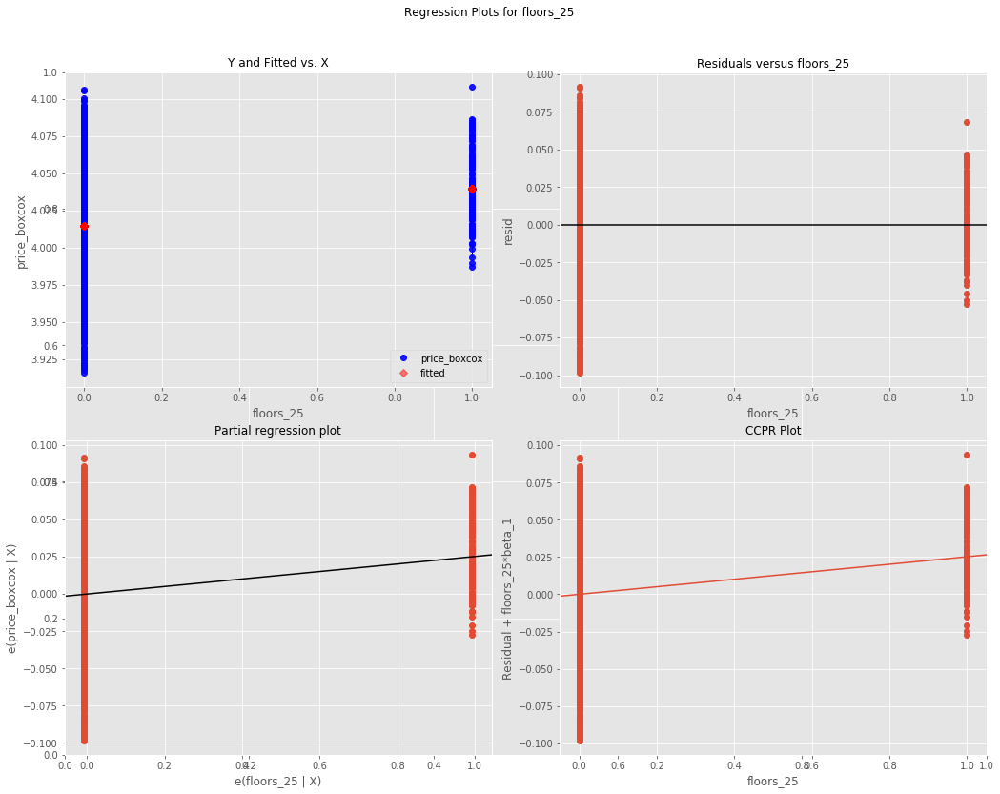

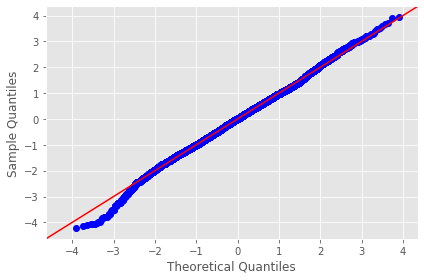

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_4
-------------------------------------------------------------------------------------


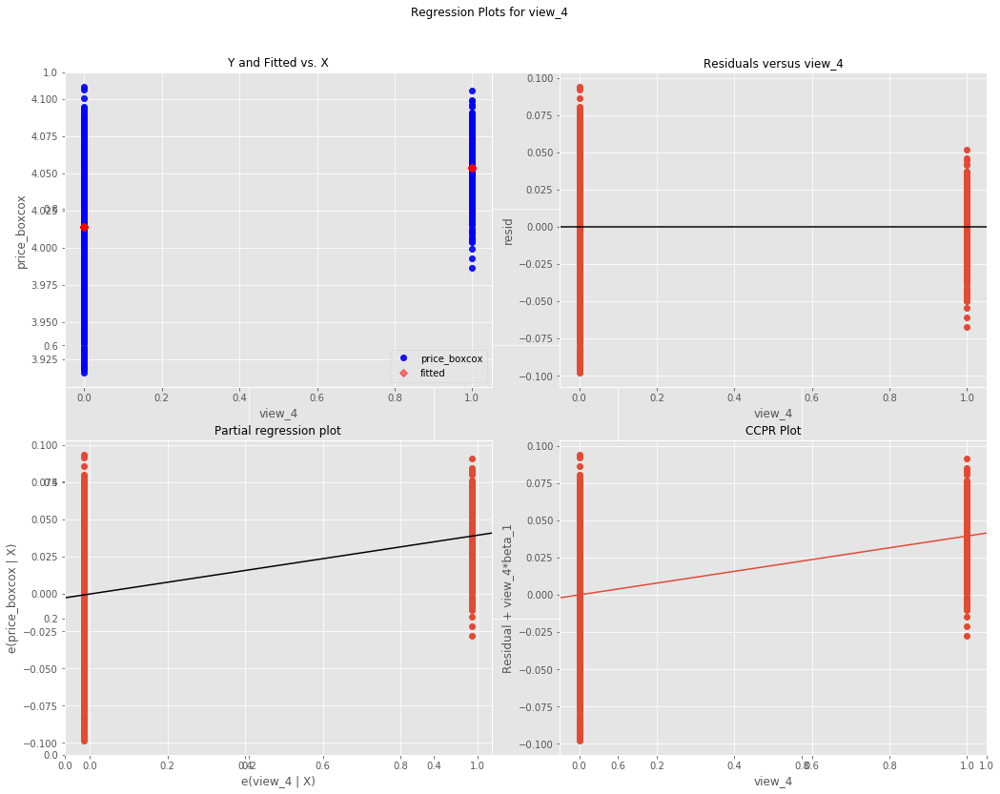

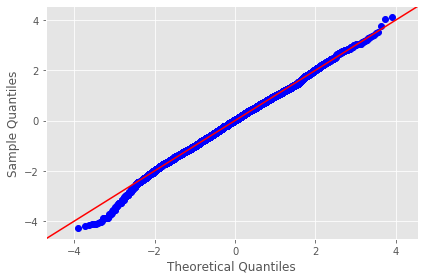

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_3
-------------------------------------------------------------------------------------


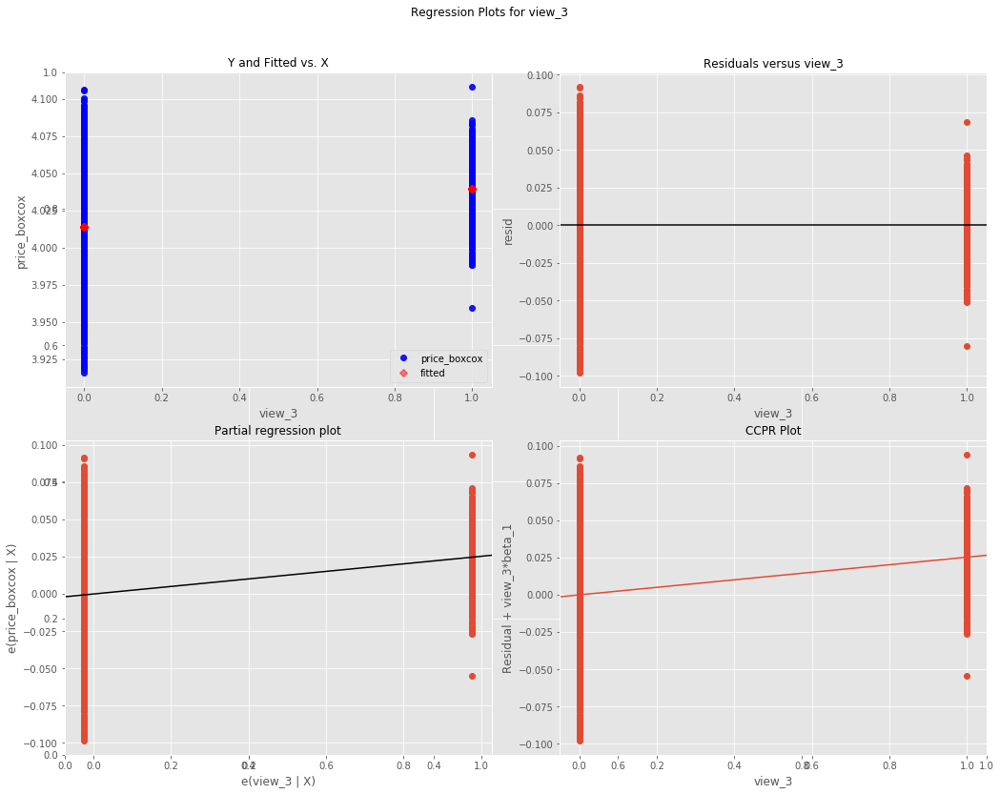

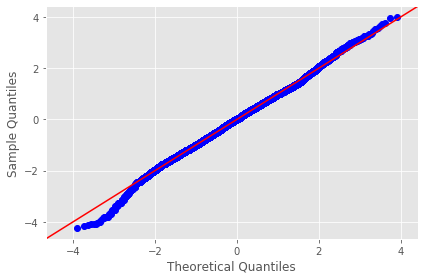

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_3
-------------------------------------------------------------------------------------


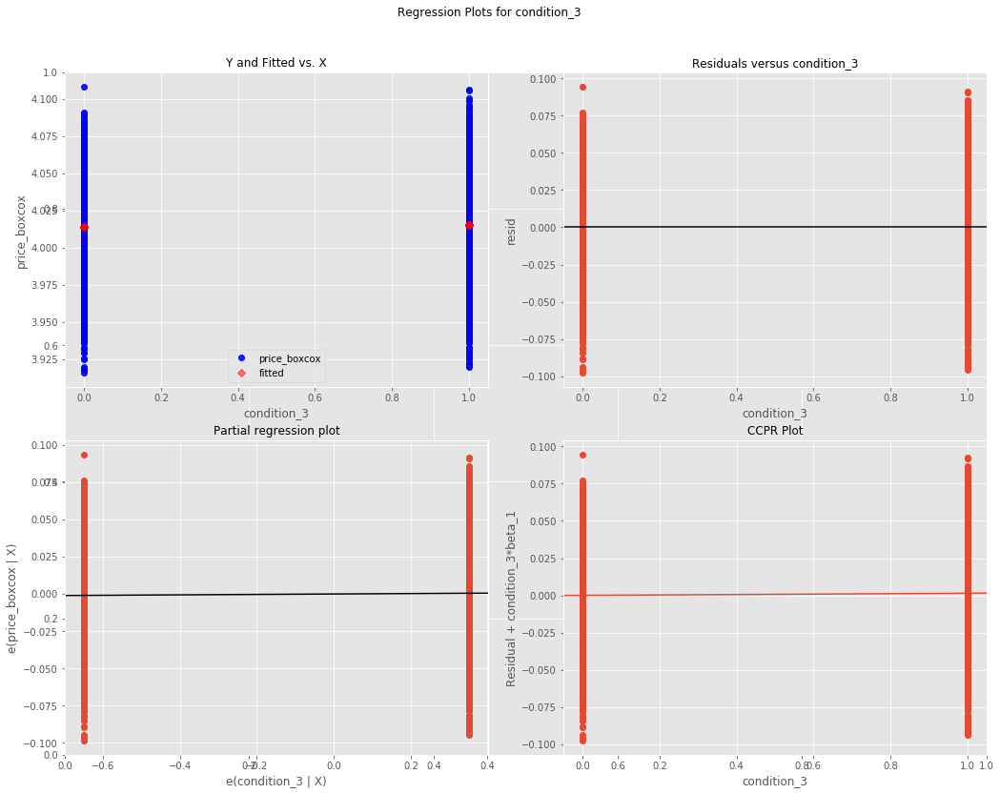

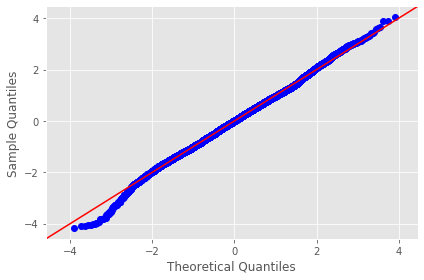

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_3
-------------------------------------------------------------------------------------


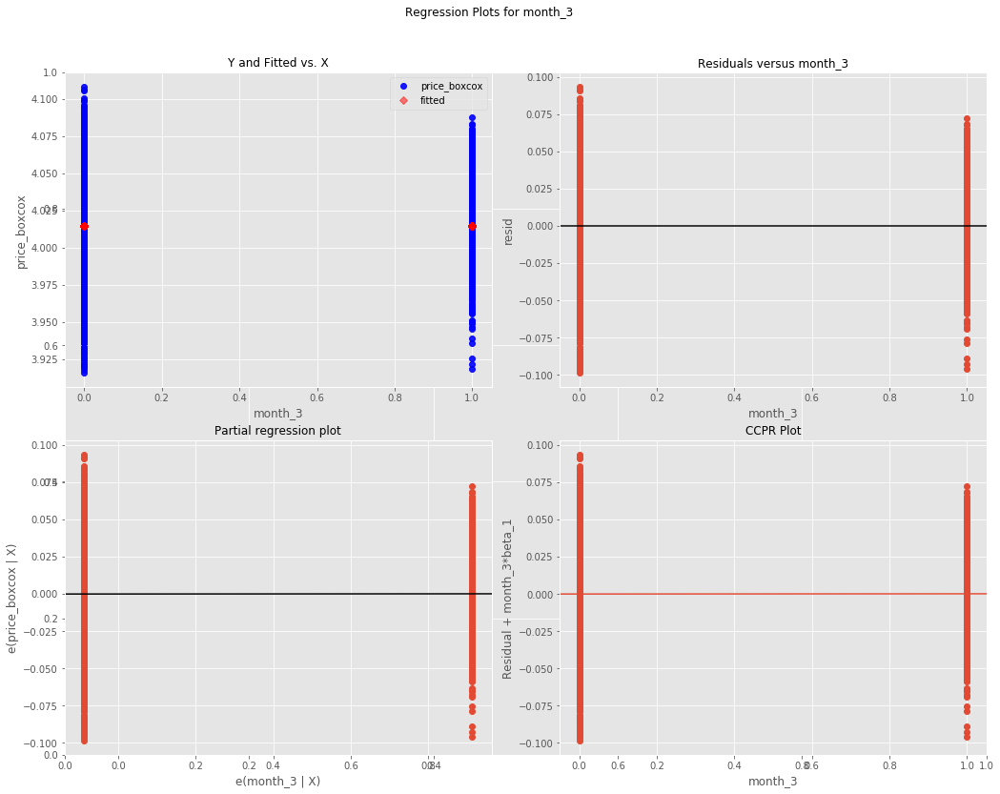

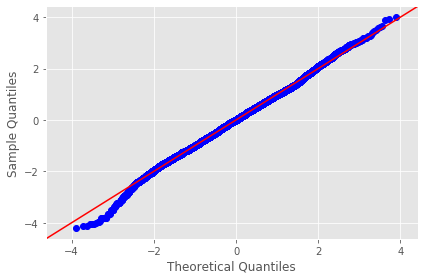

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~day_26
-------------------------------------------------------------------------------------


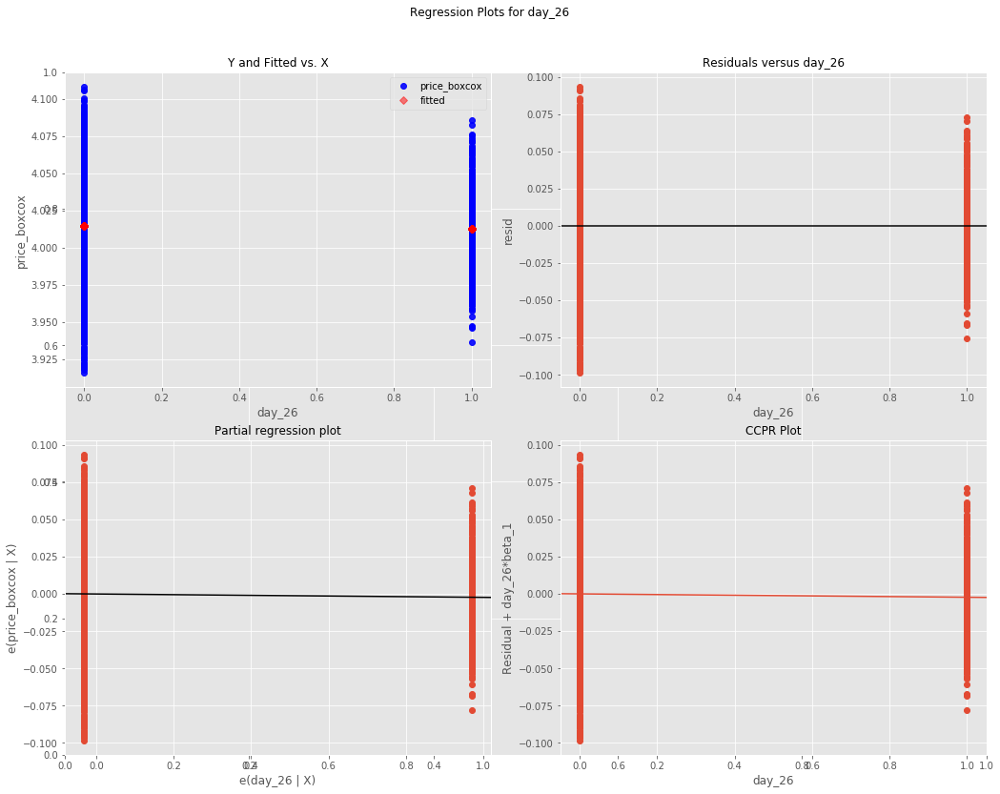

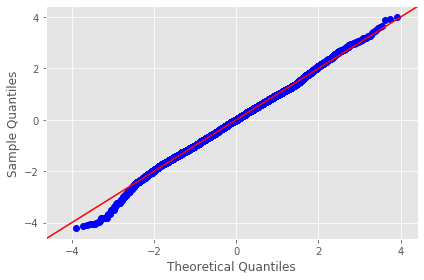

In [93]:
# evaluate residuals to further check assumptions
dataset = pd.concat([y, X], axis=1)
results = []
y = 'price_boxcox'
for idx, column in enumerate(dataset.columns):
    print (f"KC Housing DataSet - Regression Analysis and Diagnostics for {y}~{column}")
    print ("-------------------------------------------------------------------------------------")

    f = f'{y}~{column}'
    model = smf.ols(formula=f, data=dataset).fit()
    
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, column, fig=fig)
    fig = sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True)
    fig.tight_layout()
    plt.show()
    
    results.append([column, model.rsquared, model.params[0], model.params[1], model.pvalues[1], sms.jarque_bera(model.resid)[0]])

## Model 2 & Model 3 Results

In [94]:
# store results in dataframe to make future comparison easy
model_3_results = pd.DataFrame(results, columns=['ind_var', 
                                                  'r_squared', 
                                                  'intercept', 
                                                  'slope', 
                                                  'p-value', 
                                                  'normality (JB)'])

In [95]:
model_3_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price_boxcox,1.000000,5.684342e-14,1.000000,0.000000e+00,1348.428290
1,sqft_basement,0.094576,4.009900e+00,0.000016,0.000000e+00,38.626253
2,sqft_living15,0.367931,3.973619e+00,0.000021,0.000000e+00,124.351609
3,grade,0.475157,3.909716e+00,0.013700,0.000000e+00,80.384597
4,floors_15,0.001560,4.014342e+00,0.003250,9.611103e-09,90.699461
5,condition_5,0.003448,4.014228e+00,0.005083,1.422589e-17,83.223337
6,reno_1,0.010213,4.014185e+00,0.012962,5.555814e-49,85.569810
7,water_1,0.022228,4.014343e+00,0.042668,4.684418e-105,69.246752
8,bathrooms,0.294391,3.979764e+00,0.016477,0.000000e+00,33.585577
9,condition_4,0.001986,4.015249e+00,-0.002362,9.621329e-11,84.886606


In [96]:
model_2

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,log_price,1.000000,9.769963e-15,1.000000,0.000000e+00,218.090154
1,sqft_basement,0.100005,1.293849e+01,0.000377,0.000000e+00,681.256135
2,floors_20,0.078386,1.293247e+01,0.303390,0.000000e+00,1097.139872
3,sqft_living15,0.384221,1.210253e+01,0.000476,0.000000e+00,444.639805
4,grade,0.494483,1.063313e+01,0.315379,0.000000e+00,135.733894
5,floors_15,0.001381,1.304213e+01,0.069010,6.741304e-08,1110.573149
6,water_1,0.028537,1.304092e+01,1.090961,9.632611e-135,693.027534
7,condition_5,0.003701,1.303885e+01,0.118831,9.505505e-19,1054.048894
8,reno_1,0.011355,1.303765e+01,0.308417,2.744305e-54,978.100640
9,floors_30,0.001502,1.304475e+01,0.123369,1.820288e-08,1091.017342


Comparing the two models, and looking at JB values, we are seeing that there is a significant improvement on residual normality by moving to the boxcox transformation.  Additionally, when looking at the boxcox version, the q-q plots are looking much better than the baseline and slightly better than `log_price`

While normality of residuals is looking a lot stronger now, things still do not look great.  To this point, we have only transformed the target variable and made some changes to categorical columns via one-hot encoding. To further improve results and try to max r^2 while meeting assumptions for regression.  The majority of this improvement will come from cleaning up outliers, and transforming certain columns in similar ways to how we transformed price

## Model 4

Focus on predictors now to see if we can improve results and land on a final model. As shown in models 2 and 3, boxcox transformation is producing stronger results, especially related to normality of residuals so drop `log_price` and use `price_boxcox` only going forward.

In [97]:
# drop log_price
preprocessed_2 = preprocessed.drop('log_price', axis=1)

In [98]:
preprocessed_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21082 entries, 0 to 21596
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       21082 non-null  int64  
 1   bathrooms      21082 non-null  float64
 2   waterfront     21082 non-null  int64  
 3   view           21082 non-null  int64  
 4   condition      21082 non-null  int64  
 5   grade          21082 non-null  int64  
 6   sqft_basement  21082 non-null  float64
 7   sqft_living15  21082 non-null  int64  
 8   month_sold     21082 non-null  int64  
 9   day_sold       21082 non-null  int64  
 10  price_boxcox   21082 non-null  float64
 11  renovated      21082 non-null  int64  
 12  floors_10      21082 non-null  int64  
dtypes: float64(3), int64(10)
memory usage: 2.9 MB


Pull out the continuous columns to plot against `price_boxcox`

In [99]:
# cont. columns
numerical = ['sqft_basement', 'sqft_living15']
numerical_vars = preprocessed_2[numerical]

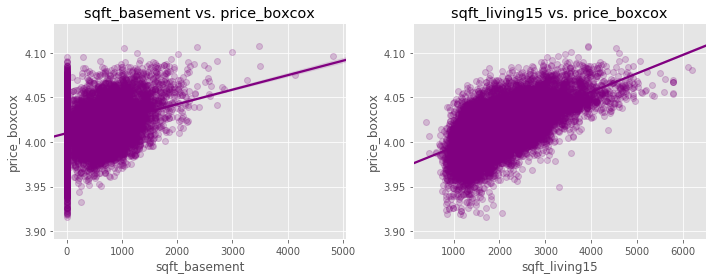

In [100]:
# plot numerical columns against price and see if transformations improve results
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=numerical_vars,
         nrows=1,
         ncols=2)

Both relationships are looking linearly related with `price_boxcox`.  `sqft_living15` looks like it would benefit from a transformation of some sort.  `sqft_basement` poses an issue given the number of 0s or non-basement entries that exist within the dataset.  The range in house prices for houses with no basements, is similar to the entire range of houses with basements, highlighting issues leaving the 0s in the data. 

Check the distributions.

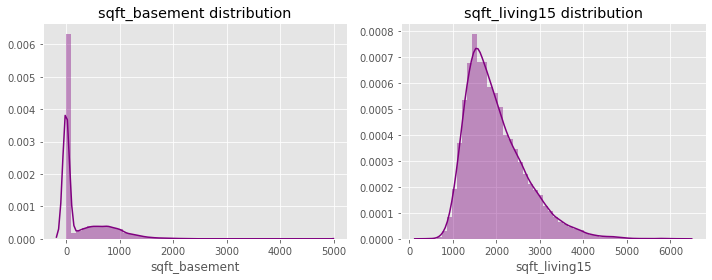

In [101]:
# plot distributions
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
for ax, feature in zip(axes.flatten(), numerical_vars):
    sns.distplot(preprocessed_2[feature], ax=ax, color='purple');
    ax.set_title(f'{feature} distribution')

plt.tight_layout()

Can clearly see that `sqft_basement` is bimodal, with large number of zeros.  `sqft_living15` has some right skew and is looking somewhat log normally distributed.  Treat `sqft_basement` as a categorical column, and then OHE. 

In [102]:
# sqft_basement has a lot of zeros - - and there is a relationship
# between sqft_basement and price so long as there is a basement
# going to treat sqft_basement as a categorical column
preprocessed_2['basement'] = preprocessed_2['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)
ohe_list = []
ohe_list.append('basement')

# drop sqft_basement
preprocessed_2.drop('sqft_basement', axis=1, inplace=True)

Given distributions and relationships to `price_boxcox`, use a boxcox transformation on `sqft_living15`

In [103]:
# transform sqft_living_15 using boxcox transformation
preprocessed_2['t_sqft_liv_15'], fitted_lambda = stats.boxcox(preprocessed_2['sqft_living15'])

# drop sqft_living15
preprocessed_2.drop('sqft_living15', axis=1, inplace=True)

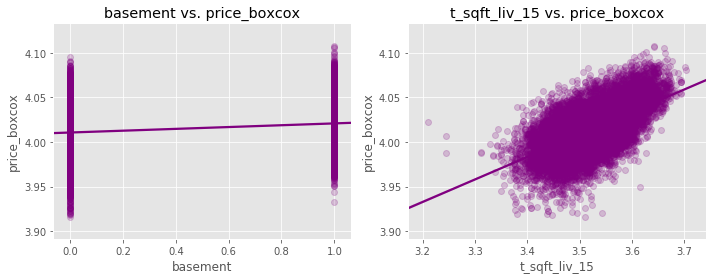

In [104]:
# plot against price again
numerical = ['basement', 't_sqft_liv_15']
numerical_vars = preprocessed_2[numerical]

plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=numerical_vars,
         nrows=1,
         ncols=2)

Relationship between `t_sqft_liv_15` and `price_boxcox` is far more linear now.

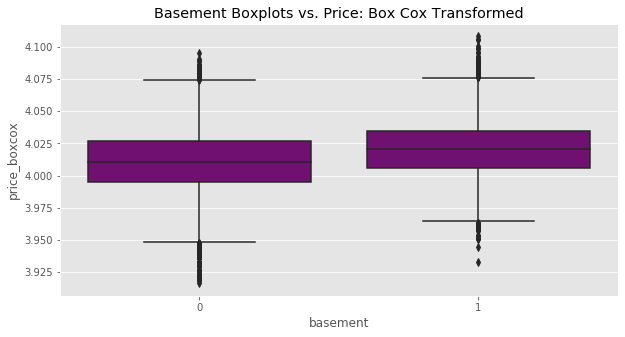

In [105]:
# plot basement boxplots vs. price to see if having a basement is related to higher price
plt.figure(figsize=(10, 5))
sns.boxplot(x='basement', y='price_boxcox', data=preprocessed_2, color='purple');
plt.title('Basement Boxplots vs. Price: Box Cox Transformed')
plt.show()

The difference in houses with basements and those without basements is not drastically different, but the median house price for houses with basements is slightly higher.  

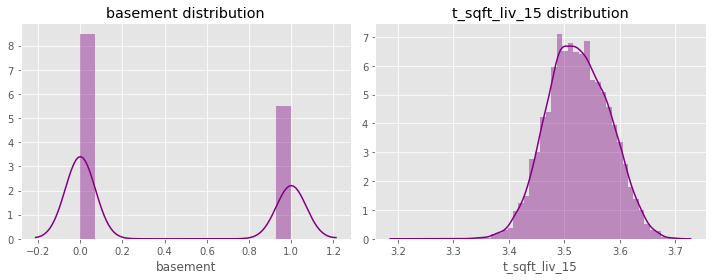

In [106]:
# look at distributions
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
for ax, feature in zip(axes.flatten(), numerical_vars):
    sns.distplot(preprocessed_2[feature], ax=ax, color='purple');
    ax.set_title(f'{feature} distribution')

plt.tight_layout()

The transformed `sqft_living15` variable, `t_sqft_liv_15` is far more normally distributed looking following the transformation.  There does appear to potentially be some left skew, but overall things are looking much better.

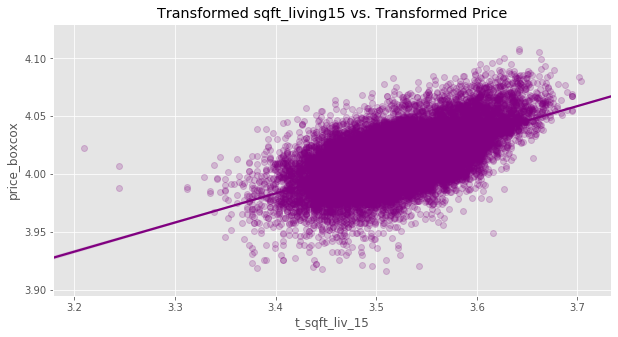

In [107]:
# replot against price
plt.figure(figsize=(10, 5))
sns.regplot(x='t_sqft_liv_15', y='price_boxcox', data=preprocessed_2, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Transformed sqft_living15 vs. Transformed Price')
plt.show()

There are a number of outliers present and visible.  Try cleaning these up.

In [108]:
# how many less than 3.3?
preprocessed_2.loc[preprocessed_2['t_sqft_liv_15'] < 3.3]['price_boxcox'].count()

3

In [109]:
# only 3 and they are clearly outliers, drop these
preprocessed_2 = preprocessed_2.loc[preprocessed_2['t_sqft_liv_15'] >= 3.3]

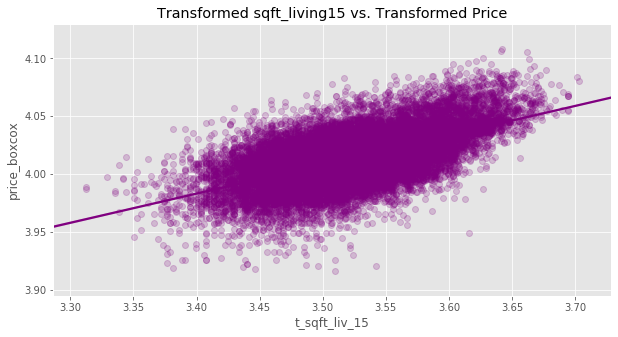

In [110]:
# replot
plt.figure(figsize=(10, 5))
sns.regplot(x='t_sqft_liv_15', y='price_boxcox', data=preprocessed_2, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Transformed sqft_living15 vs. Transformed Price')
plt.show()

In [111]:
# looking far more linear - - see if we can clean up some of these additional
# outliers
preprocessed_2.loc[(preprocessed_2['t_sqft_liv_15'] > 3.6)
                  & (preprocessed_2['price_boxcox'] < 3.95)]['price_boxcox'].count()

1

In [112]:
# drop this point
index = preprocessed_2.loc[(preprocessed_2['t_sqft_liv_15'] > 3.6)
                  & (preprocessed_2['price_boxcox'] < 3.95)].index

In [113]:
preprocessed_2 = preprocessed_2.drop(index)

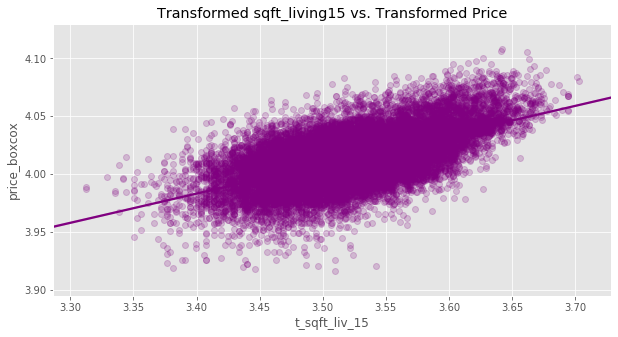

In [114]:
# replot
plt.figure(figsize=(10, 5))
sns.regplot(x='t_sqft_liv_15', y='price_boxcox', data=preprocessed_2, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Transformed sqft_living15 vs. Transformed Price')
plt.show()

In [115]:
# how many less than 3.35
preprocessed_2.loc[preprocessed_2['t_sqft_liv_15'] < 3.35]['price_boxcox'].count()

11

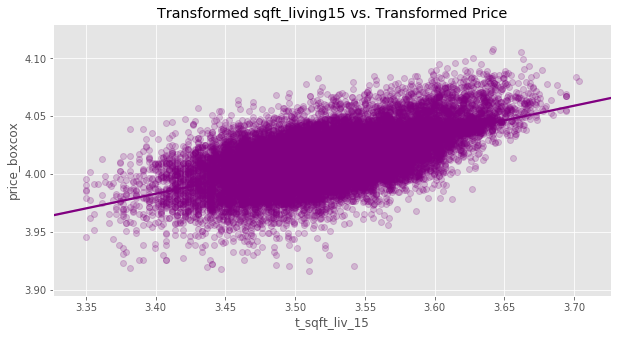

In [116]:
# drop these, they look like outliers
preprocessed_2 = preprocessed_2.loc[preprocessed_2['t_sqft_liv_15'] >= 3.35]

# replot
plt.figure(figsize=(10, 5))
sns.regplot(x='t_sqft_liv_15', y='price_boxcox', data=preprocessed_2, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Transformed sqft_living15 vs. Transformed Price')
plt.show()

In [117]:
# how man with a price less than 3.925?
preprocessed_2.loc[preprocessed_2['price_boxcox'] < 3.94]['price_boxcox'].count()

49

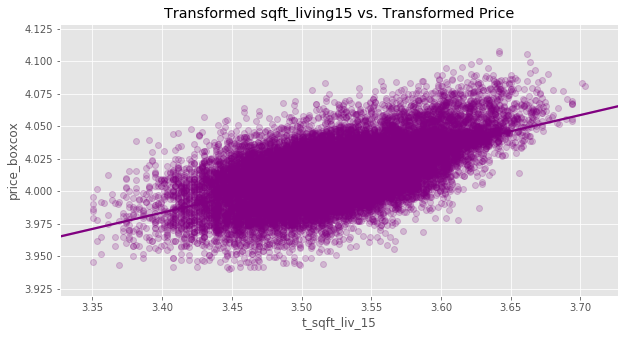

In [118]:
# drop these
preprocessed_2 = preprocessed_2.loc[preprocessed_2['price_boxcox'] > 3.94]

# replot
plt.figure(figsize=(10, 5))
sns.regplot(x='t_sqft_liv_15', y='price_boxcox', data=preprocessed_2, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Transformed sqft_living15 vs. Transformed Price')
plt.show()

Given transformations, the relationship between `t_sqft_liv_15` is looking very linear now, with a large number of outliers removed. Now that all continuous columns have been handled, move to the categorical columns.

In [119]:
# evaluate and handle categorical columns
# create boxplots for all cat columns
cat_cols = ['bedrooms', 'bathrooms', 'floors_10', 'waterfront', 'view', 'condition', 
            'grade', 'month_sold', 'day_sold', 'renovated']
cat_predictors = preprocessed_2[cat_cols]

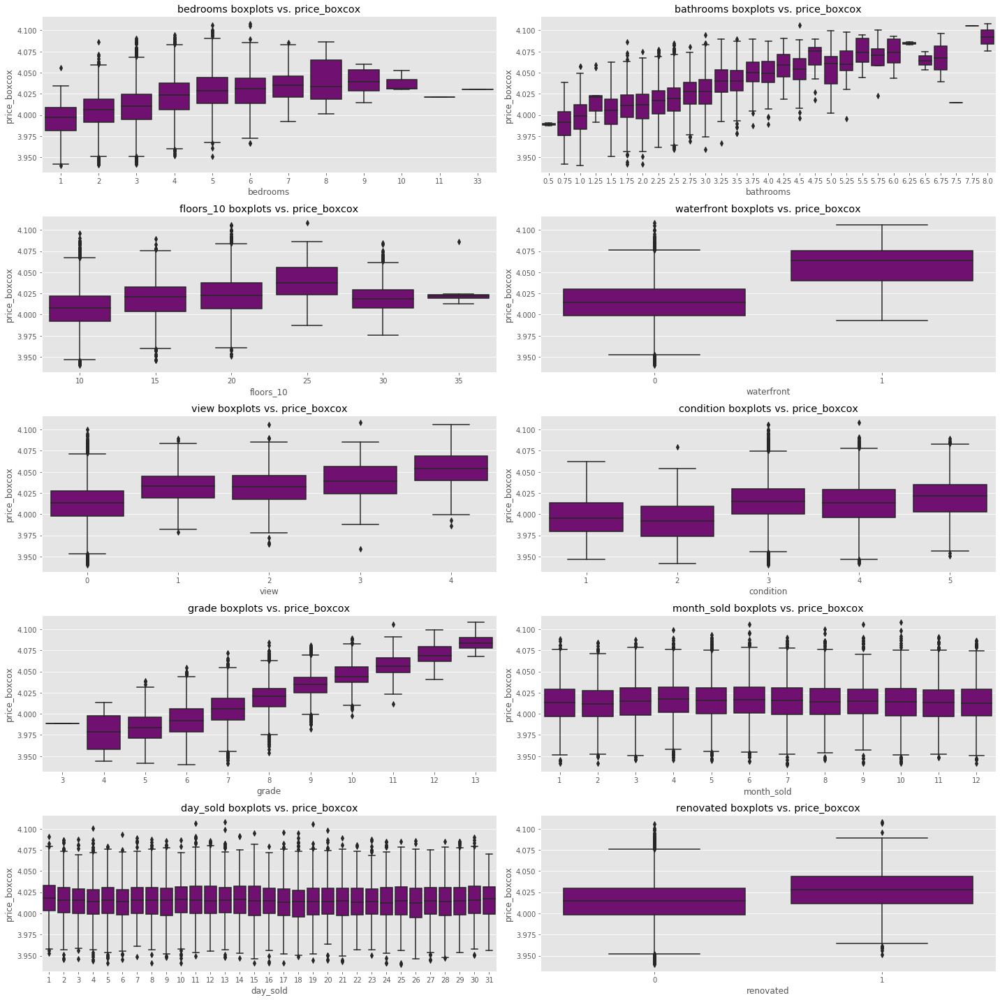

In [120]:
# plot boxplots of all cat columns vs. log_price
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
for ax, feature in zip(axes.flatten(), cat_predictors):
    sns.boxplot(x=feature, y='price_boxcox', data=preprocessed_2, ax=ax, color='purple');
    ax.set_title(f'{feature} boxplots vs. price_boxcox')
    
plt.tight_layout()

In [121]:
# identify ordinal
ordinal_cat_cols = ['bedrooms', 'bathrooms', 'grade']
ordinal_predictors = preprocessed_2[ordinal_cat_cols]

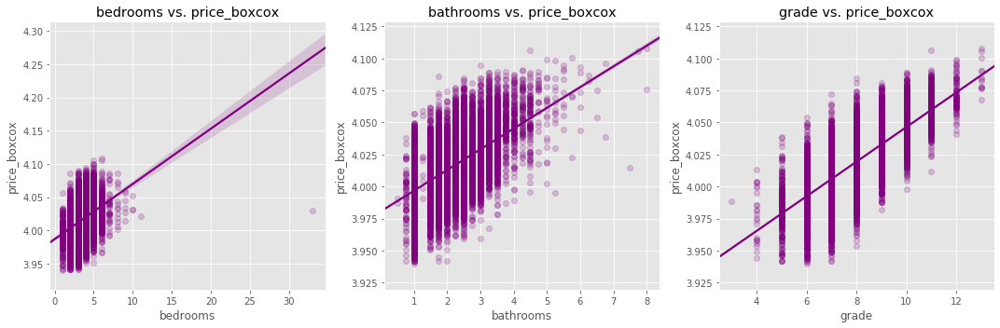

In [122]:
# see if we can improve distributions of ordinal cat cols as they are similar to 
# numerical cols
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=ordinal_predictors,
         nrows=1,
         ncols=3,
         figsize=(15, 5))

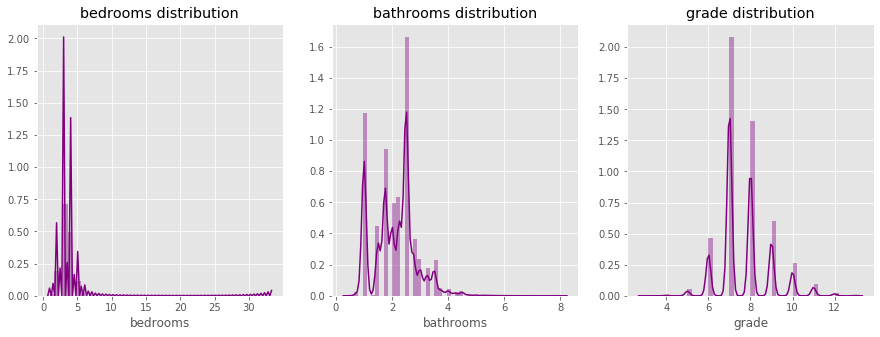

In [123]:
# look at distributions too
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
for ax, feature in zip(axes.flatten(), ordinal_predictors):
    sns.distplot(preprocessed_2[feature], ax=ax, color='purple');
    ax.set_title(f'{feature} distribution')

There appears to be a clear outlier on bedrooms, with only one entry with a bedroom value of more than 30.  Drop this outlier and replot to see how this changes things.

In [124]:
# how many outliers
preprocessed_2.loc[preprocessed_2['bedrooms'] > 30]['price_boxcox'].count()

1

In [125]:
# only 1, remove this
preprocessed_2 = preprocessed_2.loc[preprocessed_2['bedrooms'] <= 30]

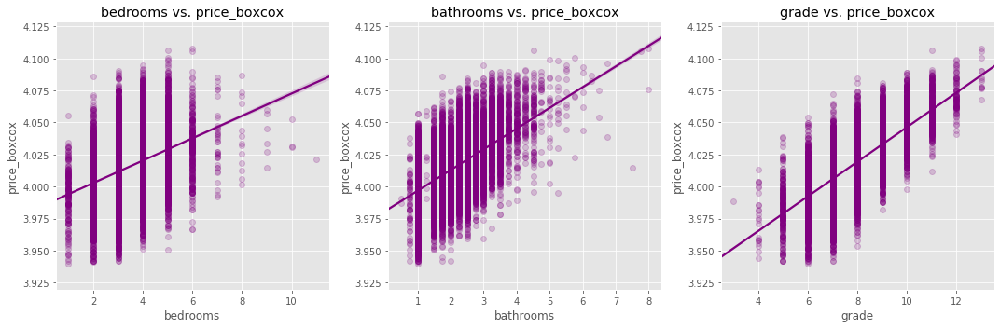

In [126]:
# replot vs. price
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=ordinal_predictors,
         nrows=1,
         ncols=3,
         figsize=(15, 5))

Relationships are looking more linear with some outlier cleanup.  There are still a number of apparent outliers, specifically on the upper end of bedroms and bathrooms. 

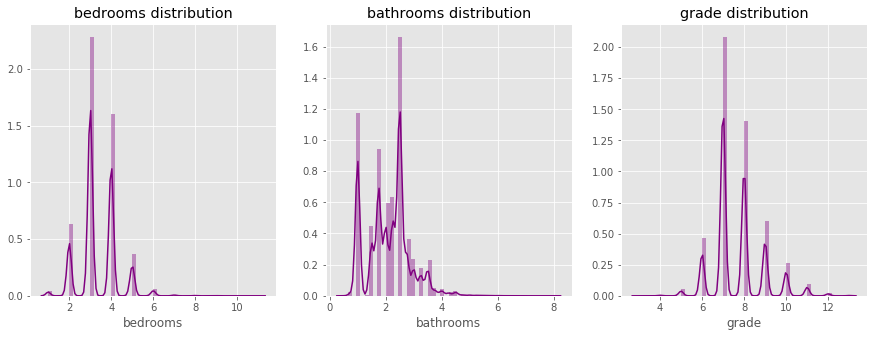

In [127]:
# look at distributions too
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
for ax, feature in zip(axes.flatten(), ordinal_predictors):
    sns.distplot(preprocessed_2[feature], ax=ax, color='purple');
    ax.set_title(f'{feature} distribution')

In [128]:
# how many have more than 6 bedrooms?
preprocessed_2.loc[preprocessed_2['bedrooms'] > 6]['price_boxcox'].count()

59

There are only 59 entries that have more than 6 bedrooms.  Given this is such a small number and it appears to be skewing our results, remove these.

In [129]:
# drop outliers
preprocessed_2 = preprocessed_2.loc[preprocessed_2['bedrooms'] <= 6]

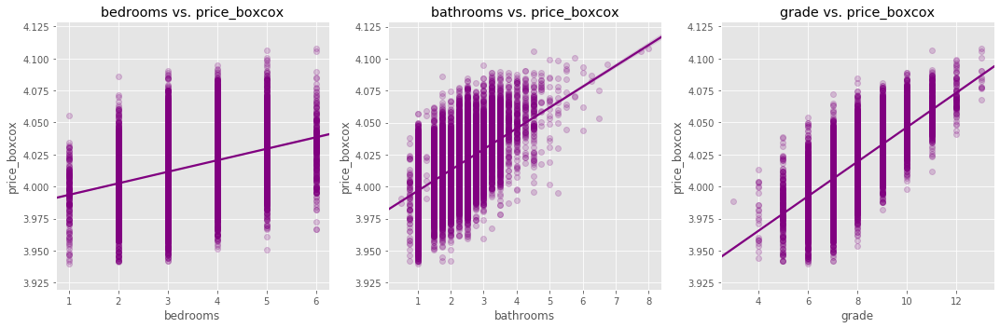

In [130]:
# replot
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=ordinal_predictors,
         nrows=1,
         ncols=3,
         figsize=(15, 5))

In [131]:
# how many have less than 1 bedroom?
preprocessed_2.loc[preprocessed_2['bathrooms'] < 1]['price_boxcox'].count()

70

Given there is such a small number with less than 1 bedroom, drop these results as they look like they could be skewing our relationship.

In [132]:
# drop outliers
preprocessed_2 = preprocessed_2.loc[preprocessed_2['bathrooms'] >=1]

In [133]:
# how many have more than 4.5 bathrooms?
preprocessed_2.loc[preprocessed_2['bathrooms'] > 4.5]['price_boxcox'].count()

73

In [134]:
# drop outliers
preprocessed_2 = preprocessed_2.loc[preprocessed_2['bathrooms'] < 4.5]

In [135]:
# remove 1.25 bathrooms, seems to be skewing things
to_drop = preprocessed_2.loc[preprocessed_2['bathrooms'] == 1.25].index
preprocessed_2 = preprocessed_2.drop(to_drop)

In [136]:
ordinal_cols = ['bedrooms', 'bathrooms', 'grade']
ordinal_predictors = preprocessed_2[ordinal_cols]

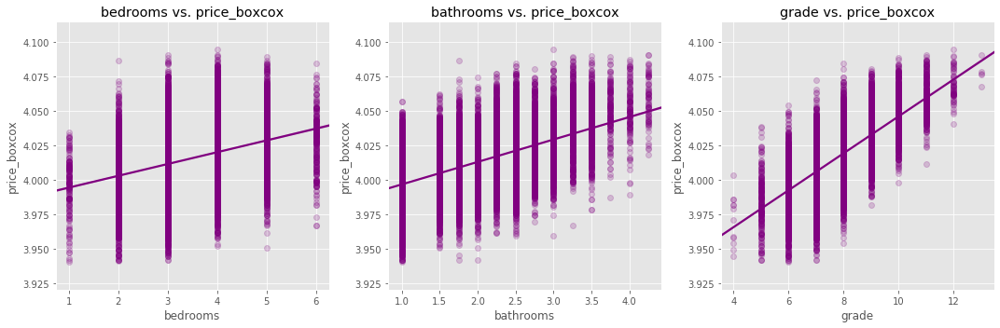

In [137]:
# replot vs. price
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=ordinal_predictors,
         nrows=1,
         ncols=3,
         figsize=(15, 5))

In [138]:
# things are looking pretty good - - outlier on grade - - the lowest ones?
index = preprocessed_2.loc[preprocessed_2['grade'] <= 4]
len(index)

12

In [139]:
# drop as this is an outlier
preprocessed_2 = preprocessed_2.loc[preprocessed_2['grade'] > 4]

In [140]:
# drop grades of 11 or higher
preprocessed_2 = preprocessed_2.loc[preprocessed_2['grade'] <= 11]

In [141]:
# looks l ike there is an outlier on 1.75 bathrooms
# drop 1.75 bathrooms where price is lower than 3.95 and greater than 4.075
index = preprocessed_2.loc[(preprocessed_2['price_boxcox'] < 3.95)
                          & (preprocessed_2['bathrooms'] > 1.5)].index

preprocessed_2 = preprocessed_2.drop(index)

In [142]:
# drop additional outliers
index = preprocessed_2.loc[(preprocessed_2['price_boxcox'] > 4.075)
                          & (preprocessed_2['bathrooms'] < 2)].index

preprocessed_2 = preprocessed_2.drop(index)

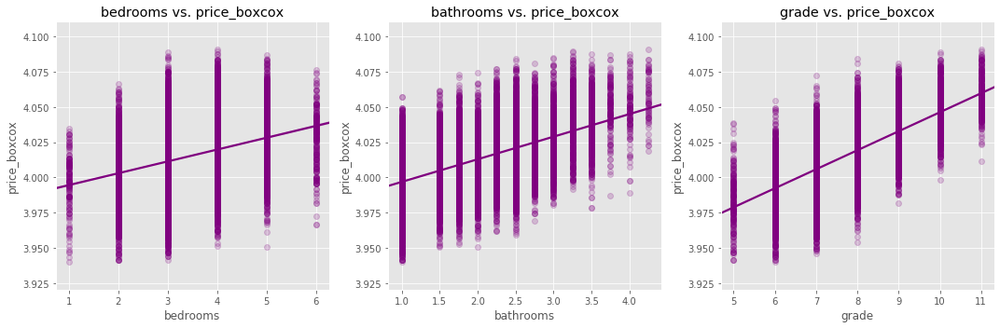

In [143]:
# last outlier cleanup
index = preprocessed_2.loc[(preprocessed_2['bathrooms'] >= 3)
                          & (preprocessed_2['price_boxcox'] < 3.975)].index

preprocessed_2 = preprocessed_2.drop(index)

# replot vs. price
plot_viz(data=preprocessed_2,
         target='price_boxcox',
         predictors=ordinal_predictors,
         nrows=1,
         ncols=3,
         figsize=(15, 5))

In [144]:
preprocessed_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20628 entries, 0 to 21595
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       20628 non-null  int64  
 1   bathrooms      20628 non-null  float64
 2   waterfront     20628 non-null  int64  
 3   view           20628 non-null  int64  
 4   condition      20628 non-null  int64  
 5   grade          20628 non-null  int64  
 6   month_sold     20628 non-null  int64  
 7   day_sold       20628 non-null  int64  
 8   price_boxcox   20628 non-null  float64
 9   renovated      20628 non-null  int64  
 10  floors_10      20628 non-null  int64  
 11  basement       20628 non-null  int64  
 12  t_sqft_liv_15  20628 non-null  float64
dtypes: float64(3), int64(10)
memory usage: 2.2 MB


Ordinal categorical columns are looking good - - looking like they fulfill linearity requirements and minimal outliers remain.

Get the list of variables to one-hot encode.  Create dummy variables. 

In [145]:
#ohe_list
ohe_list = ohe_list + ['floors_10', 'waterfront', 'view', 'condition', 'month_sold', 'day_sold', 'renovated']

In [146]:
ohe_list

['basement',
 'floors_10',
 'waterfront',
 'view',
 'condition',
 'month_sold',
 'day_sold',
 'renovated']

In [147]:
# create dummy variables
basement_dummies = pd.get_dummies(preprocessed_2['basement'], prefix='basement', drop_first=True)
floors_dummies = pd.get_dummies(preprocessed_2['floors_10'], prefix='floors', drop_first=True)
water_dummies = pd.get_dummies(preprocessed_2['waterfront'], prefix='water', drop_first=True)
view_dummies = pd.get_dummies(preprocessed_2['view'], prefix='view', drop_first=True)
condition_dummies = pd.get_dummies(preprocessed_2['condition'], prefix='condition', drop_first=True)
month_dummies = pd.get_dummies(preprocessed_2['month_sold'], prefix='month', drop_first=True)
day_dummies = pd.get_dummies(preprocessed_2['day_sold'], prefix='day', drop_first=True)
reno_dummies = pd.get_dummies(preprocessed_2['renovated'], prefix='reno', drop_first=True)

In [148]:
# drop columns
data_fin_2 = preprocessed_2.drop(ohe_list, axis=1)

In [149]:
data_fin_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20628 entries, 0 to 21595
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   bedrooms       20628 non-null  int64  
 1   bathrooms      20628 non-null  float64
 2   grade          20628 non-null  int64  
 3   price_boxcox   20628 non-null  float64
 4   t_sqft_liv_15  20628 non-null  float64
dtypes: float64(3), int64(2)
memory usage: 966.9 KB


In [150]:
# concat dummy variables with remaining columns
data_fin_2 = pd.concat([data_fin_2,
                        basement_dummies,
                        floors_dummies,
                        water_dummies,
                        view_dummies,
                        condition_dummies,
                        month_dummies,
                        day_dummies,
                        reno_dummies], axis=1)

Now that preprocessing is finished on all predictor variables, run stepwise feature selection.

In [151]:
# run stepwise selection to select features
y = data_fin_2['price_boxcox']
X = data_fin_2.drop('price_boxcox', axis=1)
result = stepwise_selection(X, y, verbose=True)

Add  floors_20                      with p-value 0.0
Add  bathrooms                      with p-value 0.0
Drop floors_20                      with p-value 0.812898
Add  t_sqft_liv_15                  with p-value 0.0
Add  grade                          with p-value 0.0
Add  basement_1                     with p-value 1.67176e-243
Add  floors_15                      with p-value 2.55956e-176
Add  condition_5                    with p-value 5.4075e-81
Add  reno_1                         with p-value 3.8687e-72
Add  view_4                         with p-value 7.77366e-57
Add  condition_4                    with p-value 5.91696e-32
Add  floors_30                      with p-value 6.21583e-30
Add  view_2                         with p-value 1.35448e-19
Add  view_3                         with p-value 1.84378e-17
Add  view_1                         with p-value 1.09811e-18
Add  month_4                        with p-value 1.28397e-17
Add  water_1                        with p-value 8.87495e-1

Going to try to select the first 5 variables

In [152]:
# run regression with these features
X = data_fin_2[result]
y = data_fin_2['price_boxcox']
predictors = sm.add_constant(X)
model = sm.OLS(y, predictors).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           price_boxcox   R-squared:                       0.567
Model:                            OLS   Adj. R-squared:                  0.566
Method:                 Least Squares   F-statistic:                     1284.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:09:40   Log-Likelihood:                 57764.
No. Observations:               20628   AIC:                        -1.155e+05
Df Residuals:                   20606   BIC:                        -1.153e+05
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.6026      0.009    396.526      0.000       3.585       3.620
bathrooms         0.0013      0.000      6.061      0.000       0.001       0.002
t_sqft_liv_15     0.0936      0.003     34.080      0.000       0.088       0.099
grade             0.0094      0.000     64.665      0.000       0.009       0.010
basement_1        0.0068      0.000     28.493      0.000       0.006       0.007
floors_15         0.0100      0.000     26.586      0.000       0.009       0.011
condition_5       0.0091      0.000     22.844      0.000       0.008       0.010
reno_1            0.0100      0.001     17.350      0.000       0.009       0.011
view_4            0.0108      0.001      9.835      0.000       0.009       0.013
condition_4       0.0033      0.000     13.081      0.000       0.003       0.004
floors_30         0.0088      0.001     12.941      0.000       0.008       0.010
view_2            0.0052      0.001     10.043      0.000       0.004       0.006
view_3            0.0062      0.001      8.755      0.000       0.005       0.008
view_1            0.0077      0.001      9.116      0.000       0.006       0.009
month_4           0.0031      0.000      9.212      0.000       0.002       0.004
water_1           0.0128      0.002      7.779      0.000       0.010       0.016
floors_25         0.0099      0.001      7.808      0.000       0.007       0.012
floors_20         0.0022      0.000      7.330      0.000       0.002       0.003
month_3           0.0022      0.000      5.933      0.000       0.001       0.003
condition_2      -0.0048      0.001     -4.030      0.000      -0.007      -0.002
month_5           0.0010      0.000      2.912      0.004       0.000       0.002
day_26           -0.0017      0.001     -2.908      0.004      -0.003      -0.001
==============================================================================
Omnibus:                       86.675   Durbin-Watson:                   1.975
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               87.696
Skew:                          -0.160   Prob(JB):                     9.06e-20
Kurtosis:                       3.006   Cond. No.                         817.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Model 4 Results

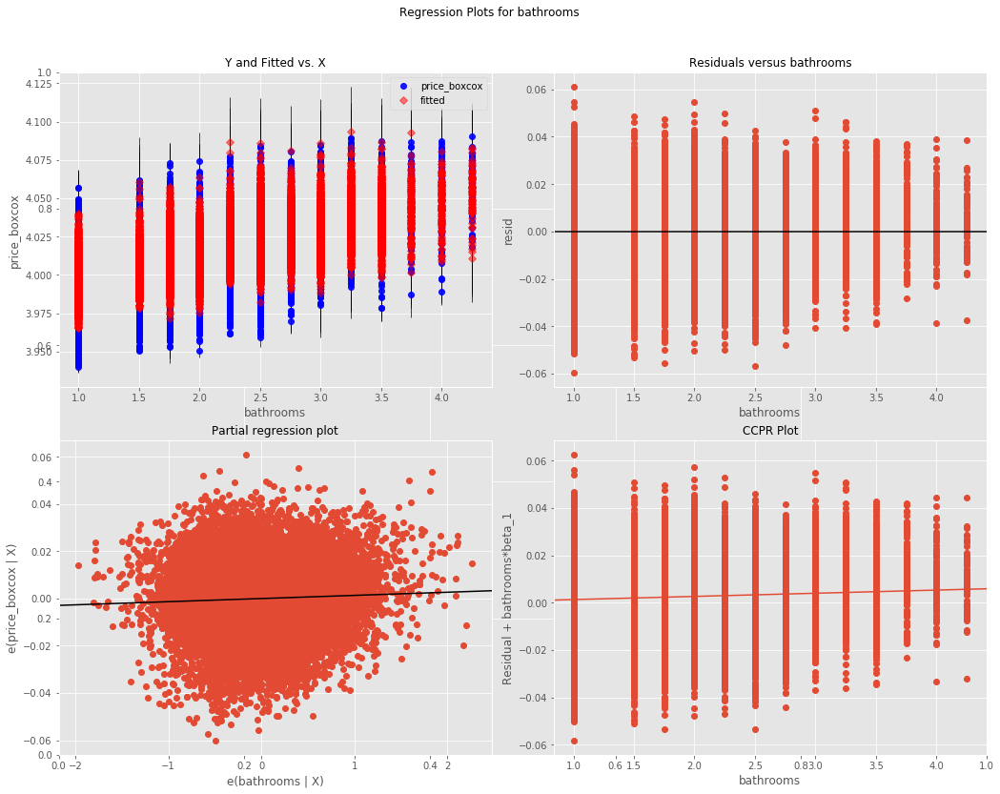

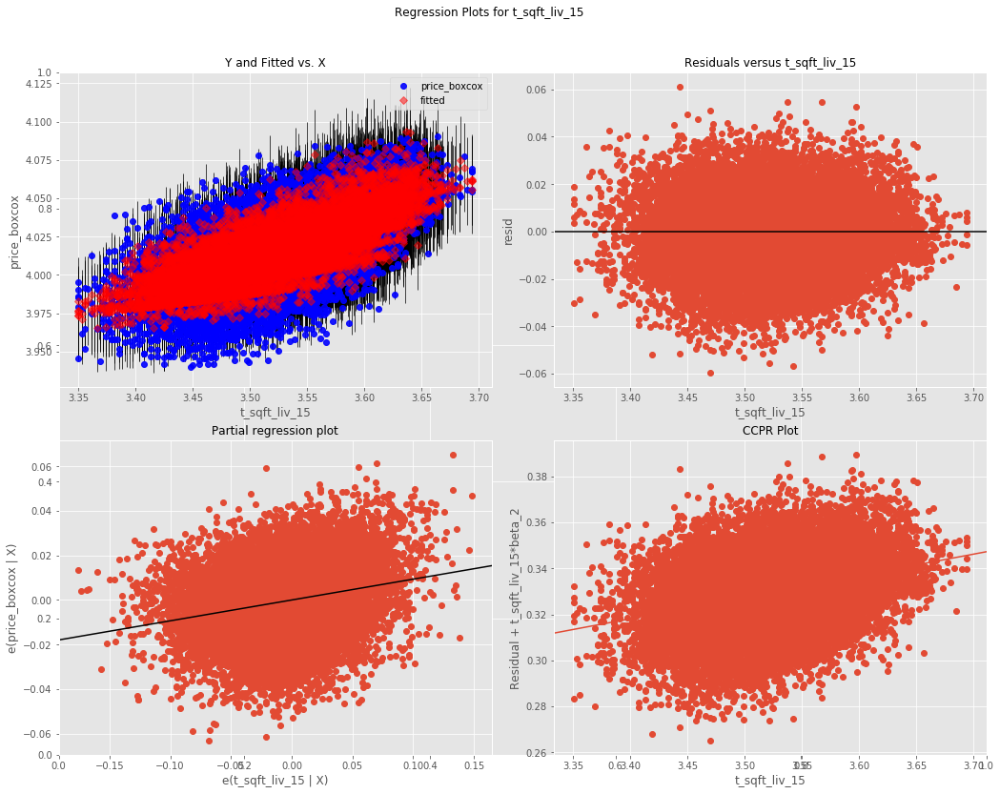

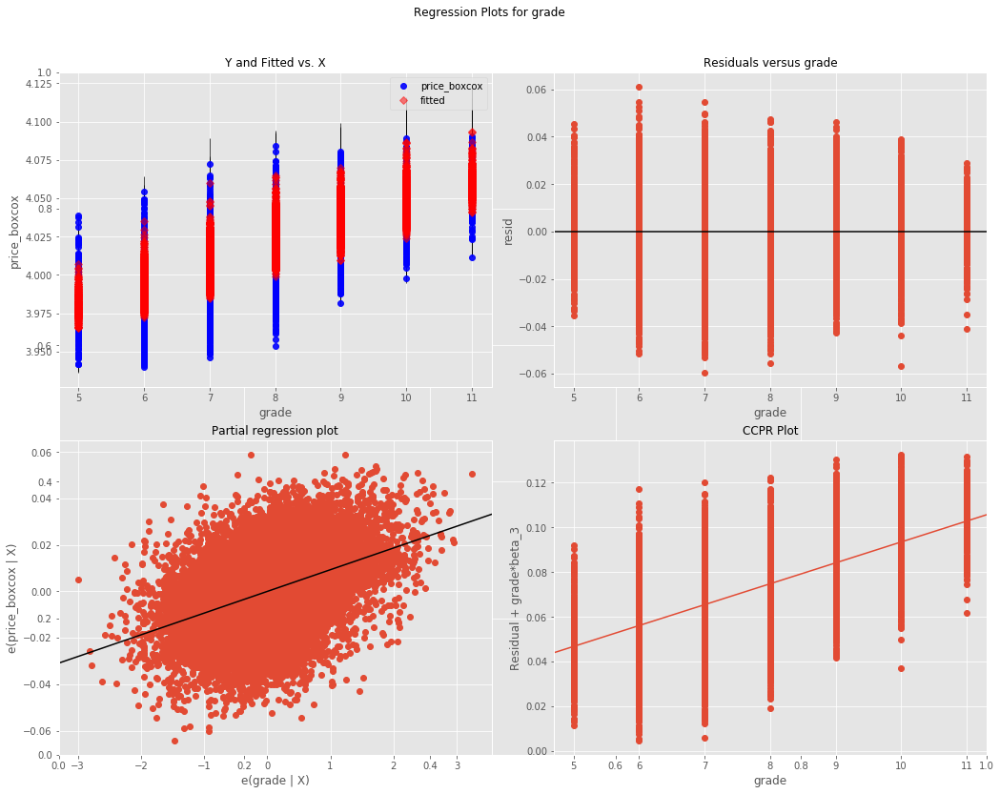

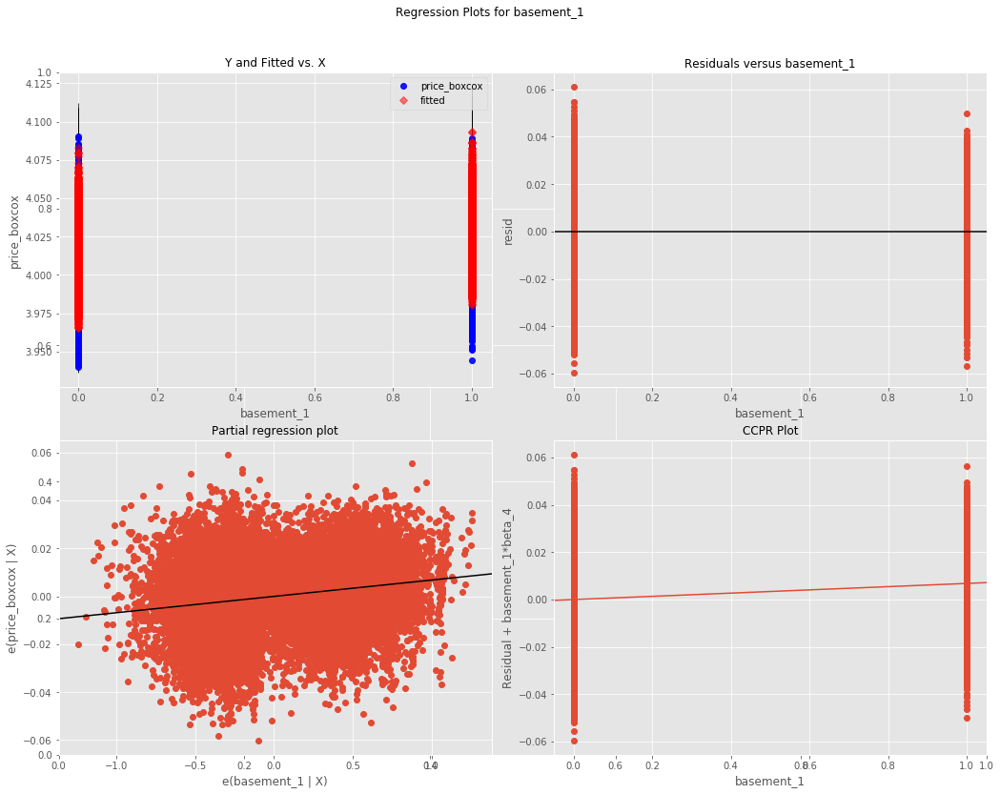

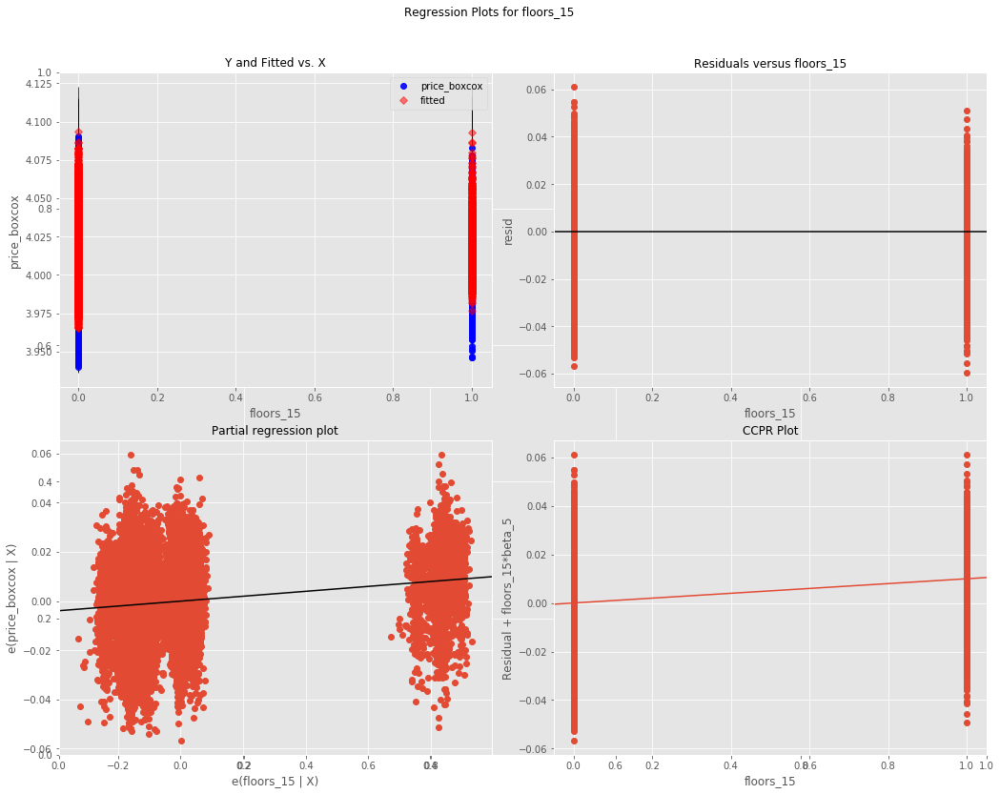

...

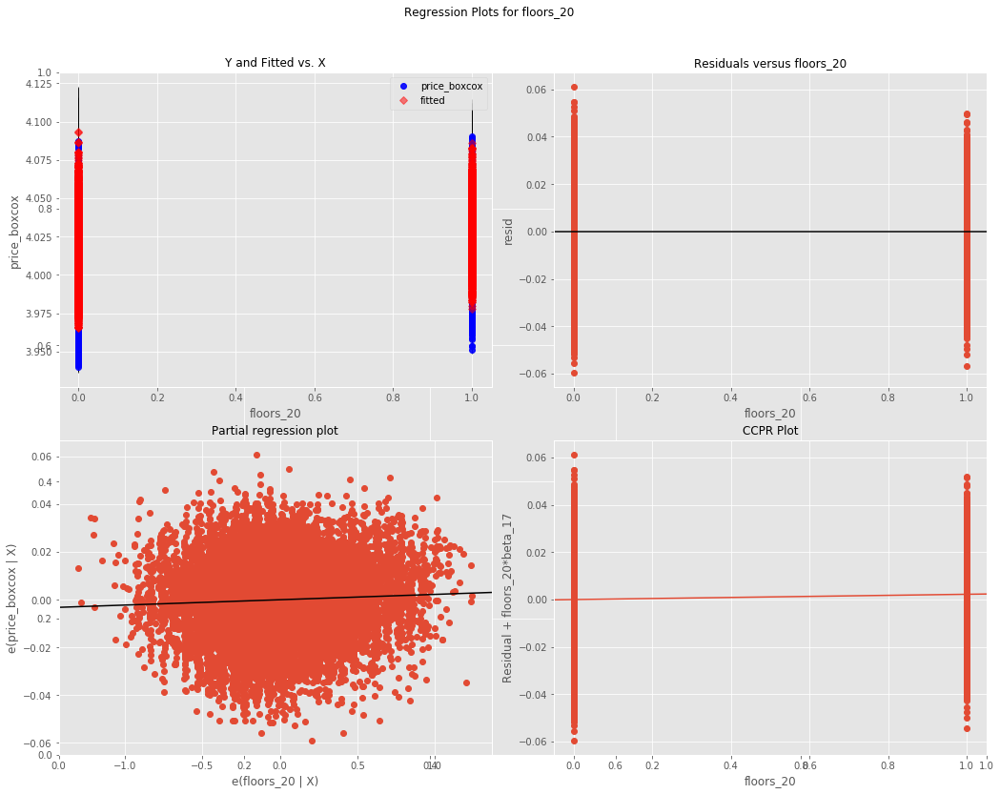

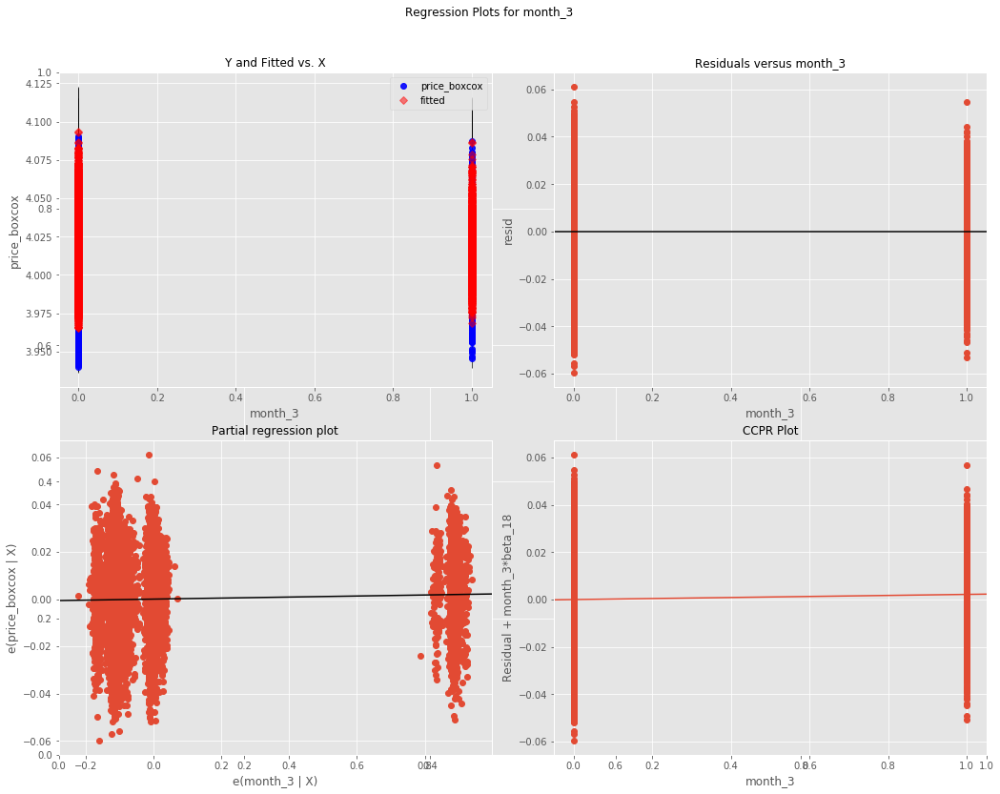

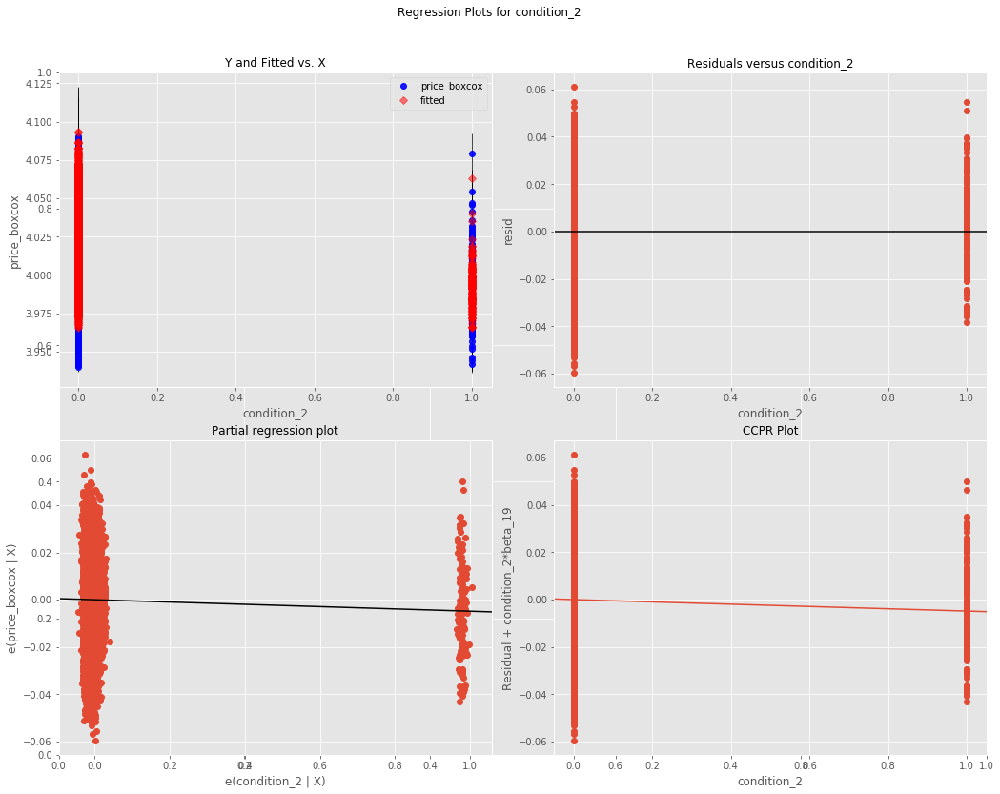

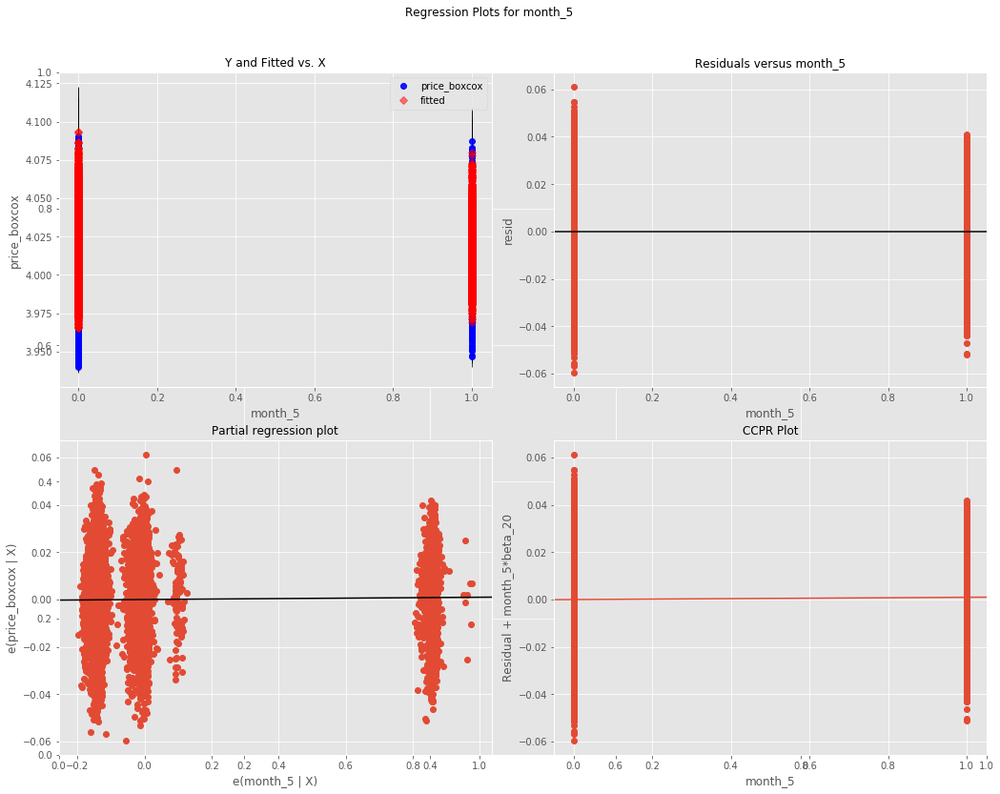

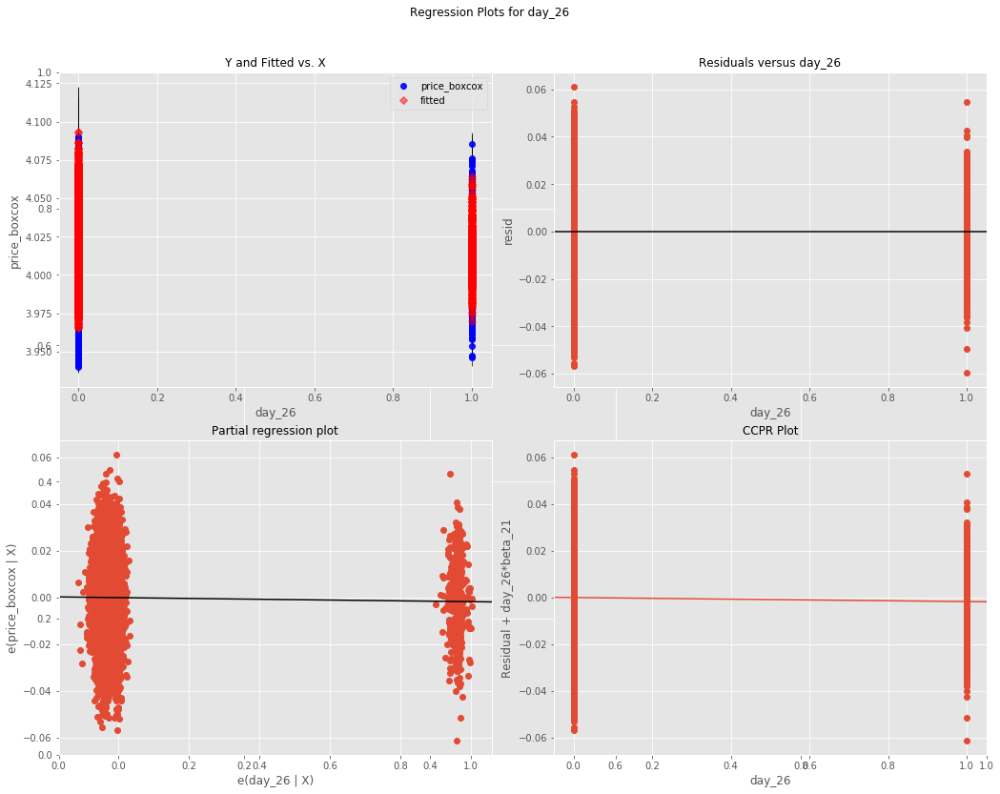

In [153]:
# evaluate residual plots
for col in X:
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, col, fig=fig)
    plt.show()

In [154]:
# Now run single variable regressions of each predictor

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~price_boxcox
-------------------------------------------------------------------------------------


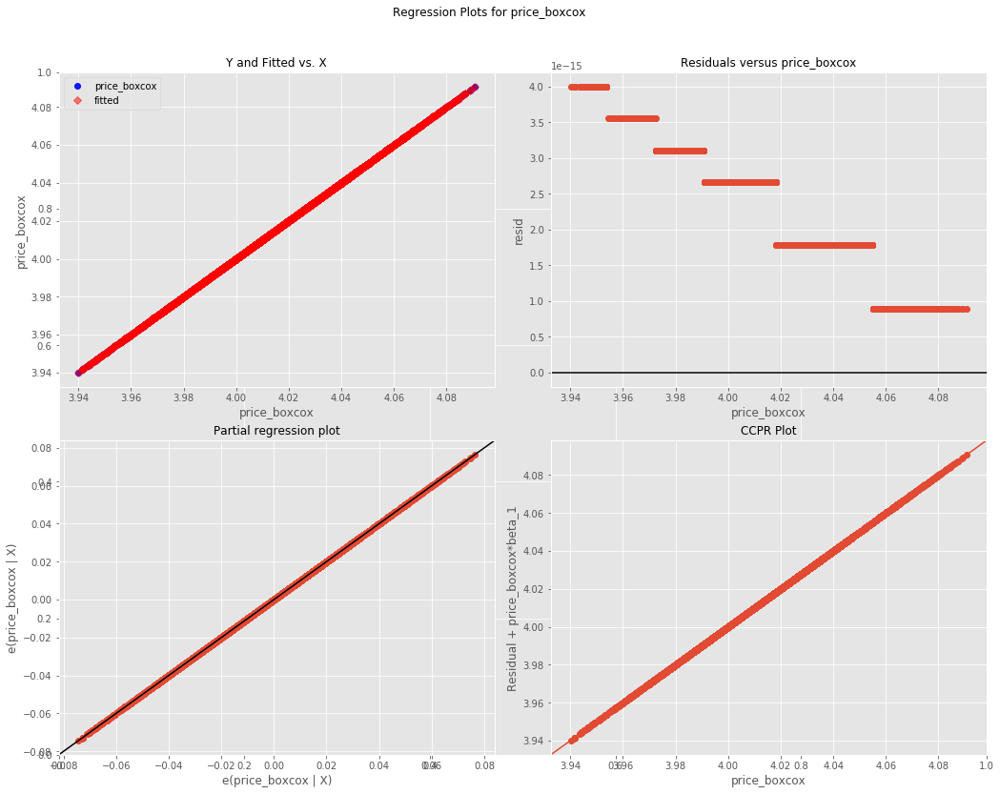

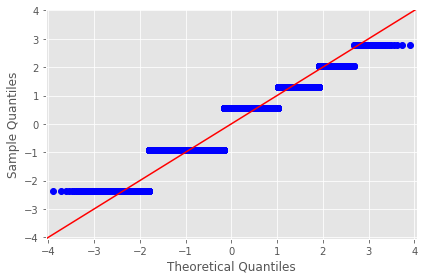

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~bathrooms
-------------------------------------------------------------------------------------


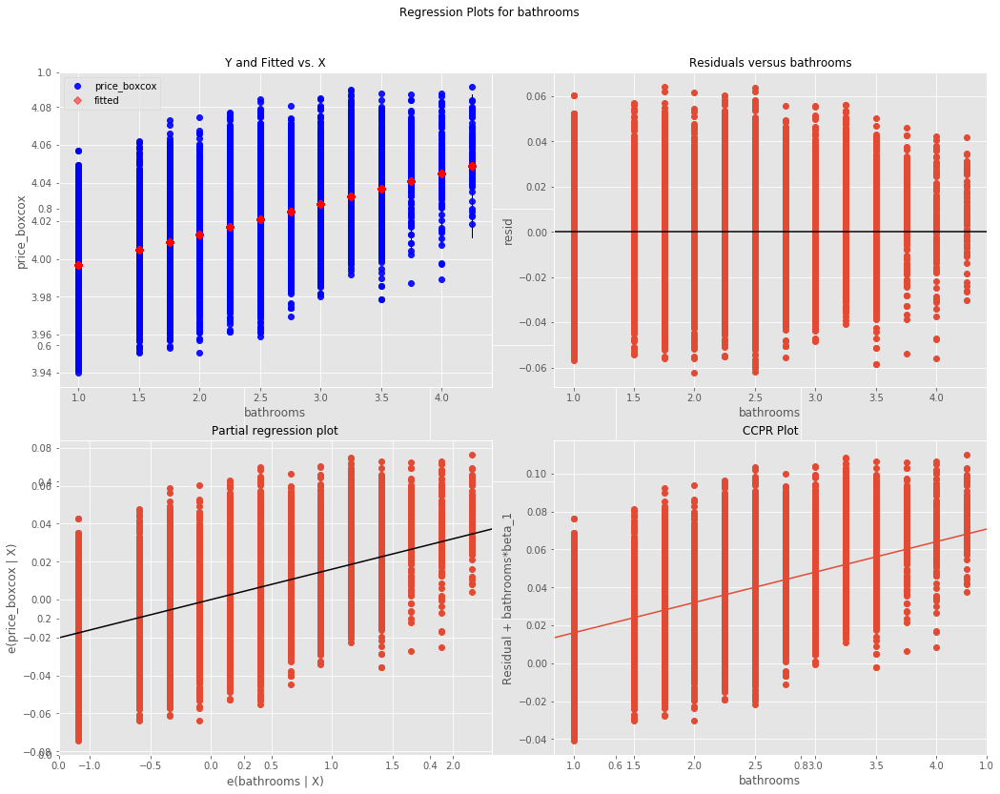

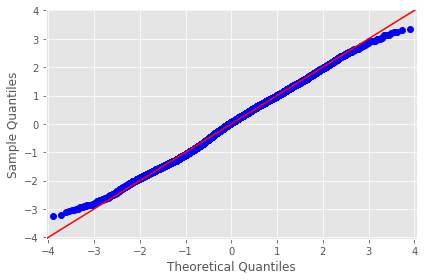

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~t_sqft_liv_15
-------------------------------------------------------------------------------------


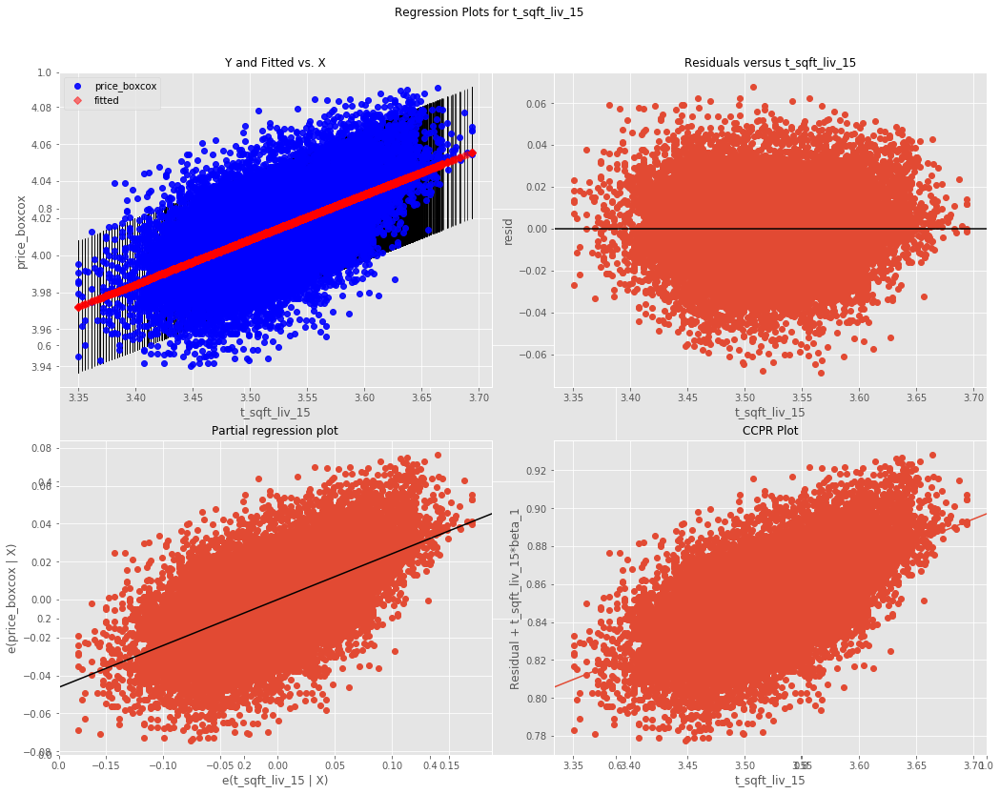

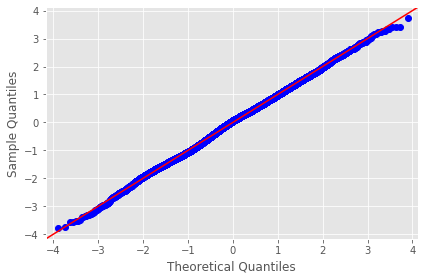

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~grade
-------------------------------------------------------------------------------------


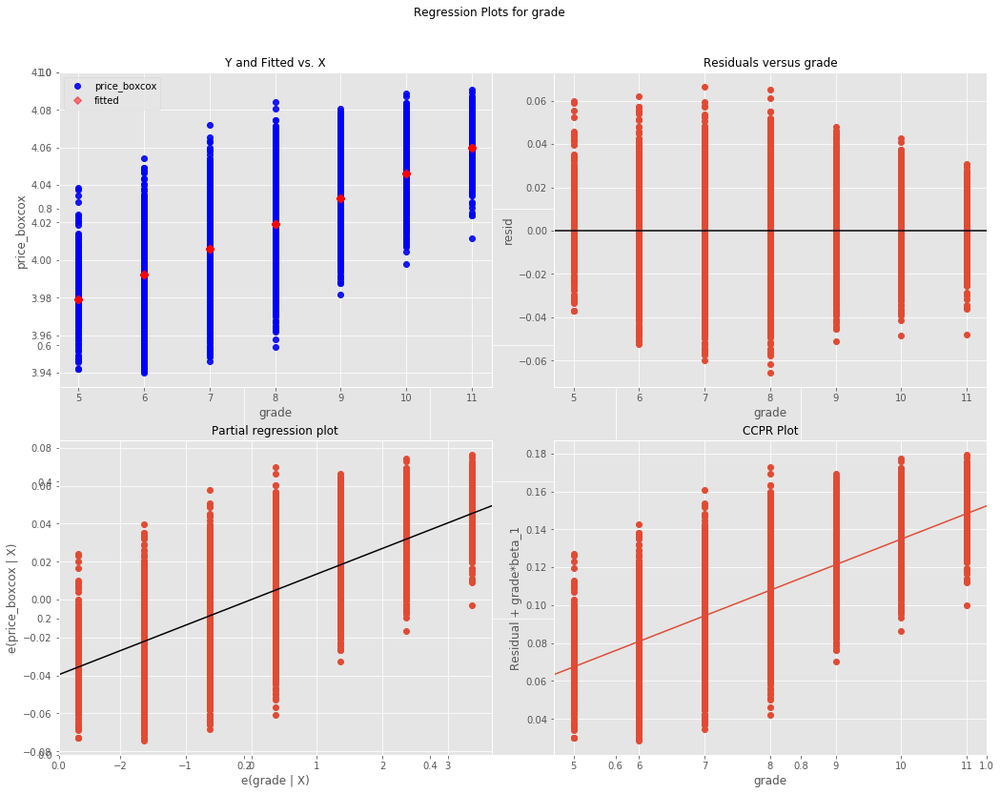

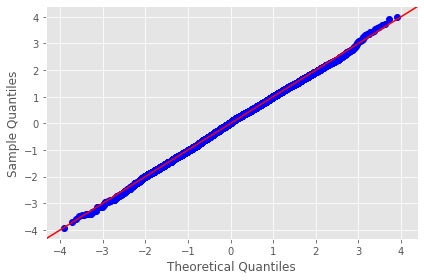

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~basement_1
-------------------------------------------------------------------------------------


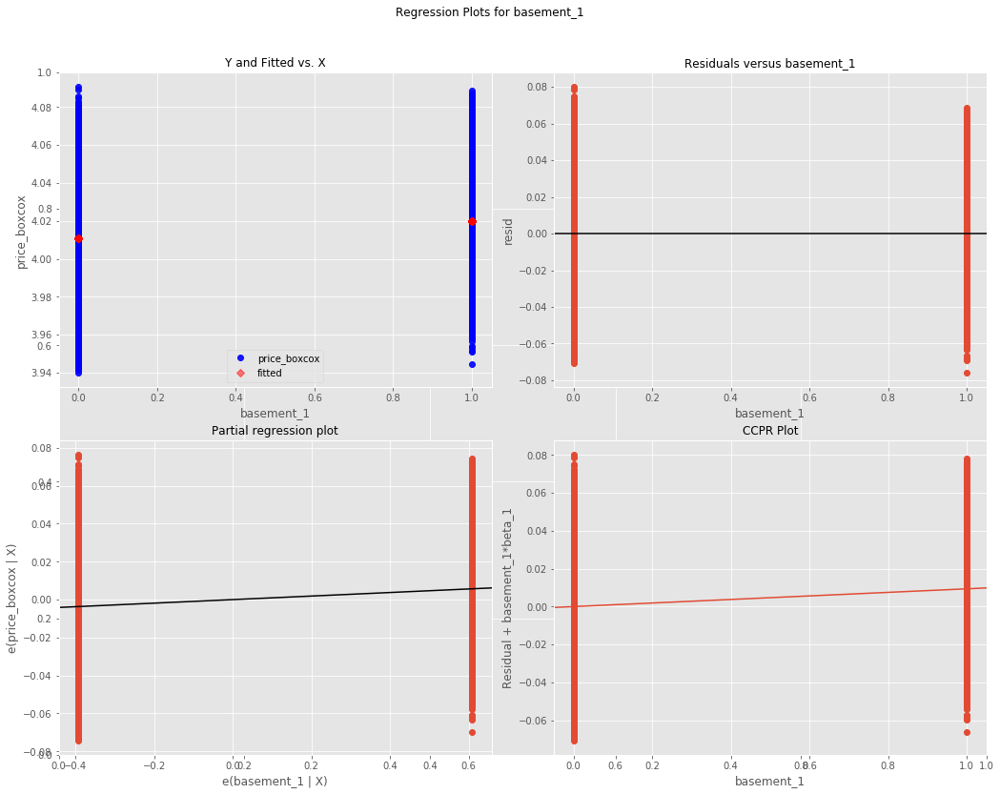

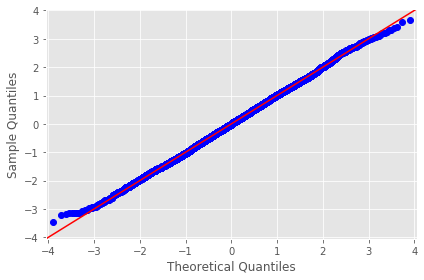

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_15
-------------------------------------------------------------------------------------


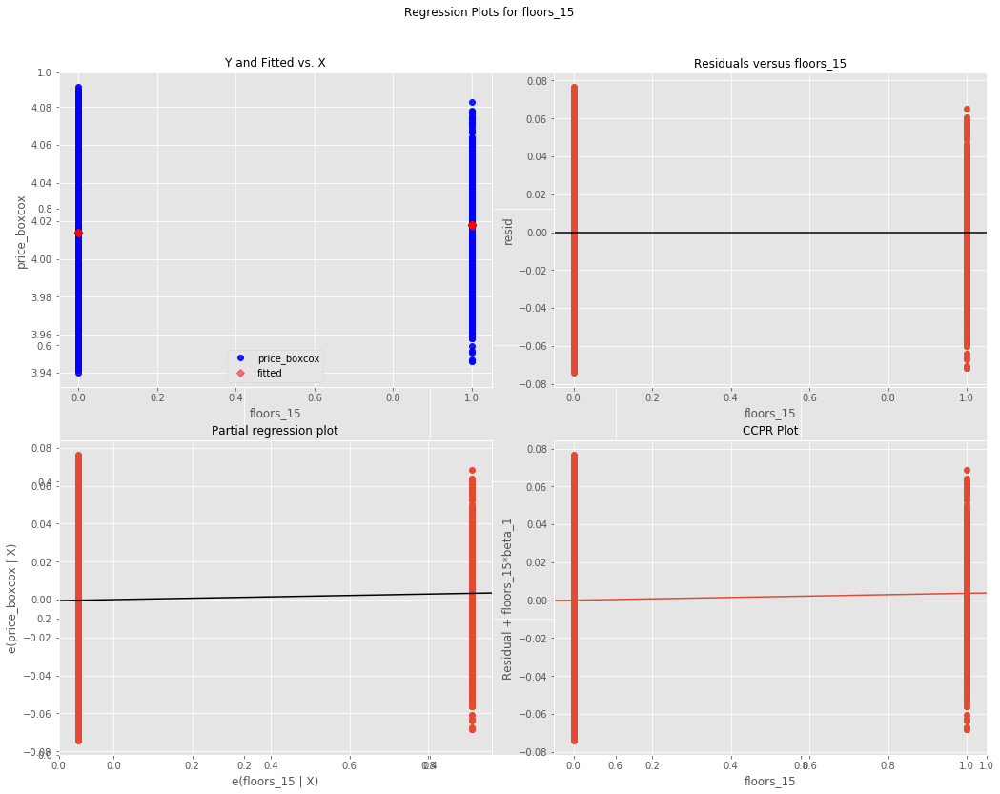

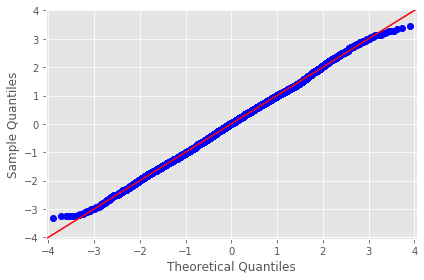

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_5
-------------------------------------------------------------------------------------


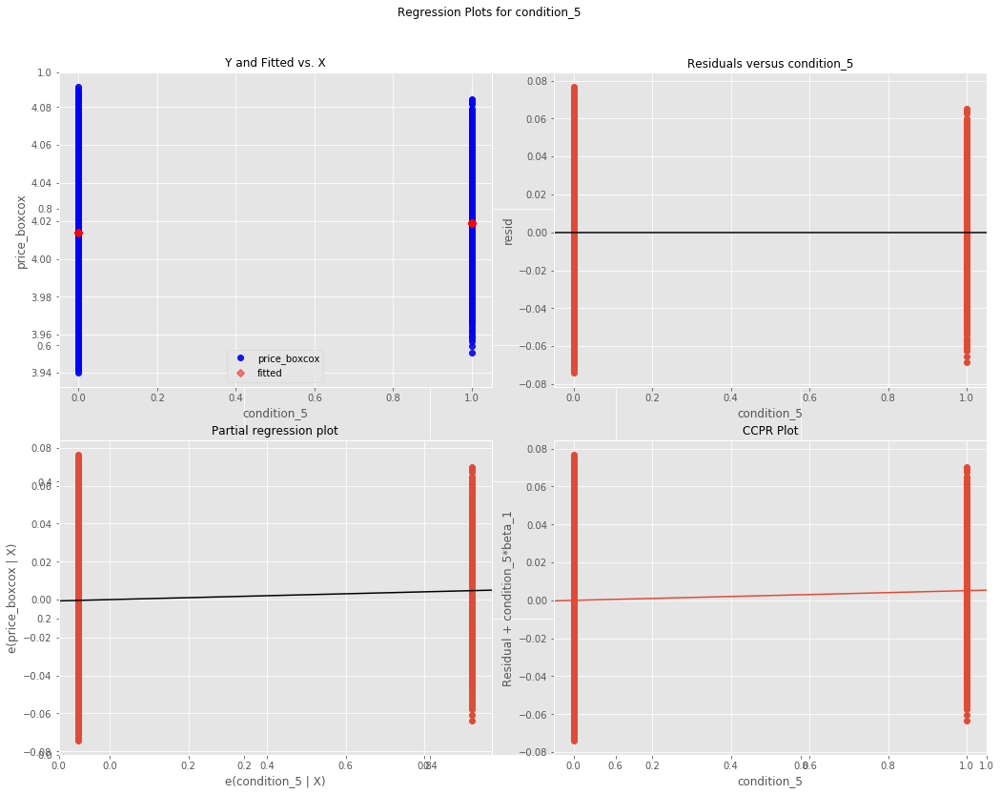

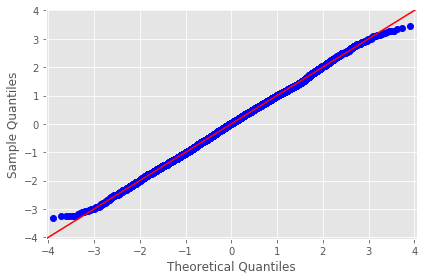

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~reno_1
-------------------------------------------------------------------------------------


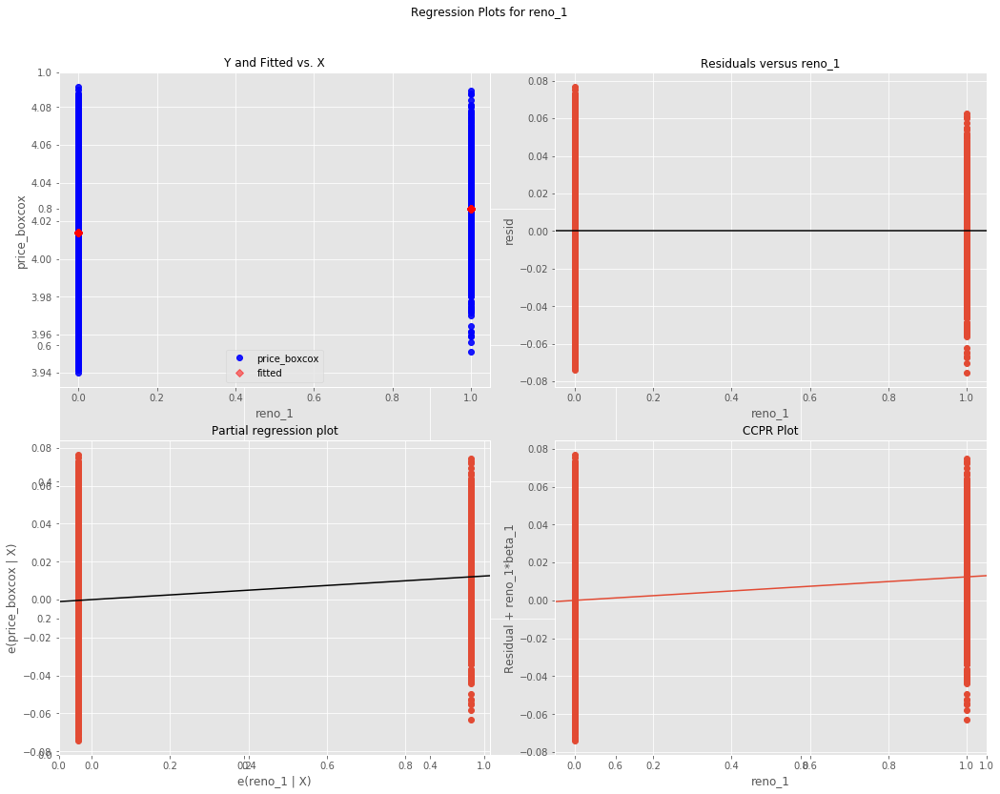

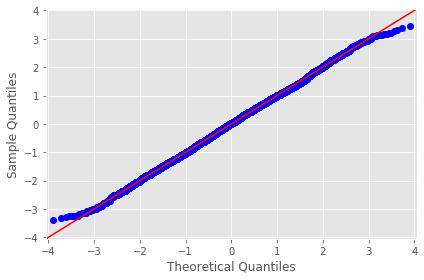

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_4
-------------------------------------------------------------------------------------


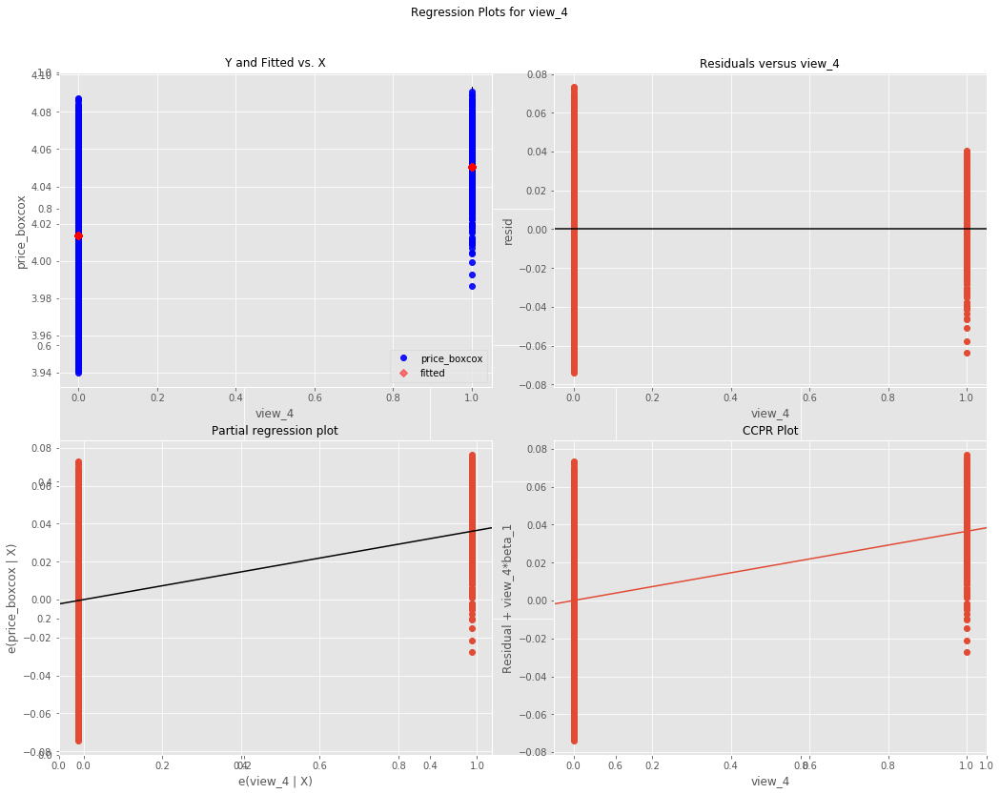

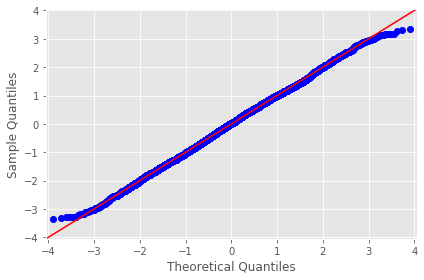

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_4
-------------------------------------------------------------------------------------


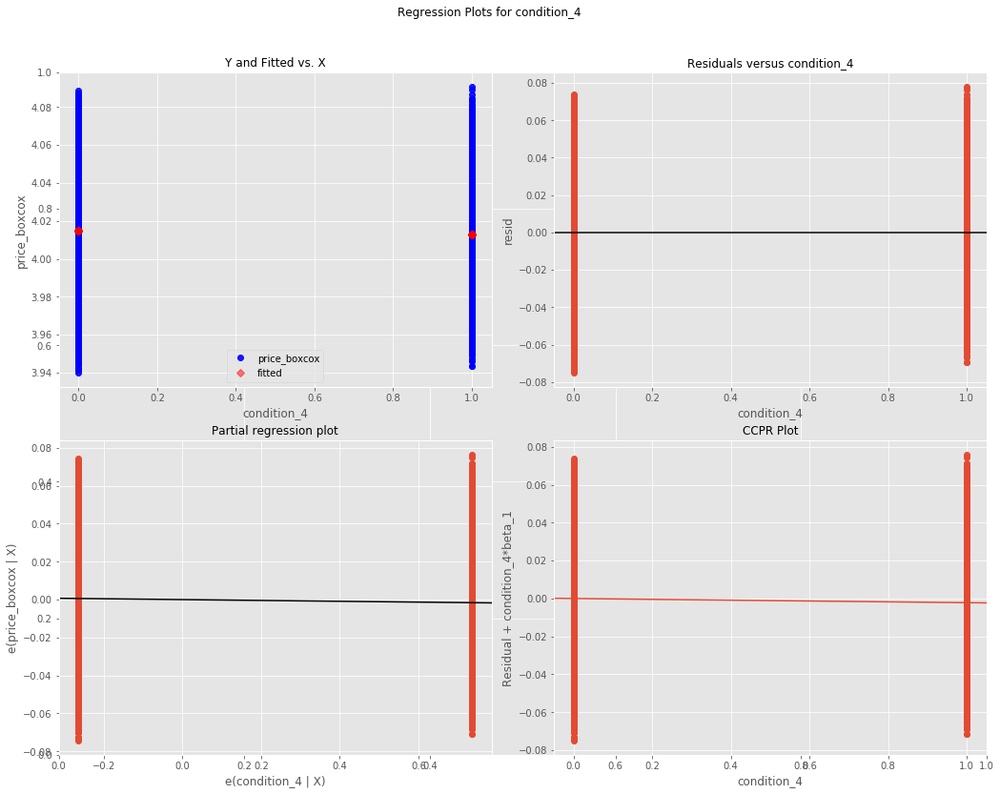

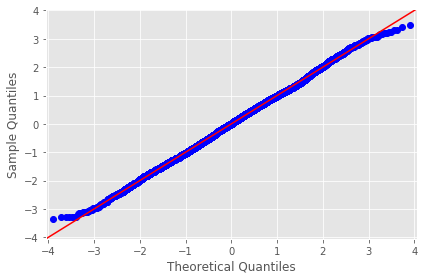

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_30
-------------------------------------------------------------------------------------


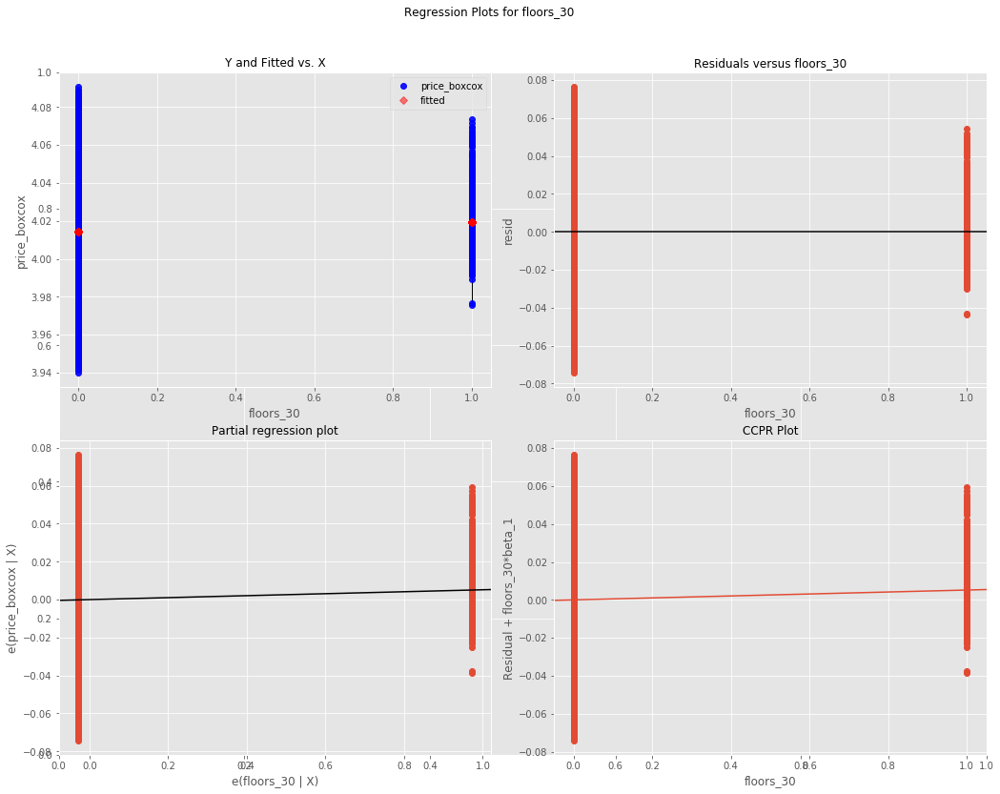

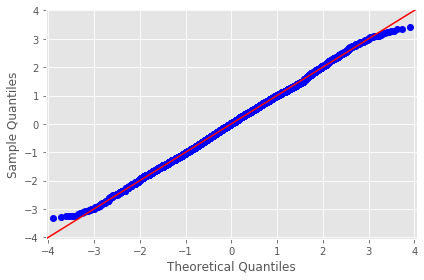

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_2
-------------------------------------------------------------------------------------


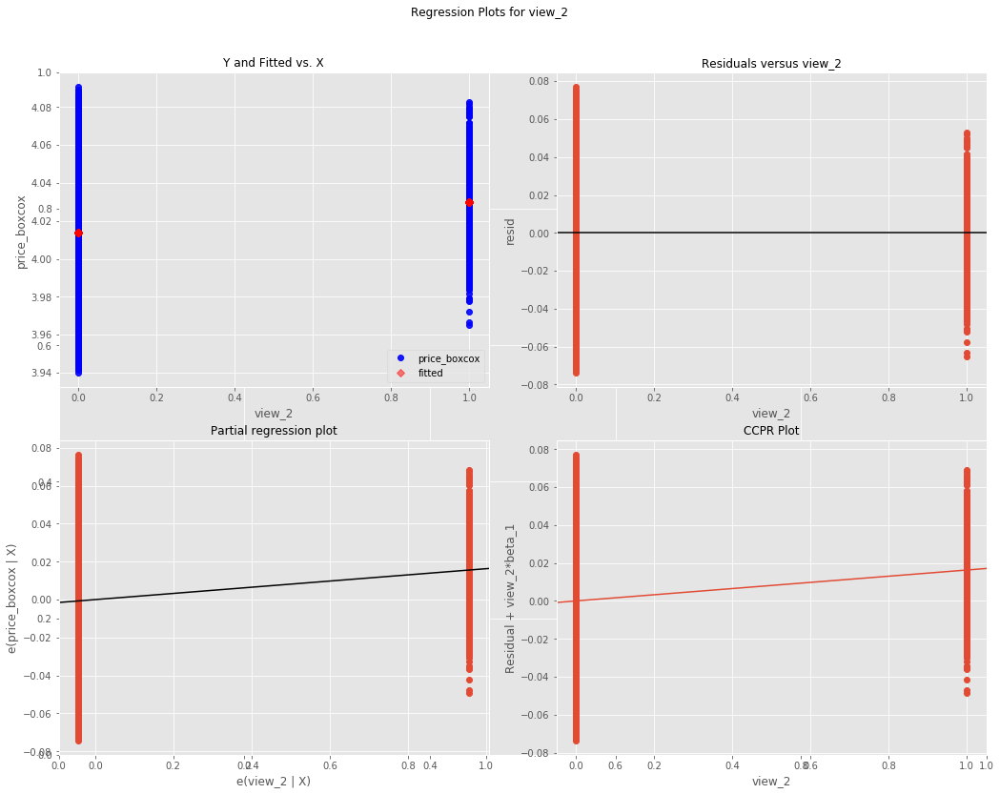

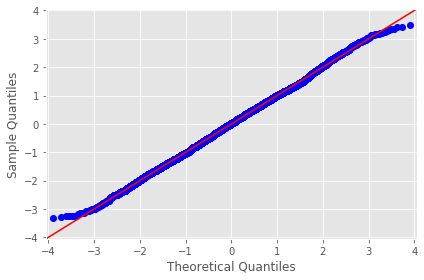

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_3
-------------------------------------------------------------------------------------


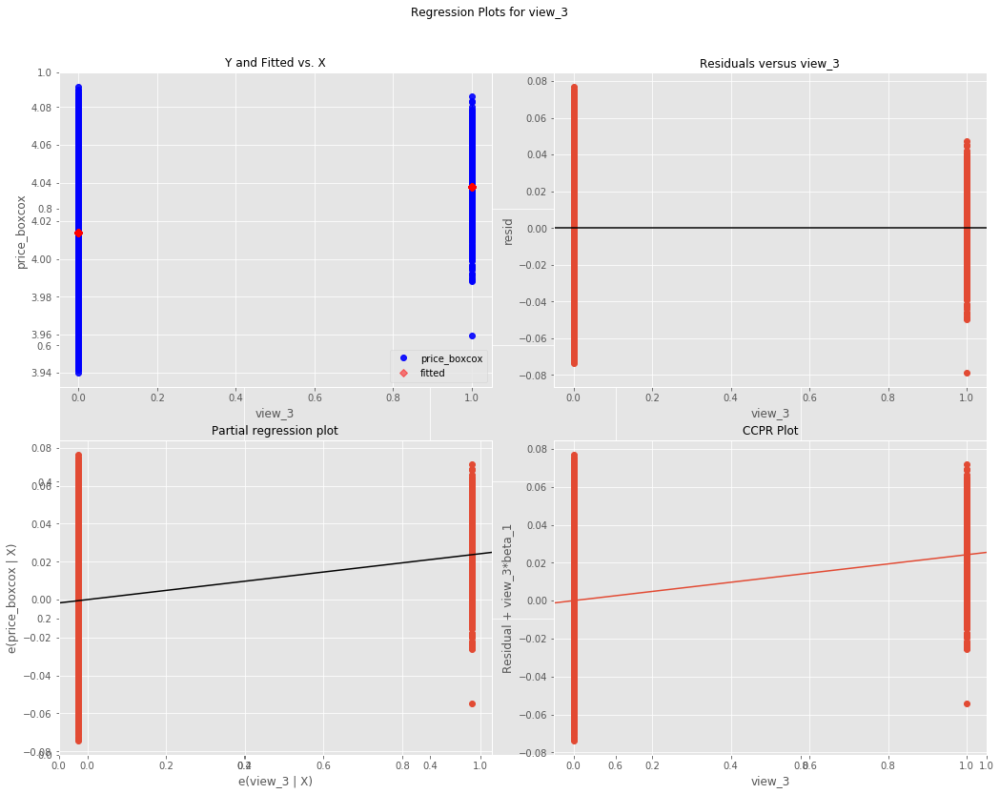

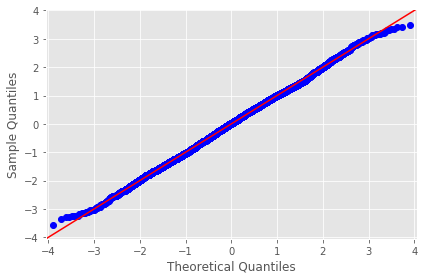

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~view_1
-------------------------------------------------------------------------------------


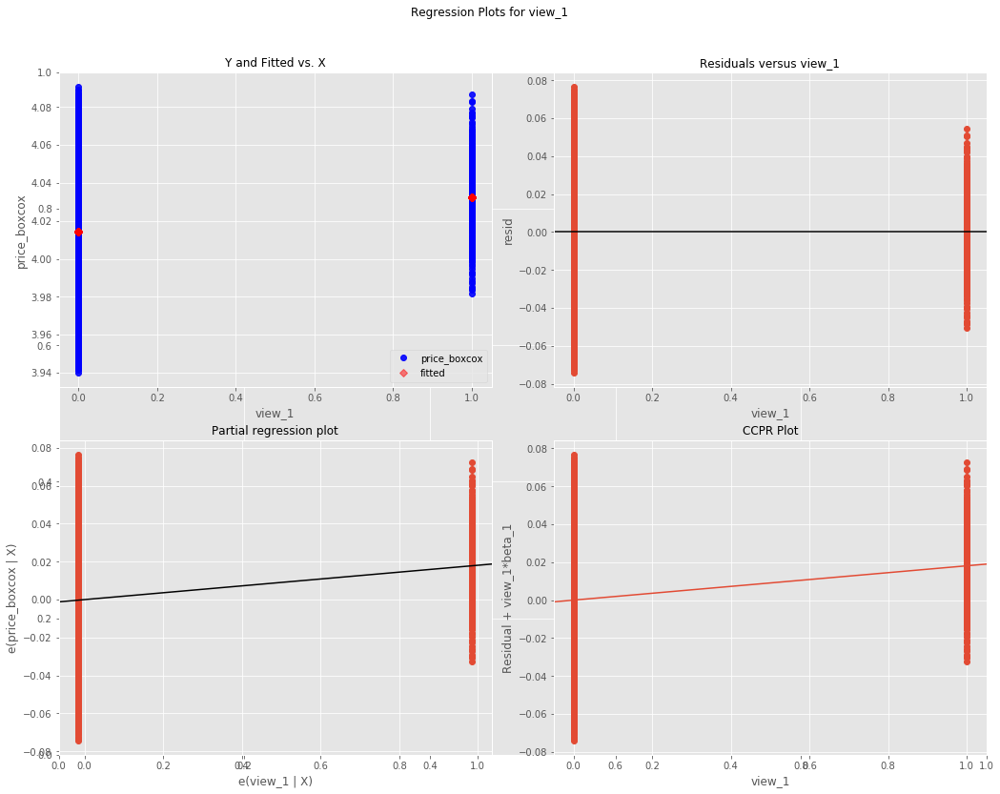

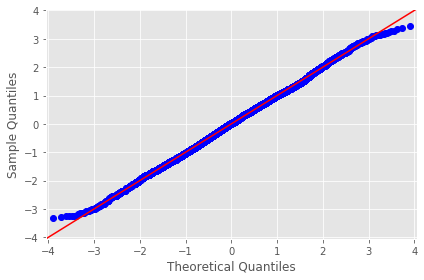

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_4
-------------------------------------------------------------------------------------


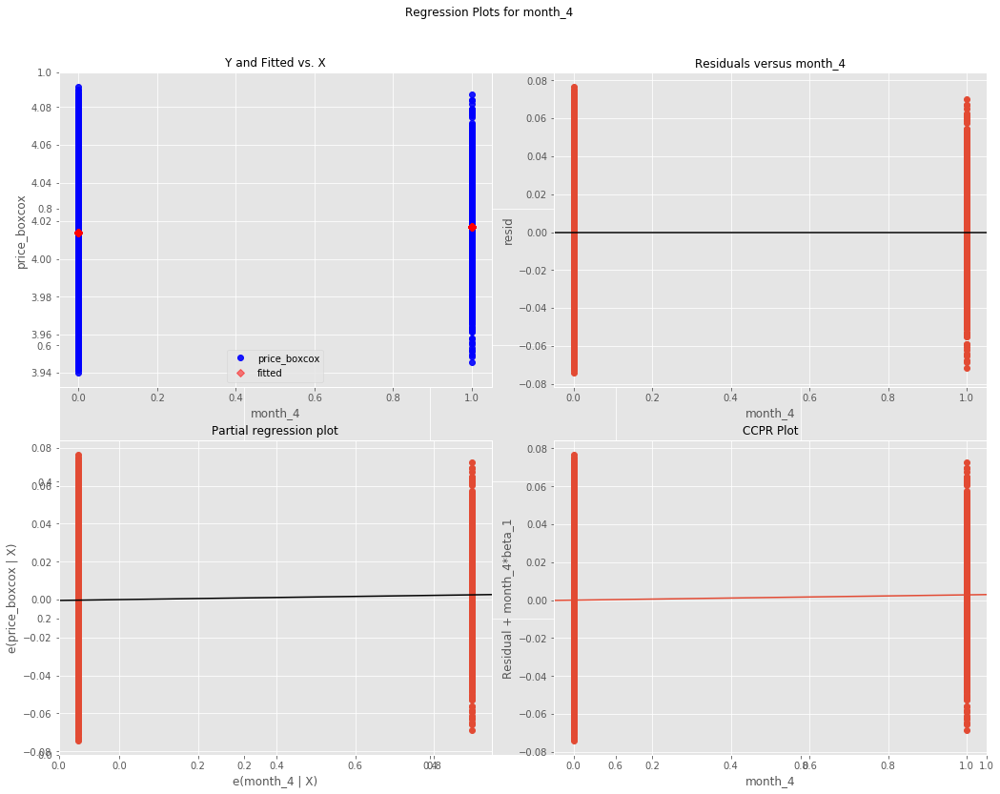

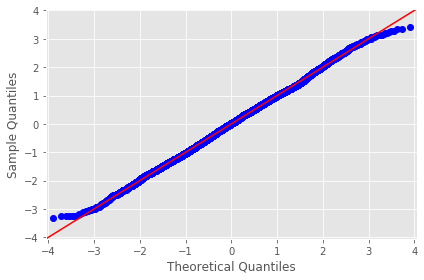

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~water_1
-------------------------------------------------------------------------------------


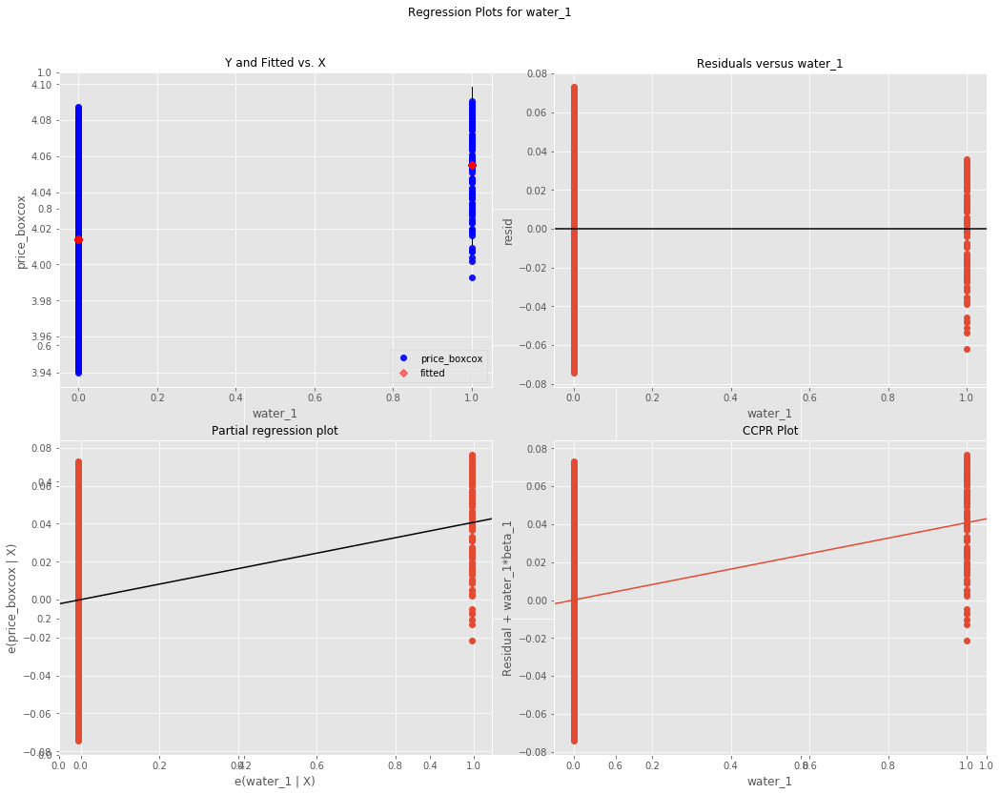

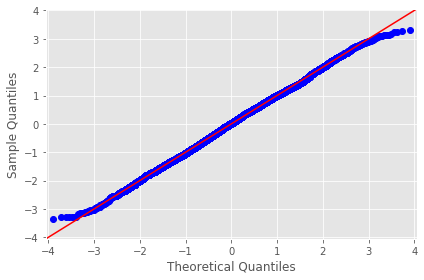

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_25
-------------------------------------------------------------------------------------


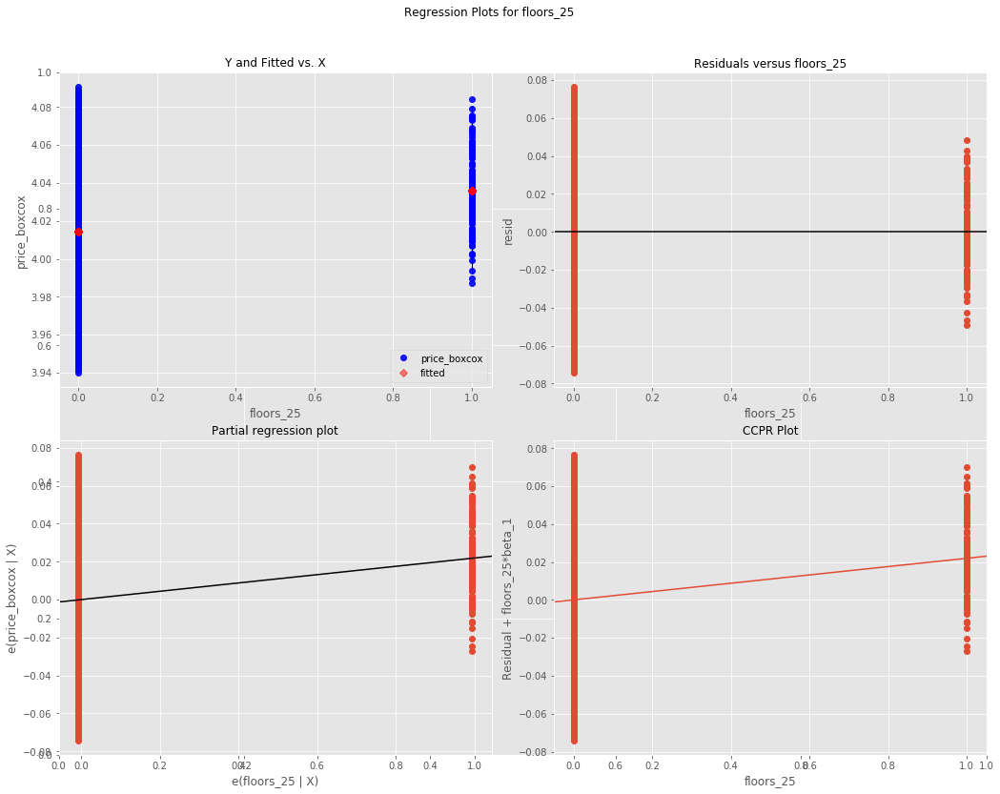

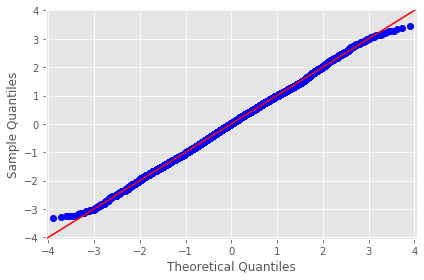

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_20
-------------------------------------------------------------------------------------


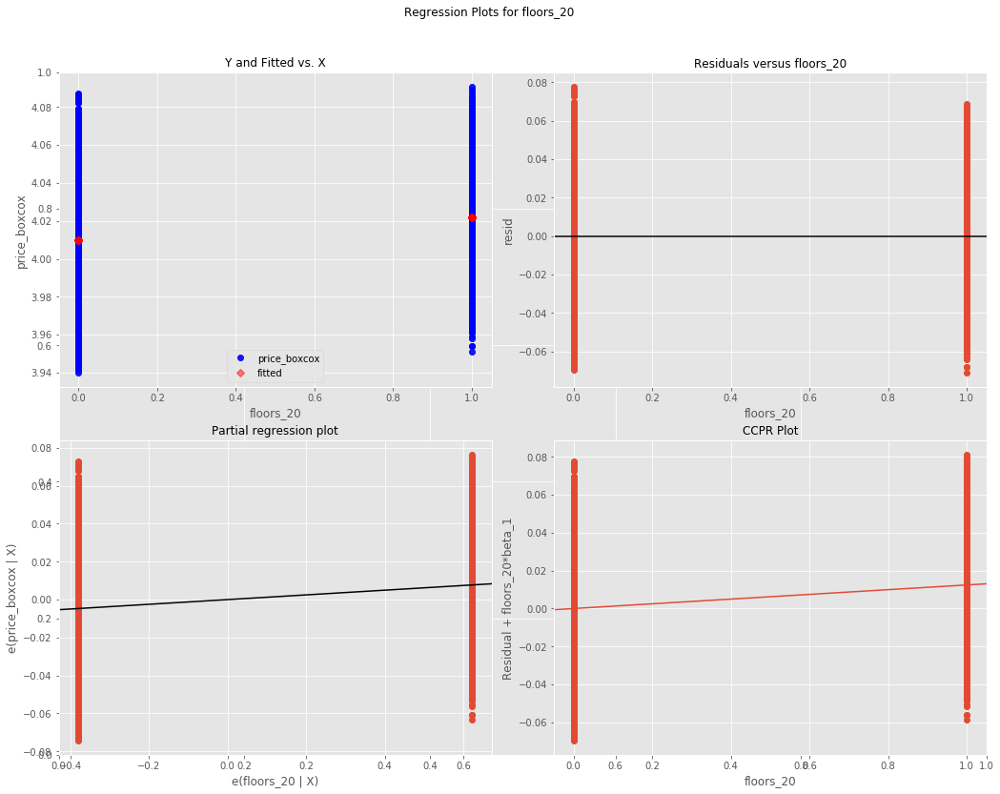

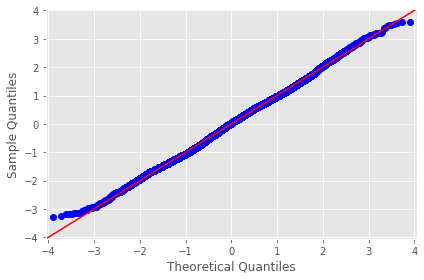

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_3
-------------------------------------------------------------------------------------


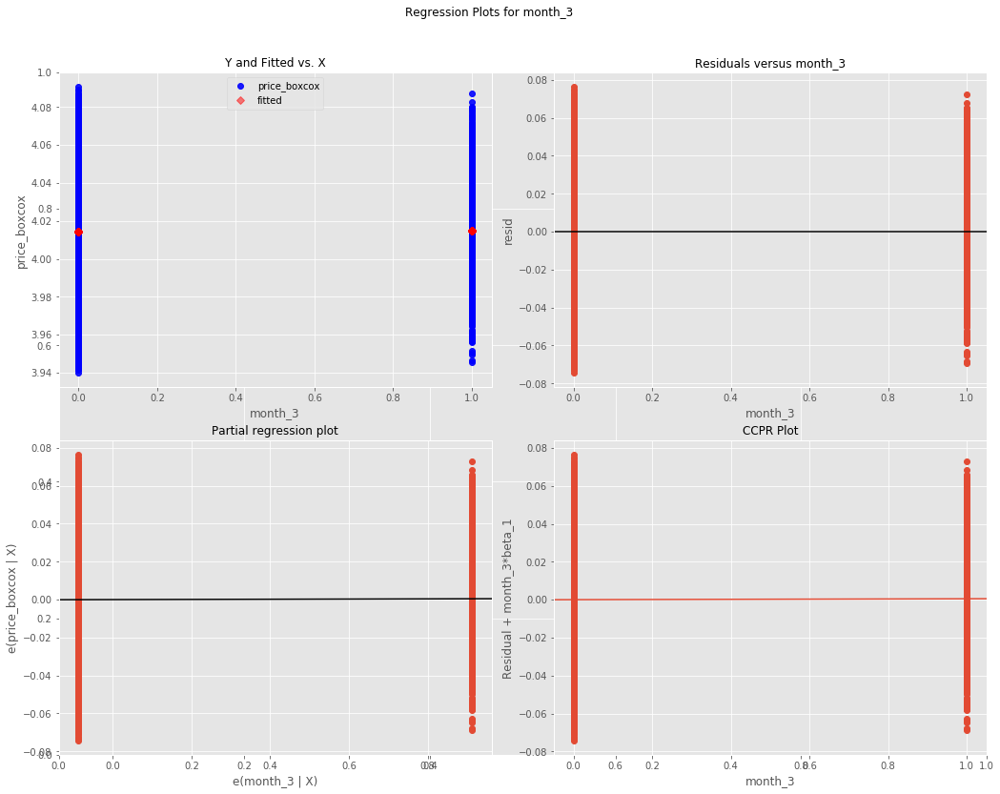

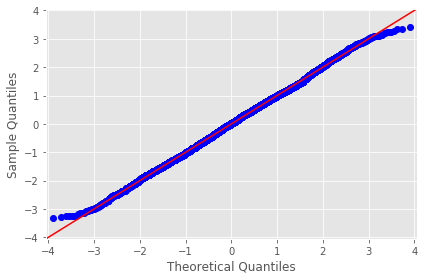

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_2
-------------------------------------------------------------------------------------


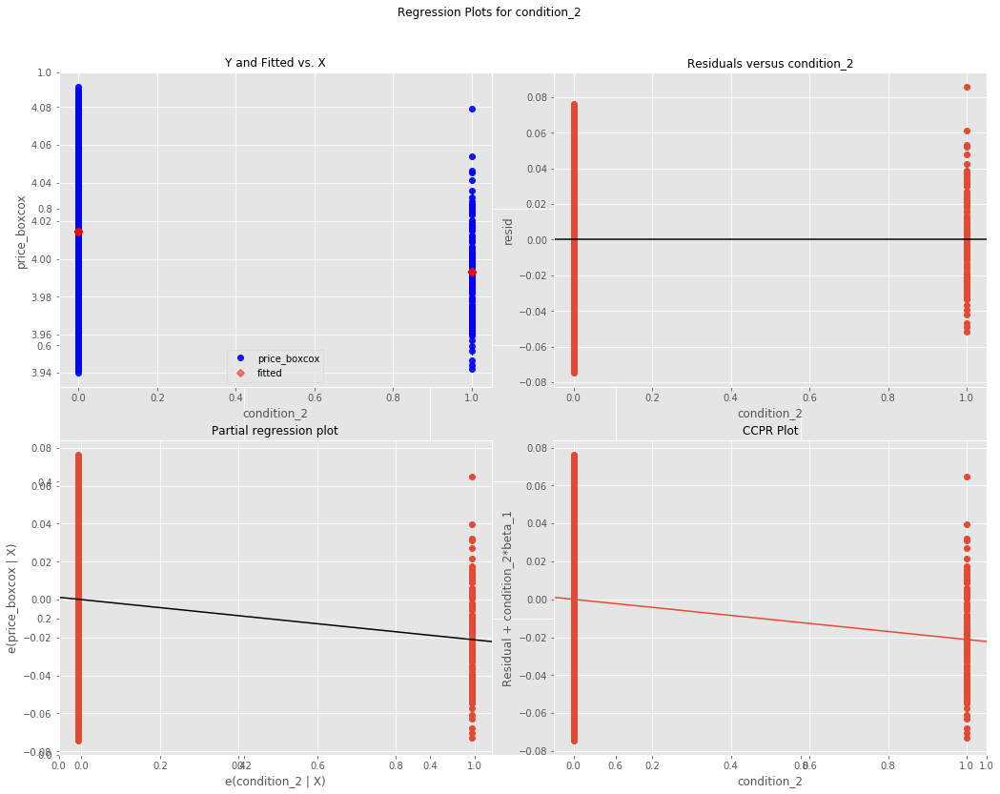

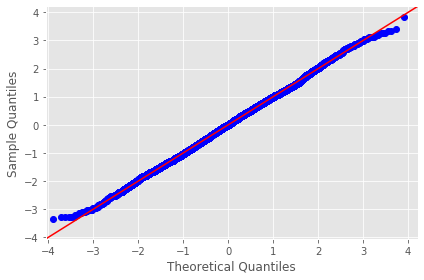

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_5
-------------------------------------------------------------------------------------


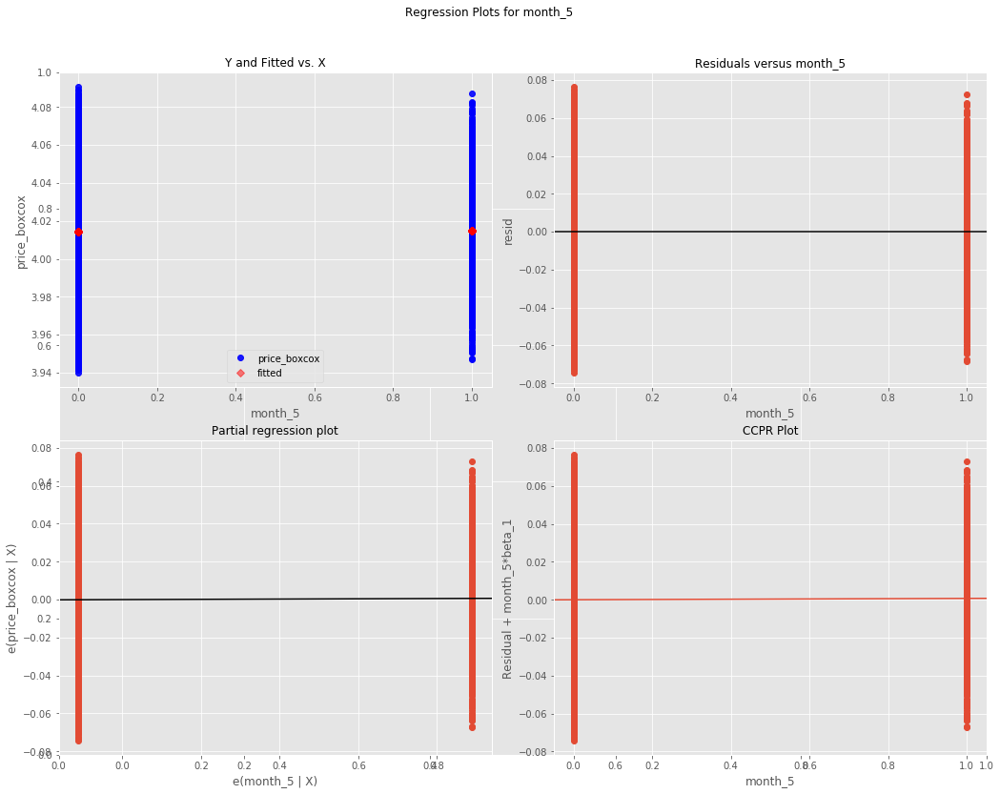

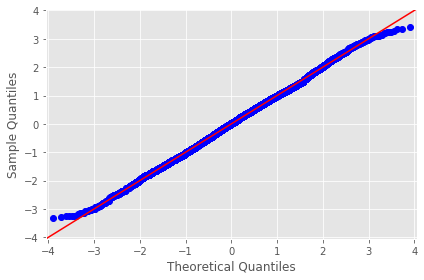

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~day_26
-------------------------------------------------------------------------------------


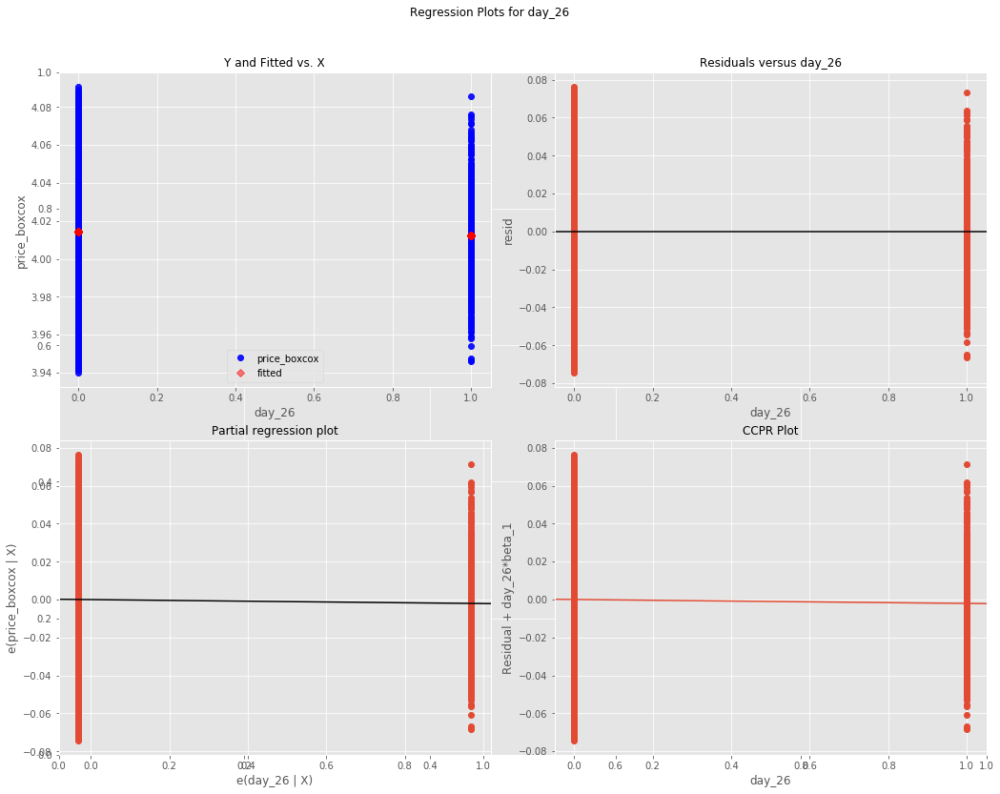

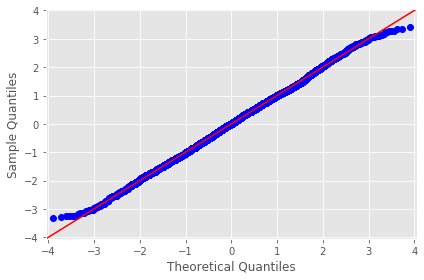

In [155]:
# evaluate residuals to further check assumptions
dataset = pd.concat([y, X], axis=1)
results = []
y = 'price_boxcox'
for idx, column in enumerate(dataset.columns):
    print (f"KC Housing DataSet - Regression Analysis and Diagnostics for {y}~{column}")
    print ("-------------------------------------------------------------------------------------")

    f = f'{y}~{column}'
    model = smf.ols(formula=f, data=dataset).fit()
    
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, column, fig=fig)
    fig = sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True)
    fig.tight_layout()
    plt.show()
    
    results.append([column, model.rsquared, model.params[0], model.params[1], model.pvalues[1], sms.jarque_bera(model.resid)[0]])

In [156]:
# store results in dataframe to make future comparison easy
model_4_results = pd.DataFrame(results, columns=['ind_var', 
                                                  'r_squared', 
                                                  'intercept', 
                                                  'slope', 
                                                  'p-value', 
                                                  'normality (JB)'])

In [157]:
model_4_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price_boxcox,1.000000,-9.947598e-14,1.000000,0.000000e+00,364.436418
1,bathrooms,0.262377,3.980800e+00,0.016032,0.000000e+00,83.247304
2,t_sqft_liv_15,0.340864,3.162516e+00,0.241707,0.000000e+00,11.133100
3,grade,0.444874,3.911431e+00,0.013483,0.000000e+00,19.377899
4,basement_1,0.041810,4.010697e+00,0.009360,1.398843e-193,10.730003
5,floors_15,0.002164,4.014043e+00,0.003650,2.310616e-11,1.299905
6,condition_5,0.003839,4.013962e+00,0.005128,5.225953e-19,2.854641
7,reno_1,0.010069,4.013949e+00,0.012421,2.587503e-47,3.621459
8,view_4,0.034203,4.013894e+00,0.036501,4.014525e-158,12.785332
9,condition_4,0.001875,4.014949e+00,-0.002195,4.898624e-10,2.798759


## Final Model

Looking at both q-q plots and the normality scores, our results are materially improved.  The majority of selected features appear to have normally distributed residuals, with no major signs of heterscedasticity.  That being said, there are a few features that will be dropped.  

 - given the high JB value, and looking at q-q plot, drop bathrooms as this does not meet normality assumptions. Additionally, it looks like residuals decrease the bigger bathroom value (heteroscedasticity)
 - drop floors_30 - - heteroscedasticity
 - drop floors_25 - - heteroscedasticity
 - drop view_4 - - heteroscedasticity
 - drop view_2 - - hetereoscedasticity
 - drop view_3 - - heteroscedascticity
 - drop view_1 -- ''
 - drop water_1 -- ''
 - drop condition_2 -- ''
 - drop bathrooms - - JB value is so big and the q-q plot isn't looking great.  This is going to hit r2, but need to take it out
 

In [158]:
X = X.drop(['floors_30',
            'floors_25',
            'view_4',
            'view_2',
            'view_3',
            'view_1',
            'water_1', 
            'condition_2', 
            'bathrooms'], axis=1)

In [159]:
# run regression with these features removed
y = data_fin_2['price_boxcox']
predictors = sm.add_constant(X)
model = sm.OLS(y, predictors).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           price_boxcox   R-squared:                       0.548
Model:                            OLS   Adj. R-squared:                  0.548
Method:                 Least Squares   F-statistic:                     2084.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:10:28   Log-Likelihood:                 57328.
No. Observations:               20628   AIC:                        -1.146e+05
Df Residuals:                   20615   BIC:                        -1.145e+05
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.5814      0.009    410.671      0.000       3.564       3.598
t_sqft_liv_15     0.0981      0.003     37.111      0.000       0.093       0.103
grade             0.0105      0.000     77.648      0.000       0.010       0.011
basement_1        0.0074      0.000     32.550      0.000       0.007       0.008
floors_15         0.0095      0.000     24.984      0.000       0.009       0.010
condition_5       0.0093      0.000     22.979      0.000       0.009       0.010
reno_1            0.0112      0.001     19.285      0.000       0.010       0.012
condition_4       0.0030      0.000     11.996      0.000       0.003       0.004
month_4           0.0031      0.000      9.034      0.000       0.002       0.004
floors_20         0.0014      0.000      5.080      0.000       0.001       0.002
month_3           0.0022      0.000      5.739      0.000       0.001       0.003
month_5           0.0009      0.000      2.758      0.006       0.000       0.002
day_26           -0.0017      0.001     -2.853      0.004      -0.003      -0.001
==============================================================================
Omnibus:                      102.274   Durbin-Watson:                   1.981
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              103.694
Skew:                          -0.172   Prob(JB):                     3.04e-23
Kurtosis:                       3.051   Cond. No.                         745.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

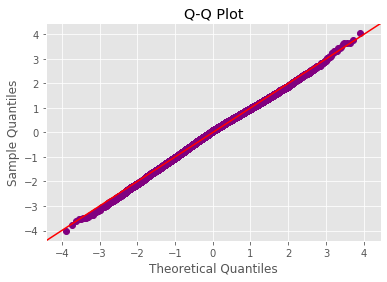

In [160]:
# full model residual plots and boxcox
# plot q-q check normality of residuals
sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True, color='purple');
plt.title('Q-Q Plot');

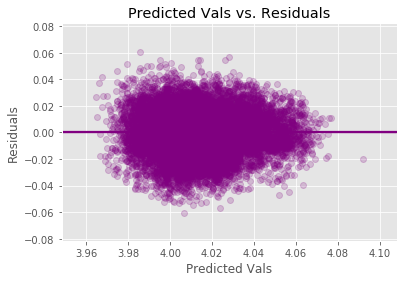

In [161]:
# check heteroscedascity
predicted_vals = model.predict(predictors)
sns.regplot(x=predicted_vals, y=model.resid, color='purple', scatter_kws={'alpha': 0.2});
plt.title('Predicted Vals vs. Residuals')
plt.xlabel('Predicted Vals')
plt.ylabel('Residuals');

In [162]:
# Based on overall model residual plots and q-q plots, our model meets homoscedastic and linear residual
# assumptions as there is no major pattern in the residual plots visible.  Additionally the q-q plot
# confirms normality assumptions

In [163]:
coefficients = model.params

In [164]:
# Now run single variable regressions of each predictor

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~price_boxcox
-------------------------------------------------------------------------------------


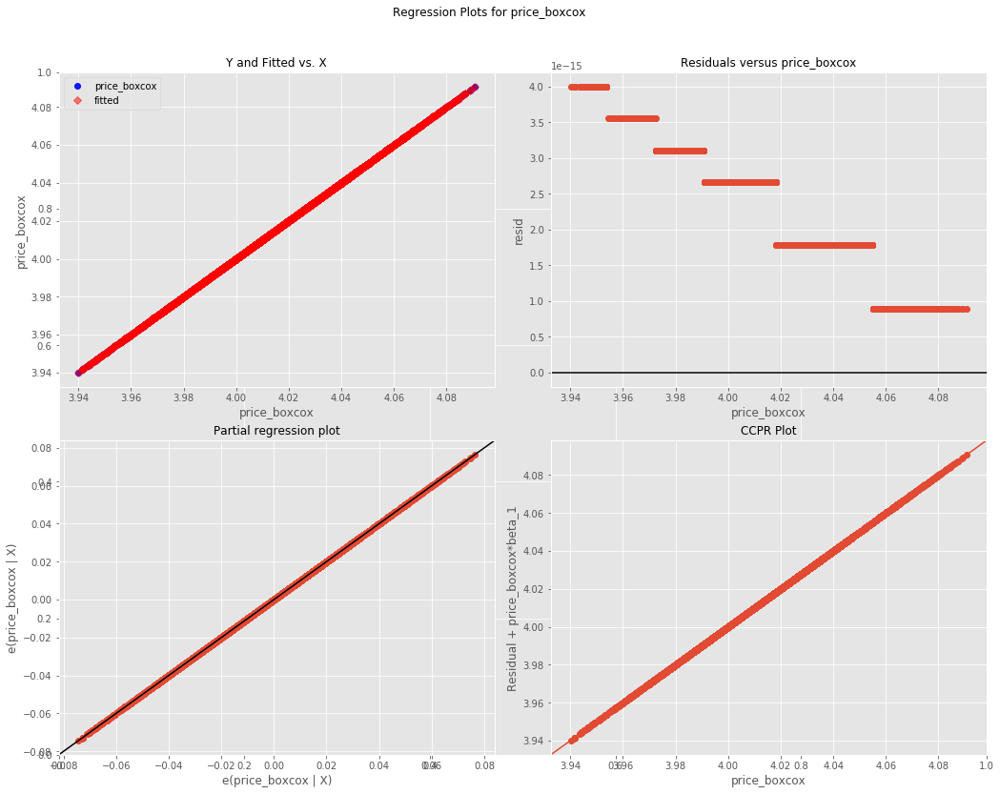

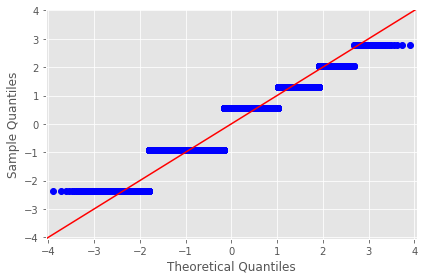

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~t_sqft_liv_15
-------------------------------------------------------------------------------------


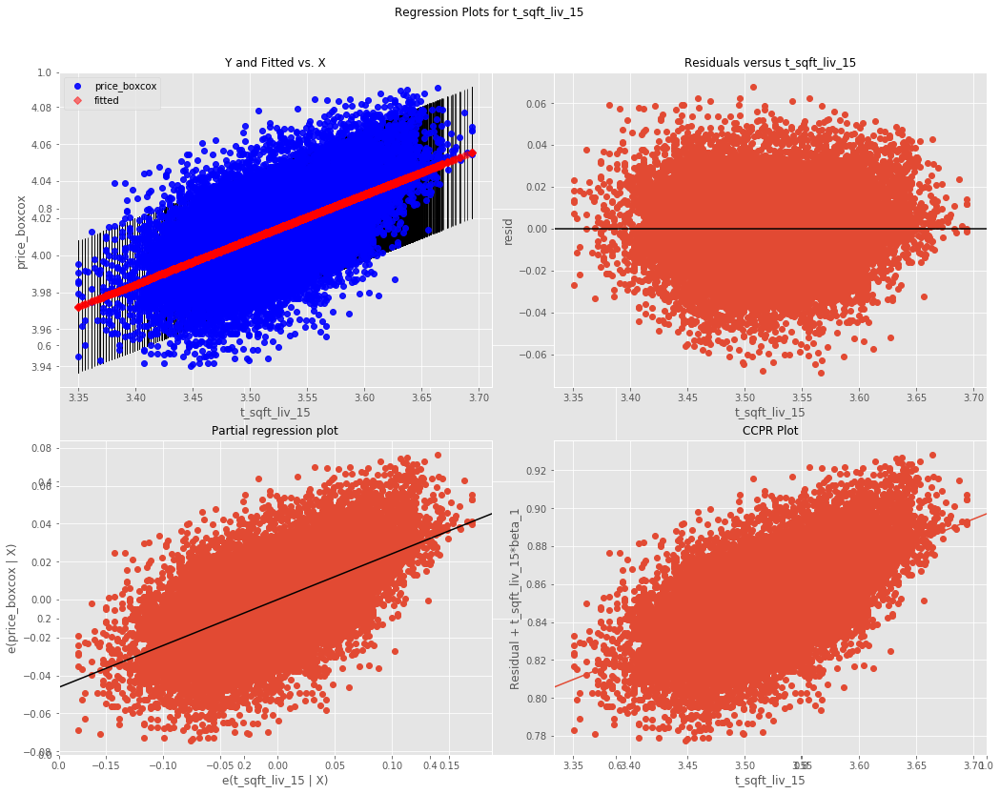

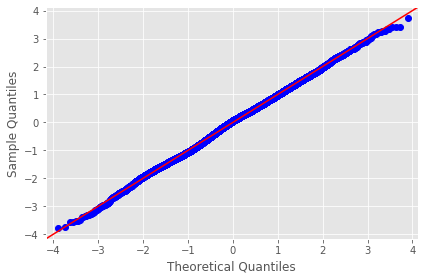

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~grade
-------------------------------------------------------------------------------------


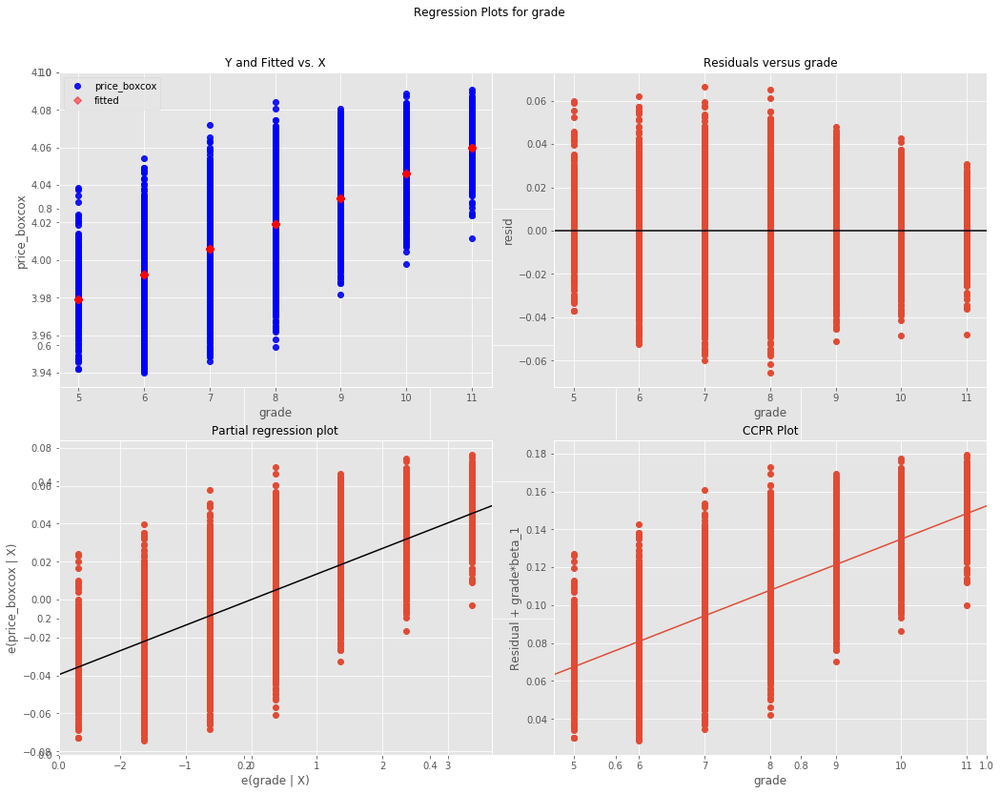

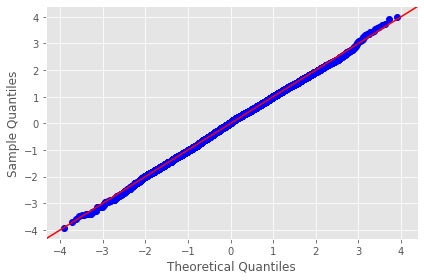

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~basement_1
-------------------------------------------------------------------------------------


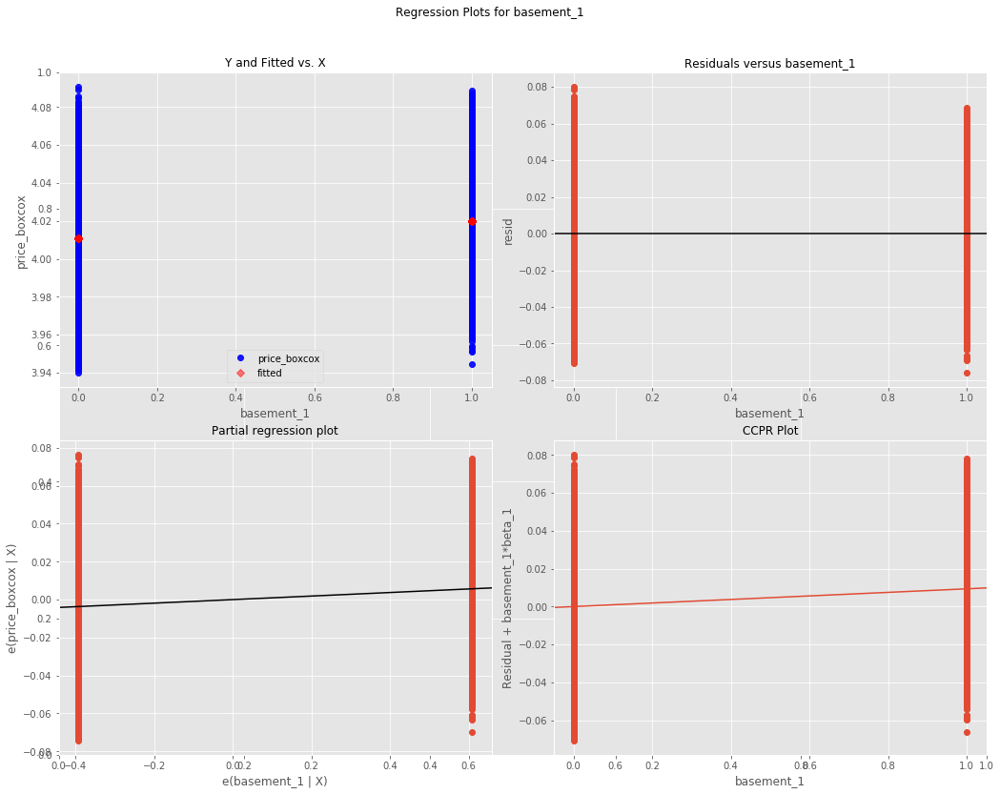

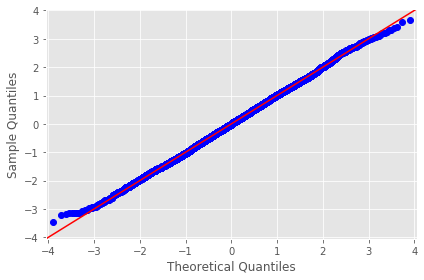

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_15
-------------------------------------------------------------------------------------


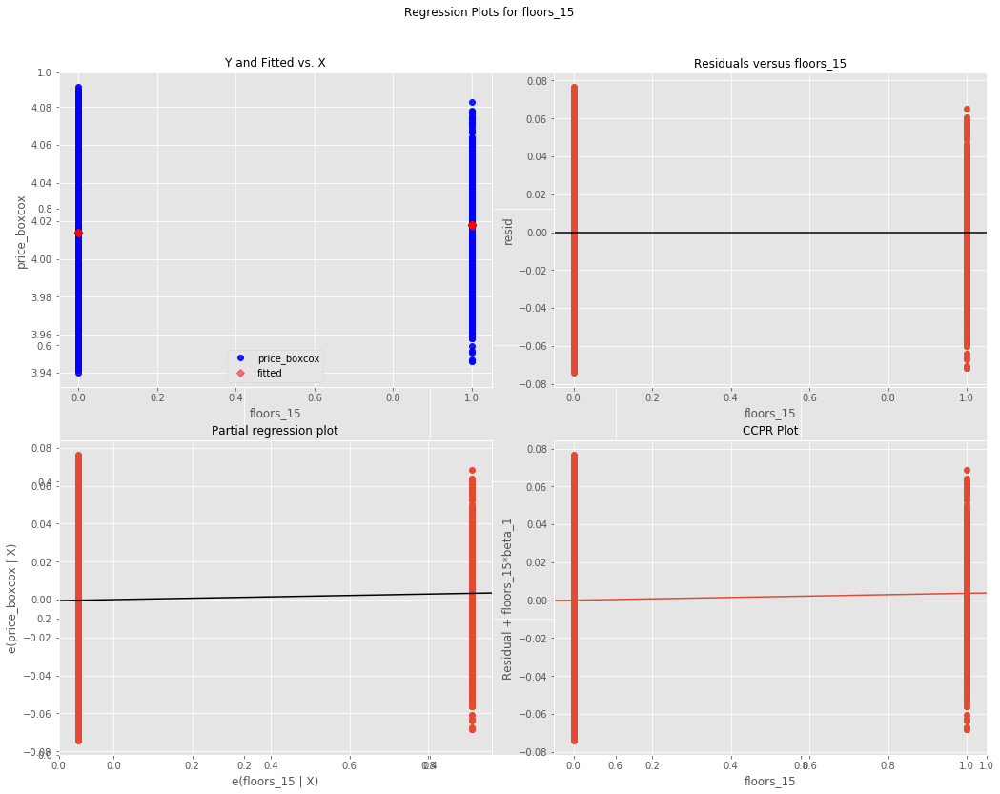

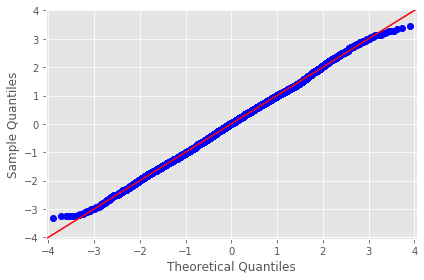

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_5
-------------------------------------------------------------------------------------


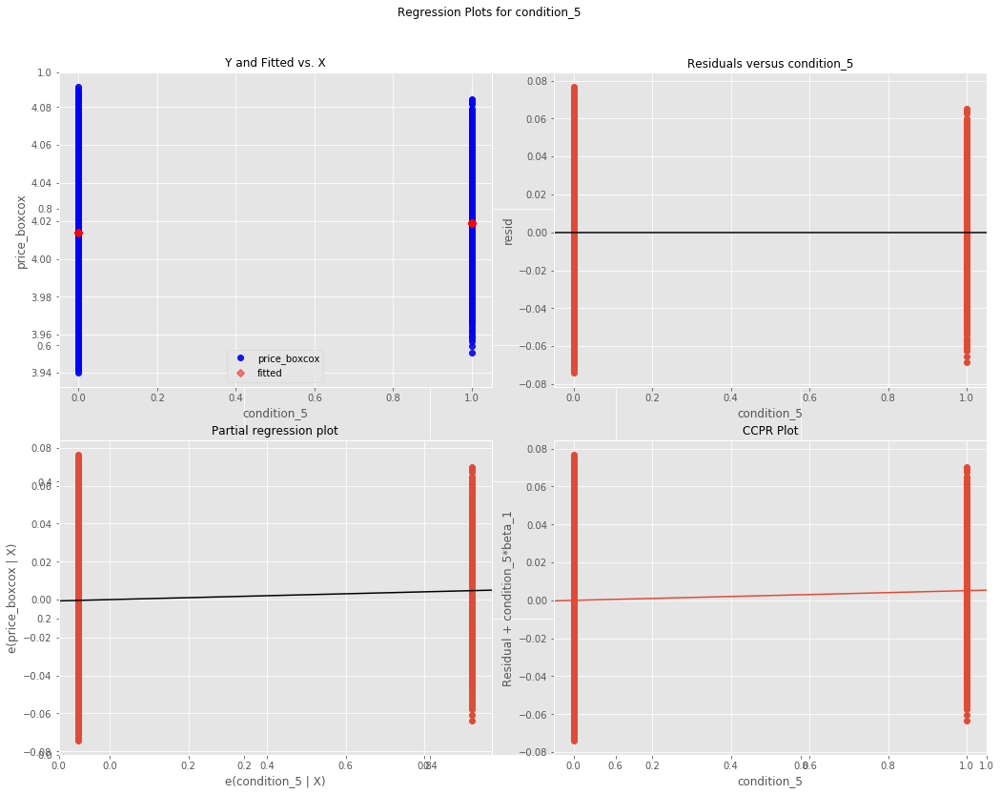

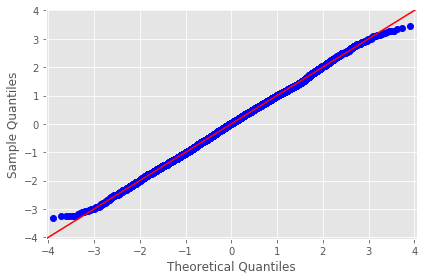

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~reno_1
-------------------------------------------------------------------------------------


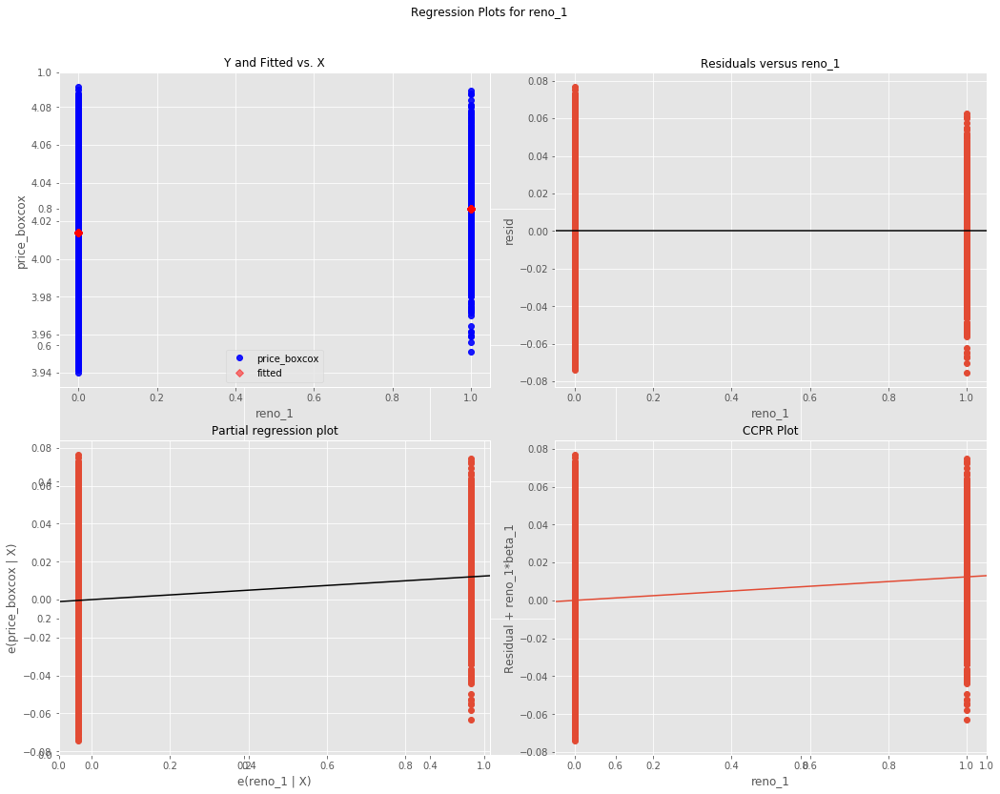

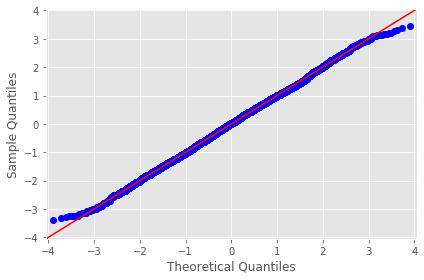

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~condition_4
-------------------------------------------------------------------------------------


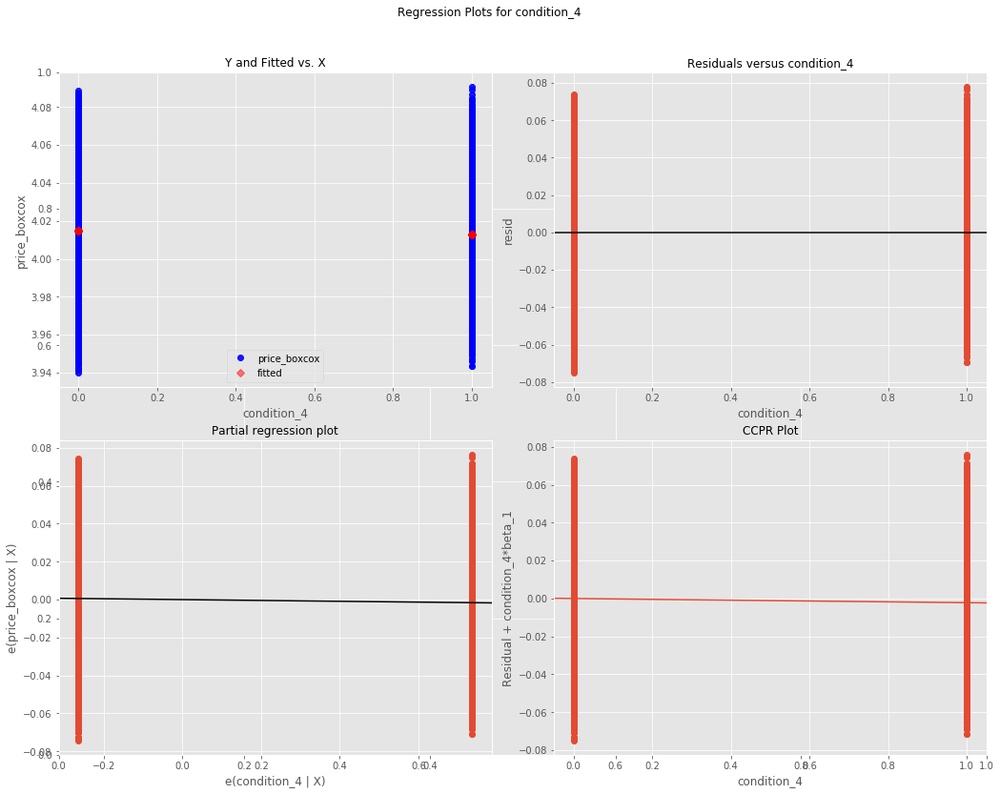

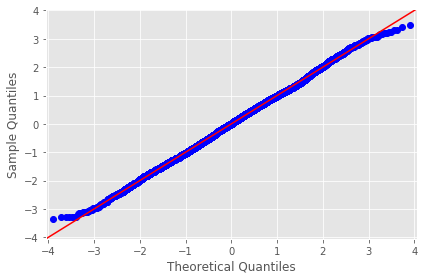

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_4
-------------------------------------------------------------------------------------


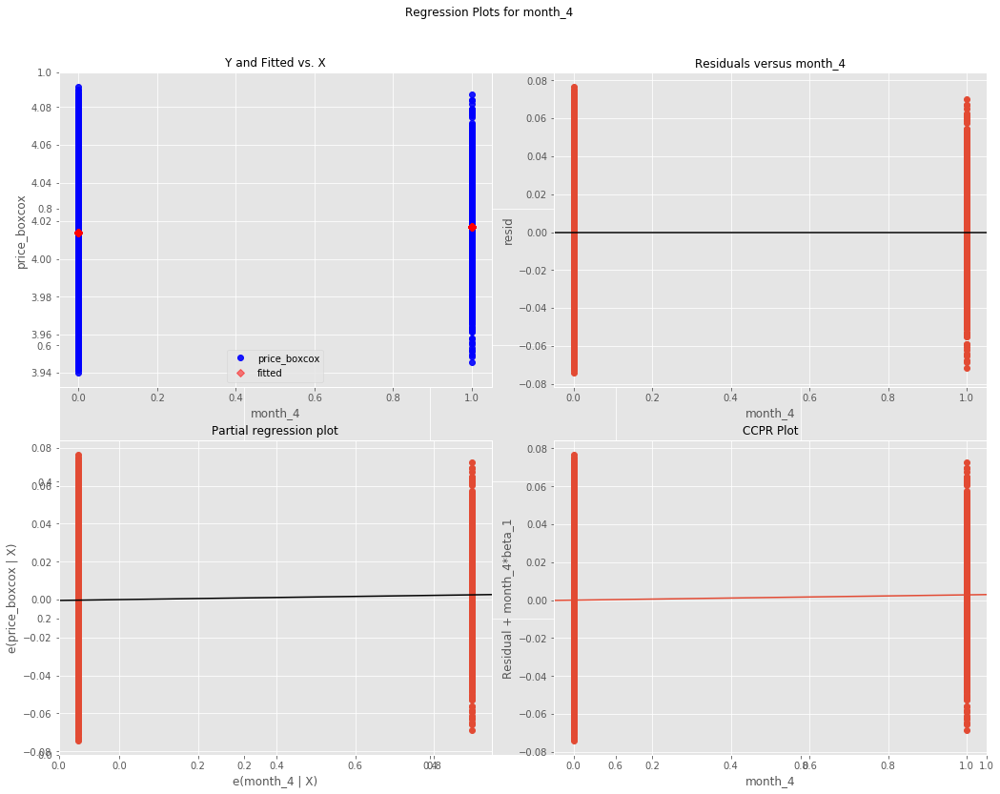

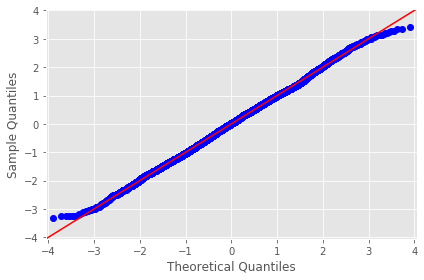

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~floors_20
-------------------------------------------------------------------------------------


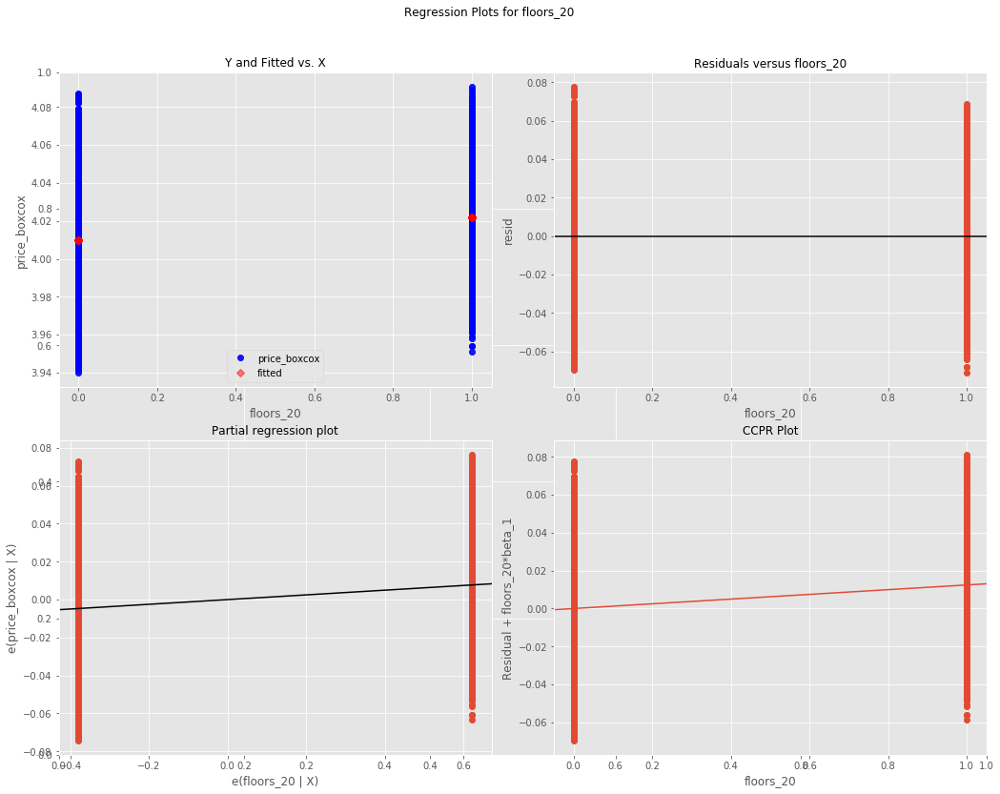

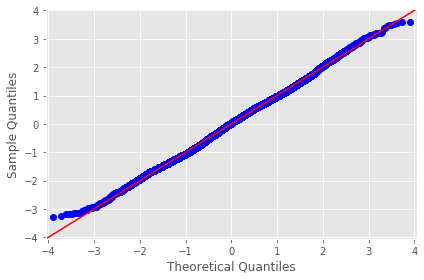

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_3
-------------------------------------------------------------------------------------


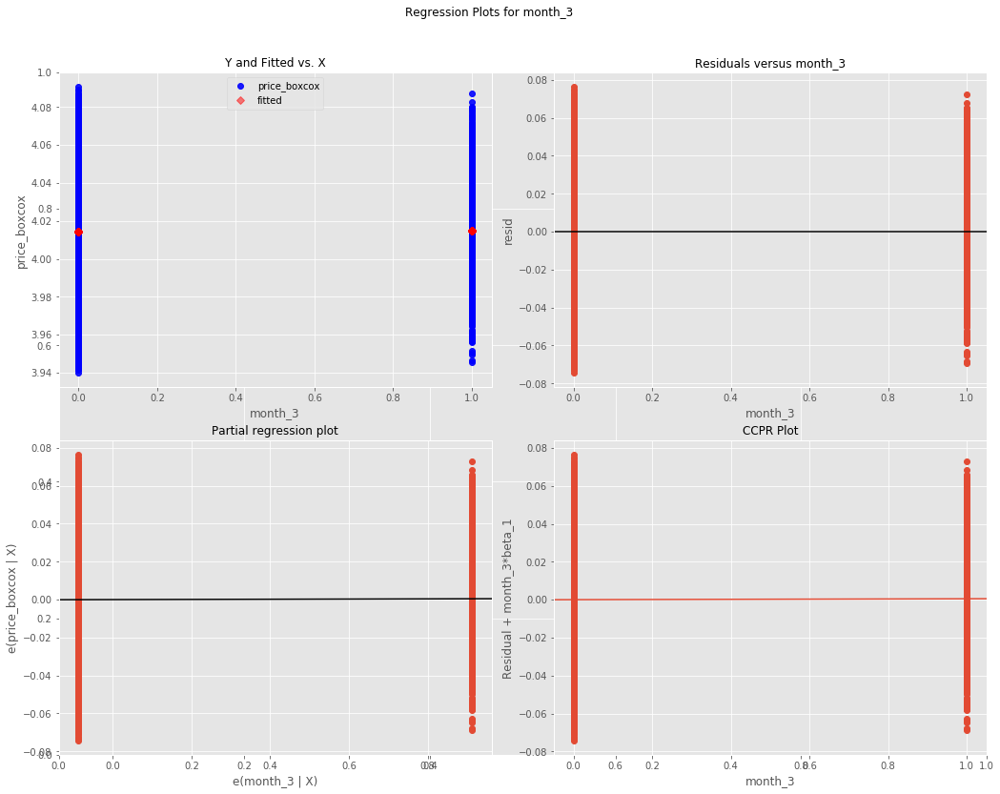

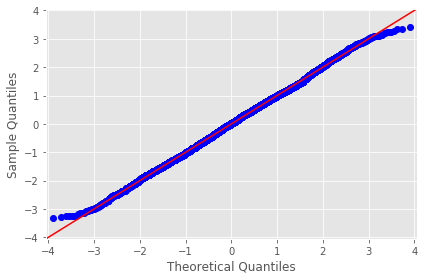

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~month_5
-------------------------------------------------------------------------------------


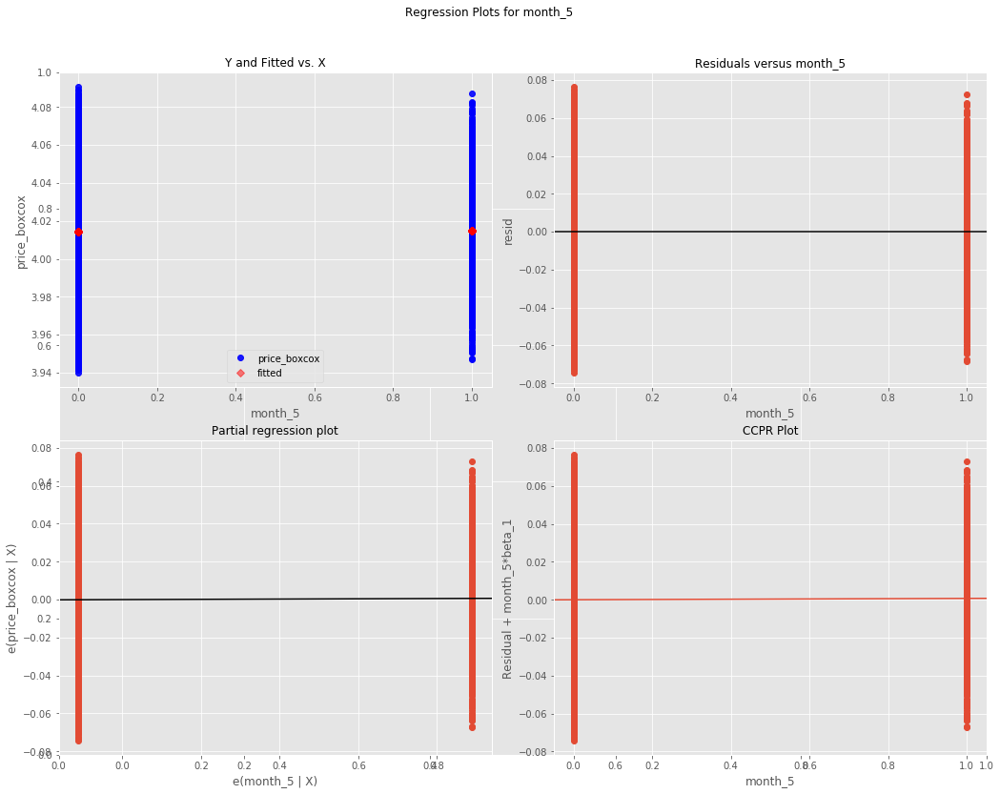

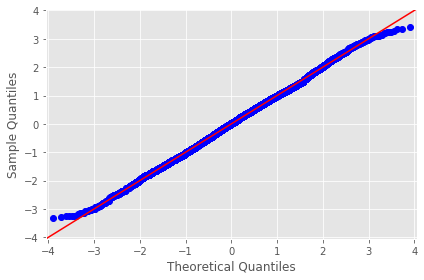

KC Housing DataSet - Regression Analysis and Diagnostics for price_boxcox~day_26
-------------------------------------------------------------------------------------


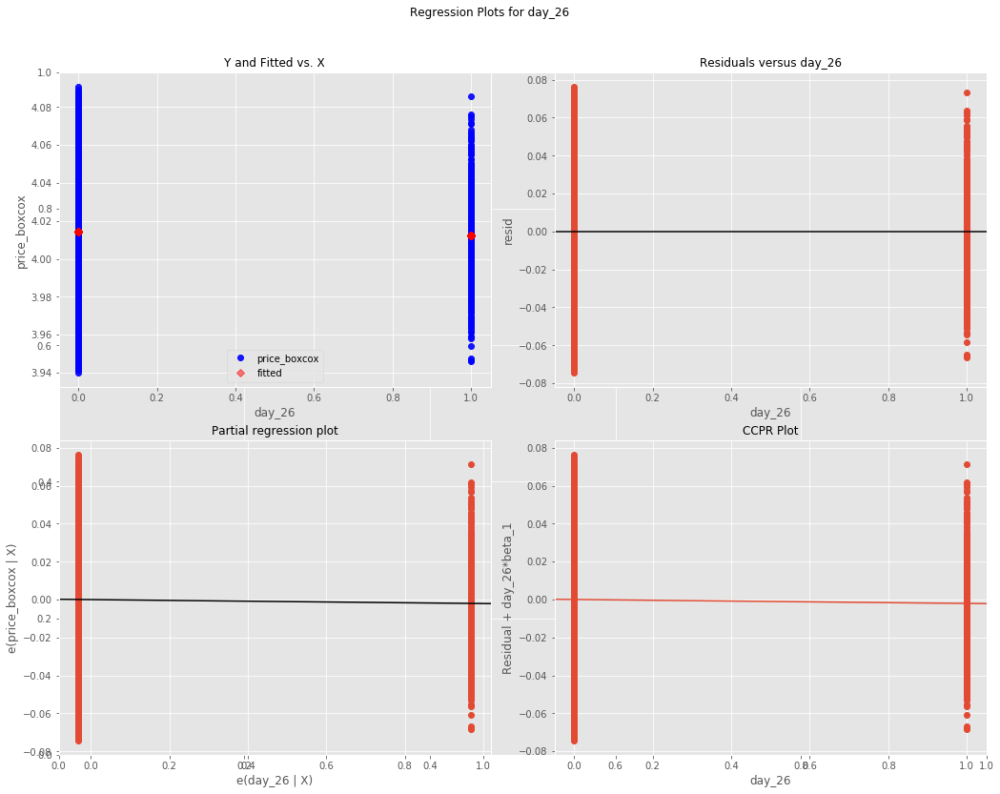

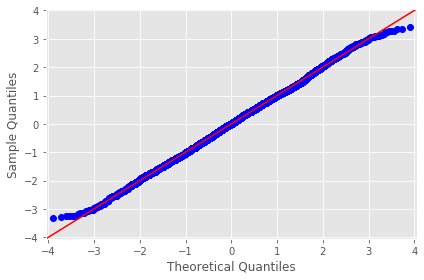

In [165]:
# evaluate residuals to check assumptions
dataset = pd.concat([y, X], axis=1)
results = []
y = 'price_boxcox'
for idx, column in enumerate(dataset.columns):
    print (f"KC Housing DataSet - Regression Analysis and Diagnostics for {y}~{column}")
    print ("-------------------------------------------------------------------------------------")

    f = f'{y}~{column}'
    model = smf.ols(formula=f, data=dataset).fit()
    
    fig, axes = plt.subplots(figsize=(15,12))
    fig = sm.graphics.plot_regress_exog(model, column, fig=fig)
    fig = sm.graphics.qqplot(model.resid, dist=stats.norm, line='45', fit=True)
    fig.tight_layout()
    plt.show()
    
    results.append([column, model.rsquared, model.params[0], model.params[1], model.pvalues[1], sms.jarque_bera(model.resid)[0]])

In [166]:
# store results in dataframe to make future comparison easy
final_model_results = pd.DataFrame(results, columns=['ind_var', 
                                                     'r_squared', 
                                                     'intercept', 
                                                     'slope', 
                                                     'p-value', 
                                                     'normality (JB)'])

In [167]:
final_model_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price_boxcox,1.000000,-9.947598e-14,1.000000,0.000000e+00,364.436418
1,t_sqft_liv_15,0.340864,3.162516e+00,0.241707,0.000000e+00,11.133100
2,grade,0.444874,3.911431e+00,0.013483,0.000000e+00,19.377899
3,basement_1,0.041810,4.010697e+00,0.009360,1.398843e-193,10.730003
4,floors_15,0.002164,4.014043e+00,0.003650,2.310616e-11,1.299905
5,condition_5,0.003839,4.013962e+00,0.005128,5.225953e-19,2.854641
6,reno_1,0.010069,4.013949e+00,0.012421,2.587503e-47,3.621459
7,condition_4,0.001875,4.014949e+00,-0.002195,4.898624e-10,2.798759
8,month_4,0.001459,4.014078e+00,0.002797,4.092361e-08,3.108862
9,floors_20,0.072686,4.009665e+00,0.012423,0.000000e+00,11.180193


In [168]:
# # # # 
# # # #
model_3_results

,ind_var,r_squared,intercept,slope,p-value,normality (JB)
0,price_boxcox,1.000000,5.684342e-14,1.000000,0.000000e+00,1348.428290
1,sqft_basement,0.094576,4.009900e+00,0.000016,0.000000e+00,38.626253
2,sqft_living15,0.367931,3.973619e+00,0.000021,0.000000e+00,124.351609
3,grade,0.475157,3.909716e+00,0.013700,0.000000e+00,80.384597
4,floors_15,0.001560,4.014342e+00,0.003250,9.611103e-09,90.699461
5,condition_5,0.003448,4.014228e+00,0.005083,1.422589e-17,83.223337
6,reno_1,0.010213,4.014185e+00,0.012962,5.555814e-49,85.569810
7,water_1,0.022228,4.014343e+00,0.042668,4.684418e-105,69.246752
8,bathrooms,0.294391,3.979764e+00,0.016477,0.000000e+00,33.585577
9,condition_4,0.001986,4.015249e+00,-0.002362,9.621329e-11,84.886606


In [169]:
# cross validation to make sure we are not overfitting
regression = LinearRegression()
y = dataset['price_boxcox']
crossvalidation = KFold(n_splits=4, shuffle=True, random_state=1)
score = cross_val_score(regression, predictors, y, scoring='r2', cv=crossvalidation)

In [170]:
score

array([0.54720101, 0.54283418, 0.55068123, 0.54898074])

In [171]:
# average them
np.mean(score)

0.5474242887740493

In [172]:
# now calc MSE
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.model_selection import cross_val_score
mse = make_scorer(mean_squared_error)
cv_results = cross_val_score(regression, X, predictors, cv=5, scoring=mse)
cv_results

array([1.62747005e-30, 1.88408600e-30, 6.22029632e-30, 1.66185807e-30,
       3.35114787e-30])

In [173]:
mse_score = cv_results.mean()
mse_score

2.948971661817264e-30

In [174]:
# transform to price - - using lambda
from scipy.special import inv_boxcox
fitted_lamba_0

-0.23781570193294282

In [175]:
coefficients

const            3.581356
t_sqft_liv_15    0.098142
grade            0.010529
basement_1       0.007378
floors_15        0.009535
condition_5      0.009298
reno_1           0.011237
condition_4      0.003024
month_4          0.003150
floors_20        0.001376
month_3          0.002157
month_5          0.000933
day_26          -0.001724
dtype: float64

In [176]:
from scipy.special import boxcox, inv_boxcox
price_constant = inv_boxcox(coefficients['const'], fitted_lamba_0)
price_constant

3057.2580660937615

## Final Model Summary / Conclusion
 - the final model is comprised of 13 predictor variables, inclusive of a constant
 - Final target variable: `price_boxcox`
 - Final predictor variables:
     - `t_sqft_liv_15`
     - `grade`
     - `basement_1`
     - `floors_15`
     - `condition_5`
     - `reno_1`
     - `condition_4`
     - `month_4`
     - `floors_20`
     - `month_3`
     - `month_5`
     - `day_26`
     
Because price was transformed to `price_boxcox` using a boxcox transformation with a fitted lambda value of -.24, meaning our coefficients will be representing changes in `price_boxcox` (price raised to the -.24 exponent).  Our model has an adjusted r-squared value of 0.548, representing the amount of variance in `price_boxcox` that can be explained by our predictors. 

Coefficients
 - `grade`: overall grade given to the house based on the King County grading system. 
     - coefficient: 0.0105 -- a one unit change in grade, holding all other variables constant, relates to a 0.0105 change in box cox transformed price
 - `basement_1`: house has a basement
     - coefficient: 0.007 -- having a basement is associated with an increase to `price_boxcox` by 0.007, holding others constant
 - `reno_1`: house has been renovated
     - coefficient: 0.011 -- holding others constant, a renovated house is asssociated with an increase to `price_boxcox` by 0.011
 - `condition_5`: overall condition rating=5
     - coefficient: 0.009 -- while coefficients are relatively small, a condition rating of 5 is associated with an increase to `price_boxcox` by 0.009

Effect sizes are really small, even when translating back from boxcox to regular price.  We have an intercept of 3.58 `price_boxcox`, which when translated back to price, is $3,053.  While coefficients are statistically signficant, with most confidence intervals containing non-zeros, a such a small effect size makes it hard to pull real insight from this data. 

#### Recommendations:
1. When buying houses, look for houses that have no history of renovations, a low KC grade, and a house with 2 floors.  Houses with history of renovation are related to higher priced houses, similar with high-graded homes.  Targeting purchases with no history of renovation and a low grade should be related with a lower house purchase price based on our model.
2. When selling assets, target selling during the spring months, as `month_3`, `month_4`, and `month_5` are associated with higher sale prices. 
3. Change management - driving asset improvement.  As we can see from the `reno_1` coefficient, a renovation is related to higher sale prices, along with houses with basements, and high grades / conditions.  As a result, it is recommended to implement these changes if possible to purchased assets before selling to try and maximize sale price. If possible, add basement, invest in renovations and improvements, with a goal of driving up condition ranking as close to 5 as possible, and driving grade as high as possible.